In [24]:
import time
import random
import numpy as np
import matplotlib.pyplot as plt
import keras
import keras.backend as K

In [2]:
(x_train, y_train), (x_test, y_test) = keras.datasets.cifar10.load_data()
#x_train = x_train[:,:,:,np.newaxis]
#x_test = x_test[:,:,:,np.newaxis]
x_train = x_train / 255.
x_test = x_test / 255.
#y_train = keras.utils.to_categorical(y_train, num_classes=10)
#y_test = keras.utils.to_categorical(y_test, num_classes=10)

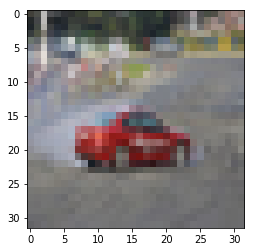

In [3]:
plt.imshow(x_train[np.squeeze(y_train) == 1][10])
plt.show()

In [4]:
x_train_2 = x_train #[np.squeeze(y_train) == 1]

In [5]:
K.clear_session()

M_dis_clip = lambda w: K.clip(w, -0.01, 0.01)

L = L0 = keras.layers.Input((32,32,3))
L = keras.layers.Conv2D(16, (3,3), padding='same', kernel_constraint=M_dis_clip)(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.AveragePooling2D()(L)
L = keras.layers.Conv2D(64, (3,3), padding='same', kernel_constraint=M_dis_clip)(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.AveragePooling2D()(L)
L = keras.layers.Conv2D(512, (3,3), padding='same', kernel_constraint=M_dis_clip)(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.AveragePooling2D()(L)
L = keras.layers.Flatten()(L)
L = keras.layers.Dense(1, kernel_constraint=M_dis_clip)(L)
M_dis = keras.models.Model([L0], [L])
M_dis.compile('rmsprop', 'binary_crossentropy')
M_dis.summary()
M_dis_freeze = keras.models.Model([L0], [L])
M_dis_freeze.trainable = False
M_dis_freeze.compile('rmsprop', 'binary_crossentropy')

L = L0 = keras.layers.Input((100,))
L = keras.layers.Dense(4*4*512)(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Reshape((4,4,512))(L)
L = keras.layers.Conv2D(128*4, (3,3), padding='same')(L)
L = keras.layers.Reshape((4,4,2,2,128))(L)
L = keras.layers.Permute((1,3,2,4,5))(L)
L = keras.layers.Reshape((8,8,128))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2D(64*4, (3,3), padding='same')(L)
L = keras.layers.Reshape((8,8,2,2,64))(L)
L = keras.layers.Permute((1,3,2,4,5))(L)
L = keras.layers.Reshape((16,16,64))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2D(16*4, (3,3), padding='same')(L)
L = keras.layers.Reshape((16,16,2,2,16))(L)
L = keras.layers.Permute((1,3,2,4,5))(L)
L = keras.layers.Reshape((32,32,16))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2D(3, (1,1), activation='sigmoid')(L)

"""
L = L0 = keras.layers.Input((100,))
L = keras.layers.Dense(4*4*512)(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Reshape((4,4,512))(L)
L = keras.layers.Conv2DTranspose(256, (5,5))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2DTranspose(128, (5,5))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2DTranspose(64, (5,5))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2DTranspose(32, (5,5))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2DTranspose(16, (5,5))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2DTranspose(8, (5,5))(L)
L = keras.layers.BatchNormalization()(L)
L = keras.layers.LeakyReLU()(L)
L = keras.layers.Conv2DTranspose(3, (5,5), activation='sigmoid')(L)
"""
M_gen = keras.models.Model([L0], [L])
M_gen.compile('rmsprop', 'mse')
M_gen.summary()
M_gen_freeze = keras.models.Model([L0], [L])
M_gen_freeze.trainable = False
M_gen_freeze.compile('rmsprop', 'mse')

M_loss = lambda l,y: -K.mean((l*2.-1.)*y)

L_R = L0_R = keras.layers.Input((32,32,3))
L_R = M_dis(L_R)
L_F = L0_F = keras.layers.Input((100,))
L_F = M_gen_freeze(L_F)
L_F = M_dis(L_F)
M_dis_train_opt = keras.optimizers.RMSprop(lr=0.00005)
M_dis_train = keras.models.Model([L0_R, L0_F], [L_R, L_F])
M_dis_train.compile(M_dis_train_opt, M_loss)

L_F = L0_F = keras.layers.Input((100,))
L_F = M_gen(L_F)
L_F = M_dis_freeze(L_F)
M_gen_train_opt = keras.optimizers.RMSprop(lr=0.00005)
M_gen_train = keras.models.Model([L0_F], [L_F])
M_gen_train.compile(M_gen_train_opt, M_loss)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 32, 32, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 16)        448       
_________________________________________________________________
batch_normalization_1 (Batch (None, 32, 32, 16)        64        
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 16)        0         
_________________________________________________________________
average_pooling2d_1 (Average (None, 16, 16, 16)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 64)        9280      
_________________________________________________________________
batch_normalization_2 (Batch (None, 16, 16, 64)        256       
__________

Epoch 10/10
64/64 [==============================] - 0s 603us/step - loss: -34.7488 - model_1_loss: -56.0069
Epoch 10/10
64/64 [==============================] - 0s 620us/step - loss: -17.0337 - model_1_loss: -47.2731
Epoch 10/10
64/64 [==============================] - 0s 680us/step - loss: -30.4893 - model_1_loss: -75.3066
Epoch 10/10
64/64 [==============================] - 0s 650us/step - loss: -8.5851 - model_1_loss: -79.7720
Epoch 10/10
64/64 [==============================] - 0s 629us/step - loss: -20.8273 - model_1_loss: -95.9837
Epoch 10/10
64/64 [==============================] - 0s 759us/step - loss: 88.1971


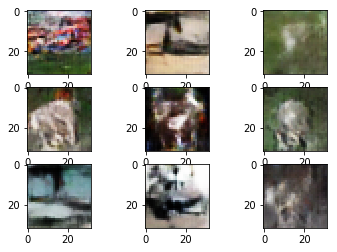

Epoch 20/20
64/64 [==============================] - 0s 601us/step - loss: -10.9223 - model_1_loss: -82.0725
Epoch 20/20
64/64 [==============================] - 0s 627us/step - loss: -36.6203 - model_1_loss: -81.8064
Epoch 20/20
64/64 [==============================] - 0s 646us/step - loss: -26.4563 - model_1_loss: -90.6737
Epoch 20/20
64/64 [==============================] - 0s 623us/step - loss: -33.2338 - model_1_loss: -124.7261
Epoch 20/20
64/64 [==============================] - 0s 636us/step - loss: -26.5769 - model_1_loss: -104.8813
Epoch 20/20
64/64 [==============================] - 0s 708us/step - loss: 104.1553


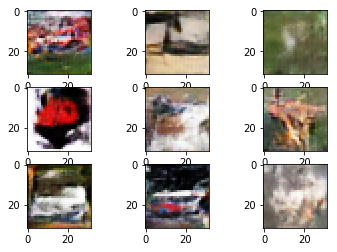

Epoch 30/30
64/64 [==============================] - 0s 639us/step - loss: -27.9469 - model_1_loss: -81.4885
Epoch 30/30
64/64 [==============================] - 0s 624us/step - loss: -17.6274 - model_1_loss: -58.0763
Epoch 30/30
64/64 [==============================] - 0s 631us/step - loss: -29.7159 - model_1_loss: -84.4516
Epoch 30/30
64/64 [==============================] - 0s 623us/step - loss: 0.4885 - model_1_loss: -73.1568
Epoch 30/30
64/64 [==============================] - 0s 645us/step - loss: -21.4215 - model_1_loss: -51.0624
Epoch 30/30
64/64 [==============================] - 0s 705us/step - loss: 54.4041


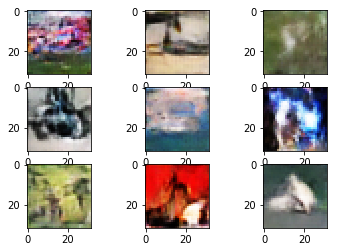

Epoch 40/40
64/64 [==============================] - 0s 598us/step - loss: -3.5749 - model_1_loss: -27.9097
Epoch 40/40
64/64 [==============================] - 0s 630us/step - loss: -33.4459 - model_1_loss: -121.8522
Epoch 40/40
64/64 [==============================] - 0s 635us/step - loss: -30.0137 - model_1_loss: -126.7295
Epoch 40/40
64/64 [==============================] - 0s 624us/step - loss: -35.8090 - model_1_loss: -128.4798
Epoch 40/40
64/64 [==============================] - 0s 619us/step - loss: -25.9102 - model_1_loss: -121.3431
Epoch 40/40
64/64 [==============================] - 0s 708us/step - loss: 82.6657


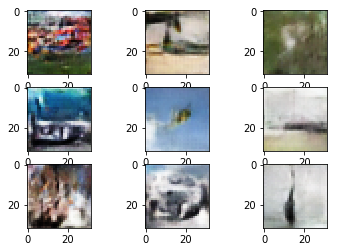

Epoch 50/50
64/64 [==============================] - 0s 602us/step - loss: -7.0787 - model_1_loss: -115.1602
Epoch 50/50
64/64 [==============================] - 0s 630us/step - loss: -24.6525 - model_1_loss: -120.7473
Epoch 50/50
64/64 [==============================] - 0s 626us/step - loss: -27.2370 - model_1_loss: -118.6110
Epoch 50/50
64/64 [==============================] - 0s 626us/step - loss: -16.4349 - model_1_loss: -113.1324
Epoch 50/50
64/64 [==============================] - 0s 637us/step - loss: -37.8425 - model_1_loss: -125.2779
Epoch 50/50
64/64 [==============================] - 0s 698us/step - loss: 109.1082


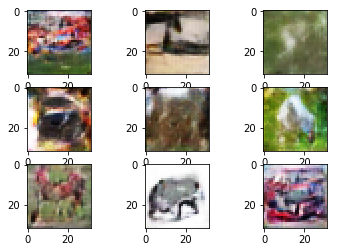

Epoch 60/60
64/64 [==============================] - 0s 603us/step - loss: -11.9957 - model_1_loss: -101.0907
Epoch 60/60
64/64 [==============================] - 0s 606us/step - loss: -28.5404 - model_1_loss: -79.2796
Epoch 60/60
64/64 [==============================] - 0s 653us/step - loss: -32.3302 - model_1_loss: -108.4904
Epoch 60/60
64/64 [==============================] - 0s 639us/step - loss: -23.5372 - model_1_loss: -101.5092
Epoch 60/60
64/64 [==============================] - 0s 622us/step - loss: -28.2031 - model_1_loss: -93.4676
Epoch 60/60
64/64 [==============================] - 0s 708us/step - loss: 80.5524


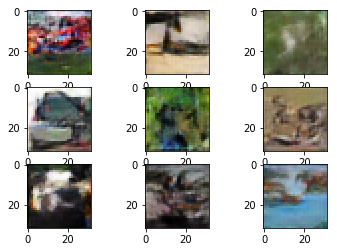

Epoch 70/70
64/64 [==============================] - 0s 585us/step - loss: -8.2032 - model_1_loss: -97.3462
Epoch 70/70
64/64 [==============================] - 0s 623us/step - loss: -18.3511 - model_1_loss: -92.8057
Epoch 70/70
64/64 [==============================] - 0s 613us/step - loss: -16.2613 - model_1_loss: -93.2028
Epoch 70/70
64/64 [==============================] - 0s 648us/step - loss: -35.0161 - model_1_loss: -98.1368
Epoch 70/70
64/64 [==============================] - 0s 630us/step - loss: -42.9068 - model_1_loss: -106.1436
Epoch 70/70
64/64 [==============================] - 0s 710us/step - loss: 109.9154


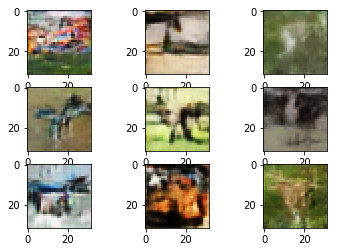

Epoch 80/80
64/64 [==============================] - 0s 594us/step - loss: -9.2010 - model_1_loss: -126.7257
Epoch 80/80
64/64 [==============================] - 0s 640us/step - loss: -26.0050 - model_1_loss: -150.0741
Epoch 80/80
64/64 [==============================] - 0s 620us/step - loss: -24.4486 - model_1_loss: -140.5144
Epoch 80/80
64/64 [==============================] - 0s 627us/step - loss: -31.4770 - model_1_loss: -130.1526
Epoch 80/80
64/64 [==============================] - 0s 638us/step - loss: -25.0630 - model_1_loss: -132.9877
Epoch 80/80
64/64 [==============================] - 0s 704us/step - loss: 113.8654


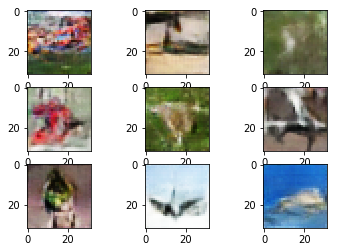

Epoch 90/90
64/64 [==============================] - 0s 592us/step - loss: -22.6129 - model_1_loss: -79.2028
Epoch 90/90
64/64 [==============================] - 0s 626us/step - loss: -27.6860 - model_1_loss: -87.5199
Epoch 90/90
64/64 [==============================] - 0s 633us/step - loss: -19.2168 - model_1_loss: -37.6741
Epoch 90/90
64/64 [==============================] - 0s 618us/step - loss: -35.0520 - model_1_loss: -56.9663
Epoch 90/90
64/64 [==============================] - 0s 632us/step - loss: -34.0427 - model_1_loss: -69.9773
Epoch 90/90
64/64 [==============================] - 0s 735us/step - loss: 68.0305


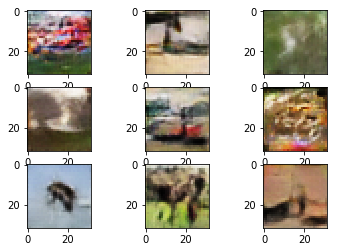

Epoch 100/100
64/64 [==============================] - 0s 590us/step - loss: -17.5414 - model_1_loss: -102.3182
Epoch 100/100
64/64 [==============================] - 0s 622us/step - loss: -13.6786 - model_1_loss: -84.6627
Epoch 100/100
64/64 [==============================] - 0s 641us/step - loss: -24.2690 - model_1_loss: -82.4518
Epoch 100/100
64/64 [==============================] - 0s 640us/step - loss: -45.6793 - model_1_loss: -80.5861
Epoch 100/100
64/64 [==============================] - 0s 641us/step - loss: -24.0578 - model_1_loss: -53.2402
Epoch 100/100
64/64 [==============================] - 0s 721us/step - loss: 68.8467


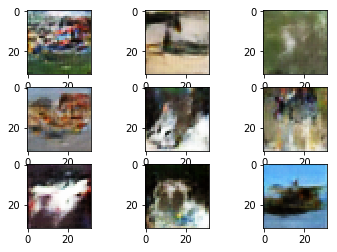

Epoch 110/110
64/64 [==============================] - 0s 598us/step - loss: -25.3494 - model_1_loss: -72.9366
Epoch 110/110
64/64 [==============================] - 0s 609us/step - loss: -28.3606 - model_1_loss: -66.1201
Epoch 110/110
64/64 [==============================] - 0s 625us/step - loss: -32.0530 - model_1_loss: -79.7125
Epoch 110/110
64/64 [==============================] - 0s 628us/step - loss: -22.7381 - model_1_loss: -64.1647
Epoch 110/110
64/64 [==============================] - 0s 636us/step - loss: -35.0817 - model_1_loss: -77.6620
Epoch 110/110
64/64 [==============================] - 0s 712us/step - loss: 70.8161


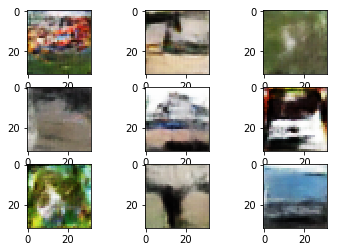

Epoch 120/120
64/64 [==============================] - 0s 599us/step - loss: -15.2095 - model_1_loss: -73.2392
Epoch 120/120
64/64 [==============================] - 0s 628us/step - loss: -22.1923 - model_1_loss: -102.5428
Epoch 120/120
64/64 [==============================] - 0s 638us/step - loss: -14.3772 - model_1_loss: -105.1179
Epoch 120/120
64/64 [==============================] - 0s 619us/step - loss: -11.3801 - model_1_loss: -81.2828
Epoch 120/120
64/64 [==============================] - 0s 619us/step - loss: -15.5297 - model_1_loss: -101.9250
Epoch 120/120
64/64 [==============================] - 0s 712us/step - loss: 109.0032


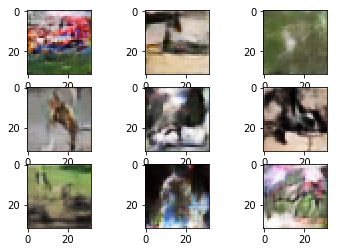

Epoch 130/130
64/64 [==============================] - 0s 585us/step - loss: -23.9333 - model_1_loss: -65.0284
Epoch 130/130
64/64 [==============================] - 0s 635us/step - loss: -16.4666 - model_1_loss: -86.0414
Epoch 130/130
64/64 [==============================] - 0s 638us/step - loss: -9.9141 - model_1_loss: -87.8763
Epoch 130/130
64/64 [==============================] - 0s 629us/step - loss: -18.7824 - model_1_loss: -83.2789
Epoch 130/130
64/64 [==============================] - 0s 636us/step - loss: -28.5479 - model_1_loss: -92.2680
Epoch 130/130
64/64 [==============================] - 0s 701us/step - loss: 103.3415


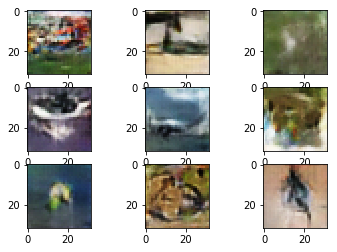

Epoch 140/140
64/64 [==============================] - 0s 586us/step - loss: -8.9823 - model_1_loss: -85.3870
Epoch 140/140
64/64 [==============================] - 0s 624us/step - loss: -10.7699 - model_1_loss: -47.5443
Epoch 140/140
64/64 [==============================] - 0s 619us/step - loss: -30.4771 - model_1_loss: -97.5286
Epoch 140/140
64/64 [==============================] - 0s 630us/step - loss: -30.9404 - model_1_loss: -81.1000
Epoch 140/140
64/64 [==============================] - 0s 624us/step - loss: -12.6477 - model_1_loss: -87.4325
Epoch 140/140
64/64 [==============================] - 0s 725us/step - loss: 85.9095


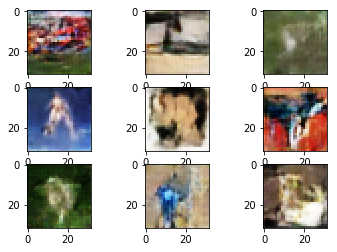

Epoch 150/150
64/64 [==============================] - 0s 606us/step - loss: -19.2817 - model_1_loss: -69.9729
Epoch 150/150
64/64 [==============================] - 0s 629us/step - loss: -22.9218 - model_1_loss: -44.2042
Epoch 150/150
64/64 [==============================] - 0s 637us/step - loss: -23.7452 - model_1_loss: -66.1769
Epoch 150/150
64/64 [==============================] - 0s 644us/step - loss: -17.3787 - model_1_loss: -64.1906
Epoch 150/150
64/64 [==============================] - 0s 620us/step - loss: -30.4514 - model_1_loss: -90.6700
Epoch 150/150
64/64 [==============================] - 0s 700us/step - loss: 86.0540


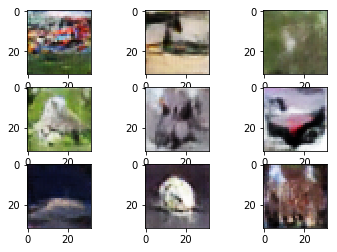

Epoch 160/160
64/64 [==============================] - 0s 611us/step - loss: -10.3494 - model_1_loss: -59.7366
Epoch 160/160
64/64 [==============================] - 0s 631us/step - loss: -25.6692 - model_1_loss: -62.5108
Epoch 160/160
64/64 [==============================] - 0s 635us/step - loss: -27.2355 - model_1_loss: -60.0057
Epoch 160/160
64/64 [==============================] - 0s 622us/step - loss: -39.8978 - model_1_loss: -70.2313
Epoch 160/160
64/64 [==============================] - 0s 623us/step - loss: -32.9553 - model_1_loss: -81.8398
Epoch 160/160
64/64 [==============================] - 0s 712us/step - loss: 94.2609


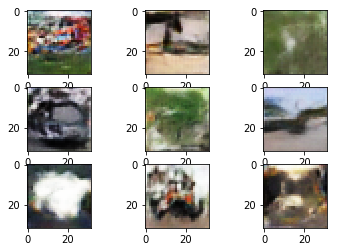

Epoch 170/170
64/64 [==============================] - 0s 599us/step - loss: -27.7002 - model_1_loss: -78.7499
Epoch 170/170
64/64 [==============================] - 0s 597us/step - loss: -26.0772 - model_1_loss: -74.8994
Epoch 170/170
64/64 [==============================] - 0s 636us/step - loss: -14.9333 - model_1_loss: -89.0994
Epoch 170/170
64/64 [==============================] - 0s 631us/step - loss: -23.3206 - model_1_loss: -79.5995
Epoch 170/170
64/64 [==============================] - 0s 653us/step - loss: -27.1386 - model_1_loss: -65.8040
Epoch 170/170
64/64 [==============================] - 0s 746us/step - loss: 70.7278


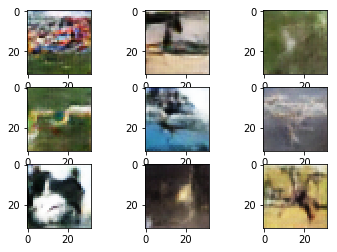

Epoch 180/180
64/64 [==============================] - 0s 605us/step - loss: -32.6205 - model_1_loss: -153.0467
Epoch 180/180
64/64 [==============================] - 0s 635us/step - loss: -28.9428 - model_1_loss: -138.4434
Epoch 180/180
64/64 [==============================] - 0s 630us/step - loss: -28.9699 - model_1_loss: -137.4401
Epoch 180/180
64/64 [==============================] - 0s 629us/step - loss: -19.1868 - model_1_loss: -120.4294
Epoch 180/180
64/64 [==============================] - 0s 626us/step - loss: -27.2222 - model_1_loss: -116.6998
Epoch 180/180
64/64 [==============================] - 0s 726us/step - loss: 97.4821


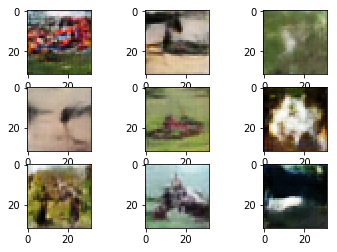

Epoch 190/190
64/64 [==============================] - 0s 606us/step - loss: -16.3861 - model_1_loss: -47.8093
Epoch 190/190
64/64 [==============================] - 0s 635us/step - loss: -27.5609 - model_1_loss: -68.0429
Epoch 190/190
64/64 [==============================] - 0s 622us/step - loss: -19.6496 - model_1_loss: -51.7895
Epoch 190/190
64/64 [==============================] - 0s 638us/step - loss: -25.2939 - model_1_loss: -68.3867
Epoch 190/190
64/64 [==============================] - 0s 642us/step - loss: -27.0092 - model_1_loss: -57.2594
Epoch 190/190
64/64 [==============================] - 0s 700us/step - loss: 47.8646


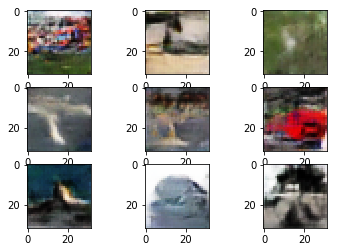

Epoch 200/200
64/64 [==============================] - 0s 643us/step - loss: -18.0960 - model_1_loss: -120.1356
Epoch 200/200
64/64 [==============================] - 0s 671us/step - loss: -14.9685 - model_1_loss: -121.7228
Epoch 200/200
64/64 [==============================] - 0s 651us/step - loss: -25.1229 - model_1_loss: -104.2905
Epoch 200/200
64/64 [==============================] - 0s 684us/step - loss: -26.6238 - model_1_loss: -122.2946
Epoch 200/200
64/64 [==============================] - 0s 666us/step - loss: -35.1747 - model_1_loss: -132.5273
Epoch 200/200
64/64 [==============================] - 0s 757us/step - loss: 120.8773


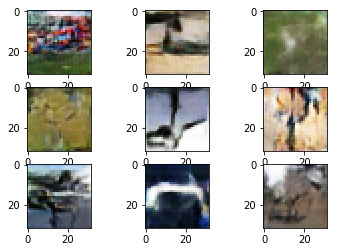

Epoch 210/210
64/64 [==============================] - 0s 590us/step - loss: -5.4002 - model_1_loss: -89.5894
Epoch 210/210
64/64 [==============================] - 0s 659us/step - loss: -8.7964 - model_1_loss: -99.2008
Epoch 210/210
64/64 [==============================] - 0s 658us/step - loss: -20.2316 - model_1_loss: -93.7534
Epoch 210/210
64/64 [==============================] - 0s 639us/step - loss: -22.2588 - model_1_loss: -94.7441
Epoch 210/210
64/64 [==============================] - 0s 625us/step - loss: -25.2919 - model_1_loss: -72.6847
Epoch 210/210
64/64 [==============================] - 0s 710us/step - loss: 46.9055


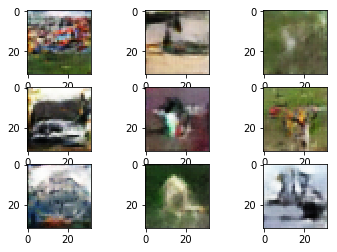

Epoch 220/220
64/64 [==============================] - 0s 608us/step - loss: -24.1405 - model_1_loss: -132.2779
Epoch 220/220
64/64 [==============================] - 0s 644us/step - loss: -24.7161 - model_1_loss: -117.9942
Epoch 220/220
64/64 [==============================] - 0s 625us/step - loss: -24.1182 - model_1_loss: -98.8516
Epoch 220/220
64/64 [==============================] - 0s 626us/step - loss: -23.5755 - model_1_loss: -83.1784
Epoch 220/220
64/64 [==============================] - 0s 631us/step - loss: -39.9885 - model_1_loss: -88.5638
Epoch 220/220
64/64 [==============================] - 0s 726us/step - loss: 92.2605


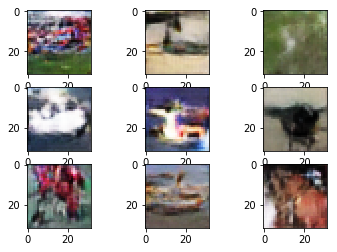

Epoch 230/230
64/64 [==============================] - 0s 592us/step - loss: -19.6779 - model_1_loss: -95.2281
Epoch 230/230
64/64 [==============================] - 0s 616us/step - loss: -27.2989 - model_1_loss: -109.4198
Epoch 230/230
64/64 [==============================] - 0s 645us/step - loss: -27.7246 - model_1_loss: -89.5312
Epoch 230/230
64/64 [==============================] - 0s 647us/step - loss: -18.4231 - model_1_loss: -71.5544
Epoch 230/230
64/64 [==============================] - 0s 633us/step - loss: -27.1681 - model_1_loss: -64.5108
Epoch 230/230
64/64 [==============================] - 0s 702us/step - loss: 55.0372


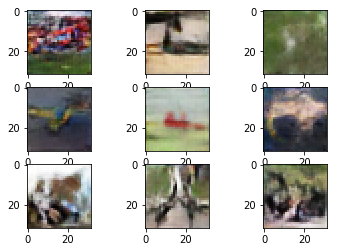

Epoch 240/240
64/64 [==============================] - 0s 670us/step - loss: -8.9671 - model_1_loss: -51.5574
Epoch 240/240
64/64 [==============================] - 0s 658us/step - loss: -15.9155 - model_1_loss: -71.9967
Epoch 240/240
64/64 [==============================] - 0s 635us/step - loss: -31.1615 - model_1_loss: -100.7632
Epoch 240/240
64/64 [==============================] - 0s 634us/step - loss: -34.0728 - model_1_loss: -104.5416
Epoch 240/240
64/64 [==============================] - 0s 645us/step - loss: -34.2631 - model_1_loss: -112.3788
Epoch 240/240
64/64 [==============================] - 0s 718us/step - loss: 98.4739


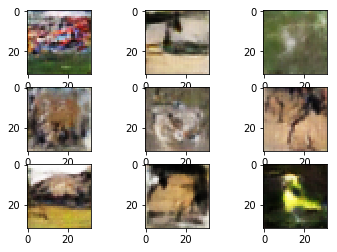

Epoch 250/250
64/64 [==============================] - 0s 613us/step - loss: -17.1179 - model_1_loss: -96.2745
Epoch 250/250
64/64 [==============================] - 0s 665us/step - loss: -20.5584 - model_1_loss: -126.9612
Epoch 250/250
64/64 [==============================] - 0s 631us/step - loss: -27.0807 - model_1_loss: -102.8137
Epoch 250/250
64/64 [==============================] - 0s 634us/step - loss: -19.7687 - model_1_loss: -96.3243
Epoch 250/250
64/64 [==============================] - 0s 655us/step - loss: -34.0939 - model_1_loss: -93.0175
Epoch 250/250
64/64 [==============================] - 0s 720us/step - loss: 64.0621


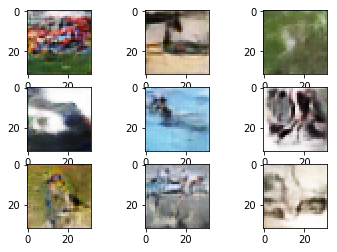

Epoch 260/260
64/64 [==============================] - 0s 601us/step - loss: -10.4940 - model_1_loss: -71.7190
Epoch 260/260
64/64 [==============================] - 0s 634us/step - loss: -31.5595 - model_1_loss: -109.9818
Epoch 260/260
64/64 [==============================] - 0s 623us/step - loss: -23.1537 - model_1_loss: -95.1418
Epoch 260/260
64/64 [==============================] - 0s 658us/step - loss: -23.9283 - model_1_loss: -99.6080
Epoch 260/260
64/64 [==============================] - 0s 636us/step - loss: -18.9624 - model_1_loss: -56.1943
Epoch 260/260
64/64 [==============================] - 0s 715us/step - loss: 76.5700


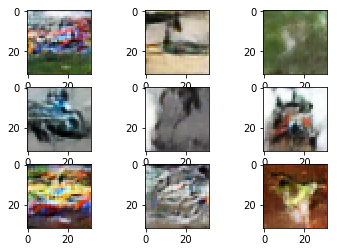

Epoch 270/270
64/64 [==============================] - 0s 611us/step - loss: 2.0452 - model_1_loss: -74.8078
Epoch 270/270
64/64 [==============================] - 0s 643us/step - loss: -5.5611 - model_1_loss: -77.2719
Epoch 270/270
64/64 [==============================] - 0s 642us/step - loss: -23.1875 - model_1_loss: -66.0965
Epoch 270/270
64/64 [==============================] - 0s 627us/step - loss: -20.8773 - model_1_loss: -89.6221
Epoch 270/270
64/64 [==============================] - 0s 633us/step - loss: -44.9968 - model_1_loss: -114.9591
Epoch 270/270
64/64 [==============================] - 0s 710us/step - loss: 104.8580


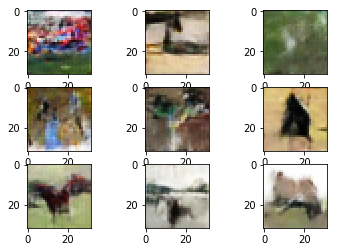

Epoch 280/280
64/64 [==============================] - 0s 628us/step - loss: -10.3219 - model_1_loss: -87.2784
Epoch 280/280
64/64 [==============================] - 0s 645us/step - loss: -16.2219 - model_1_loss: -85.0630
Epoch 280/280
64/64 [==============================] - 0s 634us/step - loss: -28.6288 - model_1_loss: -111.2984
Epoch 280/280
64/64 [==============================] - 0s 636us/step - loss: -27.8340 - model_1_loss: -105.7169
Epoch 280/280
64/64 [==============================] - 0s 637us/step - loss: -22.8642 - model_1_loss: -101.4579
Epoch 280/280
64/64 [==============================] - 0s 725us/step - loss: 93.9193


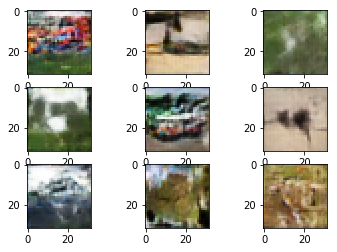

Epoch 290/290
64/64 [==============================] - 0s 595us/step - loss: -17.5551 - model_1_loss: -72.6621
Epoch 290/290
64/64 [==============================] - 0s 625us/step - loss: -1.3161 - model_1_loss: -83.3316
Epoch 290/290
64/64 [==============================] - 0s 629us/step - loss: -22.2720 - model_1_loss: -110.4412
Epoch 290/290
64/64 [==============================] - 0s 629us/step - loss: -13.5888 - model_1_loss: -124.0198
Epoch 290/290
64/64 [==============================] - 0s 626us/step - loss: -27.9030 - model_1_loss: -129.2542
Epoch 290/290
64/64 [==============================] - 0s 704us/step - loss: 113.7433


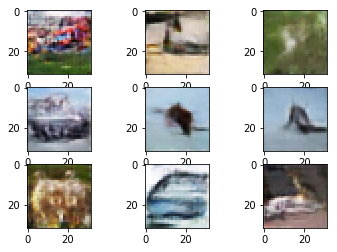

Epoch 300/300
64/64 [==============================] - 0s 600us/step - loss: -16.8199 - model_1_loss: -54.4513
Epoch 300/300
64/64 [==============================] - 0s 629us/step - loss: -27.7575 - model_1_loss: -83.9294
Epoch 300/300
64/64 [==============================] - 0s 627us/step - loss: -19.8286 - model_1_loss: -103.2939
Epoch 300/300
64/64 [==============================] - 0s 638us/step - loss: -27.9627 - model_1_loss: -77.4646
Epoch 300/300
64/64 [==============================] - 0s 640us/step - loss: -30.4535 - model_1_loss: -97.0174
Epoch 300/300
64/64 [==============================] - 0s 702us/step - loss: 126.4618


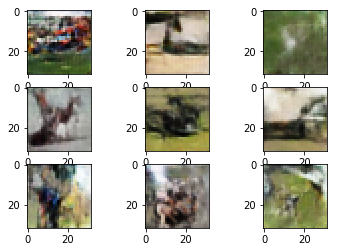

Epoch 310/310
64/64 [==============================] - 0s 604us/step - loss: -31.7862 - model_1_loss: -109.6327
Epoch 310/310
64/64 [==============================] - 0s 624us/step - loss: -25.2707 - model_1_loss: -129.2479
Epoch 310/310
64/64 [==============================] - 0s 629us/step - loss: -22.4306 - model_1_loss: -113.4473
Epoch 310/310
64/64 [==============================] - 0s 650us/step - loss: -15.7988 - model_1_loss: -124.0936
Epoch 310/310
64/64 [==============================] - 0s 633us/step - loss: -26.2915 - model_1_loss: -94.7408
Epoch 310/310
64/64 [==============================] - 0s 729us/step - loss: 64.1306


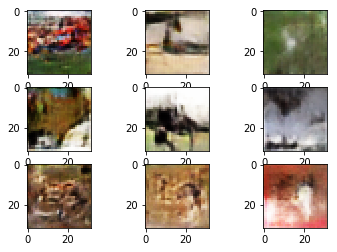

Epoch 320/320
64/64 [==============================] - 0s 611us/step - loss: -12.5646 - model_1_loss: -54.2538
Epoch 320/320
64/64 [==============================] - 0s 632us/step - loss: -21.6372 - model_1_loss: -76.7019
Epoch 320/320
64/64 [==============================] - 0s 633us/step - loss: -45.9608 - model_1_loss: -114.8100
Epoch 320/320
64/64 [==============================] - 0s 638us/step - loss: -23.5704 - model_1_loss: -102.3115
Epoch 320/320
64/64 [==============================] - 0s 626us/step - loss: -35.9487 - model_1_loss: -84.8033
Epoch 320/320
64/64 [==============================] - 0s 714us/step - loss: 80.0566


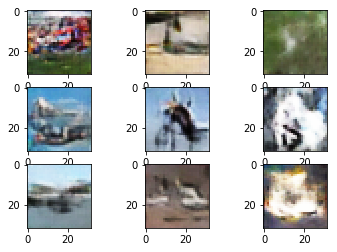

Epoch 330/330
64/64 [==============================] - 0s 634us/step - loss: -7.1992 - model_1_loss: -57.8886
Epoch 330/330
64/64 [==============================] - 0s 645us/step - loss: -2.9272 - model_1_loss: -87.2563
Epoch 330/330
64/64 [==============================] - 0s 650us/step - loss: -29.3860 - model_1_loss: -128.0569
Epoch 330/330
64/64 [==============================] - 0s 656us/step - loss: -30.4483 - model_1_loss: -101.4916
Epoch 330/330
64/64 [==============================] - 0s 637us/step - loss: -41.2847 - model_1_loss: -80.0771
Epoch 330/330
64/64 [==============================] - 0s 709us/step - loss: 71.4979


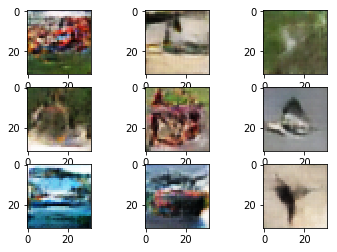

Epoch 340/340
64/64 [==============================] - 0s 606us/step - loss: -6.3205 - model_1_loss: -119.4499
Epoch 340/340
64/64 [==============================] - 0s 640us/step - loss: -35.2571 - model_1_loss: -97.6345
Epoch 340/340
64/64 [==============================] - 0s 633us/step - loss: -25.1883 - model_1_loss: -94.7885
Epoch 340/340
64/64 [==============================] - 0s 642us/step - loss: -37.9180 - model_1_loss: -72.5907
Epoch 340/340
64/64 [==============================] - 0s 621us/step - loss: -34.5933 - model_1_loss: -56.0039
Epoch 340/340
64/64 [==============================] - 0s 719us/step - loss: 5.1173


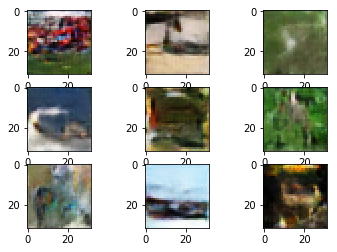

Epoch 350/350
64/64 [==============================] - 0s 622us/step - loss: 0.7753 - model_1_loss: -75.7300
Epoch 350/350
64/64 [==============================] - 0s 627us/step - loss: -19.7048 - model_1_loss: -90.3541
Epoch 350/350
64/64 [==============================] - 0s 633us/step - loss: -39.2145 - model_1_loss: -122.3056
Epoch 350/350
64/64 [==============================] - 0s 641us/step - loss: -20.5015 - model_1_loss: -119.1934
Epoch 350/350
64/64 [==============================] - 0s 631us/step - loss: -40.3778 - model_1_loss: -118.4568
Epoch 350/350
64/64 [==============================] - 0s 710us/step - loss: 105.1392


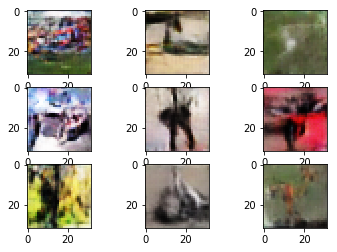

Epoch 360/360
64/64 [==============================] - 0s 648us/step - loss: -9.9010 - model_1_loss: -108.2546
Epoch 360/360
64/64 [==============================] - 0s 666us/step - loss: -23.9393 - model_1_loss: -118.0803
Epoch 360/360
64/64 [==============================] - 0s 636us/step - loss: -18.7704 - model_1_loss: -93.9088
Epoch 360/360
64/64 [==============================] - 0s 640us/step - loss: -17.5870 - model_1_loss: -94.2020
Epoch 360/360
64/64 [==============================] - 0s 625us/step - loss: -52.0692 - model_1_loss: -105.1332
Epoch 360/360
64/64 [==============================] - 0s 802us/step - loss: 98.6902


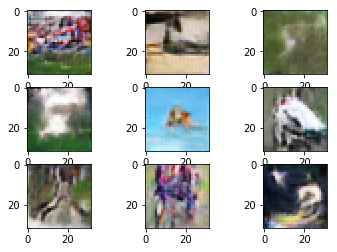

Epoch 370/370
64/64 [==============================] - 0s 633us/step - loss: -23.6926 - model_1_loss: -105.4736
Epoch 370/370
64/64 [==============================] - 0s 637us/step - loss: -29.6478 - model_1_loss: -94.8092
Epoch 370/370
64/64 [==============================] - 0s 634us/step - loss: -17.2742 - model_1_loss: -73.1978
Epoch 370/370
64/64 [==============================] - 0s 623us/step - loss: -34.5489 - model_1_loss: -97.6335
Epoch 370/370
64/64 [==============================] - 0s 653us/step - loss: -30.9375 - model_1_loss: -103.1149
Epoch 370/370
64/64 [==============================] - 0s 711us/step - loss: 80.5526


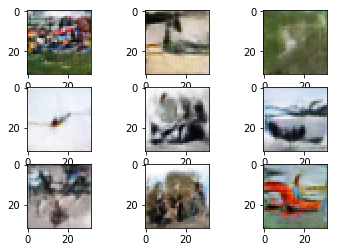

Epoch 380/380
64/64 [==============================] - 0s 616us/step - loss: -12.2475 - model_1_loss: -106.1745
Epoch 380/380
64/64 [==============================] - 0s 648us/step - loss: -31.0489 - model_1_loss: -123.9215
Epoch 380/380
64/64 [==============================] - 0s 624us/step - loss: -31.3543 - model_1_loss: -109.5559
Epoch 380/380
64/64 [==============================] - 0s 631us/step - loss: -14.0205 - model_1_loss: -81.3401
Epoch 380/380
64/64 [==============================] - 0s 649us/step - loss: -22.1294 - model_1_loss: -85.9531
Epoch 380/380
64/64 [==============================] - 0s 712us/step - loss: 87.3413


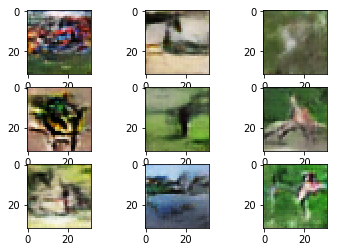

Epoch 390/390
64/64 [==============================] - 0s 607us/step - loss: -10.2989 - model_1_loss: -76.5298
Epoch 390/390
64/64 [==============================] - 0s 639us/step - loss: -19.4892 - model_1_loss: -79.2492
Epoch 390/390
64/64 [==============================] - 0s 644us/step - loss: -34.7430 - model_1_loss: -93.4371
Epoch 390/390
64/64 [==============================] - 0s 640us/step - loss: -30.9983 - model_1_loss: -73.8054
Epoch 390/390
64/64 [==============================] - 0s 622us/step - loss: -32.7317 - model_1_loss: -65.2385
Epoch 390/390
64/64 [==============================] - 0s 719us/step - loss: 52.6753


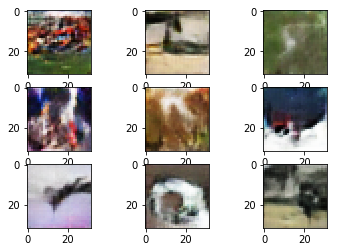

Epoch 400/400
64/64 [==============================] - 0s 600us/step - loss: -16.3598 - model_1_loss: -104.0901
Epoch 400/400
64/64 [==============================] - 0s 620us/step - loss: -16.0335 - model_1_loss: -93.2539
Epoch 400/400
64/64 [==============================] - 0s 636us/step - loss: -19.0904 - model_1_loss: -76.8949
Epoch 400/400
64/64 [==============================] - 0s 625us/step - loss: -33.0601 - model_1_loss: -86.1427
Epoch 400/400
64/64 [==============================] - 0s 638us/step - loss: -25.2614 - model_1_loss: -5.7471
Epoch 400/400
64/64 [==============================] - 0s 708us/step - loss: 10.7537


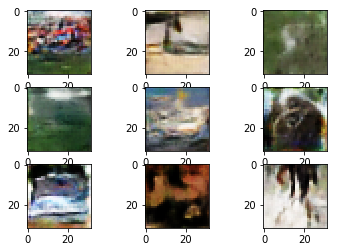

Epoch 410/410
64/64 [==============================] - 0s 594us/step - loss: -10.6935 - model_1_loss: -85.0698
Epoch 410/410
64/64 [==============================] - 0s 624us/step - loss: -20.8634 - model_1_loss: -97.0873
Epoch 410/410
64/64 [==============================] - 0s 640us/step - loss: -22.7990 - model_1_loss: -97.5742
Epoch 410/410
64/64 [==============================] - 0s 631us/step - loss: -26.9185 - model_1_loss: -88.8855
Epoch 410/410
64/64 [==============================] - 0s 637us/step - loss: -28.6480 - model_1_loss: -110.5404
Epoch 410/410
64/64 [==============================] - 0s 717us/step - loss: 104.9820


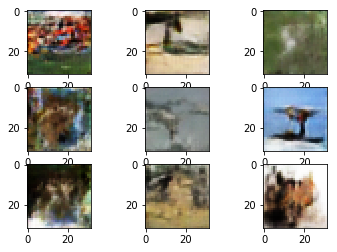

Epoch 420/420
64/64 [==============================] - 0s 597us/step - loss: -7.8934 - model_1_loss: -141.6721
Epoch 420/420
64/64 [==============================] - 0s 639us/step - loss: -16.3769 - model_1_loss: -122.0610
Epoch 420/420
64/64 [==============================] - 0s 641us/step - loss: -15.1813 - model_1_loss: -90.5414
Epoch 420/420
64/64 [==============================] - 0s 636us/step - loss: -20.9908 - model_1_loss: -72.4439
Epoch 420/420
64/64 [==============================] - 0s 654us/step - loss: -17.4478 - model_1_loss: -119.9208
Epoch 420/420
64/64 [==============================] - 0s 720us/step - loss: 135.1084


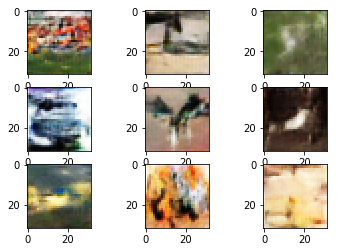

Epoch 430/430
64/64 [==============================] - 0s 602us/step - loss: -18.9728 - model_1_loss: -63.8732
Epoch 430/430
64/64 [==============================] - 0s 654us/step - loss: -12.0312 - model_1_loss: -77.9522
Epoch 430/430
64/64 [==============================] - 0s 635us/step - loss: -38.2957 - model_1_loss: -126.5917
Epoch 430/430
64/64 [==============================] - 0s 645us/step - loss: -43.3806 - model_1_loss: -118.6164
Epoch 430/430
64/64 [==============================] - 0s 630us/step - loss: -29.3500 - model_1_loss: -134.5454
Epoch 430/430
64/64 [==============================] - 0s 715us/step - loss: 134.7644


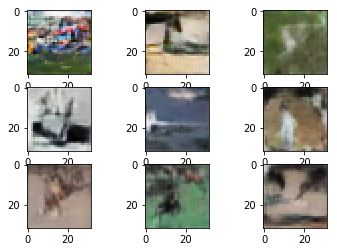

Epoch 440/440
64/64 [==============================] - 0s 619us/step - loss: -2.7592 - model_1_loss: -37.5974
Epoch 440/440
64/64 [==============================] - 0s 646us/step - loss: -15.2030 - model_1_loss: -62.6798
Epoch 440/440
64/64 [==============================] - 0s 640us/step - loss: -32.9026 - model_1_loss: -83.4023
Epoch 440/440
64/64 [==============================] - 0s 636us/step - loss: -32.8922 - model_1_loss: -67.0847
Epoch 440/440
64/64 [==============================] - 0s 632us/step - loss: -28.4599 - model_1_loss: -62.2414
Epoch 440/440
64/64 [==============================] - 0s 716us/step - loss: 73.6294


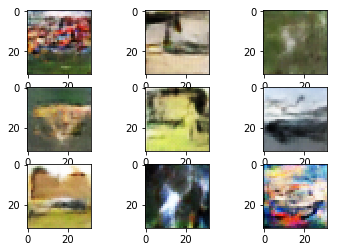

Epoch 450/450
64/64 [==============================] - 0s 598us/step - loss: -13.2932 - model_1_loss: -100.5326
Epoch 450/450
64/64 [==============================] - 0s 637us/step - loss: -32.6830 - model_1_loss: -92.9860
Epoch 450/450
64/64 [==============================] - 0s 626us/step - loss: -26.1212 - model_1_loss: -66.0027
Epoch 450/450
64/64 [==============================] - 0s 655us/step - loss: -36.6317 - model_1_loss: -55.7046
Epoch 450/450
64/64 [==============================] - 0s 615us/step - loss: -41.4959 - model_1_loss: -79.0843
Epoch 450/450
64/64 [==============================] - 0s 712us/step - loss: 63.6299


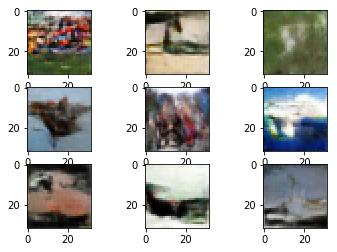

Epoch 460/460
64/64 [==============================] - 0s 657us/step - loss: -0.9902 - model_1_loss: -74.3836
Epoch 460/460
64/64 [==============================] - 0s 726us/step - loss: -14.1456 - model_1_loss: -104.0171
Epoch 460/460
64/64 [==============================] - 0s 715us/step - loss: -20.0448 - model_1_loss: -125.1310
Epoch 460/460
64/64 [==============================] - 0s 687us/step - loss: -26.6263 - model_1_loss: -124.1829
Epoch 460/460
64/64 [==============================] - 0s 697us/step - loss: -31.6349 - model_1_loss: -151.6360
Epoch 460/460
64/64 [==============================] - 0s 788us/step - loss: 147.2059


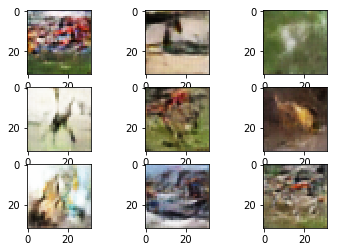

Epoch 470/470
64/64 [==============================] - 0s 602us/step - loss: -15.2649 - model_1_loss: -52.6460
Epoch 470/470
64/64 [==============================] - 0s 633us/step - loss: -10.1835 - model_1_loss: -68.0291
Epoch 470/470
64/64 [==============================] - 0s 638us/step - loss: -18.3401 - model_1_loss: -110.5321
Epoch 470/470
64/64 [==============================] - 0s 635us/step - loss: -34.6037 - model_1_loss: -119.7864
Epoch 470/470
64/64 [==============================] - 0s 638us/step - loss: -29.3070 - model_1_loss: -131.1709
Epoch 470/470
64/64 [==============================] - 0s 712us/step - loss: 135.6048


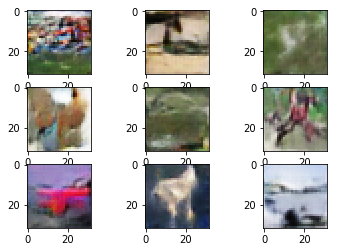

Epoch 480/480
64/64 [==============================] - 0s 615us/step - loss: -9.9362 - model_1_loss: -83.8451
Epoch 480/480
64/64 [==============================] - 0s 634us/step - loss: -25.9746 - model_1_loss: -116.3814
Epoch 480/480
64/64 [==============================] - 0s 644us/step - loss: -11.1555 - model_1_loss: -85.6020
Epoch 480/480
64/64 [==============================] - 0s 642us/step - loss: -26.3318 - model_1_loss: -110.8577
Epoch 480/480
64/64 [==============================] - 0s 635us/step - loss: -25.6227 - model_1_loss: -107.7978
Epoch 480/480
64/64 [==============================] - 0s 729us/step - loss: 100.4454


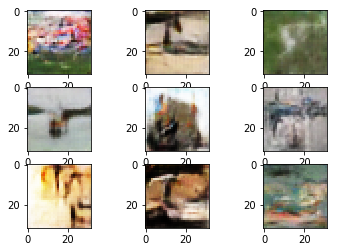

Epoch 490/490
64/64 [==============================] - 0s 615us/step - loss: -27.2860 - model_1_loss: -79.5622
Epoch 490/490
64/64 [==============================] - 0s 655us/step - loss: -16.9648 - model_1_loss: -109.8751
Epoch 490/490
64/64 [==============================] - 0s 635us/step - loss: -21.5687 - model_1_loss: -111.3288
Epoch 490/490
64/64 [==============================] - 0s 648us/step - loss: -42.3855 - model_1_loss: -113.7227
Epoch 490/490
64/64 [==============================] - 0s 636us/step - loss: -9.4166 - model_1_loss: -92.4326
Epoch 490/490
64/64 [==============================] - 0s 704us/step - loss: 89.7453


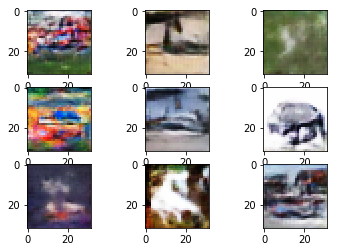

Epoch 500/500
64/64 [==============================] - 0s 624us/step - loss: -8.3435 - model_1_loss: -103.4755
Epoch 500/500
64/64 [==============================] - 0s 657us/step - loss: -33.6049 - model_1_loss: -136.3061
Epoch 500/500
64/64 [==============================] - 0s 630us/step - loss: -24.4190 - model_1_loss: -123.7673
Epoch 500/500
64/64 [==============================] - 0s 639us/step - loss: -28.6779 - model_1_loss: -135.5439
Epoch 500/500
64/64 [==============================] - 0s 645us/step - loss: -32.4564 - model_1_loss: -113.5043
Epoch 500/500
64/64 [==============================] - 0s 716us/step - loss: 73.4747


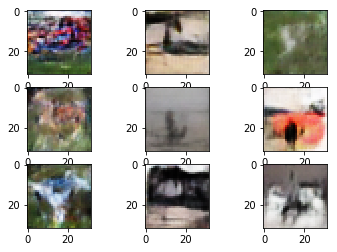

Epoch 510/510
64/64 [==============================] - 0s 633us/step - loss: -17.7110 - model_1_loss: -103.8275
Epoch 510/510
64/64 [==============================] - 0s 640us/step - loss: -33.9603 - model_1_loss: -67.6848
Epoch 510/510
64/64 [==============================] - 0s 644us/step - loss: -26.7741 - model_1_loss: -103.5547
Epoch 510/510
64/64 [==============================] - 0s 650us/step - loss: -25.4846 - model_1_loss: -114.6627
Epoch 510/510
64/64 [==============================] - 0s 655us/step - loss: -23.1345 - model_1_loss: -113.5536
Epoch 510/510
64/64 [==============================] - 0s 729us/step - loss: 105.2197


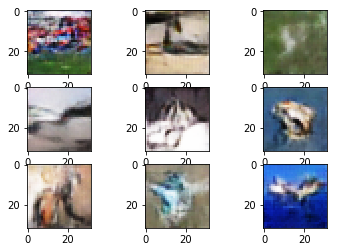

Epoch 520/520
64/64 [==============================] - 0s 626us/step - loss: -19.5967 - model_1_loss: -68.1758
Epoch 520/520
64/64 [==============================] - 0s 638us/step - loss: -17.3953 - model_1_loss: -67.4414
Epoch 520/520
64/64 [==============================] - 0s 641us/step - loss: -36.1318 - model_1_loss: -93.8206
Epoch 520/520
64/64 [==============================] - 0s 649us/step - loss: -24.1368 - model_1_loss: -88.1274
Epoch 520/520
64/64 [==============================] - 0s 631us/step - loss: -23.0402 - model_1_loss: -78.3443
Epoch 520/520
64/64 [==============================] - 0s 714us/step - loss: 72.0708


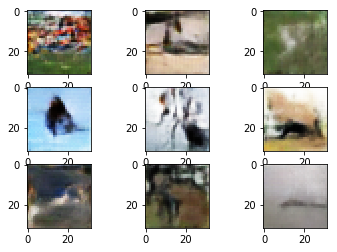

Epoch 530/530
64/64 [==============================] - 0s 620us/step - loss: -12.4925 - model_1_loss: -61.1443
Epoch 530/530
64/64 [==============================] - 0s 657us/step - loss: -16.0794 - model_1_loss: -70.3493
Epoch 530/530
64/64 [==============================] - 0s 642us/step - loss: -26.4317 - model_1_loss: -64.4311
Epoch 530/530
64/64 [==============================] - 0s 638us/step - loss: -19.6439 - model_1_loss: -60.9948
Epoch 530/530
64/64 [==============================] - 0s 627us/step - loss: -20.1412 - model_1_loss: -63.9306
Epoch 530/530
64/64 [==============================] - 0s 726us/step - loss: 82.9348


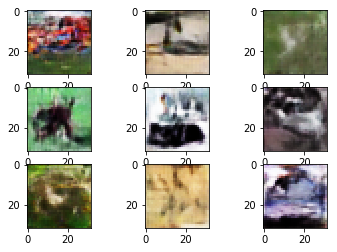

Epoch 540/540
64/64 [==============================] - 0s 620us/step - loss: -13.0110 - model_1_loss: -38.6688
Epoch 540/540
64/64 [==============================] - 0s 634us/step - loss: -6.2912 - model_1_loss: -29.9660
Epoch 540/540
64/64 [==============================] - 0s 635us/step - loss: -28.7876 - model_1_loss: -50.0744
Epoch 540/540
64/64 [==============================] - 0s 631us/step - loss: -31.4148 - model_1_loss: -51.3928
Epoch 540/540
64/64 [==============================] - 0s 625us/step - loss: -31.2812 - model_1_loss: -52.0954
Epoch 540/540
64/64 [==============================] - 0s 726us/step - loss: 51.2182


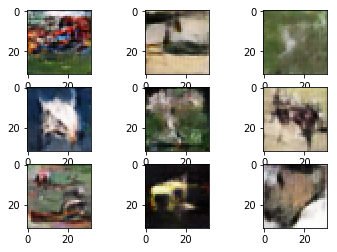

Epoch 550/550
64/64 [==============================] - 0s 618us/step - loss: -11.1627 - model_1_loss: -72.1560
Epoch 550/550
64/64 [==============================] - 0s 630us/step - loss: -29.3460 - model_1_loss: -117.3352
Epoch 550/550
64/64 [==============================] - 0s 624us/step - loss: -13.3689 - model_1_loss: -131.8498
Epoch 550/550
64/64 [==============================] - 0s 637us/step - loss: -21.9193 - model_1_loss: -120.6973
Epoch 550/550
64/64 [==============================] - 0s 649us/step - loss: -28.5828 - model_1_loss: -116.1472
Epoch 550/550
64/64 [==============================] - 0s 717us/step - loss: 74.6941


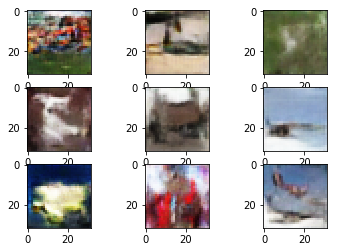

Epoch 560/560
64/64 [==============================] - 0s 609us/step - loss: -19.8296 - model_1_loss: -70.7509
Epoch 560/560
64/64 [==============================] - 0s 630us/step - loss: -23.5925 - model_1_loss: -61.1219
Epoch 560/560
64/64 [==============================] - 0s 645us/step - loss: -18.9482 - model_1_loss: -82.7934
Epoch 560/560
64/64 [==============================] - 0s 651us/step - loss: -26.8529 - model_1_loss: -68.6657
Epoch 560/560
64/64 [==============================] - 0s 640us/step - loss: -18.8094 - model_1_loss: -58.7503
Epoch 560/560
64/64 [==============================] - 0s 734us/step - loss: 70.5055


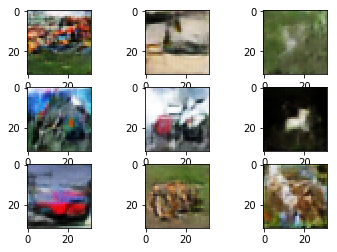

Epoch 570/570
64/64 [==============================] - 0s 610us/step - loss: -11.9543 - model_1_loss: -99.1925
Epoch 570/570
64/64 [==============================] - 0s 632us/step - loss: -18.6568 - model_1_loss: -94.4380
Epoch 570/570
64/64 [==============================] - 0s 636us/step - loss: -23.8179 - model_1_loss: -95.4466
Epoch 570/570
64/64 [==============================] - 0s 634us/step - loss: -16.2408 - model_1_loss: -83.1252
Epoch 570/570
64/64 [==============================] - 0s 636us/step - loss: -23.8633 - model_1_loss: -53.7753
Epoch 570/570
64/64 [==============================] - 0s 721us/step - loss: 22.6893


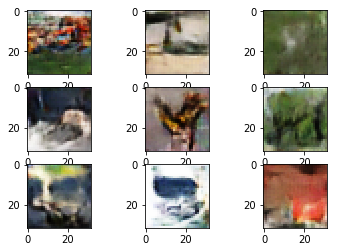

Epoch 580/580
64/64 [==============================] - 0s 632us/step - loss: -1.6145 - model_1_loss: -34.9004
Epoch 580/580
64/64 [==============================] - 0s 643us/step - loss: -18.2826 - model_1_loss: -64.3416
Epoch 580/580
64/64 [==============================] - 0s 632us/step - loss: -26.9446 - model_1_loss: -66.6076
Epoch 580/580
64/64 [==============================] - 0s 637us/step - loss: -23.0296 - model_1_loss: -27.2653
Epoch 580/580
64/64 [==============================] - 0s 621us/step - loss: -25.1207 - model_1_loss: -50.1648
Epoch 580/580
64/64 [==============================] - 0s 729us/step - loss: 60.2685


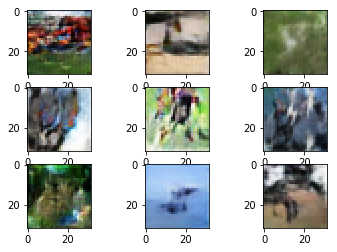

Epoch 590/590
64/64 [==============================] - 0s 603us/step - loss: -20.8086 - model_1_loss: -118.7135
Epoch 590/590
64/64 [==============================] - 0s 649us/step - loss: -28.3876 - model_1_loss: -106.7718
Epoch 590/590
64/64 [==============================] - 0s 754us/step - loss: -14.7419 - model_1_loss: -68.1575
Epoch 590/590
64/64 [==============================] - 0s 646us/step - loss: -26.8518 - model_1_loss: -67.6466
Epoch 590/590
64/64 [==============================] - 0s 642us/step - loss: -39.4992 - model_1_loss: -62.9022
Epoch 590/590
64/64 [==============================] - 0s 731us/step - loss: 24.7408


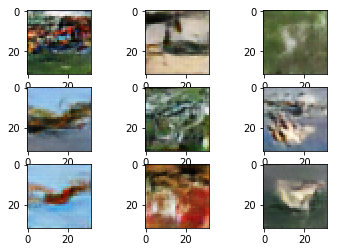

Epoch 600/600
64/64 [==============================] - 0s 606us/step - loss: -11.3175 - model_1_loss: -86.3406
Epoch 600/600
64/64 [==============================] - 0s 639us/step - loss: -23.9077 - model_1_loss: -85.9091
Epoch 600/600
64/64 [==============================] - 0s 631us/step - loss: -37.1234 - model_1_loss: -80.0923
Epoch 600/600
64/64 [==============================] - 0s 658us/step - loss: -40.4766 - model_1_loss: -86.5032
Epoch 600/600
64/64 [==============================] - 0s 651us/step - loss: -27.9861 - model_1_loss: -73.6657
Epoch 600/600
64/64 [==============================] - 0s 731us/step - loss: 52.0611


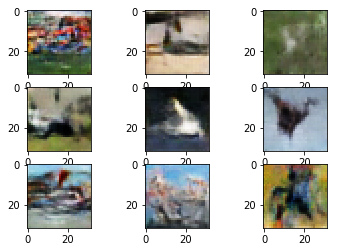

Epoch 610/610
64/64 [==============================] - 0s 645us/step - loss: -19.3435 - model_1_loss: -109.5483
Epoch 610/610
64/64 [==============================] - 0s 641us/step - loss: -24.2717 - model_1_loss: -79.9238
Epoch 610/610
64/64 [==============================] - 0s 635us/step - loss: -19.2524 - model_1_loss: -75.4083
Epoch 610/610
64/64 [==============================] - 0s 648us/step - loss: -27.5859 - model_1_loss: -62.9200
Epoch 610/610
64/64 [==============================] - 0s 681us/step - loss: -33.9281 - model_1_loss: -60.0915
Epoch 610/610
64/64 [==============================] - 0s 785us/step - loss: 44.9829


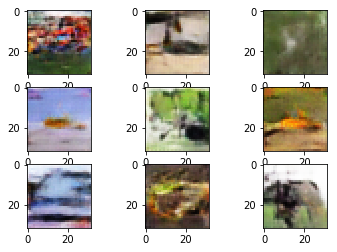

Epoch 620/620
64/64 [==============================] - 0s 606us/step - loss: -11.7661 - model_1_loss: -117.8653
Epoch 620/620
64/64 [==============================] - 0s 631us/step - loss: -31.9879 - model_1_loss: -117.7562
Epoch 620/620
64/64 [==============================] - 0s 642us/step - loss: -19.3981 - model_1_loss: -104.7393
Epoch 620/620
64/64 [==============================] - 0s 645us/step - loss: -32.5842 - model_1_loss: -125.9973
Epoch 620/620
64/64 [==============================] - 0s 633us/step - loss: -29.5018 - model_1_loss: -119.0675
Epoch 620/620
64/64 [==============================] - 0s 714us/step - loss: 114.5077


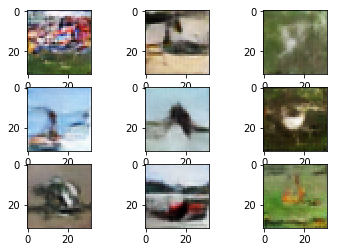

Epoch 630/630
64/64 [==============================] - 0s 609us/step - loss: -19.2718 - model_1_loss: -108.4857
Epoch 630/630
64/64 [==============================] - 0s 632us/step - loss: -7.9059 - model_1_loss: -125.9722
Epoch 630/630
64/64 [==============================] - 0s 632us/step - loss: -16.7876 - model_1_loss: -131.2732
Epoch 630/630
64/64 [==============================] - 0s 645us/step - loss: -29.4644 - model_1_loss: -135.6738
Epoch 630/630
64/64 [==============================] - 0s 634us/step - loss: -31.6388 - model_1_loss: -111.3211
Epoch 630/630
64/64 [==============================] - 0s 705us/step - loss: 100.8702


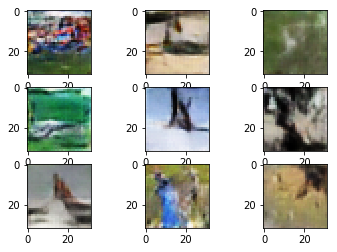

Epoch 640/640
64/64 [==============================] - 0s 625us/step - loss: -22.8985 - model_1_loss: -91.8735
Epoch 640/640
64/64 [==============================] - 0s 645us/step - loss: -32.8645 - model_1_loss: -91.5460
Epoch 640/640
64/64 [==============================] - 0s 641us/step - loss: -24.3407 - model_1_loss: -61.9208
Epoch 640/640
64/64 [==============================] - 0s 656us/step - loss: -22.6253 - model_1_loss: -52.3349
Epoch 640/640
64/64 [==============================] - 0s 632us/step - loss: -15.4897 - model_1_loss: -80.8390
Epoch 640/640
64/64 [==============================] - 0s 736us/step - loss: 80.4167


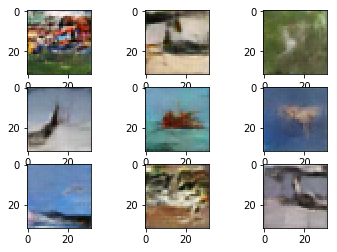

Epoch 650/650
64/64 [==============================] - 0s 612us/step - loss: -26.3946 - model_1_loss: -56.9008
Epoch 650/650
64/64 [==============================] - 0s 646us/step - loss: -12.6388 - model_1_loss: -53.3824
Epoch 650/650
64/64 [==============================] - 0s 643us/step - loss: -19.1676 - model_1_loss: -67.6003
Epoch 650/650
64/64 [==============================] - 0s 643us/step - loss: -39.3158 - model_1_loss: -84.8046
Epoch 650/650
64/64 [==============================] - 0s 645us/step - loss: -31.7467 - model_1_loss: -87.4250
Epoch 650/650
64/64 [==============================] - 0s 720us/step - loss: 77.5729


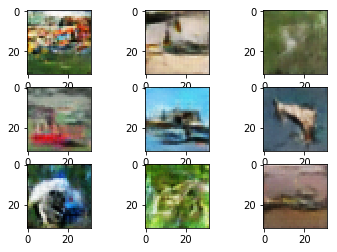

Epoch 660/660
64/64 [==============================] - 0s 607us/step - loss: -13.2485 - model_1_loss: -106.8502
Epoch 660/660
64/64 [==============================] - 0s 644us/step - loss: -9.1951 - model_1_loss: -97.2329
Epoch 660/660
64/64 [==============================] - 0s 647us/step - loss: -17.6810 - model_1_loss: -73.9508
Epoch 660/660
64/64 [==============================] - 0s 659us/step - loss: -33.5798 - model_1_loss: -103.4047
Epoch 660/660
64/64 [==============================] - 0s 645us/step - loss: -13.9839 - model_1_loss: -78.2309
Epoch 660/660
64/64 [==============================] - 0s 759us/step - loss: 54.1651


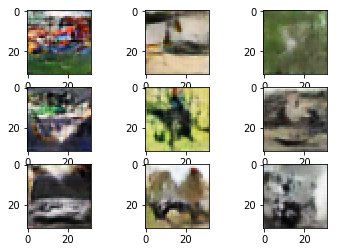

Epoch 670/670
64/64 [==============================] - 0s 610us/step - loss: -13.7930 - model_1_loss: -79.8424
Epoch 670/670
64/64 [==============================] - 0s 643us/step - loss: -23.5451 - model_1_loss: -64.1171
Epoch 670/670
64/64 [==============================] - 0s 655us/step - loss: -18.9557 - model_1_loss: -72.7253
Epoch 670/670
64/64 [==============================] - 0s 639us/step - loss: -9.2095 - model_1_loss: -67.6137
Epoch 670/670
64/64 [==============================] - 0s 659us/step - loss: -27.7614 - model_1_loss: -94.3168
Epoch 670/670
64/64 [==============================] - 0s 712us/step - loss: 93.6130


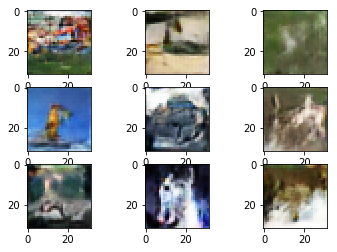

Epoch 680/680
64/64 [==============================] - 0s 619us/step - loss: -4.8285 - model_1_loss: -87.9570
Epoch 680/680
64/64 [==============================] - 0s 649us/step - loss: -22.3343 - model_1_loss: -106.3452
Epoch 680/680
64/64 [==============================] - 0s 632us/step - loss: -23.3825 - model_1_loss: -113.0365
Epoch 680/680
64/64 [==============================] - 0s 639us/step - loss: -35.7896 - model_1_loss: -110.5379
Epoch 680/680
64/64 [==============================] - 0s 639us/step - loss: -25.8478 - model_1_loss: -110.6726
Epoch 680/680
64/64 [==============================] - 0s 709us/step - loss: 97.0093


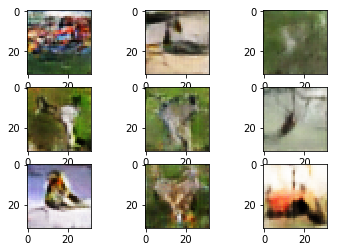

Epoch 690/690
64/64 [==============================] - 0s 621us/step - loss: -21.2111 - model_1_loss: -109.8410
Epoch 690/690
64/64 [==============================] - 0s 634us/step - loss: -8.0899 - model_1_loss: -98.9169
Epoch 690/690
64/64 [==============================] - 0s 654us/step - loss: -21.4221 - model_1_loss: -106.3065
Epoch 690/690
64/64 [==============================] - 0s 648us/step - loss: -36.4246 - model_1_loss: -132.1490
Epoch 690/690
64/64 [==============================] - 0s 647us/step - loss: -30.2329 - model_1_loss: -129.9129
Epoch 690/690
64/64 [==============================] - 0s 731us/step - loss: 124.5559


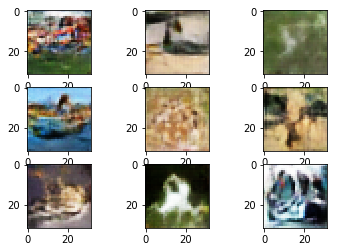

Epoch 700/700
64/64 [==============================] - 0s 622us/step - loss: -18.9346 - model_1_loss: -53.1264
Epoch 700/700
64/64 [==============================] - 0s 649us/step - loss: -26.1840 - model_1_loss: -54.7334
Epoch 700/700
64/64 [==============================] - 0s 647us/step - loss: -32.5531 - model_1_loss: -88.5370
Epoch 700/700
64/64 [==============================] - 0s 645us/step - loss: -26.4528 - model_1_loss: -88.1531
Epoch 700/700
64/64 [==============================] - 0s 649us/step - loss: -40.3522 - model_1_loss: -93.2008
Epoch 700/700
64/64 [==============================] - 0s 712us/step - loss: 78.2992


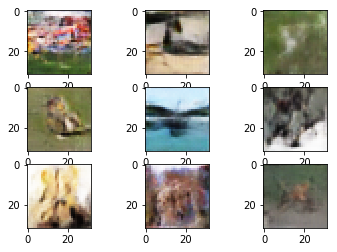

Epoch 710/710
64/64 [==============================] - 0s 619us/step - loss: -32.9504 - model_1_loss: -67.9254
Epoch 710/710
64/64 [==============================] - 0s 656us/step - loss: -35.8727 - model_1_loss: -124.5144
Epoch 710/710
64/64 [==============================] - 0s 650us/step - loss: 0.0768 - model_1_loss: -110.2984
Epoch 710/710
64/64 [==============================] - 0s 650us/step - loss: -25.1302 - model_1_loss: -104.6030
Epoch 710/710
64/64 [==============================] - 0s 663us/step - loss: -8.3043 - model_1_loss: -110.5785
Epoch 710/710
64/64 [==============================] - 0s 730us/step - loss: 134.4349


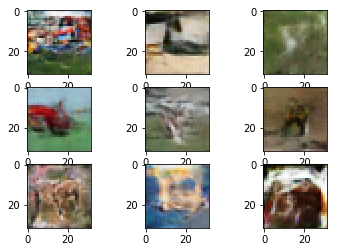

Epoch 720/720
64/64 [==============================] - 0s 629us/step - loss: -13.0693 - model_1_loss: -109.3512
Epoch 720/720
64/64 [==============================] - 0s 655us/step - loss: -25.0596 - model_1_loss: -89.3875
Epoch 720/720
64/64 [==============================] - 0s 636us/step - loss: -19.9320 - model_1_loss: -104.4275
Epoch 720/720
64/64 [==============================] - 0s 671us/step - loss: -22.8117 - model_1_loss: -92.9533
Epoch 720/720
64/64 [==============================] - 0s 658us/step - loss: -21.1167 - model_1_loss: -92.5602
Epoch 720/720
64/64 [==============================] - 0s 723us/step - loss: 123.9476


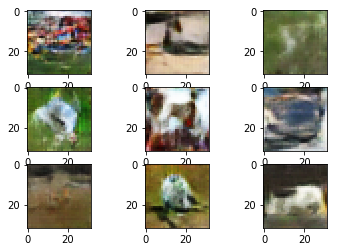

Epoch 730/730
64/64 [==============================] - 0s 627us/step - loss: -16.8872 - model_1_loss: -118.0798
Epoch 730/730
64/64 [==============================] - 0s 638us/step - loss: -16.7791 - model_1_loss: -115.5915
Epoch 730/730
64/64 [==============================] - 0s 637us/step - loss: -27.6534 - model_1_loss: -135.8495
Epoch 730/730
64/64 [==============================] - 0s 668us/step - loss: -25.3452 - model_1_loss: -144.4583
Epoch 730/730
64/64 [==============================] - 0s 657us/step - loss: -21.0776 - model_1_loss: -155.1698
Epoch 730/730
64/64 [==============================] - 0s 732us/step - loss: 128.6912


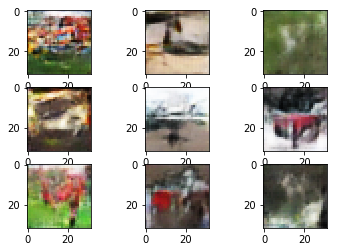

Epoch 740/740
64/64 [==============================] - 0s 613us/step - loss: -21.4929 - model_1_loss: -45.3636
Epoch 740/740
64/64 [==============================] - 0s 628us/step - loss: -8.4347 - model_1_loss: -43.2901
Epoch 740/740
64/64 [==============================] - 0s 647us/step - loss: -12.3007 - model_1_loss: -56.9306
Epoch 740/740
64/64 [==============================] - 0s 639us/step - loss: -45.6145 - model_1_loss: -80.3461
Epoch 740/740
64/64 [==============================] - 0s 657us/step - loss: -36.3356 - model_1_loss: -41.4540
Epoch 740/740
64/64 [==============================] - 0s 730us/step - loss: 14.7388


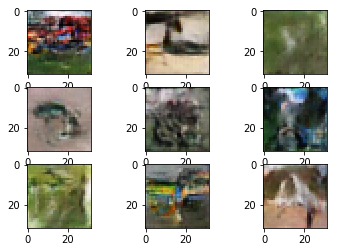

Epoch 750/750
64/64 [==============================] - 0s 624us/step - loss: 1.6052 - model_1_loss: -16.0993
Epoch 750/750
64/64 [==============================] - 0s 654us/step - loss: -25.6475 - model_1_loss: -77.4370
Epoch 750/750
64/64 [==============================] - 0s 656us/step - loss: -35.1586 - model_1_loss: -70.3327
Epoch 750/750
64/64 [==============================] - 0s 644us/step - loss: -29.2824 - model_1_loss: -104.5621
Epoch 750/750
64/64 [==============================] - 0s 640us/step - loss: -32.8212 - model_1_loss: -96.6644
Epoch 750/750
64/64 [==============================] - 0s 727us/step - loss: 85.6738


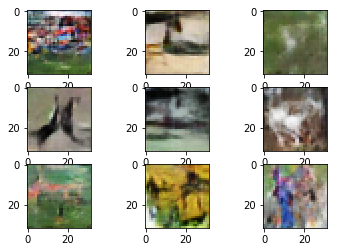

Epoch 760/760
64/64 [==============================] - 0s 610us/step - loss: -9.1841 - model_1_loss: -96.8752
Epoch 760/760
64/64 [==============================] - 0s 642us/step - loss: -9.4655 - model_1_loss: -76.7866
Epoch 760/760
64/64 [==============================] - 0s 642us/step - loss: -36.7037 - model_1_loss: -111.3339
Epoch 760/760
64/64 [==============================] - 0s 647us/step - loss: -35.2305 - model_1_loss: -114.5272
Epoch 760/760
64/64 [==============================] - 0s 647us/step - loss: -36.2830 - model_1_loss: -76.5588
Epoch 760/760
64/64 [==============================] - 0s 738us/step - loss: 48.6132


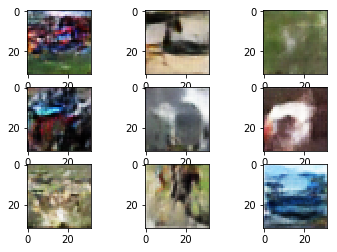

Epoch 770/770
64/64 [==============================] - 0s 626us/step - loss: -33.5441 - model_1_loss: -16.4654
Epoch 770/770
64/64 [==============================] - 0s 670us/step - loss: -13.6391 - model_1_loss: -32.8998
Epoch 770/770
64/64 [==============================] - 0s 651us/step - loss: -22.7513 - model_1_loss: -47.2585
Epoch 770/770
64/64 [==============================] - 0s 645us/step - loss: -31.3756 - model_1_loss: -74.9387
Epoch 770/770
64/64 [==============================] - 0s 639us/step - loss: -41.4036 - model_1_loss: -84.6605
Epoch 770/770
64/64 [==============================] - 0s 713us/step - loss: 63.0004


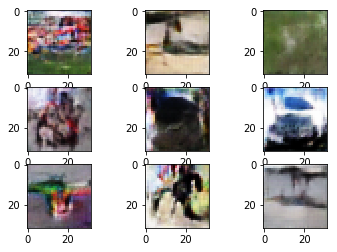

Epoch 780/780
64/64 [==============================] - 0s 644us/step - loss: -20.7101 - model_1_loss: -99.6506
Epoch 780/780
64/64 [==============================] - 0s 651us/step - loss: -17.3527 - model_1_loss: -123.9634
Epoch 780/780
64/64 [==============================] - 0s 657us/step - loss: -28.9085 - model_1_loss: -79.2793
Epoch 780/780
64/64 [==============================] - 0s 636us/step - loss: -17.6115 - model_1_loss: -59.1288
Epoch 780/780
64/64 [==============================] - 0s 636us/step - loss: -15.7300 - model_1_loss: -51.2405
Epoch 780/780
64/64 [==============================] - 0s 735us/step - loss: 75.1138


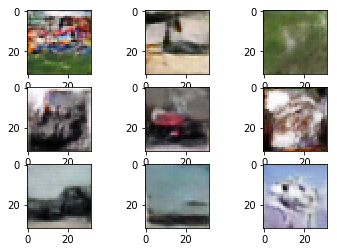

Epoch 790/790
64/64 [==============================] - 0s 617us/step - loss: -31.7781 - model_1_loss: -121.4565
Epoch 790/790
64/64 [==============================] - 0s 644us/step - loss: -12.7759 - model_1_loss: -93.1115
Epoch 790/790
64/64 [==============================] - 0s 652us/step - loss: -12.4833 - model_1_loss: -121.3945
Epoch 790/790
64/64 [==============================] - 0s 627us/step - loss: -21.7344 - model_1_loss: -105.4210
Epoch 790/790
64/64 [==============================] - 0s 650us/step - loss: -23.2056 - model_1_loss: -140.1858
Epoch 790/790
64/64 [==============================] - 0s 731us/step - loss: 116.7979


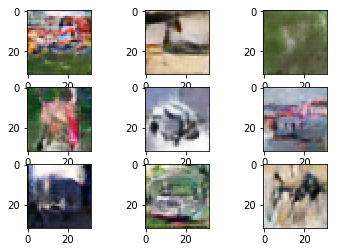

Epoch 800/800
64/64 [==============================] - 0s 606us/step - loss: -15.3087 - model_1_loss: -102.0212
Epoch 800/800
64/64 [==============================] - 0s 653us/step - loss: -20.3374 - model_1_loss: -126.3931
Epoch 800/800
64/64 [==============================] - 0s 647us/step - loss: -19.9009 - model_1_loss: -122.3728
Epoch 800/800
64/64 [==============================] - 0s 652us/step - loss: -26.5362 - model_1_loss: -108.1427
Epoch 800/800
64/64 [==============================] - 0s 655us/step - loss: -42.4939 - model_1_loss: -125.9333
Epoch 800/800
64/64 [==============================] - 0s 725us/step - loss: 118.2823


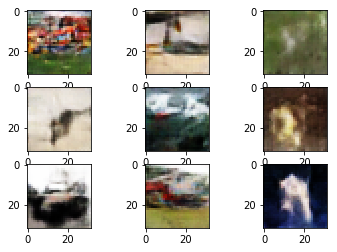

Epoch 810/810
64/64 [==============================] - 0s 629us/step - loss: -28.2539 - model_1_loss: -57.5007
Epoch 810/810
64/64 [==============================] - 0s 650us/step - loss: -16.2428 - model_1_loss: -57.8748
Epoch 810/810
64/64 [==============================] - 0s 642us/step - loss: -8.4279 - model_1_loss: -57.3563
Epoch 810/810
64/64 [==============================] - 0s 644us/step - loss: -17.4425 - model_1_loss: -47.0773
Epoch 810/810
64/64 [==============================] - 0s 656us/step - loss: -41.7829 - model_1_loss: -81.3338
Epoch 810/810
64/64 [==============================] - 0s 735us/step - loss: 42.9714


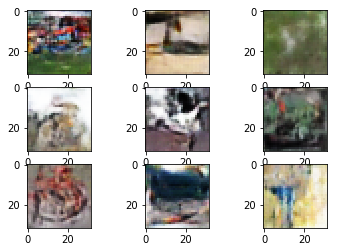

Epoch 820/820
64/64 [==============================] - 0s 627us/step - loss: -9.5674 - model_1_loss: -106.8077
Epoch 820/820
64/64 [==============================] - 0s 672us/step - loss: -28.3608 - model_1_loss: -142.9788
Epoch 820/820
64/64 [==============================] - 0s 663us/step - loss: -22.4288 - model_1_loss: -142.7497
Epoch 820/820
64/64 [==============================] - 0s 641us/step - loss: -24.4382 - model_1_loss: -144.1565
Epoch 820/820
64/64 [==============================] - 0s 650us/step - loss: -26.9248 - model_1_loss: -145.2429
Epoch 820/820
64/64 [==============================] - 0s 720us/step - loss: 136.2318


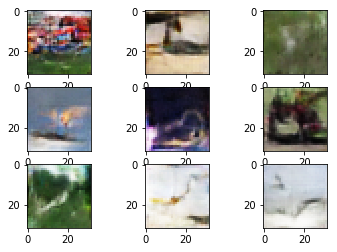

Epoch 830/830
64/64 [==============================] - 0s 620us/step - loss: -29.7520 - model_1_loss: -103.9783
Epoch 830/830
64/64 [==============================] - 0s 654us/step - loss: -14.6971 - model_1_loss: -88.1064
Epoch 830/830
64/64 [==============================] - 0s 673us/step - loss: -32.7482 - model_1_loss: -117.0226
Epoch 830/830
64/64 [==============================] - 0s 656us/step - loss: -26.6583 - model_1_loss: -97.2517
Epoch 830/830
64/64 [==============================] - 0s 657us/step - loss: -23.5458 - model_1_loss: -64.7995
Epoch 830/830
64/64 [==============================] - 0s 731us/step - loss: 85.3696


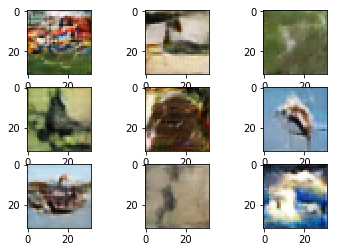

Epoch 840/840
64/64 [==============================] - 0s 631us/step - loss: -23.7452 - model_1_loss: -161.4443
Epoch 840/840
64/64 [==============================] - 0s 648us/step - loss: -21.2915 - model_1_loss: -171.2649
Epoch 840/840
64/64 [==============================] - 0s 658us/step - loss: -21.4457 - model_1_loss: -155.3337
Epoch 840/840
64/64 [==============================] - 0s 655us/step - loss: -18.9530 - model_1_loss: -144.1506
Epoch 840/840
64/64 [==============================] - 0s 645us/step - loss: -26.0879 - model_1_loss: -127.2267
Epoch 840/840
64/64 [==============================] - 0s 757us/step - loss: 125.8606


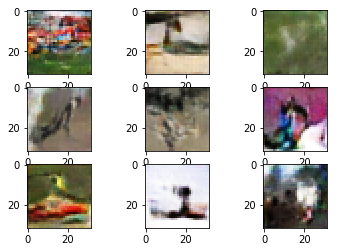

Epoch 850/850
64/64 [==============================] - 0s 641us/step - loss: -18.0728 - model_1_loss: -143.1472
Epoch 850/850
64/64 [==============================] - 0s 664us/step - loss: -32.1425 - model_1_loss: -137.9654
Epoch 850/850
64/64 [==============================] - 0s 639us/step - loss: -13.9372 - model_1_loss: -147.1330
Epoch 850/850
64/64 [==============================] - 0s 646us/step - loss: -30.3116 - model_1_loss: -159.6425
Epoch 850/850
64/64 [==============================] - 0s 657us/step - loss: -29.6380 - model_1_loss: -141.8529
Epoch 850/850
64/64 [==============================] - 0s 722us/step - loss: 132.3887


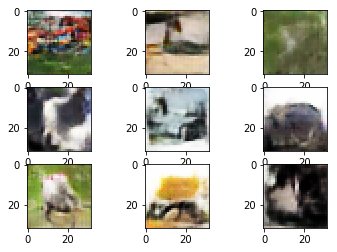

Epoch 860/860
64/64 [==============================] - 0s 638us/step - loss: -33.5476 - model_1_loss: -68.4928
Epoch 860/860
64/64 [==============================] - 0s 635us/step - loss: -10.4409 - model_1_loss: -84.3630
Epoch 860/860
64/64 [==============================] - 0s 647us/step - loss: -16.6419 - model_1_loss: -94.9538
Epoch 860/860
64/64 [==============================] - 0s 652us/step - loss: -28.5599 - model_1_loss: -125.5673
Epoch 860/860
64/64 [==============================] - 0s 637us/step - loss: -43.1738 - model_1_loss: -123.4297
Epoch 860/860
64/64 [==============================] - 0s 719us/step - loss: 123.2922


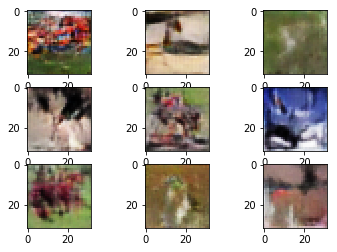

Epoch 870/870
64/64 [==============================] - 0s 618us/step - loss: -23.2872 - model_1_loss: -83.7515
Epoch 870/870
64/64 [==============================] - 0s 655us/step - loss: -23.5662 - model_1_loss: -96.2657
Epoch 870/870
64/64 [==============================] - 0s 644us/step - loss: -11.7746 - model_1_loss: -105.2335
Epoch 870/870
64/64 [==============================] - 0s 646us/step - loss: -16.3602 - model_1_loss: -83.8100
Epoch 870/870
64/64 [==============================] - 0s 642us/step - loss: -18.0553 - model_1_loss: -59.3828
Epoch 870/870
64/64 [==============================] - 0s 722us/step - loss: 85.3389


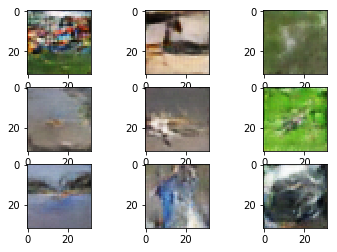

Epoch 880/880
64/64 [==============================] - 0s 614us/step - loss: -20.8190 - model_1_loss: -102.7015
Epoch 880/880
64/64 [==============================] - 0s 648us/step - loss: -22.9941 - model_1_loss: -106.7033
Epoch 880/880
64/64 [==============================] - 0s 662us/step - loss: -17.2376 - model_1_loss: -106.5744
Epoch 880/880
64/64 [==============================] - 0s 647us/step - loss: -16.7714 - model_1_loss: -115.1510
Epoch 880/880
64/64 [==============================] - 0s 644us/step - loss: -30.8534 - model_1_loss: -119.7786
Epoch 880/880
64/64 [==============================] - 0s 721us/step - loss: 103.7275


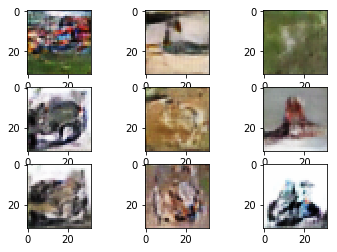

Epoch 890/890
64/64 [==============================] - 0s 630us/step - loss: -6.0830 - model_1_loss: -136.4335
Epoch 890/890
64/64 [==============================] - 0s 651us/step - loss: -17.9108 - model_1_loss: -144.1246
Epoch 890/890
64/64 [==============================] - 0s 634us/step - loss: -28.2486 - model_1_loss: -124.5441
Epoch 890/890
64/64 [==============================] - 0s 639us/step - loss: -44.3708 - model_1_loss: -108.7367
Epoch 890/890
64/64 [==============================] - 0s 650us/step - loss: -33.7598 - model_1_loss: -91.2158
Epoch 890/890
64/64 [==============================] - 0s 728us/step - loss: 79.2176


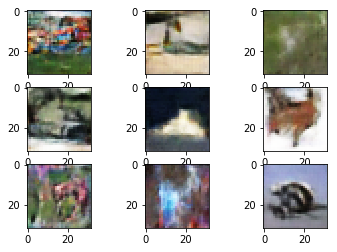

Epoch 900/900
64/64 [==============================] - 0s 619us/step - loss: -14.5352 - model_1_loss: -63.3617
Epoch 900/900
64/64 [==============================] - 0s 653us/step - loss: -15.3229 - model_1_loss: -83.9886
Epoch 900/900
64/64 [==============================] - 0s 653us/step - loss: -33.4941 - model_1_loss: -111.9675
Epoch 900/900
64/64 [==============================] - 0s 657us/step - loss: -25.9491 - model_1_loss: -100.8108
Epoch 900/900
64/64 [==============================] - 0s 664us/step - loss: -32.2114 - model_1_loss: -119.6886
Epoch 900/900
64/64 [==============================] - 0s 737us/step - loss: 91.5006


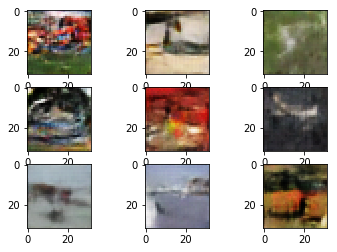

Epoch 910/910
64/64 [==============================] - 0s 708us/step - loss: -22.6737 - model_1_loss: -88.8111
Epoch 910/910
64/64 [==============================] - 0s 697us/step - loss: -40.0096 - model_1_loss: -103.2411
Epoch 910/910
64/64 [==============================] - 0s 674us/step - loss: -17.8626 - model_1_loss: -67.1620
Epoch 910/910
64/64 [==============================] - 0s 649us/step - loss: -14.4891 - model_1_loss: -72.0305
Epoch 910/910
64/64 [==============================] - 0s 659us/step - loss: -32.6631 - model_1_loss: -99.5161
Epoch 910/910
64/64 [==============================] - 0s 736us/step - loss: 78.4078


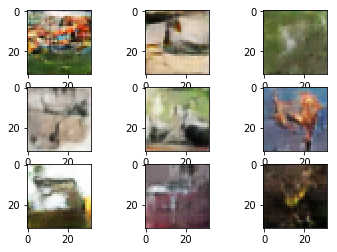

Epoch 920/920
64/64 [==============================] - 0s 622us/step - loss: -42.5440 - model_1_loss: -69.5874
Epoch 920/920
64/64 [==============================] - 0s 650us/step - loss: -28.4292 - model_1_loss: -62.6068
Epoch 920/920
64/64 [==============================] - 0s 699us/step - loss: -15.2490 - model_1_loss: -39.1315
Epoch 920/920
64/64 [==============================] - 0s 685us/step - loss: -15.0577 - model_1_loss: -26.3969
Epoch 920/920
64/64 [==============================] - 0s 703us/step - loss: -20.3855 - model_1_loss: -72.0738
Epoch 920/920
64/64 [==============================] - 0s 784us/step - loss: 86.4080


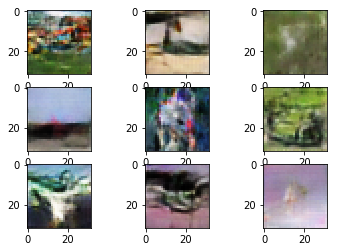

Epoch 930/930
64/64 [==============================] - 0s 618us/step - loss: -17.3580 - model_1_loss: -104.5296
Epoch 930/930
64/64 [==============================] - 0s 678us/step - loss: -23.4454 - model_1_loss: -93.4495
Epoch 930/930
64/64 [==============================] - 0s 800us/step - loss: -13.9988 - model_1_loss: -116.1331
Epoch 930/930
64/64 [==============================] - 0s 683us/step - loss: -32.9591 - model_1_loss: -124.1552
Epoch 930/930
64/64 [==============================] - 0s 687us/step - loss: -25.3314 - model_1_loss: -109.6210
Epoch 930/930
64/64 [==============================] - 0s 759us/step - loss: 131.6318


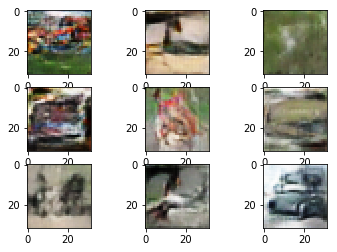

Epoch 940/940
64/64 [==============================] - 0s 629us/step - loss: -20.9957 - model_1_loss: -102.3465
Epoch 940/940
64/64 [==============================] - 0s 679us/step - loss: -24.2889 - model_1_loss: -120.2300
Epoch 940/940
64/64 [==============================] - 0s 740us/step - loss: -35.4061 - model_1_loss: -147.2209
Epoch 940/940
64/64 [==============================] - 0s 717us/step - loss: -20.4146 - model_1_loss: -132.5051
Epoch 940/940
64/64 [==============================] - 0s 720us/step - loss: -33.1976 - model_1_loss: -102.0674
Epoch 940/940
64/64 [==============================] - 0s 834us/step - loss: 118.4052


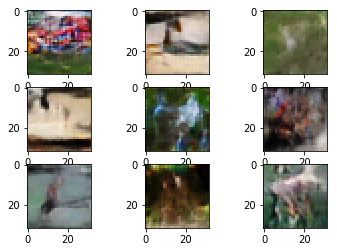

Epoch 950/950
64/64 [==============================] - 0s 631us/step - loss: -2.9301 - model_1_loss: -102.8907
Epoch 950/950
64/64 [==============================] - 0s 648us/step - loss: -20.8769 - model_1_loss: -87.8575
Epoch 950/950
64/64 [==============================] - 0s 640us/step - loss: -29.8585 - model_1_loss: -112.2610
Epoch 950/950
64/64 [==============================] - 0s 652us/step - loss: -6.3515 - model_1_loss: -101.6753
Epoch 950/950
64/64 [==============================] - 0s 644us/step - loss: -34.9837 - model_1_loss: -121.3255
Epoch 950/950
64/64 [==============================] - 0s 743us/step - loss: 128.7395


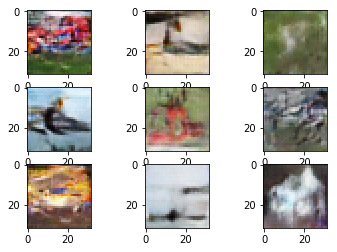

Epoch 960/960
64/64 [==============================] - 0s 615us/step - loss: -19.2607 - model_1_loss: -78.9502
Epoch 960/960
64/64 [==============================] - 0s 677us/step - loss: -16.8139 - model_1_loss: -94.2461
Epoch 960/960
64/64 [==============================] - 0s 654us/step - loss: -33.4625 - model_1_loss: -108.0597
Epoch 960/960
64/64 [==============================] - 0s 650us/step - loss: -23.8152 - model_1_loss: -95.5883
Epoch 960/960
64/64 [==============================] - 0s 641us/step - loss: -7.2075 - model_1_loss: -60.7968
Epoch 960/960
64/64 [==============================] - 0s 714us/step - loss: 90.0592


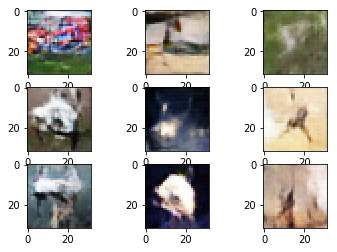

Epoch 970/970
64/64 [==============================] - 0s 620us/step - loss: -15.7167 - model_1_loss: -86.1852
Epoch 970/970
64/64 [==============================] - 0s 616us/step - loss: -13.2572 - model_1_loss: -40.1663
Epoch 970/970
64/64 [==============================] - 0s 643us/step - loss: -12.0506 - model_1_loss: -80.5452
Epoch 970/970
64/64 [==============================] - 0s 645us/step - loss: -10.3573 - model_1_loss: -97.8226
Epoch 970/970
64/64 [==============================] - 0s 630us/step - loss: -25.6978 - model_1_loss: -81.6911
Epoch 970/970
64/64 [==============================] - 0s 733us/step - loss: 62.6322


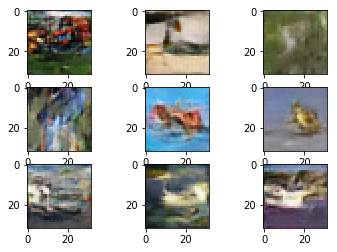

Epoch 980/980
64/64 [==============================] - 0s 615us/step - loss: 0.0714 - model_1_loss: -76.4593
Epoch 980/980
64/64 [==============================] - 0s 654us/step - loss: -24.7028 - model_1_loss: -118.2660
Epoch 980/980
64/64 [==============================] - 0s 651us/step - loss: -27.3044 - model_1_loss: -115.3876
Epoch 980/980
64/64 [==============================] - 0s 667us/step - loss: -19.9304 - model_1_loss: -100.8075
Epoch 980/980
64/64 [==============================] - 0s 647us/step - loss: -30.1608 - model_1_loss: -99.1691
Epoch 980/980
64/64 [==============================] - 0s 777us/step - loss: 110.2531


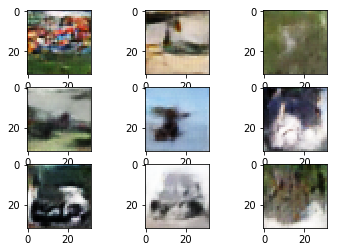

Epoch 990/990
64/64 [==============================] - 0s 636us/step - loss: -11.5629 - model_1_loss: -81.4635
Epoch 990/990
64/64 [==============================] - 0s 647us/step - loss: -25.3954 - model_1_loss: -80.5135
Epoch 990/990
64/64 [==============================] - 0s 665us/step - loss: -15.1665 - model_1_loss: -86.1735
Epoch 990/990
64/64 [==============================] - 0s 638us/step - loss: -12.9803 - model_1_loss: -120.9785
Epoch 990/990
64/64 [==============================] - 0s 646us/step - loss: -15.6271 - model_1_loss: -88.9342
Epoch 990/990
64/64 [==============================] - 0s 742us/step - loss: 99.4309


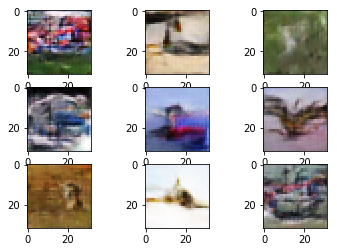

Epoch 1000/1000
64/64 [==============================] - 0s 620us/step - loss: -7.2688 - model_1_loss: -4.3464
Epoch 1000/1000
64/64 [==============================] - 0s 664us/step - loss: -28.6835 - model_1_loss: -25.9878
Epoch 1000/1000
64/64 [==============================] - 0s 653us/step - loss: -34.4050 - model_1_loss: -40.7741
Epoch 1000/1000
64/64 [==============================] - 0s 649us/step - loss: -28.6786 - model_1_loss: -53.1548
Epoch 1000/1000
64/64 [==============================] - 0s 651us/step - loss: -14.3634 - model_1_loss: -50.5566
Epoch 1000/1000
64/64 [==============================] - 0s 754us/step - loss: 57.5325


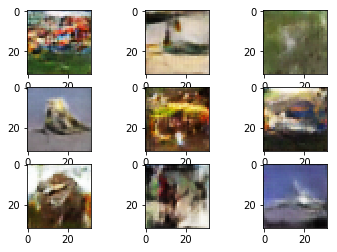

Epoch 1010/1010
64/64 [==============================] - 0s 641us/step - loss: -20.1322 - model_1_loss: -118.3269
Epoch 1010/1010
64/64 [==============================] - 0s 625us/step - loss: -18.2956 - model_1_loss: -110.9802
Epoch 1010/1010
64/64 [==============================] - 0s 656us/step - loss: -3.9610 - model_1_loss: -120.5440
Epoch 1010/1010
64/64 [==============================] - 0s 645us/step - loss: -37.7425 - model_1_loss: -135.5030
Epoch 1010/1010
64/64 [==============================] - 0s 671us/step - loss: -50.6641 - model_1_loss: -147.0339
Epoch 1010/1010
64/64 [==============================] - 0s 727us/step - loss: 133.6285


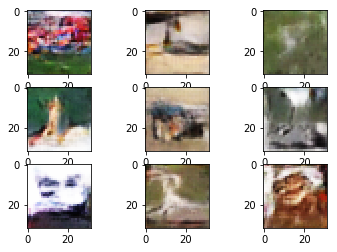

Epoch 1020/1020
64/64 [==============================] - 0s 665us/step - loss: -14.9551 - model_1_loss: -60.7751
Epoch 1020/1020
64/64 [==============================] - 0s 668us/step - loss: -12.5970 - model_1_loss: -58.9638
Epoch 1020/1020
64/64 [==============================] - 0s 674us/step - loss: -16.7594 - model_1_loss: -116.0162
Epoch 1020/1020
64/64 [==============================] - 0s 682us/step - loss: -15.9278 - model_1_loss: -117.3793
Epoch 1020/1020
64/64 [==============================] - 0s 674us/step - loss: -24.2147 - model_1_loss: -118.3078
Epoch 1020/1020
64/64 [==============================] - 0s 779us/step - loss: 117.0176


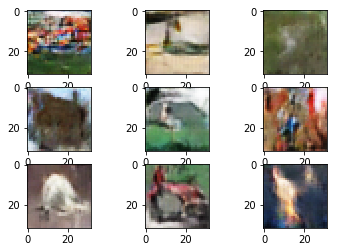

Epoch 1030/1030
64/64 [==============================] - 0s 620us/step - loss: -11.6715 - model_1_loss: -86.5177
Epoch 1030/1030
64/64 [==============================] - 0s 643us/step - loss: -7.3897 - model_1_loss: -59.3631
Epoch 1030/1030
64/64 [==============================] - 0s 636us/step - loss: -29.7248 - model_1_loss: -91.2168
Epoch 1030/1030
64/64 [==============================] - 0s 656us/step - loss: -28.1136 - model_1_loss: -99.3828
Epoch 1030/1030
64/64 [==============================] - 0s 621us/step - loss: -32.3659 - model_1_loss: -109.6397
Epoch 1030/1030
64/64 [==============================] - 0s 706us/step - loss: 130.9437


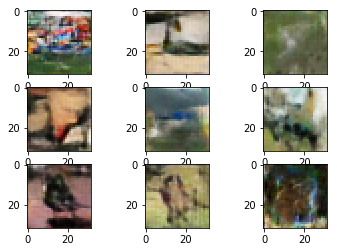

Epoch 1040/1040
64/64 [==============================] - 0s 598us/step - loss: -7.7850 - model_1_loss: -51.3109
Epoch 1040/1040
64/64 [==============================] - 0s 633us/step - loss: -15.0399 - model_1_loss: -90.9055
Epoch 1040/1040
64/64 [==============================] - 0s 621us/step - loss: -37.8554 - model_1_loss: -110.3799
Epoch 1040/1040
64/64 [==============================] - 0s 641us/step - loss: -18.0588 - model_1_loss: -107.2535
Epoch 1040/1040
64/64 [==============================] - 0s 624us/step - loss: -26.1287 - model_1_loss: -132.1693
Epoch 1040/1040
64/64 [==============================] - 0s 730us/step - loss: 131.2929


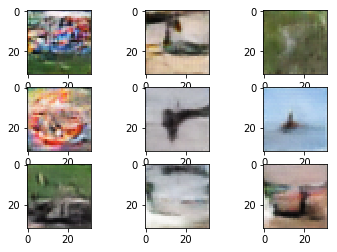

Epoch 1050/1050
64/64 [==============================] - 0s 601us/step - loss: -21.6222 - model_1_loss: -100.4521
Epoch 1050/1050
64/64 [==============================] - 0s 632us/step - loss: -28.8285 - model_1_loss: -90.0522
Epoch 1050/1050
64/64 [==============================] - 0s 630us/step - loss: -21.3559 - model_1_loss: -82.0976
Epoch 1050/1050
64/64 [==============================] - 0s 631us/step - loss: -38.2302 - model_1_loss: -71.0091
Epoch 1050/1050
64/64 [==============================] - 0s 631us/step - loss: -22.2155 - model_1_loss: -92.2478
Epoch 1050/1050
64/64 [==============================] - 0s 708us/step - loss: 105.1552


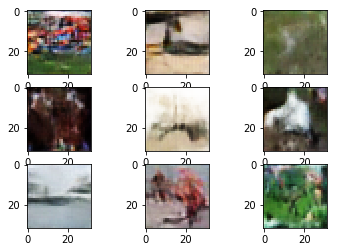

Epoch 1060/1060
64/64 [==============================] - 0s 594us/step - loss: -12.4688 - model_1_loss: -82.0715
Epoch 1060/1060
64/64 [==============================] - 0s 637us/step - loss: -11.0652 - model_1_loss: -99.2208
Epoch 1060/1060
64/64 [==============================] - 0s 633us/step - loss: -34.4185 - model_1_loss: -104.8041
Epoch 1060/1060
64/64 [==============================] - 0s 634us/step - loss: -17.6862 - model_1_loss: -94.1388
Epoch 1060/1060
64/64 [==============================] - 0s 625us/step - loss: -29.0865 - model_1_loss: -74.3490
Epoch 1060/1060
64/64 [==============================] - 0s 727us/step - loss: 47.3630


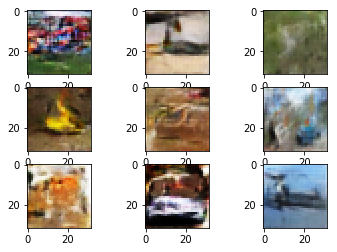

Epoch 1070/1070
64/64 [==============================] - 0s 596us/step - loss: -22.3572 - model_1_loss: -122.8596
Epoch 1070/1070
64/64 [==============================] - 0s 649us/step - loss: -41.6048 - model_1_loss: -139.5040
Epoch 1070/1070
64/64 [==============================] - 0s 619us/step - loss: -25.3634 - model_1_loss: -140.4192
Epoch 1070/1070
64/64 [==============================] - 0s 622us/step - loss: -36.8539 - model_1_loss: -151.5833
Epoch 1070/1070
64/64 [==============================] - 0s 626us/step - loss: -18.2103 - model_1_loss: -123.6756
Epoch 1070/1070
64/64 [==============================] - 0s 710us/step - loss: 99.5864


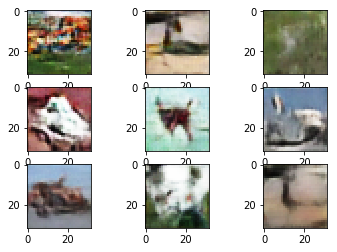

Epoch 1080/1080
64/64 [==============================] - 0s 598us/step - loss: -1.2107 - model_1_loss: -147.9524
Epoch 1080/1080
64/64 [==============================] - 0s 611us/step - loss: -35.9988 - model_1_loss: -154.7871
Epoch 1080/1080
64/64 [==============================] - 0s 633us/step - loss: -16.6034 - model_1_loss: -149.2828
Epoch 1080/1080
64/64 [==============================] - 0s 636us/step - loss: -23.1393 - model_1_loss: -160.3938
Epoch 1080/1080
64/64 [==============================] - 0s 618us/step - loss: -26.6135 - model_1_loss: -105.6251
Epoch 1080/1080
64/64 [==============================] - 0s 712us/step - loss: 82.2487


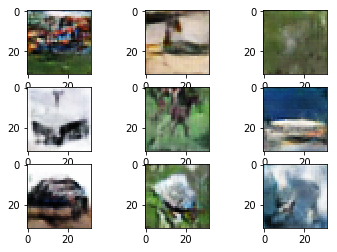

Epoch 1090/1090
64/64 [==============================] - 0s 619us/step - loss: -18.9522 - model_1_loss: -125.2010
Epoch 1090/1090
64/64 [==============================] - 0s 645us/step - loss: -24.4380 - model_1_loss: -122.0982
Epoch 1090/1090
64/64 [==============================] - 0s 637us/step - loss: -24.8393 - model_1_loss: -126.4694
Epoch 1090/1090
64/64 [==============================] - 0s 636us/step - loss: -30.8606 - model_1_loss: -118.5199
Epoch 1090/1090
64/64 [==============================] - 0s 647us/step - loss: -33.0650 - model_1_loss: -134.2380
Epoch 1090/1090
64/64 [==============================] - 0s 735us/step - loss: 148.2398


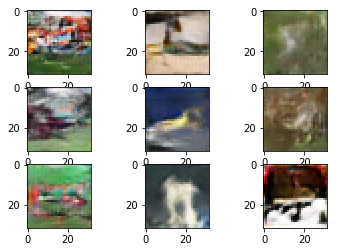

Epoch 1100/1100
64/64 [==============================] - 0s 618us/step - loss: -22.4269 - model_1_loss: -137.6265
Epoch 1100/1100
64/64 [==============================] - 0s 631us/step - loss: -20.8829 - model_1_loss: -123.6993
Epoch 1100/1100
64/64 [==============================] - 0s 648us/step - loss: -23.8482 - model_1_loss: -121.2534
Epoch 1100/1100
64/64 [==============================] - 0s 661us/step - loss: -36.2572 - model_1_loss: -104.9058
Epoch 1100/1100
64/64 [==============================] - 0s 656us/step - loss: -50.8269 - model_1_loss: -117.8110
Epoch 1100/1100
64/64 [==============================] - 0s 721us/step - loss: 77.1221


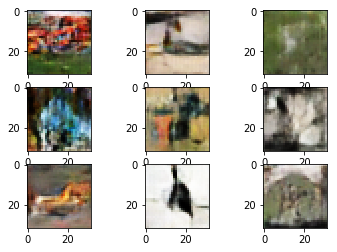

Epoch 1110/1110
64/64 [==============================] - 0s 612us/step - loss: -11.9207 - model_1_loss: -113.9238
Epoch 1110/1110
64/64 [==============================] - 0s 635us/step - loss: -29.6819 - model_1_loss: -113.2692
Epoch 1110/1110
64/64 [==============================] - 0s 648us/step - loss: -29.3549 - model_1_loss: -115.8382
Epoch 1110/1110
64/64 [==============================] - 0s 624us/step - loss: -22.9608 - model_1_loss: -85.9632
Epoch 1110/1110
64/64 [==============================] - 0s 624us/step - loss: -26.2653 - model_1_loss: -104.8730
Epoch 1110/1110
64/64 [==============================] - 0s 709us/step - loss: 73.7538


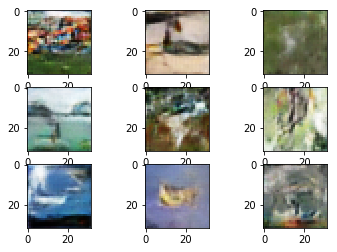

Epoch 1120/1120
64/64 [==============================] - 0s 600us/step - loss: -34.9450 - model_1_loss: -130.0025
Epoch 1120/1120
64/64 [==============================] - 0s 634us/step - loss: -47.9909 - model_1_loss: -136.3590
Epoch 1120/1120
64/64 [==============================] - 0s 633us/step - loss: -23.2052 - model_1_loss: -120.5604
Epoch 1120/1120
64/64 [==============================] - 0s 637us/step - loss: -24.8501 - model_1_loss: -119.5293
Epoch 1120/1120
64/64 [==============================] - 0s 646us/step - loss: -39.7416 - model_1_loss: -142.5447
Epoch 1120/1120
64/64 [==============================] - 0s 717us/step - loss: 144.6611


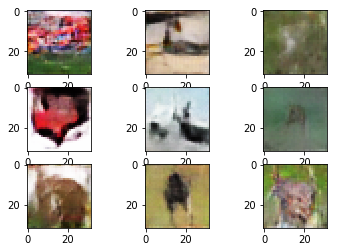

Epoch 1130/1130
64/64 [==============================] - 0s 604us/step - loss: -21.1466 - model_1_loss: -154.7901
Epoch 1130/1130
64/64 [==============================] - 0s 645us/step - loss: -30.0326 - model_1_loss: -111.5950
Epoch 1130/1130
64/64 [==============================] - 0s 630us/step - loss: -30.8584 - model_1_loss: -136.4391
Epoch 1130/1130
64/64 [==============================] - 0s 643us/step - loss: -31.4792 - model_1_loss: -169.4873
Epoch 1130/1130
64/64 [==============================] - 0s 635us/step - loss: -42.8561 - model_1_loss: -160.1944
Epoch 1130/1130
64/64 [==============================] - 0s 721us/step - loss: 146.0719


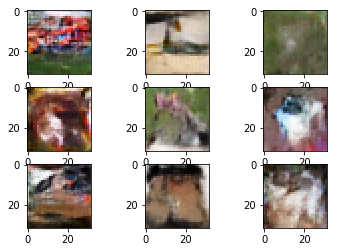

Epoch 1140/1140
64/64 [==============================] - 0s 619us/step - loss: -32.2408 - model_1_loss: -92.8212
Epoch 1140/1140
64/64 [==============================] - 0s 664us/step - loss: -24.8093 - model_1_loss: -73.1504
Epoch 1140/1140
64/64 [==============================] - 0s 637us/step - loss: -38.4398 - model_1_loss: -92.9769
Epoch 1140/1140
64/64 [==============================] - 0s 656us/step - loss: -9.7911 - model_1_loss: -89.3837
Epoch 1140/1140
64/64 [==============================] - 0s 631us/step - loss: -30.5576 - model_1_loss: -106.3322
Epoch 1140/1140
64/64 [==============================] - 0s 730us/step - loss: 75.5889


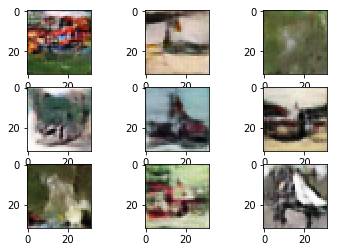

Epoch 1150/1150
64/64 [==============================] - 0s 613us/step - loss: 1.5295 - model_1_loss: -57.7554
Epoch 1150/1150
64/64 [==============================] - 0s 631us/step - loss: -17.6656 - model_1_loss: -81.8147
Epoch 1150/1150
64/64 [==============================] - 0s 636us/step - loss: -30.8094 - model_1_loss: -92.2412
Epoch 1150/1150
64/64 [==============================] - 0s 652us/step - loss: -23.3369 - model_1_loss: -42.7833
Epoch 1150/1150
64/64 [==============================] - 0s 640us/step - loss: -9.6258 - model_1_loss: -42.1571
Epoch 1150/1150
64/64 [==============================] - 0s 732us/step - loss: 61.4155


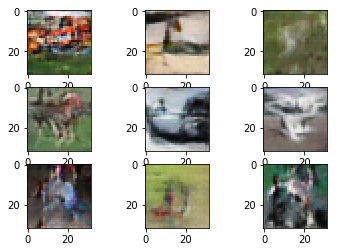

Epoch 1160/1160
64/64 [==============================] - 0s 616us/step - loss: -17.5833 - model_1_loss: -120.7711
Epoch 1160/1160
64/64 [==============================] - 0s 638us/step - loss: -19.4544 - model_1_loss: -110.1917
Epoch 1160/1160
64/64 [==============================] - 0s 650us/step - loss: -32.7503 - model_1_loss: -135.5812
Epoch 1160/1160
64/64 [==============================] - 0s 657us/step - loss: -32.2516 - model_1_loss: -153.8870
Epoch 1160/1160
64/64 [==============================] - 0s 642us/step - loss: -16.2353 - model_1_loss: -144.1167
Epoch 1160/1160
64/64 [==============================] - 0s 719us/step - loss: 125.5068


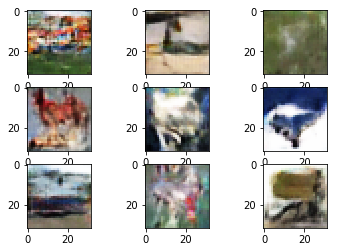

Epoch 1170/1170
64/64 [==============================] - 0s 607us/step - loss: -21.3680 - model_1_loss: -75.8354
Epoch 1170/1170
64/64 [==============================] - 0s 645us/step - loss: -19.3270 - model_1_loss: -79.1574
Epoch 1170/1170
64/64 [==============================] - 0s 650us/step - loss: -25.8326 - model_1_loss: -97.6122
Epoch 1170/1170
64/64 [==============================] - 0s 647us/step - loss: -33.8356 - model_1_loss: -114.5877
Epoch 1170/1170
64/64 [==============================] - 0s 638us/step - loss: -33.3759 - model_1_loss: -120.2960
Epoch 1170/1170
64/64 [==============================] - 0s 729us/step - loss: 111.6361


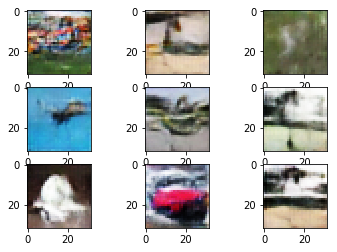

Epoch 1180/1180
64/64 [==============================] - 0s 617us/step - loss: -10.4837 - model_1_loss: -150.4582
Epoch 1180/1180
64/64 [==============================] - 0s 677us/step - loss: 5.5653 - model_1_loss: -134.4639
Epoch 1180/1180
64/64 [==============================] - 0s 676us/step - loss: -20.0996 - model_1_loss: -114.1347
Epoch 1180/1180
64/64 [==============================] - 0s 646us/step - loss: -25.5925 - model_1_loss: -114.0200
Epoch 1180/1180
64/64 [==============================] - 0s 639us/step - loss: -29.7427 - model_1_loss: -119.4384
Epoch 1180/1180
64/64 [==============================] - 0s 725us/step - loss: 97.0645


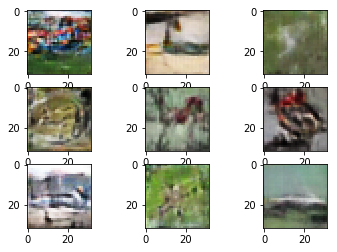

Epoch 1190/1190
64/64 [==============================] - 0s 655us/step - loss: -7.7233 - model_1_loss: -42.4457
Epoch 1190/1190
64/64 [==============================] - 0s 687us/step - loss: -12.3670 - model_1_loss: -61.5987
Epoch 1190/1190
64/64 [==============================] - 0s 639us/step - loss: -30.9923 - model_1_loss: -70.8447
Epoch 1190/1190
64/64 [==============================] - 0s 653us/step - loss: -22.2150 - model_1_loss: -75.1854
Epoch 1190/1190
64/64 [==============================] - 0s 650us/step - loss: -38.5189 - model_1_loss: -91.3873
Epoch 1190/1190
64/64 [==============================] - 0s 763us/step - loss: 83.6725


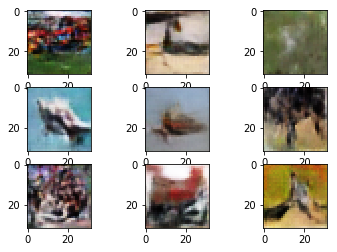

Epoch 1200/1200
64/64 [==============================] - 0s 628us/step - loss: -10.7340 - model_1_loss: -88.0182
Epoch 1200/1200
64/64 [==============================] - 0s 625us/step - loss: -32.2014 - model_1_loss: -98.3438
Epoch 1200/1200
64/64 [==============================] - 0s 642us/step - loss: -14.1918 - model_1_loss: -119.7749
Epoch 1200/1200
64/64 [==============================] - 0s 653us/step - loss: -23.7283 - model_1_loss: -111.4453
Epoch 1200/1200
64/64 [==============================] - 0s 659us/step - loss: -26.8767 - model_1_loss: -106.1456
Epoch 1200/1200
64/64 [==============================] - 0s 744us/step - loss: 104.7489


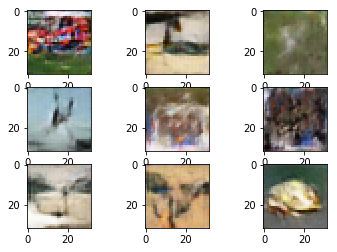

Epoch 1210/1210
64/64 [==============================] - 0s 616us/step - loss: -21.7855 - model_1_loss: -86.2909
Epoch 1210/1210
64/64 [==============================] - 0s 652us/step - loss: -11.8170 - model_1_loss: -107.4339
Epoch 1210/1210
64/64 [==============================] - 0s 650us/step - loss: -24.3747 - model_1_loss: -115.4996
Epoch 1210/1210
64/64 [==============================] - 0s 643us/step - loss: -24.4120 - model_1_loss: -122.3910
Epoch 1210/1210
64/64 [==============================] - 0s 645us/step - loss: -22.2003 - model_1_loss: -115.4977
Epoch 1210/1210
64/64 [==============================] - 0s 727us/step - loss: 96.4276


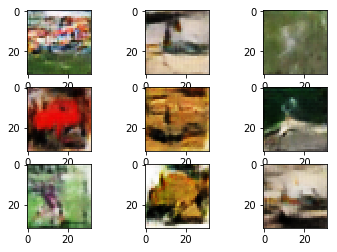

Epoch 1220/1220
64/64 [==============================] - 0s 613us/step - loss: -14.8941 - model_1_loss: -60.6857
Epoch 1220/1220
64/64 [==============================] - 0s 642us/step - loss: -18.3270 - model_1_loss: -96.5203
Epoch 1220/1220
64/64 [==============================] - 0s 642us/step - loss: -23.0178 - model_1_loss: -43.8583
Epoch 1220/1220
64/64 [==============================] - 0s 648us/step - loss: -21.1796 - model_1_loss: -63.4898
Epoch 1220/1220
64/64 [==============================] - 0s 648us/step - loss: -33.7042 - model_1_loss: -68.3987
Epoch 1220/1220
64/64 [==============================] - 0s 726us/step - loss: 46.2299


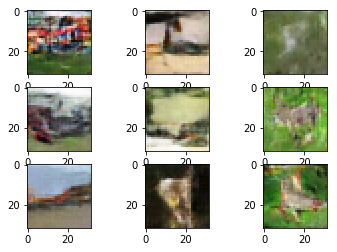

Epoch 1230/1230
64/64 [==============================] - 0s 617us/step - loss: -8.2661 - model_1_loss: -42.9627
Epoch 1230/1230
64/64 [==============================] - 0s 642us/step - loss: -7.9572 - model_1_loss: -54.8039
Epoch 1230/1230
64/64 [==============================] - 0s 648us/step - loss: -26.9171 - model_1_loss: -67.1347
Epoch 1230/1230
64/64 [==============================] - 0s 660us/step - loss: -19.6424 - model_1_loss: -85.8358
Epoch 1230/1230
64/64 [==============================] - 0s 639us/step - loss: -25.9183 - model_1_loss: -112.9172
Epoch 1230/1230
64/64 [==============================] - 0s 717us/step - loss: 95.9470


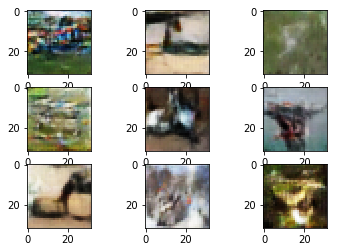

Epoch 1240/1240
64/64 [==============================] - 0s 613us/step - loss: -12.3536 - model_1_loss: -121.6401
Epoch 1240/1240
64/64 [==============================] - 0s 655us/step - loss: -21.2072 - model_1_loss: -118.3000
Epoch 1240/1240
64/64 [==============================] - 0s 642us/step - loss: -21.9720 - model_1_loss: -130.9367
Epoch 1240/1240
64/64 [==============================] - 0s 653us/step - loss: -18.3208 - model_1_loss: -133.6823
Epoch 1240/1240
64/64 [==============================] - 0s 654us/step - loss: -20.4422 - model_1_loss: -119.3164
Epoch 1240/1240
64/64 [==============================] - 0s 725us/step - loss: 116.5685


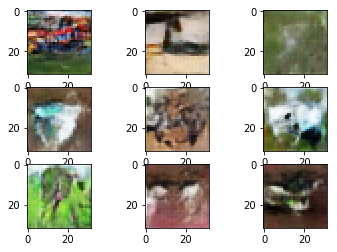

Epoch 1250/1250
64/64 [==============================] - 0s 617us/step - loss: -16.6588 - model_1_loss: -137.9124
Epoch 1250/1250
64/64 [==============================] - 0s 655us/step - loss: -30.4101 - model_1_loss: -104.8736
Epoch 1250/1250
64/64 [==============================] - 0s 646us/step - loss: -19.6017 - model_1_loss: -115.7199
Epoch 1250/1250
64/64 [==============================] - 0s 675us/step - loss: -17.0510 - model_1_loss: -89.7200
Epoch 1250/1250
64/64 [==============================] - 0s 642us/step - loss: -22.7092 - model_1_loss: -84.6009
Epoch 1250/1250
64/64 [==============================] - 0s 742us/step - loss: 110.5541


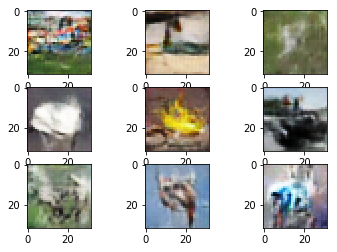

Epoch 1260/1260
64/64 [==============================] - 0s 623us/step - loss: -24.4919 - model_1_loss: -111.8726
Epoch 1260/1260
64/64 [==============================] - 0s 659us/step - loss: -13.4857 - model_1_loss: -141.0902
Epoch 1260/1260
64/64 [==============================] - 0s 663us/step - loss: -16.1865 - model_1_loss: -159.7340
Epoch 1260/1260
64/64 [==============================] - 0s 676us/step - loss: -5.5713 - model_1_loss: -172.0209
Epoch 1260/1260
64/64 [==============================] - 0s 646us/step - loss: -18.1691 - model_1_loss: -154.6287
Epoch 1260/1260
64/64 [==============================] - 0s 735us/step - loss: 146.7983


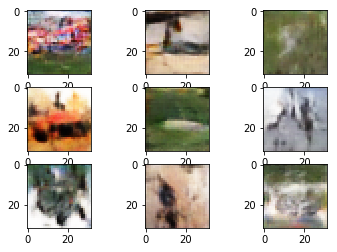

Epoch 1270/1270
64/64 [==============================] - 0s 626us/step - loss: -18.4470 - model_1_loss: -121.2916
Epoch 1270/1270
64/64 [==============================] - 0s 633us/step - loss: -24.9632 - model_1_loss: -105.5044
Epoch 1270/1270
64/64 [==============================] - 0s 648us/step - loss: -16.5534 - model_1_loss: -102.7678
Epoch 1270/1270
64/64 [==============================] - 0s 648us/step - loss: -18.8213 - model_1_loss: -92.6338
Epoch 1270/1270
64/64 [==============================] - 0s 710us/step - loss: -28.8866 - model_1_loss: -116.0047
Epoch 1270/1270
64/64 [==============================] - 0s 753us/step - loss: 130.0972


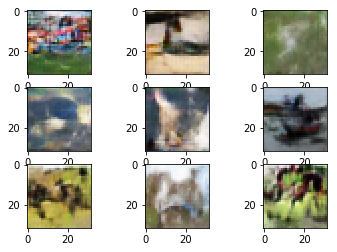

Epoch 1280/1280
64/64 [==============================] - 0s 621us/step - loss: -13.2576 - model_1_loss: -87.9394
Epoch 1280/1280
64/64 [==============================] - 0s 667us/step - loss: -19.9704 - model_1_loss: -110.5327
Epoch 1280/1280
64/64 [==============================] - 0s 661us/step - loss: -30.4434 - model_1_loss: -112.2917
Epoch 1280/1280
64/64 [==============================] - 0s 653us/step - loss: -15.4091 - model_1_loss: -111.4961
Epoch 1280/1280
64/64 [==============================] - 0s 663us/step - loss: -17.9041 - model_1_loss: -110.4359
Epoch 1280/1280
64/64 [==============================] - 0s 733us/step - loss: 103.0684


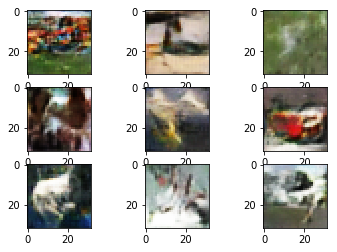

Epoch 1290/1290
64/64 [==============================] - 0s 630us/step - loss: -12.7326 - model_1_loss: -107.4387
Epoch 1290/1290
64/64 [==============================] - 0s 661us/step - loss: -26.7232 - model_1_loss: -91.4828
Epoch 1290/1290
64/64 [==============================] - 0s 654us/step - loss: -17.6257 - model_1_loss: -116.2580
Epoch 1290/1290
64/64 [==============================] - 0s 651us/step - loss: -28.1368 - model_1_loss: -147.8880
Epoch 1290/1290
64/64 [==============================] - 0s 641us/step - loss: -35.3169 - model_1_loss: -149.1553
Epoch 1290/1290
64/64 [==============================] - 0s 751us/step - loss: 138.4224


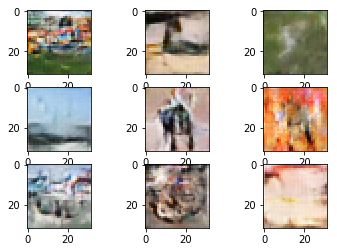

Epoch 1300/1300
64/64 [==============================] - 0s 612us/step - loss: -11.9398 - model_1_loss: -44.5570
Epoch 1300/1300
64/64 [==============================] - 0s 649us/step - loss: 1.8325 - model_1_loss: -45.5403
Epoch 1300/1300
64/64 [==============================] - 0s 664us/step - loss: -20.3697 - model_1_loss: -86.7129
Epoch 1300/1300
64/64 [==============================] - 0s 662us/step - loss: -29.2490 - model_1_loss: -125.6680
Epoch 1300/1300
64/64 [==============================] - 0s 652us/step - loss: -23.8615 - model_1_loss: -119.7443
Epoch 1300/1300
64/64 [==============================] - 0s 737us/step - loss: 81.5867


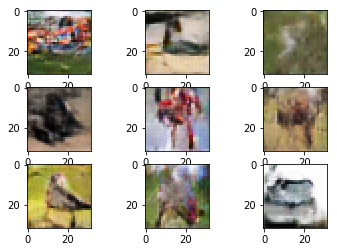

Epoch 1310/1310
64/64 [==============================] - 0s 619us/step - loss: -24.2411 - model_1_loss: -121.5449
Epoch 1310/1310
64/64 [==============================] - 0s 622us/step - loss: -12.9285 - model_1_loss: -91.6684
Epoch 1310/1310
64/64 [==============================] - 0s 668us/step - loss: -16.7592 - model_1_loss: -110.8520
Epoch 1310/1310
64/64 [==============================] - 0s 653us/step - loss: -19.8767 - model_1_loss: -140.0013
Epoch 1310/1310
64/64 [==============================] - 0s 662us/step - loss: -23.1181 - model_1_loss: -109.8654
Epoch 1310/1310
64/64 [==============================] - 0s 743us/step - loss: 96.3825


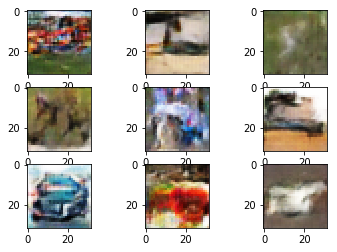

Epoch 1320/1320
64/64 [==============================] - 0s 621us/step - loss: -5.6856 - model_1_loss: -98.6828
Epoch 1320/1320
64/64 [==============================] - 0s 643us/step - loss: -35.0584 - model_1_loss: -137.7622
Epoch 1320/1320
64/64 [==============================] - 0s 647us/step - loss: -25.0448 - model_1_loss: -127.7782
Epoch 1320/1320
64/64 [==============================] - 0s 655us/step - loss: -41.2431 - model_1_loss: -128.7931
Epoch 1320/1320
64/64 [==============================] - 0s 665us/step - loss: -3.5270 - model_1_loss: -115.4075
Epoch 1320/1320
64/64 [==============================] - 0s 721us/step - loss: 103.0356


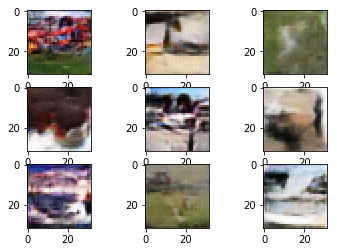

Epoch 1330/1330
64/64 [==============================] - 0s 628us/step - loss: -4.2368 - model_1_loss: -99.2068
Epoch 1330/1330
64/64 [==============================] - 0s 643us/step - loss: -22.8230 - model_1_loss: -110.9826
Epoch 1330/1330
64/64 [==============================] - 0s 641us/step - loss: -29.0759 - model_1_loss: -97.3559
Epoch 1330/1330
64/64 [==============================] - 0s 647us/step - loss: -27.5486 - model_1_loss: -105.2449
Epoch 1330/1330
64/64 [==============================] - 0s 648us/step - loss: -25.9705 - model_1_loss: -67.4036
Epoch 1330/1330
64/64 [==============================] - 0s 757us/step - loss: 70.0660


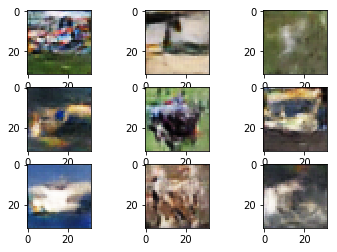

Epoch 1340/1340
64/64 [==============================] - 0s 609us/step - loss: -13.6341 - model_1_loss: -63.5517
Epoch 1340/1340
64/64 [==============================] - 0s 686us/step - loss: -17.8508 - model_1_loss: -64.4465
Epoch 1340/1340
64/64 [==============================] - 0s 650us/step - loss: -26.1935 - model_1_loss: -72.5122
Epoch 1340/1340
64/64 [==============================] - 0s 645us/step - loss: -25.4443 - model_1_loss: -83.5965
Epoch 1340/1340
64/64 [==============================] - 0s 655us/step - loss: -44.2252 - model_1_loss: -97.3371
Epoch 1340/1340
64/64 [==============================] - 0s 753us/step - loss: 61.1594


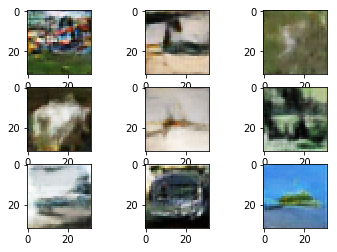

Epoch 1350/1350
64/64 [==============================] - 0s 620us/step - loss: -17.5318 - model_1_loss: -90.4218
Epoch 1350/1350
64/64 [==============================] - 0s 649us/step - loss: -22.4760 - model_1_loss: -91.9814
Epoch 1350/1350
64/64 [==============================] - 0s 653us/step - loss: -38.9562 - model_1_loss: -109.2251
Epoch 1350/1350
64/64 [==============================] - 0s 674us/step - loss: -26.7630 - model_1_loss: -84.9558
Epoch 1350/1350
64/64 [==============================] - 0s 655us/step - loss: -24.4368 - model_1_loss: -77.7818
Epoch 1350/1350
64/64 [==============================] - 0s 739us/step - loss: 68.1922


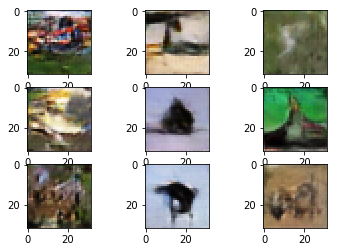

Epoch 1360/1360
64/64 [==============================] - 0s 681us/step - loss: -16.8357 - model_1_loss: -117.0129
Epoch 1360/1360
64/64 [==============================] - 0s 677us/step - loss: -19.9410 - model_1_loss: -83.5624
Epoch 1360/1360
64/64 [==============================] - 0s 637us/step - loss: -28.6217 - model_1_loss: -75.3934
Epoch 1360/1360
64/64 [==============================] - 0s 653us/step - loss: -29.0158 - model_1_loss: -89.2920
Epoch 1360/1360
64/64 [==============================] - 0s 647us/step - loss: -29.8736 - model_1_loss: -71.2776
Epoch 1360/1360
64/64 [==============================] - 0s 742us/step - loss: 84.5427


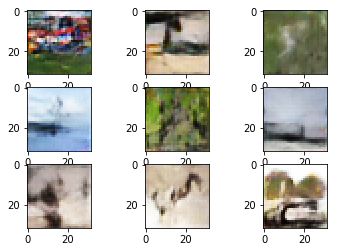

Epoch 1370/1370
64/64 [==============================] - 0s 616us/step - loss: -24.1984 - model_1_loss: -109.8735
Epoch 1370/1370
64/64 [==============================] - 0s 652us/step - loss: -23.4574 - model_1_loss: -76.7180
Epoch 1370/1370
64/64 [==============================] - 0s 664us/step - loss: -33.2679 - model_1_loss: -103.0609
Epoch 1370/1370
64/64 [==============================] - 0s 654us/step - loss: -23.2957 - model_1_loss: -64.3347
Epoch 1370/1370
64/64 [==============================] - 0s 671us/step - loss: -41.0164 - model_1_loss: -88.4010
Epoch 1370/1370
64/64 [==============================] - 0s 731us/step - loss: 78.5252


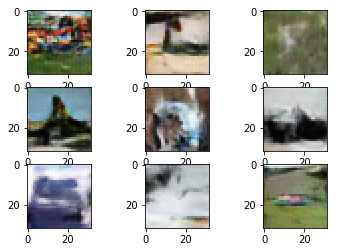

Epoch 1380/1380
64/64 [==============================] - 0s 645us/step - loss: -20.7273 - model_1_loss: -99.8951
Epoch 1380/1380
64/64 [==============================] - 0s 660us/step - loss: -23.8000 - model_1_loss: -88.7233
Epoch 1380/1380
64/64 [==============================] - 0s 670us/step - loss: -10.5374 - model_1_loss: -95.9551
Epoch 1380/1380
64/64 [==============================] - 0s 656us/step - loss: -22.3335 - model_1_loss: -99.9783
Epoch 1380/1380
64/64 [==============================] - 0s 658us/step - loss: -13.4443 - model_1_loss: -101.2302
Epoch 1380/1380
64/64 [==============================] - 0s 757us/step - loss: 105.3803


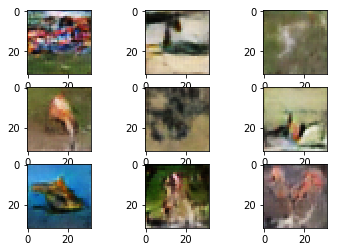

Epoch 1390/1390
64/64 [==============================] - 0s 635us/step - loss: -16.3864 - model_1_loss: -143.2724
Epoch 1390/1390
64/64 [==============================] - 0s 658us/step - loss: -6.7318 - model_1_loss: -137.8657
Epoch 1390/1390
64/64 [==============================] - 0s 651us/step - loss: -26.7386 - model_1_loss: -137.8319
Epoch 1390/1390
64/64 [==============================] - 0s 644us/step - loss: -24.8878 - model_1_loss: -140.9255
Epoch 1390/1390
64/64 [==============================] - 0s 663us/step - loss: -53.8086 - model_1_loss: -169.1113
Epoch 1390/1390
64/64 [==============================] - 0s 731us/step - loss: 148.0204


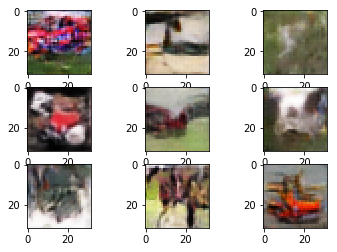

Epoch 1400/1400
64/64 [==============================] - 0s 622us/step - loss: -10.4598 - model_1_loss: -81.7972
Epoch 1400/1400
64/64 [==============================] - 0s 655us/step - loss: -23.3633 - model_1_loss: -67.6475
Epoch 1400/1400
64/64 [==============================] - 0s 656us/step - loss: -25.4529 - model_1_loss: -53.6205
Epoch 1400/1400
64/64 [==============================] - 0s 654us/step - loss: -17.9067 - model_1_loss: -79.0783
Epoch 1400/1400
64/64 [==============================] - 0s 654us/step - loss: -22.1784 - model_1_loss: -79.7542
Epoch 1400/1400
64/64 [==============================] - 0s 726us/step - loss: 57.2158


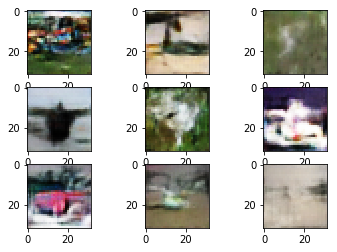

Epoch 1410/1410
64/64 [==============================] - 0s 625us/step - loss: 5.7751 - model_1_loss: -64.6211
Epoch 1410/1410
64/64 [==============================] - 0s 673us/step - loss: -16.8647 - model_1_loss: -90.5419
Epoch 1410/1410
64/64 [==============================] - 0s 660us/step - loss: -30.0629 - model_1_loss: -118.4085
Epoch 1410/1410
64/64 [==============================] - 0s 661us/step - loss: -33.6539 - model_1_loss: -108.0193
Epoch 1410/1410
64/64 [==============================] - 0s 652us/step - loss: -26.4917 - model_1_loss: -110.4649
Epoch 1410/1410
64/64 [==============================] - 0s 730us/step - loss: 106.4401


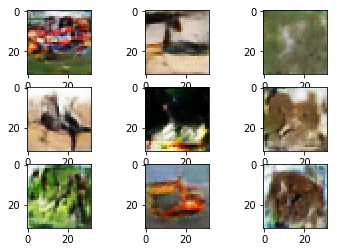

Epoch 1420/1420
64/64 [==============================] - 0s 628us/step - loss: -21.9966 - model_1_loss: -76.5137
Epoch 1420/1420
64/64 [==============================] - 0s 646us/step - loss: -32.5252 - model_1_loss: -83.7337
Epoch 1420/1420
64/64 [==============================] - 0s 655us/step - loss: -30.6064 - model_1_loss: -96.7192
Epoch 1420/1420
64/64 [==============================] - 0s 656us/step - loss: -31.9330 - model_1_loss: -63.2951
Epoch 1420/1420
64/64 [==============================] - 0s 653us/step - loss: -41.0182 - model_1_loss: -65.5565
Epoch 1420/1420
64/64 [==============================] - 0s 847us/step - loss: 56.5436


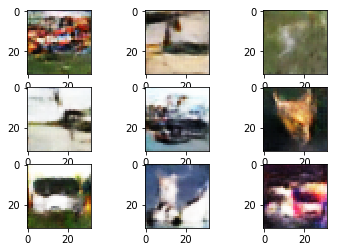

Epoch 1430/1430
64/64 [==============================] - 0s 620us/step - loss: -8.8451 - model_1_loss: -93.9896
Epoch 1430/1430
64/64 [==============================] - 0s 701us/step - loss: -20.1652 - model_1_loss: -134.0550
Epoch 1430/1430
64/64 [==============================] - 0s 648us/step - loss: -23.1752 - model_1_loss: -131.8214
Epoch 1430/1430
64/64 [==============================] - 0s 651us/step - loss: -25.5918 - model_1_loss: -146.6514
Epoch 1430/1430
64/64 [==============================] - 0s 643us/step - loss: -21.7629 - model_1_loss: -129.7193
Epoch 1430/1430
64/64 [==============================] - 0s 727us/step - loss: 114.8069


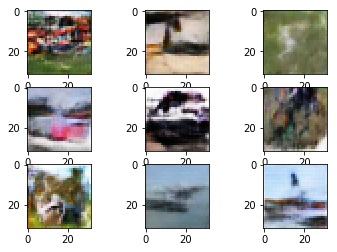

Epoch 1440/1440
64/64 [==============================] - 0s 625us/step - loss: -4.7125 - model_1_loss: -48.2639
Epoch 1440/1440
64/64 [==============================] - 0s 646us/step - loss: -20.3363 - model_1_loss: -42.8433
Epoch 1440/1440
64/64 [==============================] - 0s 658us/step - loss: -23.5186 - model_1_loss: -70.8862
Epoch 1440/1440
64/64 [==============================] - 0s 668us/step - loss: -33.4860 - model_1_loss: -75.1288
Epoch 1440/1440
64/64 [==============================] - 0s 655us/step - loss: -29.7227 - model_1_loss: -64.7013
Epoch 1440/1440
64/64 [==============================] - 0s 742us/step - loss: 67.6495


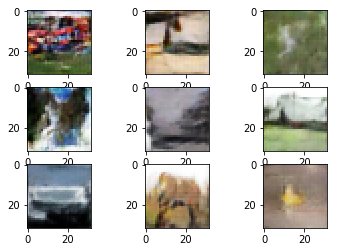

Epoch 1450/1450
64/64 [==============================] - 0s 626us/step - loss: -23.9690 - model_1_loss: -42.0739
Epoch 1450/1450
64/64 [==============================] - 0s 651us/step - loss: -11.9066 - model_1_loss: -37.6220
Epoch 1450/1450
64/64 [==============================] - 0s 670us/step - loss: -11.7341 - model_1_loss: -69.7745
Epoch 1450/1450
64/64 [==============================] - 0s 653us/step - loss: -23.7437 - model_1_loss: -85.1892
Epoch 1450/1450
64/64 [==============================] - 0s 659us/step - loss: -36.3613 - model_1_loss: -99.8437
Epoch 1450/1450
64/64 [==============================] - 0s 734us/step - loss: 85.9800


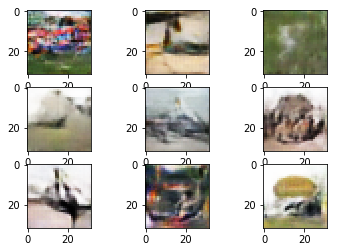

Epoch 1460/1460
64/64 [==============================] - 0s 623us/step - loss: -26.1001 - model_1_loss: -78.8651
Epoch 1460/1460
64/64 [==============================] - 0s 654us/step - loss: -19.0423 - model_1_loss: -80.5972
Epoch 1460/1460
64/64 [==============================] - 0s 654us/step - loss: -23.9767 - model_1_loss: -73.3780
Epoch 1460/1460
64/64 [==============================] - 0s 657us/step - loss: -24.0543 - model_1_loss: -75.7498
Epoch 1460/1460
64/64 [==============================] - 0s 644us/step - loss: -31.7719 - model_1_loss: -88.9340
Epoch 1460/1460
64/64 [==============================] - 0s 749us/step - loss: 78.7689


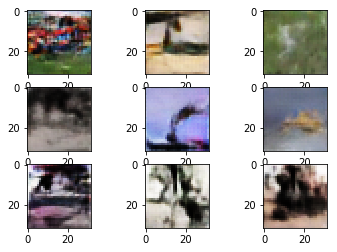

Epoch 1470/1470
64/64 [==============================] - 0s 621us/step - loss: -20.5076 - model_1_loss: -84.0419
Epoch 1470/1470
64/64 [==============================] - 0s 659us/step - loss: -41.6188 - model_1_loss: -96.4493
Epoch 1470/1470
64/64 [==============================] - 0s 655us/step - loss: -34.2175 - model_1_loss: -119.1462
Epoch 1470/1470
64/64 [==============================] - 0s 645us/step - loss: -50.0182 - model_1_loss: -106.6324
Epoch 1470/1470
64/64 [==============================] - 0s 657us/step - loss: -12.4892 - model_1_loss: -111.2383
Epoch 1470/1470
64/64 [==============================] - 0s 729us/step - loss: 60.9289


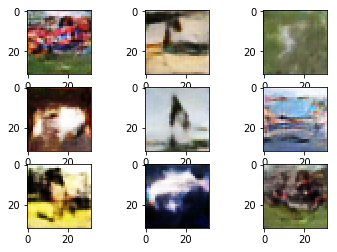

Epoch 1480/1480
64/64 [==============================] - 0s 630us/step - loss: -8.7267 - model_1_loss: -112.5654
Epoch 1480/1480
64/64 [==============================] - 0s 654us/step - loss: -23.1507 - model_1_loss: -133.3310
Epoch 1480/1480
64/64 [==============================] - 0s 650us/step - loss: -25.1553 - model_1_loss: -120.3630
Epoch 1480/1480
64/64 [==============================] - 0s 662us/step - loss: -35.4913 - model_1_loss: -103.5208
Epoch 1480/1480
64/64 [==============================] - 0s 642us/step - loss: -21.5505 - model_1_loss: -99.9209
Epoch 1480/1480
64/64 [==============================] - 0s 727us/step - loss: 97.0323


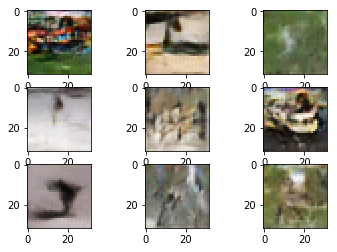

Epoch 1490/1490
64/64 [==============================] - 0s 632us/step - loss: -11.2987 - model_1_loss: -75.9109
Epoch 1490/1490
64/64 [==============================] - 0s 661us/step - loss: -31.6405 - model_1_loss: -116.1017
Epoch 1490/1490
64/64 [==============================] - 0s 655us/step - loss: -19.6571 - model_1_loss: -115.1207
Epoch 1490/1490
64/64 [==============================] - 0s 656us/step - loss: -24.9004 - model_1_loss: -128.2627
Epoch 1490/1490
64/64 [==============================] - 0s 650us/step - loss: -23.1171 - model_1_loss: -105.5634
Epoch 1490/1490
64/64 [==============================] - 0s 736us/step - loss: 40.7162


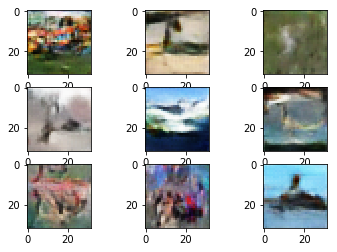

Epoch 1500/1500
64/64 [==============================] - 0s 644us/step - loss: -13.7900 - model_1_loss: -33.0337
Epoch 1500/1500
64/64 [==============================] - 0s 651us/step - loss: -17.2126 - model_1_loss: -55.7199
Epoch 1500/1500
64/64 [==============================] - 0s 660us/step - loss: -29.5997 - model_1_loss: -69.0137
Epoch 1500/1500
64/64 [==============================] - 0s 664us/step - loss: -25.2885 - model_1_loss: -58.7497
Epoch 1500/1500
64/64 [==============================] - 0s 655us/step - loss: -14.4601 - model_1_loss: -31.9058
Epoch 1500/1500
64/64 [==============================] - 0s 736us/step - loss: 48.8188


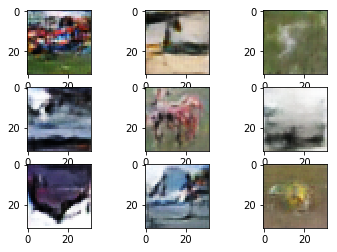

Epoch 1510/1510
64/64 [==============================] - 0s 625us/step - loss: -7.6508 - model_1_loss: -100.5551
Epoch 1510/1510
64/64 [==============================] - 0s 672us/step - loss: -16.6363 - model_1_loss: -119.5401
Epoch 1510/1510
64/64 [==============================] - 0s 663us/step - loss: -25.2492 - model_1_loss: -108.8707
Epoch 1510/1510
64/64 [==============================] - 0s 665us/step - loss: -35.2738 - model_1_loss: -145.3868
Epoch 1510/1510
64/64 [==============================] - 0s 656us/step - loss: -13.8122 - model_1_loss: -127.7450
Epoch 1510/1510
64/64 [==============================] - 0s 740us/step - loss: 116.8313


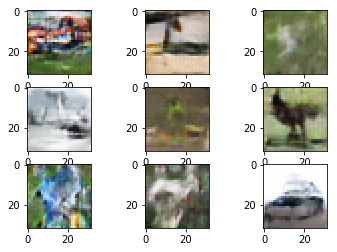

Epoch 1520/1520
64/64 [==============================] - 0s 640us/step - loss: -16.1901 - model_1_loss: -109.6012
Epoch 1520/1520
64/64 [==============================] - 0s 643us/step - loss: -39.7741 - model_1_loss: -104.4452
Epoch 1520/1520
64/64 [==============================] - 0s 645us/step - loss: -32.6484 - model_1_loss: -83.6146
Epoch 1520/1520
64/64 [==============================] - 0s 651us/step - loss: -23.2848 - model_1_loss: -100.3236
Epoch 1520/1520
64/64 [==============================] - 0s 655us/step - loss: -33.3479 - model_1_loss: -117.9797
Epoch 1520/1520
64/64 [==============================] - 0s 743us/step - loss: 71.0496


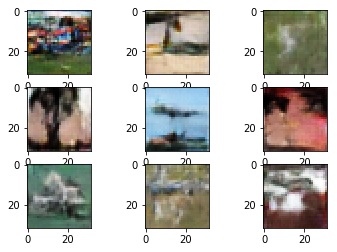

Epoch 1530/1530
64/64 [==============================] - 0s 629us/step - loss: -16.8119 - model_1_loss: -66.9082
Epoch 1530/1530
64/64 [==============================] - 0s 663us/step - loss: -21.5667 - model_1_loss: -54.7964
Epoch 1530/1530
64/64 [==============================] - 0s 660us/step - loss: -24.4644 - model_1_loss: -55.5571
Epoch 1530/1530
64/64 [==============================] - 0s 650us/step - loss: -16.8842 - model_1_loss: -71.2525
Epoch 1530/1530
64/64 [==============================] - 0s 665us/step - loss: -25.1972 - model_1_loss: -82.0894
Epoch 1530/1530
64/64 [==============================] - 0s 719us/step - loss: 71.6437


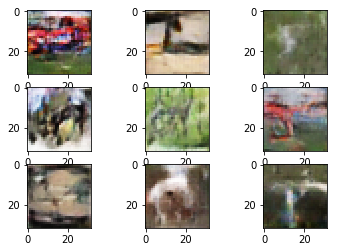

Epoch 1540/1540
64/64 [==============================] - 0s 630us/step - loss: -20.1045 - model_1_loss: -48.0834
Epoch 1540/1540
64/64 [==============================] - 0s 641us/step - loss: -14.6210 - model_1_loss: -64.4461
Epoch 1540/1540
64/64 [==============================] - 0s 650us/step - loss: -19.4303 - model_1_loss: -91.5953
Epoch 1540/1540
64/64 [==============================] - 0s 663us/step - loss: -25.3949 - model_1_loss: -70.9449
Epoch 1540/1540
64/64 [==============================] - 0s 665us/step - loss: -33.7271 - model_1_loss: -80.5957
Epoch 1540/1540
64/64 [==============================] - 0s 736us/step - loss: 101.9872


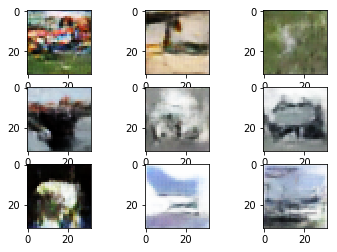

Epoch 1550/1550
64/64 [==============================] - 0s 618us/step - loss: -19.3998 - model_1_loss: -118.2968
Epoch 1550/1550
64/64 [==============================] - 0s 660us/step - loss: -15.5685 - model_1_loss: -112.3695
Epoch 1550/1550
64/64 [==============================] - 0s 649us/step - loss: -25.0372 - model_1_loss: -113.1923
Epoch 1550/1550
64/64 [==============================] - 0s 651us/step - loss: -42.7767 - model_1_loss: -82.0805
Epoch 1550/1550
64/64 [==============================] - 0s 656us/step - loss: -27.6131 - model_1_loss: -64.7978
Epoch 1550/1550
64/64 [==============================] - 0s 739us/step - loss: 85.2461


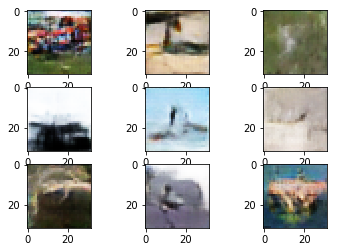

Epoch 1560/1560
64/64 [==============================] - 0s 643us/step - loss: -14.9304 - model_1_loss: -131.3776
Epoch 1560/1560
64/64 [==============================] - 0s 691us/step - loss: 2.7935 - model_1_loss: -129.9893
Epoch 1560/1560
64/64 [==============================] - 0s 657us/step - loss: -19.8670 - model_1_loss: -127.3645
Epoch 1560/1560
64/64 [==============================] - 0s 652us/step - loss: -21.3117 - model_1_loss: -94.3388
Epoch 1560/1560
64/64 [==============================] - 0s 645us/step - loss: -46.6599 - model_1_loss: -112.8296
Epoch 1560/1560
64/64 [==============================] - 0s 745us/step - loss: 122.9054


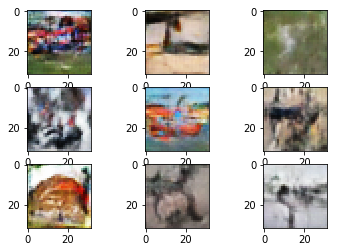

Epoch 1570/1570
64/64 [==============================] - 0s 624us/step - loss: -16.1690 - model_1_loss: -34.0479
Epoch 1570/1570
64/64 [==============================] - 0s 656us/step - loss: -25.1808 - model_1_loss: -14.7009
Epoch 1570/1570
64/64 [==============================] - 0s 668us/step - loss: -28.9267 - model_1_loss: -61.2904
Epoch 1570/1570
64/64 [==============================] - 0s 658us/step - loss: -21.4906 - model_1_loss: -89.3241
Epoch 1570/1570
64/64 [==============================] - 0s 645us/step - loss: -28.4535 - model_1_loss: -106.8773
Epoch 1570/1570
64/64 [==============================] - 0s 727us/step - loss: 107.5063


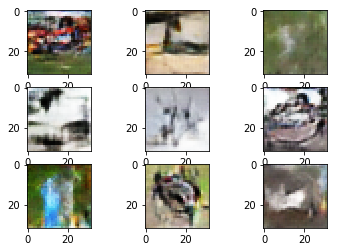

Epoch 1580/1580
64/64 [==============================] - 0s 637us/step - loss: -19.2596 - model_1_loss: -103.4495
Epoch 1580/1580
64/64 [==============================] - 0s 662us/step - loss: -28.6731 - model_1_loss: -98.6992
Epoch 1580/1580
64/64 [==============================] - 0s 660us/step - loss: -16.9112 - model_1_loss: -152.4074
Epoch 1580/1580
64/64 [==============================] - 0s 657us/step - loss: -38.2029 - model_1_loss: -148.3781
Epoch 1580/1580
64/64 [==============================] - 0s 658us/step - loss: -33.2437 - model_1_loss: -148.8309
Epoch 1580/1580
64/64 [==============================] - 0s 749us/step - loss: 157.4573


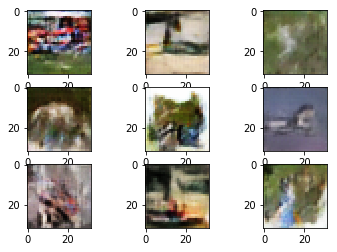

Epoch 1590/1590
64/64 [==============================] - 0s 639us/step - loss: -14.3872 - model_1_loss: -102.4800
Epoch 1590/1590
64/64 [==============================] - 0s 658us/step - loss: -26.3887 - model_1_loss: -107.3328
Epoch 1590/1590
64/64 [==============================] - 0s 650us/step - loss: -42.9128 - model_1_loss: -108.6803
Epoch 1590/1590
64/64 [==============================] - 0s 667us/step - loss: -33.8278 - model_1_loss: -90.0678
Epoch 1590/1590
64/64 [==============================] - 0s 671us/step - loss: -27.6609 - model_1_loss: -58.9581
Epoch 1590/1590
64/64 [==============================] - 0s 777us/step - loss: 42.9569


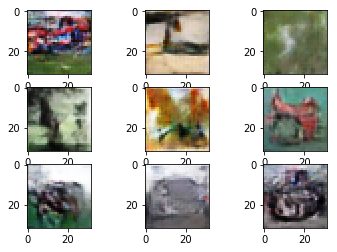

Epoch 1600/1600
64/64 [==============================] - 0s 618us/step - loss: -11.0161 - model_1_loss: -82.7608
Epoch 1600/1600
64/64 [==============================] - 0s 653us/step - loss: -18.1799 - model_1_loss: -91.4237
Epoch 1600/1600
64/64 [==============================] - 0s 658us/step - loss: -35.6161 - model_1_loss: -116.8112
Epoch 1600/1600
64/64 [==============================] - 0s 655us/step - loss: -18.4509 - model_1_loss: -88.1587
Epoch 1600/1600
64/64 [==============================] - 0s 667us/step - loss: -30.4148 - model_1_loss: -120.3249
Epoch 1600/1600
64/64 [==============================] - 0s 728us/step - loss: 108.9917


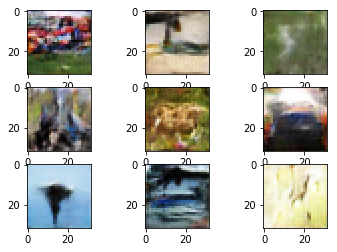

Epoch 1610/1610
64/64 [==============================] - 0s 645us/step - loss: -16.0441 - model_1_loss: -115.7938
Epoch 1610/1610
64/64 [==============================] - 0s 661us/step - loss: -21.9047 - model_1_loss: -135.2098
Epoch 1610/1610
64/64 [==============================] - 0s 659us/step - loss: -13.4789 - model_1_loss: -112.6632
Epoch 1610/1610
64/64 [==============================] - 0s 653us/step - loss: -18.3552 - model_1_loss: -116.8138
Epoch 1610/1610
64/64 [==============================] - 0s 655us/step - loss: -40.8272 - model_1_loss: -121.9183
Epoch 1610/1610
64/64 [==============================] - 0s 741us/step - loss: 106.1915


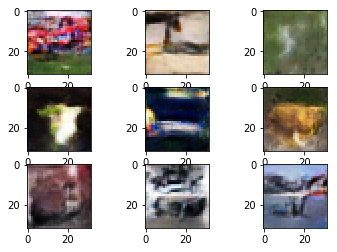

Epoch 1620/1620
64/64 [==============================] - 0s 614us/step - loss: -34.0574 - model_1_loss: -94.9458
Epoch 1620/1620
64/64 [==============================] - 0s 675us/step - loss: -13.5348 - model_1_loss: -77.2337
Epoch 1620/1620
64/64 [==============================] - 0s 674us/step - loss: -15.4752 - model_1_loss: -85.6516
Epoch 1620/1620
64/64 [==============================] - 0s 666us/step - loss: -32.3926 - model_1_loss: -95.2386
Epoch 1620/1620
64/64 [==============================] - 0s 690us/step - loss: -22.8752 - model_1_loss: -90.5547
Epoch 1620/1620
64/64 [==============================] - 0s 748us/step - loss: 93.4458


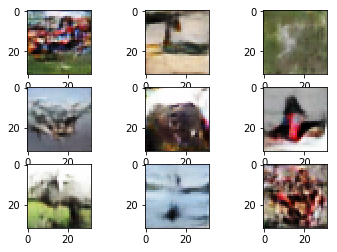

Epoch 1630/1630
64/64 [==============================] - 0s 636us/step - loss: -11.6245 - model_1_loss: -144.9515
Epoch 1630/1630
64/64 [==============================] - 0s 664us/step - loss: -11.3917 - model_1_loss: -134.4783
Epoch 1630/1630
64/64 [==============================] - 0s 675us/step - loss: -31.7290 - model_1_loss: -125.6310
Epoch 1630/1630
64/64 [==============================] - 0s 663us/step - loss: -33.2746 - model_1_loss: -112.6686
Epoch 1630/1630
64/64 [==============================] - 0s 652us/step - loss: -32.2001 - model_1_loss: -114.2458
Epoch 1630/1630
64/64 [==============================] - 0s 743us/step - loss: 104.2605


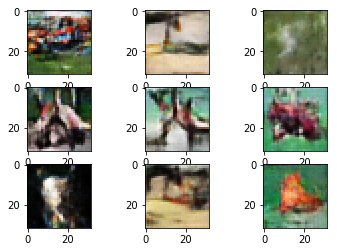

Epoch 1640/1640
64/64 [==============================] - 0s 632us/step - loss: -16.4751 - model_1_loss: -103.4779
Epoch 1640/1640
64/64 [==============================] - 0s 669us/step - loss: -15.4813 - model_1_loss: -128.5544
Epoch 1640/1640
64/64 [==============================] - 0s 652us/step - loss: -31.4777 - model_1_loss: -131.5965
Epoch 1640/1640
64/64 [==============================] - 0s 672us/step - loss: -31.2325 - model_1_loss: -119.7008
Epoch 1640/1640
64/64 [==============================] - 0s 661us/step - loss: -36.8803 - model_1_loss: -135.5178
Epoch 1640/1640
64/64 [==============================] - 0s 737us/step - loss: 138.4402


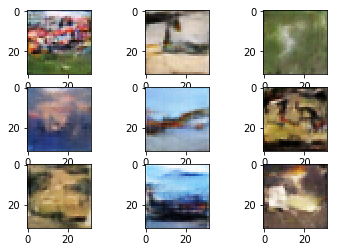

Epoch 1650/1650
64/64 [==============================] - 0s 628us/step - loss: -8.3295 - model_1_loss: -60.8709
Epoch 1650/1650
64/64 [==============================] - 0s 626us/step - loss: -12.1564 - model_1_loss: -80.2585
Epoch 1650/1650
64/64 [==============================] - 0s 654us/step - loss: -14.9237 - model_1_loss: -74.9846
Epoch 1650/1650
64/64 [==============================] - 0s 655us/step - loss: -20.7064 - model_1_loss: -99.6927
Epoch 1650/1650
64/64 [==============================] - 0s 675us/step - loss: -27.1001 - model_1_loss: -83.3751
Epoch 1650/1650
64/64 [==============================] - 0s 747us/step - loss: 97.3186


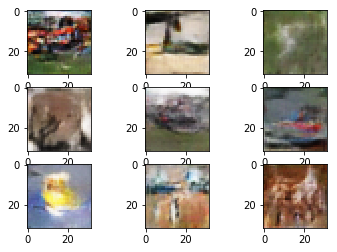

Epoch 1660/1660
64/64 [==============================] - 0s 627us/step - loss: -19.6192 - model_1_loss: -86.7221
Epoch 1660/1660
64/64 [==============================] - 0s 669us/step - loss: -31.8471 - model_1_loss: -102.1782
Epoch 1660/1660
64/64 [==============================] - 0s 660us/step - loss: -14.1448 - model_1_loss: -72.2002
Epoch 1660/1660
64/64 [==============================] - 0s 654us/step - loss: -22.6366 - model_1_loss: -100.5286
Epoch 1660/1660
64/64 [==============================] - 0s 656us/step - loss: -36.5241 - model_1_loss: -113.8489
Epoch 1660/1660
64/64 [==============================] - 0s 741us/step - loss: 106.3637


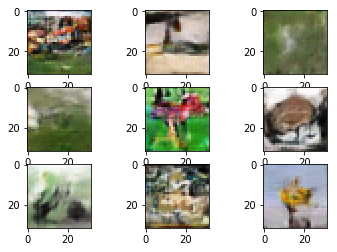

Epoch 1670/1670
64/64 [==============================] - 0s 643us/step - loss: -19.7943 - model_1_loss: -93.7700
Epoch 1670/1670
64/64 [==============================] - 0s 672us/step - loss: -24.4284 - model_1_loss: -105.0342
Epoch 1670/1670
64/64 [==============================] - 0s 650us/step - loss: -32.7180 - model_1_loss: -89.5704
Epoch 1670/1670
64/64 [==============================] - 0s 657us/step - loss: -34.5959 - model_1_loss: -69.8999
Epoch 1670/1670
64/64 [==============================] - 0s 655us/step - loss: -26.2775 - model_1_loss: -77.2181
Epoch 1670/1670
64/64 [==============================] - 0s 734us/step - loss: 37.4646


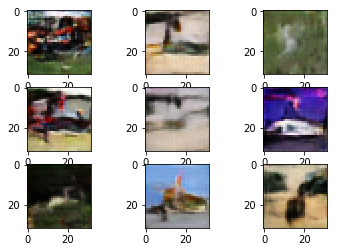

Epoch 1680/1680
64/64 [==============================] - 0s 639us/step - loss: -24.8155 - model_1_loss: -104.8929
Epoch 1680/1680
64/64 [==============================] - 0s 660us/step - loss: -17.0016 - model_1_loss: -117.8902
Epoch 1680/1680
64/64 [==============================] - 0s 658us/step - loss: -22.0838 - model_1_loss: -143.3848
Epoch 1680/1680
64/64 [==============================] - 0s 661us/step - loss: -28.6600 - model_1_loss: -159.2644
Epoch 1680/1680
64/64 [==============================] - 0s 671us/step - loss: -35.5637 - model_1_loss: -144.1685
Epoch 1680/1680
64/64 [==============================] - 0s 733us/step - loss: 152.6095


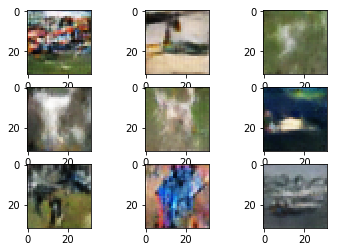

Epoch 1690/1690
64/64 [==============================] - 0s 629us/step - loss: -39.6895 - model_1_loss: -126.5859
Epoch 1690/1690
64/64 [==============================] - 0s 663us/step - loss: -31.0944 - model_1_loss: -107.9817
Epoch 1690/1690
64/64 [==============================] - 0s 663us/step - loss: -12.3434 - model_1_loss: -93.7542
Epoch 1690/1690
64/64 [==============================] - 0s 659us/step - loss: -31.6126 - model_1_loss: -80.8131
Epoch 1690/1690
64/64 [==============================] - 0s 668us/step - loss: -18.9693 - model_1_loss: -110.0384
Epoch 1690/1690
64/64 [==============================] - 0s 746us/step - loss: 109.4779


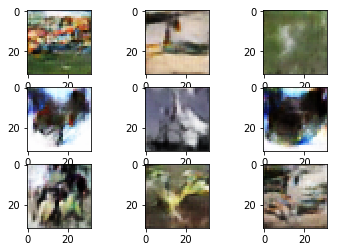

Epoch 1700/1700
64/64 [==============================] - 0s 620us/step - loss: -22.8658 - model_1_loss: -92.8688
Epoch 1700/1700
64/64 [==============================] - 0s 653us/step - loss: -41.5197 - model_1_loss: -106.1847
Epoch 1700/1700
64/64 [==============================] - 0s 669us/step - loss: -12.2761 - model_1_loss: -98.7512
Epoch 1700/1700
64/64 [==============================] - 0s 679us/step - loss: -10.8603 - model_1_loss: -109.3492
Epoch 1700/1700
64/64 [==============================] - 0s 658us/step - loss: -24.5087 - model_1_loss: -108.5369
Epoch 1700/1700
64/64 [==============================] - 0s 751us/step - loss: 109.1874


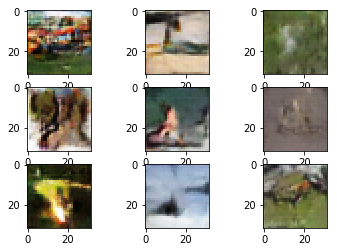

Epoch 1710/1710
64/64 [==============================] - 0s 630us/step - loss: -16.8037 - model_1_loss: -66.1520
Epoch 1710/1710
64/64 [==============================] - 0s 647us/step - loss: -6.8179 - model_1_loss: -77.5826
Epoch 1710/1710
64/64 [==============================] - 0s 655us/step - loss: -24.4177 - model_1_loss: -77.7073
Epoch 1710/1710
64/64 [==============================] - 0s 661us/step - loss: -27.1348 - model_1_loss: -73.0324
Epoch 1710/1710
64/64 [==============================] - 0s 658us/step - loss: -23.2958 - model_1_loss: -73.9635
Epoch 1710/1710
64/64 [==============================] - 0s 738us/step - loss: 60.9938


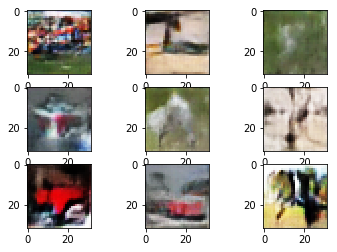

Epoch 1720/1720
64/64 [==============================] - 0s 627us/step - loss: -21.1283 - model_1_loss: -73.4054
Epoch 1720/1720
64/64 [==============================] - 0s 659us/step - loss: -26.3547 - model_1_loss: -78.3075
Epoch 1720/1720
64/64 [==============================] - 0s 652us/step - loss: -6.2412 - model_1_loss: -31.0098
Epoch 1720/1720
64/64 [==============================] - 0s 649us/step - loss: -24.7043 - model_1_loss: -54.4120
Epoch 1720/1720
64/64 [==============================] - 0s 659us/step - loss: -15.7141 - model_1_loss: -53.7238
Epoch 1720/1720
64/64 [==============================] - 0s 725us/step - loss: 58.6183


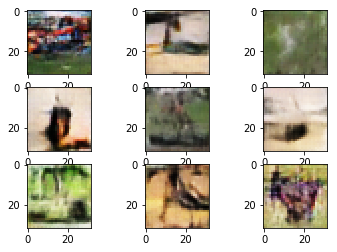

Epoch 1730/1730
64/64 [==============================] - 0s 641us/step - loss: -28.5365 - model_1_loss: -115.1459
Epoch 1730/1730
64/64 [==============================] - 0s 675us/step - loss: -24.8233 - model_1_loss: -126.0535
Epoch 1730/1730
64/64 [==============================] - 0s 653us/step - loss: -29.9339 - model_1_loss: -136.6751
Epoch 1730/1730
64/64 [==============================] - 0s 649us/step - loss: -20.0392 - model_1_loss: -149.0999
Epoch 1730/1730
64/64 [==============================] - 0s 658us/step - loss: -43.5780 - model_1_loss: -136.0034
Epoch 1730/1730
64/64 [==============================] - 0s 740us/step - loss: 109.6970


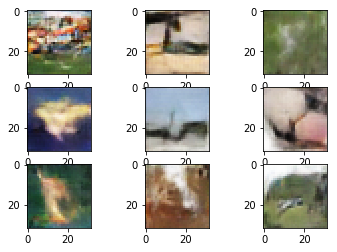

Epoch 1740/1740
64/64 [==============================] - 0s 621us/step - loss: -22.5158 - model_1_loss: -28.8607
Epoch 1740/1740
64/64 [==============================] - 0s 653us/step - loss: -29.9255 - model_1_loss: -72.7817
Epoch 1740/1740
64/64 [==============================] - 0s 657us/step - loss: -11.2318 - model_1_loss: -91.2289
Epoch 1740/1740
64/64 [==============================] - 0s 656us/step - loss: -23.0090 - model_1_loss: -70.1517
Epoch 1740/1740
64/64 [==============================] - 0s 645us/step - loss: -24.6399 - model_1_loss: -106.2267
Epoch 1740/1740
64/64 [==============================] - 0s 780us/step - loss: 124.8774


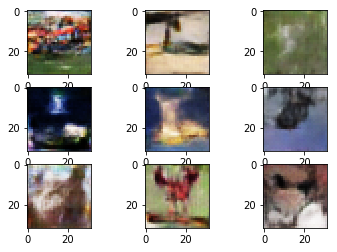

Epoch 1750/1750
64/64 [==============================] - 0s 638us/step - loss: -27.8413 - model_1_loss: -130.5662
Epoch 1750/1750
64/64 [==============================] - 0s 652us/step - loss: -16.0815 - model_1_loss: -111.0589
Epoch 1750/1750
64/64 [==============================] - 0s 661us/step - loss: -26.1396 - model_1_loss: -117.2144
Epoch 1750/1750
64/64 [==============================] - 0s 648us/step - loss: -20.8189 - model_1_loss: -95.2386
Epoch 1750/1750
64/64 [==============================] - 0s 652us/step - loss: -34.6826 - model_1_loss: -91.2553
Epoch 1750/1750
64/64 [==============================] - 0s 747us/step - loss: 73.1918


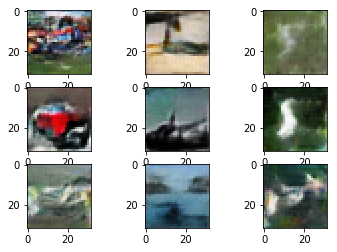

Epoch 1760/1760
64/64 [==============================] - 0s 645us/step - loss: -10.6262 - model_1_loss: -58.7986
Epoch 1760/1760
64/64 [==============================] - 0s 625us/step - loss: -13.9585 - model_1_loss: -78.2405
Epoch 1760/1760
64/64 [==============================] - 0s 669us/step - loss: -22.6904 - model_1_loss: -98.1641
Epoch 1760/1760
64/64 [==============================] - 0s 696us/step - loss: -20.1721 - model_1_loss: -89.2362
Epoch 1760/1760
64/64 [==============================] - 0s 680us/step - loss: -31.1805 - model_1_loss: -80.1817
Epoch 1760/1760
64/64 [==============================] - 0s 742us/step - loss: 81.5529


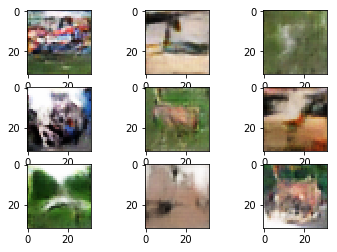

Epoch 1770/1770
64/64 [==============================] - 0s 641us/step - loss: -13.1346 - model_1_loss: -52.5518
Epoch 1770/1770
64/64 [==============================] - 0s 657us/step - loss: -33.5944 - model_1_loss: -56.4420
Epoch 1770/1770
64/64 [==============================] - 0s 651us/step - loss: -18.8099 - model_1_loss: -81.0767
Epoch 1770/1770
64/64 [==============================] - 0s 655us/step - loss: -19.1706 - model_1_loss: -103.7774
Epoch 1770/1770
64/64 [==============================] - 0s 658us/step - loss: -30.2647 - model_1_loss: -88.2562
Epoch 1770/1770
64/64 [==============================] - 0s 744us/step - loss: 80.8063


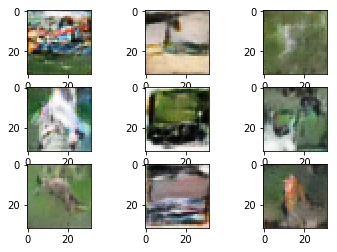

Epoch 1780/1780
64/64 [==============================] - 0s 639us/step - loss: -18.6096 - model_1_loss: -71.7808
Epoch 1780/1780
64/64 [==============================] - 0s 663us/step - loss: -13.2145 - model_1_loss: -75.0335
Epoch 1780/1780
64/64 [==============================] - 0s 657us/step - loss: -26.4835 - model_1_loss: -99.0373
Epoch 1780/1780
64/64 [==============================] - 0s 678us/step - loss: -25.4402 - model_1_loss: -99.6745
Epoch 1780/1780
64/64 [==============================] - 0s 658us/step - loss: -29.9547 - model_1_loss: -84.9201
Epoch 1780/1780
64/64 [==============================] - 0s 744us/step - loss: 89.3260


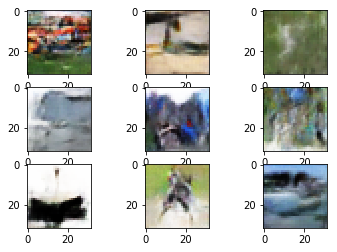

Epoch 1790/1790
64/64 [==============================] - 0s 660us/step - loss: -5.6094 - model_1_loss: -124.7611
Epoch 1790/1790
64/64 [==============================] - 0s 675us/step - loss: -36.1037 - model_1_loss: -127.8381
Epoch 1790/1790
64/64 [==============================] - 0s 671us/step - loss: -10.6838 - model_1_loss: -80.8961
Epoch 1790/1790
64/64 [==============================] - 0s 666us/step - loss: -22.9650 - model_1_loss: -51.1311
Epoch 1790/1790
64/64 [==============================] - 0s 662us/step - loss: -19.1079 - model_1_loss: -90.0380
Epoch 1790/1790
64/64 [==============================] - 0s 769us/step - loss: 80.6135


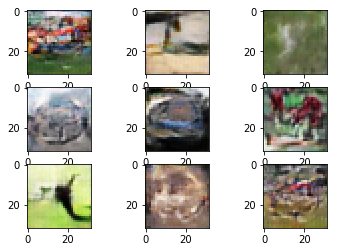

Epoch 1800/1800
64/64 [==============================] - 0s 627us/step - loss: 8.2770 - model_1_loss: -10.4363
Epoch 1800/1800
64/64 [==============================] - 0s 679us/step - loss: -16.1634 - model_1_loss: -61.8841
Epoch 1800/1800
64/64 [==============================] - 0s 671us/step - loss: -7.3082 - model_1_loss: -35.8409
Epoch 1800/1800
64/64 [==============================] - 0s 678us/step - loss: -21.8778 - model_1_loss: -82.9705
Epoch 1800/1800
64/64 [==============================] - 0s 662us/step - loss: -32.1322 - model_1_loss: -71.1418
Epoch 1800/1800
64/64 [==============================] - 0s 757us/step - loss: 79.8102


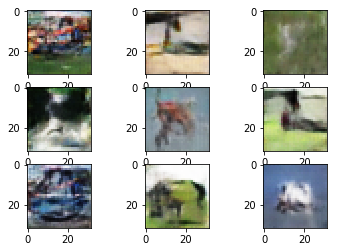

Epoch 1810/1810
64/64 [==============================] - 0s 617us/step - loss: -20.5169 - model_1_loss: -131.8872
Epoch 1810/1810
64/64 [==============================] - 0s 658us/step - loss: -4.5538 - model_1_loss: -115.0235
Epoch 1810/1810
64/64 [==============================] - 0s 689us/step - loss: -31.0733 - model_1_loss: -116.7407
Epoch 1810/1810
64/64 [==============================] - 0s 664us/step - loss: -30.7025 - model_1_loss: -110.2747
Epoch 1810/1810
64/64 [==============================] - 0s 650us/step - loss: -40.6841 - model_1_loss: -128.0035
Epoch 1810/1810
64/64 [==============================] - 0s 764us/step - loss: 135.0575


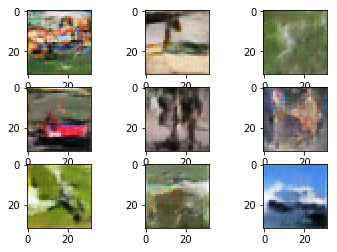

Epoch 1820/1820
64/64 [==============================] - 0s 635us/step - loss: -11.8313 - model_1_loss: -45.3585
Epoch 1820/1820
64/64 [==============================] - 0s 655us/step - loss: -26.1192 - model_1_loss: -66.2725
Epoch 1820/1820
64/64 [==============================] - 0s 680us/step - loss: -15.7164 - model_1_loss: -57.1376
Epoch 1820/1820
64/64 [==============================] - 0s 660us/step - loss: -34.5114 - model_1_loss: -85.3534
Epoch 1820/1820
64/64 [==============================] - 0s 651us/step - loss: -30.3606 - model_1_loss: -99.0570
Epoch 1820/1820
64/64 [==============================] - 0s 740us/step - loss: 86.0497


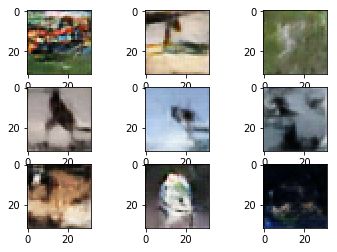

Epoch 1830/1830
64/64 [==============================] - 0s 626us/step - loss: -6.9750 - model_1_loss: -86.5821
Epoch 1830/1830
64/64 [==============================] - 0s 664us/step - loss: -15.0772 - model_1_loss: -77.6881
Epoch 1830/1830
64/64 [==============================] - 0s 669us/step - loss: -19.0496 - model_1_loss: -66.9687
Epoch 1830/1830
64/64 [==============================] - 0s 666us/step - loss: -21.1361 - model_1_loss: -68.2438
Epoch 1830/1830
64/64 [==============================] - 0s 685us/step - loss: -19.4816 - model_1_loss: -84.7482
Epoch 1830/1830
64/64 [==============================] - 0s 794us/step - loss: 73.0116


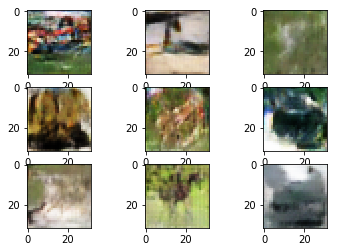

Epoch 1840/1840
64/64 [==============================] - 0s 622us/step - loss: -12.7997 - model_1_loss: -113.4250
Epoch 1840/1840
64/64 [==============================] - 0s 658us/step - loss: -29.7135 - model_1_loss: -136.5083
Epoch 1840/1840
64/64 [==============================] - 0s 673us/step - loss: -28.0860 - model_1_loss: -127.9844
Epoch 1840/1840
64/64 [==============================] - 0s 655us/step - loss: -30.5219 - model_1_loss: -116.6488
Epoch 1840/1840
64/64 [==============================] - 0s 661us/step - loss: -27.4703 - model_1_loss: -133.8305
Epoch 1840/1840
64/64 [==============================] - 0s 746us/step - loss: 93.4868


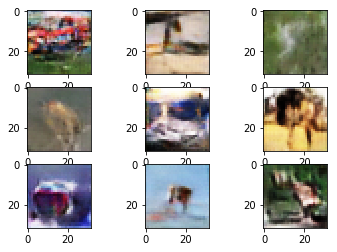

Epoch 1850/1850
64/64 [==============================] - 0s 644us/step - loss: -21.5943 - model_1_loss: -79.3376
Epoch 1850/1850
64/64 [==============================] - 0s 655us/step - loss: -20.7830 - model_1_loss: -80.7969
Epoch 1850/1850
64/64 [==============================] - 0s 657us/step - loss: -19.6899 - model_1_loss: -69.4501
Epoch 1850/1850
64/64 [==============================] - 0s 656us/step - loss: -20.8573 - model_1_loss: -99.1898
Epoch 1850/1850
64/64 [==============================] - 0s 679us/step - loss: -41.8298 - model_1_loss: -107.5061
Epoch 1850/1850
64/64 [==============================] - 0s 765us/step - loss: 102.9320


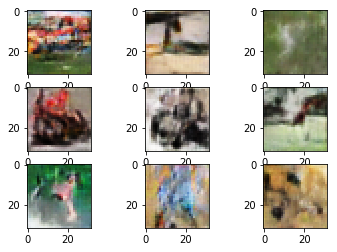

Epoch 1860/1860
64/64 [==============================] - 0s 647us/step - loss: -0.7987 - model_1_loss: -118.4497
Epoch 1860/1860
64/64 [==============================] - 0s 665us/step - loss: -13.9755 - model_1_loss: -126.6061
Epoch 1860/1860
64/64 [==============================] - 0s 664us/step - loss: -21.6039 - model_1_loss: -134.7997
Epoch 1860/1860
64/64 [==============================] - 0s 680us/step - loss: -18.4696 - model_1_loss: -114.6994
Epoch 1860/1860
64/64 [==============================] - 0s 676us/step - loss: -32.0363 - model_1_loss: -121.9279
Epoch 1860/1860
64/64 [==============================] - 0s 750us/step - loss: 125.3768


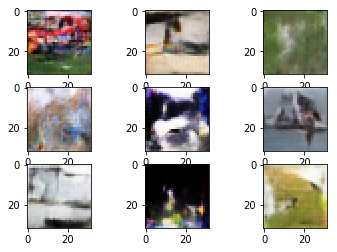

Epoch 1870/1870
64/64 [==============================] - 0s 618us/step - loss: -16.5262 - model_1_loss: -59.8792
Epoch 1870/1870
64/64 [==============================] - 0s 626us/step - loss: -30.1078 - model_1_loss: -86.0810
Epoch 1870/1870
64/64 [==============================] - 0s 668us/step - loss: -19.4448 - model_1_loss: -94.7740
Epoch 1870/1870
64/64 [==============================] - 0s 661us/step - loss: -27.6679 - model_1_loss: -114.5328
Epoch 1870/1870
64/64 [==============================] - 0s 664us/step - loss: -33.6784 - model_1_loss: -103.5476
Epoch 1870/1870
64/64 [==============================] - 0s 735us/step - loss: 109.0378


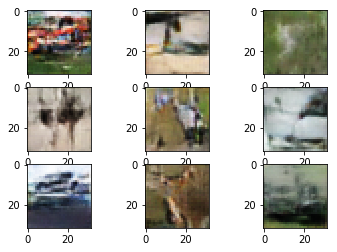

Epoch 1880/1880
64/64 [==============================] - 0s 630us/step - loss: -25.4441 - model_1_loss: -144.6183
Epoch 1880/1880
64/64 [==============================] - 0s 667us/step - loss: -22.7502 - model_1_loss: -144.6717
Epoch 1880/1880
64/64 [==============================] - 0s 652us/step - loss: -29.8379 - model_1_loss: -131.6459
Epoch 1880/1880
64/64 [==============================] - 0s 668us/step - loss: -42.1730 - model_1_loss: -156.5035
Epoch 1880/1880
64/64 [==============================] - 0s 663us/step - loss: -15.9425 - model_1_loss: -125.4822
Epoch 1880/1880
64/64 [==============================] - 0s 747us/step - loss: 152.9919


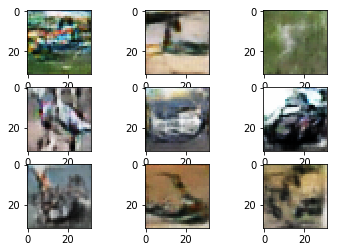

Epoch 1890/1890
64/64 [==============================] - 0s 626us/step - loss: -15.0408 - model_1_loss: -115.3038
Epoch 1890/1890
64/64 [==============================] - 0s 657us/step - loss: -24.1160 - model_1_loss: -109.5784
Epoch 1890/1890
64/64 [==============================] - 0s 667us/step - loss: -24.8458 - model_1_loss: -94.1194
Epoch 1890/1890
64/64 [==============================] - 0s 649us/step - loss: -19.1397 - model_1_loss: -94.5277
Epoch 1890/1890
64/64 [==============================] - 0s 649us/step - loss: -27.5241 - model_1_loss: -109.6916
Epoch 1890/1890
64/64 [==============================] - 0s 740us/step - loss: 143.6876


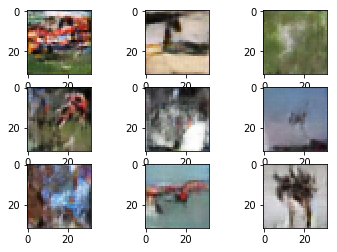

Epoch 1900/1900
64/64 [==============================] - 0s 705us/step - loss: -13.7916 - model_1_loss: -83.0726
Epoch 1900/1900
64/64 [==============================] - 0s 735us/step - loss: -27.7227 - model_1_loss: -100.3790
Epoch 1900/1900
64/64 [==============================] - 0s 738us/step - loss: -35.2770 - model_1_loss: -122.0565
Epoch 1900/1900
64/64 [==============================] - 0s 703us/step - loss: -30.6395 - model_1_loss: -114.0068
Epoch 1900/1900
64/64 [==============================] - 0s 705us/step - loss: -40.4309 - model_1_loss: -129.8445
Epoch 1900/1900
64/64 [==============================] - 0s 752us/step - loss: 135.8396


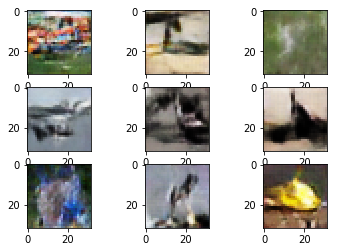

Epoch 1910/1910
64/64 [==============================] - 0s 636us/step - loss: -15.2937 - model_1_loss: -86.5224
Epoch 1910/1910
64/64 [==============================] - 0s 657us/step - loss: -28.1005 - model_1_loss: -92.8229
Epoch 1910/1910
64/64 [==============================] - 0s 656us/step - loss: -16.1859 - model_1_loss: -100.5353
Epoch 1910/1910
64/64 [==============================] - 0s 664us/step - loss: -32.6033 - model_1_loss: -107.3148
Epoch 1910/1910
64/64 [==============================] - 0s 661us/step - loss: -13.5443 - model_1_loss: -105.7939
Epoch 1910/1910
64/64 [==============================] - 0s 743us/step - loss: 95.4181


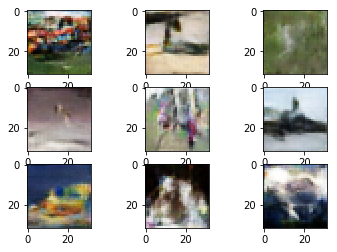

Epoch 1920/1920
64/64 [==============================] - 0s 638us/step - loss: -20.1374 - model_1_loss: -85.9026
Epoch 1920/1920
64/64 [==============================] - 0s 670us/step - loss: -13.7708 - model_1_loss: -105.0770
Epoch 1920/1920
64/64 [==============================] - 0s 668us/step - loss: -26.1119 - model_1_loss: -110.3059
Epoch 1920/1920
64/64 [==============================] - 0s 666us/step - loss: -30.7930 - model_1_loss: -115.9314
Epoch 1920/1920
64/64 [==============================] - 0s 666us/step - loss: -33.7519 - model_1_loss: -113.3156
Epoch 1920/1920
64/64 [==============================] - 0s 751us/step - loss: 117.8542


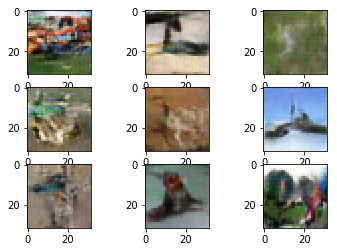

Epoch 1930/1930
64/64 [==============================] - 0s 629us/step - loss: -11.7684 - model_1_loss: -117.6139
Epoch 1930/1930
64/64 [==============================] - 0s 653us/step - loss: -7.1479 - model_1_loss: -127.0694
Epoch 1930/1930
64/64 [==============================] - 0s 669us/step - loss: -23.8482 - model_1_loss: -117.4560
Epoch 1930/1930
64/64 [==============================] - 0s 663us/step - loss: -30.2123 - model_1_loss: -102.6799
Epoch 1930/1930
64/64 [==============================] - 0s 662us/step - loss: -30.9824 - model_1_loss: -124.6968
Epoch 1930/1930
64/64 [==============================] - 0s 743us/step - loss: 116.1955


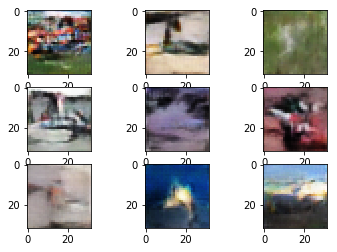

Epoch 1940/1940
64/64 [==============================] - 0s 637us/step - loss: -26.3299 - model_1_loss: -128.5302
Epoch 1940/1940
64/64 [==============================] - 0s 667us/step - loss: -14.1051 - model_1_loss: -139.1545
Epoch 1940/1940
64/64 [==============================] - 0s 657us/step - loss: -26.8604 - model_1_loss: -146.4667
Epoch 1940/1940
64/64 [==============================] - 0s 677us/step - loss: -17.2998 - model_1_loss: -127.6775
Epoch 1940/1940
64/64 [==============================] - 0s 657us/step - loss: -37.8458 - model_1_loss: -119.9537
Epoch 1940/1940
64/64 [==============================] - 0s 749us/step - loss: 133.4842


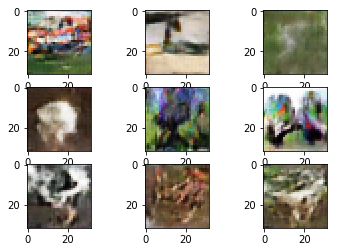

Epoch 1950/1950
64/64 [==============================] - 0s 631us/step - loss: -13.2396 - model_1_loss: -101.8415
Epoch 1950/1950
64/64 [==============================] - 0s 702us/step - loss: -26.2304 - model_1_loss: -100.1416
Epoch 1950/1950
64/64 [==============================] - 0s 678us/step - loss: -28.1657 - model_1_loss: -95.9506
Epoch 1950/1950
64/64 [==============================] - 0s 663us/step - loss: -27.2878 - model_1_loss: -69.0625
Epoch 1950/1950
64/64 [==============================] - 0s 677us/step - loss: -39.0721 - model_1_loss: -91.7088
Epoch 1950/1950
64/64 [==============================] - 0s 749us/step - loss: 76.3669


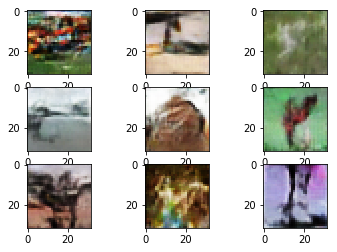

Epoch 1960/1960
64/64 [==============================] - 0s 660us/step - loss: -7.1679 - model_1_loss: -92.9496
Epoch 1960/1960
64/64 [==============================] - 0s 718us/step - loss: -6.0508 - model_1_loss: -108.8594
Epoch 1960/1960
64/64 [==============================] - 0s 675us/step - loss: -31.7060 - model_1_loss: -119.4137
Epoch 1960/1960
64/64 [==============================] - 0s 665us/step - loss: -35.4886 - model_1_loss: -95.4675
Epoch 1960/1960
64/64 [==============================] - 0s 670us/step - loss: -20.7298 - model_1_loss: -63.2113
Epoch 1960/1960
64/64 [==============================] - 0s 752us/step - loss: 42.1891


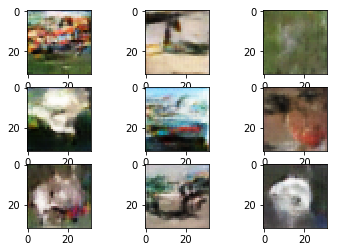

Epoch 1970/1970
64/64 [==============================] - 0s 634us/step - loss: -20.4619 - model_1_loss: -115.4580
Epoch 1970/1970
64/64 [==============================] - 0s 671us/step - loss: -24.6908 - model_1_loss: -117.5010
Epoch 1970/1970
64/64 [==============================] - 0s 663us/step - loss: -29.7243 - model_1_loss: -116.6407
Epoch 1970/1970
64/64 [==============================] - 0s 657us/step - loss: -26.1323 - model_1_loss: -149.4895
Epoch 1970/1970
64/64 [==============================] - 0s 670us/step - loss: -49.1859 - model_1_loss: -138.9126
Epoch 1970/1970
64/64 [==============================] - 0s 736us/step - loss: 105.6962


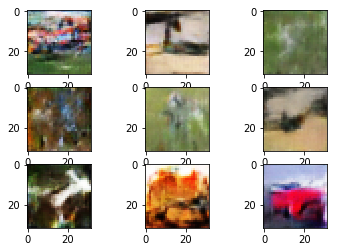

Epoch 1980/1980
64/64 [==============================] - 0s 633us/step - loss: -19.4628 - model_1_loss: -67.4423
Epoch 1980/1980
64/64 [==============================] - 0s 682us/step - loss: -4.4056 - model_1_loss: -68.9350
Epoch 1980/1980
64/64 [==============================] - 0s 670us/step - loss: -32.9981 - model_1_loss: -96.4583
Epoch 1980/1980
64/64 [==============================] - 0s 660us/step - loss: -14.1572 - model_1_loss: -76.8113
Epoch 1980/1980
64/64 [==============================] - 0s 655us/step - loss: -29.0902 - model_1_loss: -77.8616
Epoch 1980/1980
64/64 [==============================] - 0s 751us/step - loss: 67.5282


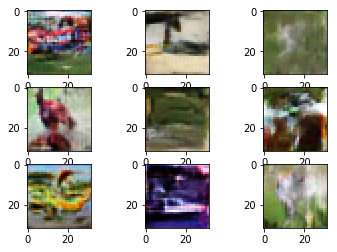

Epoch 1990/1990
64/64 [==============================] - 0s 614us/step - loss: -17.6821 - model_1_loss: -122.6567
Epoch 1990/1990
64/64 [==============================] - 0s 638us/step - loss: -11.4924 - model_1_loss: -147.4347
Epoch 1990/1990
64/64 [==============================] - 0s 621us/step - loss: -24.0250 - model_1_loss: -157.7341
Epoch 1990/1990
64/64 [==============================] - 0s 623us/step - loss: -21.1107 - model_1_loss: -146.7146
Epoch 1990/1990
64/64 [==============================] - 0s 619us/step - loss: -26.0874 - model_1_loss: -111.1194
Epoch 1990/1990
64/64 [==============================] - 0s 695us/step - loss: 97.6347


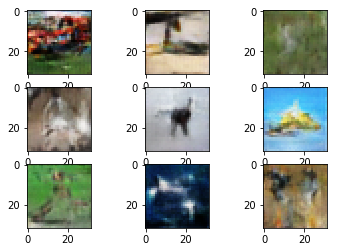

Epoch 2000/2000
64/64 [==============================] - 0s 636us/step - loss: -16.2173 - model_1_loss: -99.2375
Epoch 2000/2000
64/64 [==============================] - 0s 657us/step - loss: -11.2808 - model_1_loss: -89.3196
Epoch 2000/2000
64/64 [==============================] - 0s 663us/step - loss: -22.7220 - model_1_loss: -114.3609
Epoch 2000/2000
64/64 [==============================] - 0s 646us/step - loss: -29.4315 - model_1_loss: -108.6216
Epoch 2000/2000
64/64 [==============================] - 0s 657us/step - loss: -29.2626 - model_1_loss: -101.4573
Epoch 2000/2000
64/64 [==============================] - 0s 744us/step - loss: 109.7377


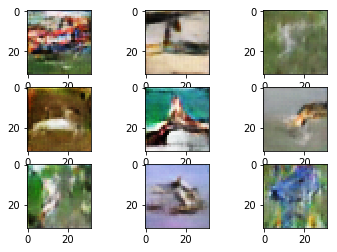

Epoch 2010/2010
64/64 [==============================] - 0s 591us/step - loss: -20.4552 - model_1_loss: -59.8056
Epoch 2010/2010
64/64 [==============================] - 0s 634us/step - loss: -14.4922 - model_1_loss: -40.0573
Epoch 2010/2010
64/64 [==============================] - 0s 645us/step - loss: -29.2074 - model_1_loss: -50.7651
Epoch 2010/2010
64/64 [==============================] - 0s 632us/step - loss: -32.0446 - model_1_loss: -36.9841
Epoch 2010/2010
64/64 [==============================] - 0s 625us/step - loss: -38.9413 - model_1_loss: -37.5706
Epoch 2010/2010
64/64 [==============================] - 0s 723us/step - loss: 25.4682


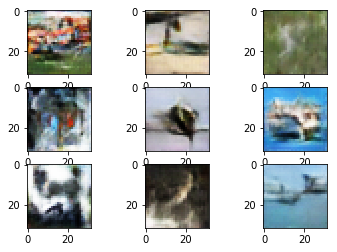

Epoch 2020/2020
64/64 [==============================] - 0s 592us/step - loss: -22.0568 - model_1_loss: -79.2130
Epoch 2020/2020
64/64 [==============================] - 0s 636us/step - loss: -3.1774 - model_1_loss: -67.5508
Epoch 2020/2020
64/64 [==============================] - 0s 648us/step - loss: -25.8091 - model_1_loss: -70.0170
Epoch 2020/2020
64/64 [==============================] - 0s 657us/step - loss: -15.6560 - model_1_loss: -83.7259
Epoch 2020/2020
64/64 [==============================] - 0s 669us/step - loss: -44.1031 - model_1_loss: -104.6818
Epoch 2020/2020
64/64 [==============================] - 0s 736us/step - loss: 103.5362


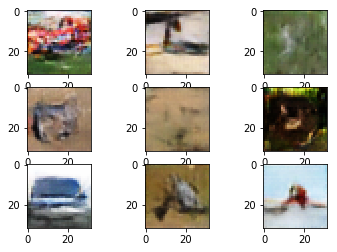

Epoch 2030/2030
64/64 [==============================] - 0s 590us/step - loss: -23.7862 - model_1_loss: -69.2931
Epoch 2030/2030
64/64 [==============================] - 0s 654us/step - loss: -16.1268 - model_1_loss: -71.3553
Epoch 2030/2030
64/64 [==============================] - 0s 646us/step - loss: -30.5697 - model_1_loss: -93.8748
Epoch 2030/2030
64/64 [==============================] - 0s 636us/step - loss: -24.3042 - model_1_loss: -76.8752
Epoch 2030/2030
64/64 [==============================] - 0s 637us/step - loss: -34.5194 - model_1_loss: -111.1292
Epoch 2030/2030
64/64 [==============================] - 0s 726us/step - loss: 77.8069


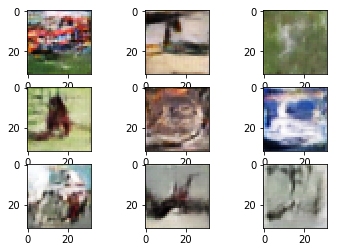

Epoch 2040/2040
64/64 [==============================] - 0s 594us/step - loss: -7.2669 - model_1_loss: -76.8414
Epoch 2040/2040
64/64 [==============================] - 0s 641us/step - loss: -36.6018 - model_1_loss: -92.0680
Epoch 2040/2040
64/64 [==============================] - 0s 631us/step - loss: -19.4077 - model_1_loss: -78.4302
Epoch 2040/2040
64/64 [==============================] - 0s 619us/step - loss: -26.2246 - model_1_loss: -121.4334
Epoch 2040/2040
64/64 [==============================] - 0s 641us/step - loss: -30.0496 - model_1_loss: -115.1084
Epoch 2040/2040
64/64 [==============================] - 0s 700us/step - loss: 85.6210


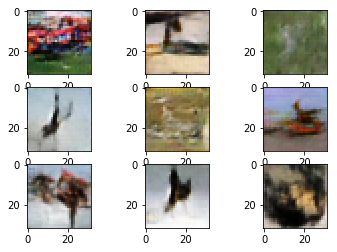

Epoch 2050/2050
64/64 [==============================] - 0s 610us/step - loss: -24.9147 - model_1_loss: -85.0644
Epoch 2050/2050
64/64 [==============================] - 0s 634us/step - loss: -14.2853 - model_1_loss: -76.3010
Epoch 2050/2050
64/64 [==============================] - 0s 650us/step - loss: -20.7217 - model_1_loss: -120.1316
Epoch 2050/2050
64/64 [==============================] - 0s 627us/step - loss: -41.0516 - model_1_loss: -143.9309
Epoch 2050/2050
64/64 [==============================] - 0s 636us/step - loss: -20.0200 - model_1_loss: -135.3281
Epoch 2050/2050
64/64 [==============================] - 0s 718us/step - loss: 149.8003


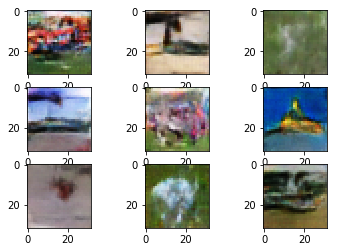

Epoch 2060/2060
64/64 [==============================] - 0s 602us/step - loss: -17.2994 - model_1_loss: -107.7171
Epoch 2060/2060
64/64 [==============================] - 0s 649us/step - loss: -25.2020 - model_1_loss: -77.1012
Epoch 2060/2060
64/64 [==============================] - 0s 636us/step - loss: -15.3902 - model_1_loss: -80.4109
Epoch 2060/2060
64/64 [==============================] - 0s 650us/step - loss: -25.7981 - model_1_loss: -78.7569
Epoch 2060/2060
64/64 [==============================] - 0s 649us/step - loss: -23.3736 - model_1_loss: -91.7960
Epoch 2060/2060
64/64 [==============================] - 0s 723us/step - loss: 88.4730


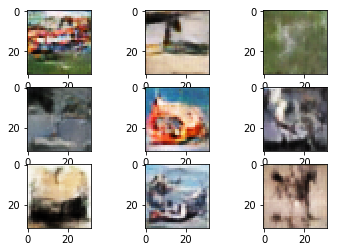

Epoch 2070/2070
64/64 [==============================] - 0s 625us/step - loss: -23.3702 - model_1_loss: -122.1554
Epoch 2070/2070
64/64 [==============================] - 0s 646us/step - loss: -27.7337 - model_1_loss: -117.1034
Epoch 2070/2070
64/64 [==============================] - 0s 650us/step - loss: -17.2870 - model_1_loss: -53.3036
Epoch 2070/2070
64/64 [==============================] - 0s 632us/step - loss: -10.2992 - model_1_loss: -91.4288
Epoch 2070/2070
64/64 [==============================] - 0s 650us/step - loss: -17.4934 - model_1_loss: -121.8395
Epoch 2070/2070
64/64 [==============================] - 0s 729us/step - loss: 97.0530


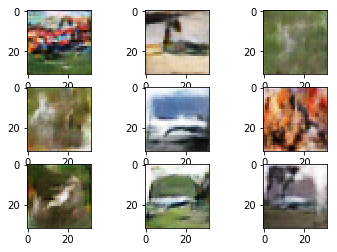

Epoch 2080/2080
64/64 [==============================] - 0s 608us/step - loss: -1.8617 - model_1_loss: -61.1790
Epoch 2080/2080
64/64 [==============================] - 0s 645us/step - loss: -18.6890 - model_1_loss: -48.3917
Epoch 2080/2080
64/64 [==============================] - 0s 637us/step - loss: -24.0473 - model_1_loss: -81.8635
Epoch 2080/2080
64/64 [==============================] - 0s 650us/step - loss: -41.0344 - model_1_loss: -126.2912
Epoch 2080/2080
64/64 [==============================] - 0s 641us/step - loss: -24.4867 - model_1_loss: -139.3611
Epoch 2080/2080
64/64 [==============================] - 0s 731us/step - loss: 149.2165


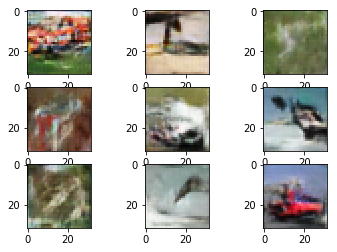

Epoch 2090/2090
64/64 [==============================] - 0s 631us/step - loss: -24.5008 - model_1_loss: -110.9658
Epoch 2090/2090
64/64 [==============================] - 0s 662us/step - loss: -30.8740 - model_1_loss: -145.6413
Epoch 2090/2090
64/64 [==============================] - 0s 622us/step - loss: -18.6149 - model_1_loss: -142.4678
Epoch 2090/2090
64/64 [==============================] - 0s 665us/step - loss: -33.5260 - model_1_loss: -142.7656
Epoch 2090/2090
64/64 [==============================] - 0s 660us/step - loss: -18.1814 - model_1_loss: -147.1419
Epoch 2090/2090
64/64 [==============================] - 0s 727us/step - loss: 154.5238


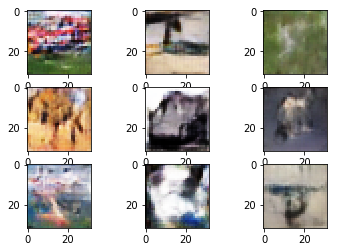

Epoch 2100/2100
64/64 [==============================] - 0s 639us/step - loss: -8.3959 - model_1_loss: -108.0582
Epoch 2100/2100
64/64 [==============================] - 0s 651us/step - loss: -19.5303 - model_1_loss: -100.7009
Epoch 2100/2100
64/64 [==============================] - 0s 638us/step - loss: -17.4434 - model_1_loss: -106.6555
Epoch 2100/2100
64/64 [==============================] - 0s 642us/step - loss: -26.9975 - model_1_loss: -112.4785
Epoch 2100/2100
64/64 [==============================] - 0s 655us/step - loss: -28.0921 - model_1_loss: -110.7417
Epoch 2100/2100
64/64 [==============================] - 0s 728us/step - loss: 119.4648


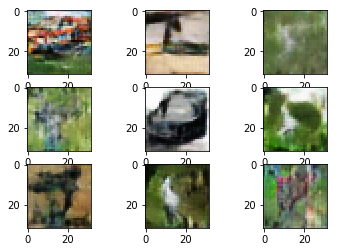

Epoch 2110/2110
64/64 [==============================] - 0s 628us/step - loss: -19.8961 - model_1_loss: -79.5996
Epoch 2110/2110
64/64 [==============================] - 0s 647us/step - loss: -24.8745 - model_1_loss: -106.1997
Epoch 2110/2110
64/64 [==============================] - 0s 656us/step - loss: -28.3767 - model_1_loss: -105.8981
Epoch 2110/2110
64/64 [==============================] - 0s 659us/step - loss: -31.8992 - model_1_loss: -112.0459
Epoch 2110/2110
64/64 [==============================] - 0s 646us/step - loss: -26.8790 - model_1_loss: -125.9611
Epoch 2110/2110
64/64 [==============================] - 0s 717us/step - loss: 133.8509


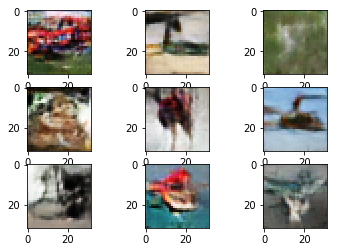

Epoch 2120/2120
64/64 [==============================] - 0s 633us/step - loss: -7.6369 - model_1_loss: -54.7056
Epoch 2120/2120
64/64 [==============================] - 0s 647us/step - loss: -13.9375 - model_1_loss: -57.5641
Epoch 2120/2120
64/64 [==============================] - 0s 658us/step - loss: -24.6267 - model_1_loss: -75.4547
Epoch 2120/2120
64/64 [==============================] - 0s 653us/step - loss: -25.1452 - model_1_loss: -74.4118
Epoch 2120/2120
64/64 [==============================] - 0s 630us/step - loss: -32.0944 - model_1_loss: -91.2008
Epoch 2120/2120
64/64 [==============================] - 0s 721us/step - loss: 85.1284


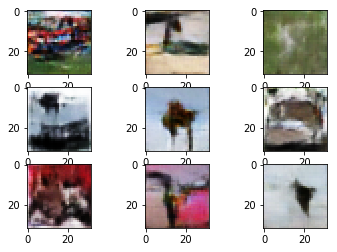

Epoch 2130/2130
64/64 [==============================] - 0s 608us/step - loss: -23.7650 - model_1_loss: -70.3555
Epoch 2130/2130
64/64 [==============================] - 0s 629us/step - loss: -19.4613 - model_1_loss: -76.7610
Epoch 2130/2130
64/64 [==============================] - 0s 641us/step - loss: -35.6911 - model_1_loss: -66.5844
Epoch 2130/2130
64/64 [==============================] - 0s 633us/step - loss: -20.7906 - model_1_loss: -26.3014
Epoch 2130/2130
64/64 [==============================] - 0s 649us/step - loss: -27.2067 - model_1_loss: -32.6622
Epoch 2130/2130
64/64 [==============================] - 0s 721us/step - loss: 12.8902


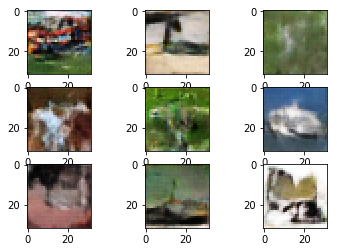

Epoch 2140/2140
64/64 [==============================] - 0s 621us/step - loss: -28.2251 - model_1_loss: -57.8674
Epoch 2140/2140
64/64 [==============================] - 0s 642us/step - loss: -17.5084 - model_1_loss: -53.3689
Epoch 2140/2140
64/64 [==============================] - 0s 639us/step - loss: -27.9393 - model_1_loss: -97.8169
Epoch 2140/2140
64/64 [==============================] - 0s 654us/step - loss: -17.3385 - model_1_loss: -89.6494
Epoch 2140/2140
64/64 [==============================] - 0s 639us/step - loss: -24.2573 - model_1_loss: -96.0915
Epoch 2140/2140
64/64 [==============================] - 0s 726us/step - loss: 120.8362


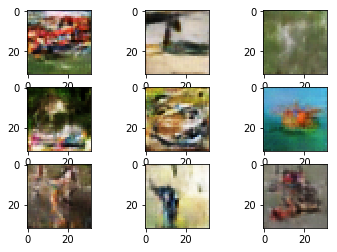

Epoch 2150/2150
64/64 [==============================] - 0s 626us/step - loss: -10.1589 - model_1_loss: -94.1865
Epoch 2150/2150
64/64 [==============================] - 0s 645us/step - loss: -13.8287 - model_1_loss: -85.7579
Epoch 2150/2150
64/64 [==============================] - 0s 639us/step - loss: -7.6856 - model_1_loss: -92.5454
Epoch 2150/2150
64/64 [==============================] - 0s 644us/step - loss: -27.0930 - model_1_loss: -117.0871
Epoch 2150/2150
64/64 [==============================] - 0s 647us/step - loss: -41.7780 - model_1_loss: -107.3426
Epoch 2150/2150
64/64 [==============================] - 0s 727us/step - loss: 104.3131


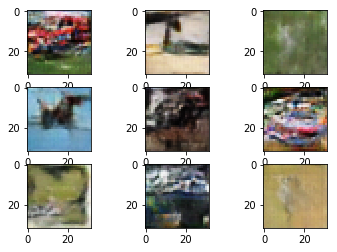

Epoch 2160/2160
64/64 [==============================] - 0s 634us/step - loss: -17.5738 - model_1_loss: -90.1912
Epoch 2160/2160
64/64 [==============================] - 0s 645us/step - loss: -20.7741 - model_1_loss: -95.6242
Epoch 2160/2160
64/64 [==============================] - 0s 640us/step - loss: -34.0630 - model_1_loss: -119.8456
Epoch 2160/2160
64/64 [==============================] - 0s 630us/step - loss: -16.3038 - model_1_loss: -112.5536
Epoch 2160/2160
64/64 [==============================] - 0s 645us/step - loss: -28.9296 - model_1_loss: -140.6317
Epoch 2160/2160
64/64 [==============================] - 0s 731us/step - loss: 123.9752


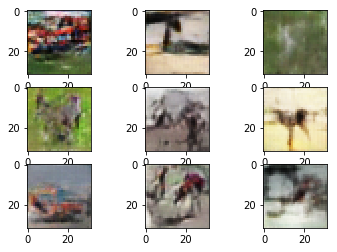

Epoch 2170/2170
64/64 [==============================] - 0s 613us/step - loss: -15.3736 - model_1_loss: -110.1327
Epoch 2170/2170
64/64 [==============================] - 0s 646us/step - loss: -25.4962 - model_1_loss: -107.2832
Epoch 2170/2170
64/64 [==============================] - 0s 637us/step - loss: -15.1644 - model_1_loss: -113.5637
Epoch 2170/2170
64/64 [==============================] - 0s 654us/step - loss: -26.1632 - model_1_loss: -113.4201
Epoch 2170/2170
64/64 [==============================] - 0s 652us/step - loss: -13.4931 - model_1_loss: -111.8680
Epoch 2170/2170
64/64 [==============================] - 0s 723us/step - loss: 108.6878


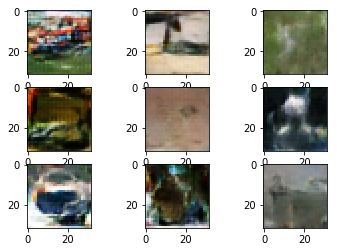

Epoch 2180/2180
64/64 [==============================] - 0s 620us/step - loss: -22.7299 - model_1_loss: -101.5343
Epoch 2180/2180
64/64 [==============================] - 0s 642us/step - loss: -18.0761 - model_1_loss: -111.8295
Epoch 2180/2180
64/64 [==============================] - 0s 641us/step - loss: -31.2139 - model_1_loss: -124.0214
Epoch 2180/2180
64/64 [==============================] - 0s 626us/step - loss: -34.1092 - model_1_loss: -105.7769
Epoch 2180/2180
64/64 [==============================] - 0s 640us/step - loss: -32.6208 - model_1_loss: -100.7395
Epoch 2180/2180
64/64 [==============================] - 0s 725us/step - loss: 102.4419


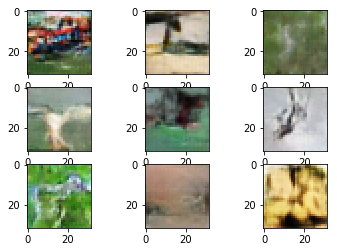

Epoch 2190/2190
64/64 [==============================] - 0s 692us/step - loss: -15.7538 - model_1_loss: -108.1012
Epoch 2190/2190
64/64 [==============================] - 0s 683us/step - loss: -21.7070 - model_1_loss: -92.8575
Epoch 2190/2190
64/64 [==============================] - 0s 646us/step - loss: -29.0272 - model_1_loss: -89.6141
Epoch 2190/2190
64/64 [==============================] - 0s 648us/step - loss: -29.2077 - model_1_loss: -81.0232
Epoch 2190/2190
64/64 [==============================] - 0s 644us/step - loss: -15.4458 - model_1_loss: -88.6342
Epoch 2190/2190
64/64 [==============================] - 0s 765us/step - loss: 99.4022


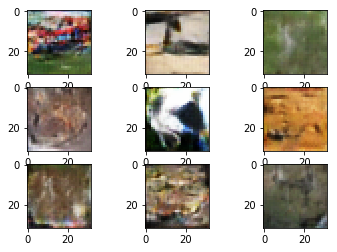

Epoch 2200/2200
64/64 [==============================] - 0s 621us/step - loss: -11.0647 - model_1_loss: -19.7562
Epoch 2200/2200
64/64 [==============================] - 0s 643us/step - loss: -20.1952 - model_1_loss: -47.1338
Epoch 2200/2200
64/64 [==============================] - 0s 639us/step - loss: -18.9922 - model_1_loss: -34.2556
Epoch 2200/2200
64/64 [==============================] - 0s 646us/step - loss: -19.2253 - model_1_loss: -26.8855
Epoch 2200/2200
64/64 [==============================] - 0s 635us/step - loss: -3.4168 - model_1_loss: -29.1500
Epoch 2200/2200
64/64 [==============================] - 0s 724us/step - loss: 38.0031


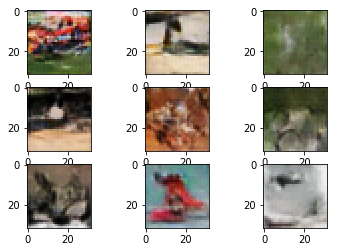

Epoch 2210/2210
64/64 [==============================] - 0s 622us/step - loss: -17.8164 - model_1_loss: -63.4130
Epoch 2210/2210
64/64 [==============================] - 0s 630us/step - loss: -19.9036 - model_1_loss: -69.7395
Epoch 2210/2210
64/64 [==============================] - 0s 647us/step - loss: -29.0791 - model_1_loss: -109.1184
Epoch 2210/2210
64/64 [==============================] - 0s 648us/step - loss: -17.4764 - model_1_loss: -116.6590
Epoch 2210/2210
64/64 [==============================] - 0s 639us/step - loss: -28.5474 - model_1_loss: -119.1270
Epoch 2210/2210
64/64 [==============================] - 0s 730us/step - loss: 123.0052


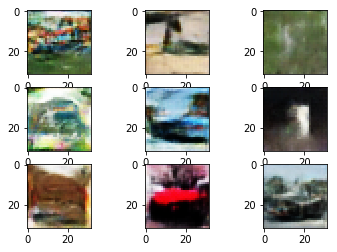

Epoch 2220/2220
64/64 [==============================] - 0s 621us/step - loss: -12.4184 - model_1_loss: -41.7899
Epoch 2220/2220
64/64 [==============================] - 0s 650us/step - loss: -38.9955 - model_1_loss: -64.1904
Epoch 2220/2220
64/64 [==============================] - 0s 645us/step - loss: -31.8937 - model_1_loss: -61.7464
Epoch 2220/2220
64/64 [==============================] - 0s 645us/step - loss: -41.1289 - model_1_loss: -55.8123
Epoch 2220/2220
64/64 [==============================] - 0s 642us/step - loss: -38.8365 - model_1_loss: -36.4946
Epoch 2220/2220
64/64 [==============================] - 0s 731us/step - loss: 36.4788


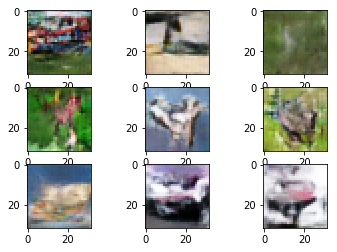

Epoch 2230/2230
64/64 [==============================] - 0s 614us/step - loss: -16.0422 - model_1_loss: -98.8134
Epoch 2230/2230
64/64 [==============================] - 0s 643us/step - loss: -20.9762 - model_1_loss: -103.8423
Epoch 2230/2230
64/64 [==============================] - 0s 644us/step - loss: -33.5130 - model_1_loss: -95.0372
Epoch 2230/2230
64/64 [==============================] - 0s 641us/step - loss: -26.0056 - model_1_loss: -90.8366
Epoch 2230/2230
64/64 [==============================] - 0s 635us/step - loss: -36.8642 - model_1_loss: -79.6862
Epoch 2230/2230
64/64 [==============================] - 0s 727us/step - loss: 70.8135


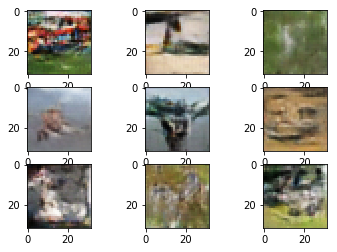

Epoch 2240/2240
64/64 [==============================] - 0s 624us/step - loss: -14.6651 - model_1_loss: -128.7440
Epoch 2240/2240
64/64 [==============================] - 0s 644us/step - loss: -26.9572 - model_1_loss: -143.5142
Epoch 2240/2240
64/64 [==============================] - 0s 655us/step - loss: -26.8212 - model_1_loss: -134.3005
Epoch 2240/2240
64/64 [==============================] - 0s 642us/step - loss: -16.8233 - model_1_loss: -77.2663
Epoch 2240/2240
64/64 [==============================] - 0s 655us/step - loss: -31.2553 - model_1_loss: -71.4395
Epoch 2240/2240
64/64 [==============================] - 0s 739us/step - loss: 62.6295


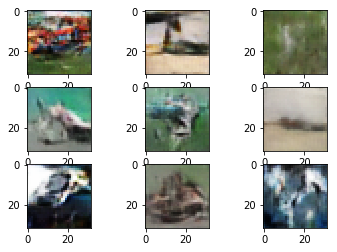

Epoch 2250/2250
64/64 [==============================] - 0s 627us/step - loss: -20.5205 - model_1_loss: -118.1181
Epoch 2250/2250
64/64 [==============================] - 0s 648us/step - loss: -24.0085 - model_1_loss: -115.8334
Epoch 2250/2250
64/64 [==============================] - 0s 646us/step - loss: -23.0219 - model_1_loss: -96.1924
Epoch 2250/2250
64/64 [==============================] - 0s 644us/step - loss: -28.4127 - model_1_loss: -90.6606
Epoch 2250/2250
64/64 [==============================] - 0s 651us/step - loss: -17.2666 - model_1_loss: -104.3201
Epoch 2250/2250
64/64 [==============================] - 0s 730us/step - loss: 104.6039


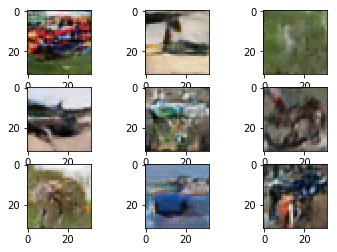

Epoch 2260/2260
64/64 [==============================] - 0s 620us/step - loss: -22.1287 - model_1_loss: -116.3782
Epoch 2260/2260
64/64 [==============================] - 0s 660us/step - loss: -16.1174 - model_1_loss: -139.6866
Epoch 2260/2260
64/64 [==============================] - 0s 647us/step - loss: -15.8431 - model_1_loss: -136.9307
Epoch 2260/2260
64/64 [==============================] - 0s 644us/step - loss: -20.6164 - model_1_loss: -99.8793
Epoch 2260/2260
64/64 [==============================] - 0s 646us/step - loss: -2.8246 - model_1_loss: -62.3339
Epoch 2260/2260
64/64 [==============================] - 0s 740us/step - loss: 89.2111


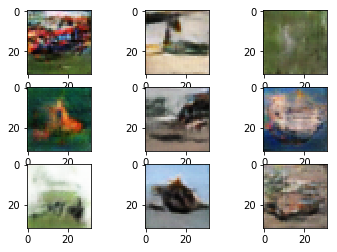

Epoch 2270/2270
64/64 [==============================] - 0s 622us/step - loss: -6.1844 - model_1_loss: -37.9452
Epoch 2270/2270
64/64 [==============================] - 0s 654us/step - loss: -11.5642 - model_1_loss: -44.5424
Epoch 2270/2270
64/64 [==============================] - 0s 651us/step - loss: -22.0012 - model_1_loss: -34.6227
Epoch 2270/2270
64/64 [==============================] - 0s 652us/step - loss: -34.6067 - model_1_loss: -61.2891
Epoch 2270/2270
64/64 [==============================] - 0s 639us/step - loss: -32.5118 - model_1_loss: -62.2785
Epoch 2270/2270
64/64 [==============================] - 0s 731us/step - loss: 55.1852


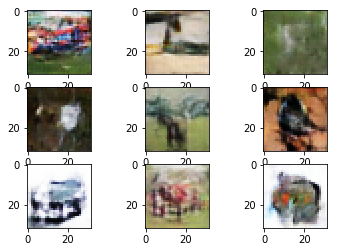

Epoch 2280/2280
64/64 [==============================] - 0s 647us/step - loss: -11.0993 - model_1_loss: -110.3998
Epoch 2280/2280
64/64 [==============================] - 0s 661us/step - loss: -8.6196 - model_1_loss: -109.3994
Epoch 2280/2280
64/64 [==============================] - 0s 648us/step - loss: -8.7824 - model_1_loss: -118.5270
Epoch 2280/2280
64/64 [==============================] - 0s 662us/step - loss: -22.8318 - model_1_loss: -126.4771
Epoch 2280/2280
64/64 [==============================] - 0s 648us/step - loss: -24.9013 - model_1_loss: -102.2951
Epoch 2280/2280
64/64 [==============================] - 0s 727us/step - loss: 47.0071


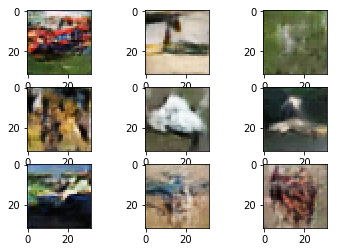

Epoch 2290/2290
64/64 [==============================] - 0s 644us/step - loss: -12.0559 - model_1_loss: -56.2125
Epoch 2290/2290
64/64 [==============================] - 0s 655us/step - loss: -11.7173 - model_1_loss: -49.1284
Epoch 2290/2290
64/64 [==============================] - 0s 656us/step - loss: -17.6200 - model_1_loss: -47.3358
Epoch 2290/2290
64/64 [==============================] - 0s 652us/step - loss: -24.5860 - model_1_loss: -54.6377
Epoch 2290/2290
64/64 [==============================] - 0s 661us/step - loss: -21.6412 - model_1_loss: -33.4784
Epoch 2290/2290
64/64 [==============================] - 0s 750us/step - loss: 49.7753


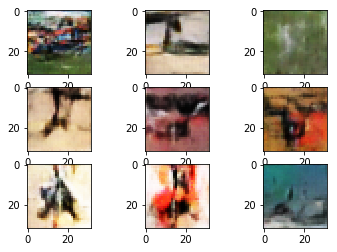

Epoch 2300/2300
64/64 [==============================] - 0s 638us/step - loss: -16.4848 - model_1_loss: -74.8709
Epoch 2300/2300
64/64 [==============================] - 0s 664us/step - loss: -8.5285 - model_1_loss: -69.9721
Epoch 2300/2300
64/64 [==============================] - 0s 659us/step - loss: -17.4145 - model_1_loss: -92.6449
Epoch 2300/2300
64/64 [==============================] - 0s 646us/step - loss: -35.5397 - model_1_loss: -106.4576
Epoch 2300/2300
64/64 [==============================] - 0s 656us/step - loss: -23.4095 - model_1_loss: -83.3135
Epoch 2300/2300
64/64 [==============================] - 0s 731us/step - loss: 69.9995


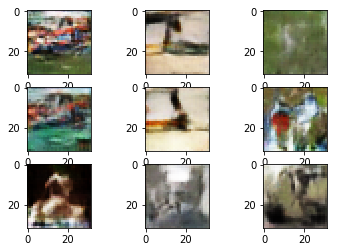

Epoch 2310/2310
64/64 [==============================] - 0s 628us/step - loss: -20.9756 - model_1_loss: -108.4774
Epoch 2310/2310
64/64 [==============================] - 0s 643us/step - loss: -24.2923 - model_1_loss: -120.6122
Epoch 2310/2310
64/64 [==============================] - 0s 636us/step - loss: -16.6096 - model_1_loss: -120.5815
Epoch 2310/2310
64/64 [==============================] - 0s 639us/step - loss: -17.3503 - model_1_loss: -135.4535
Epoch 2310/2310
64/64 [==============================] - 0s 648us/step - loss: -22.2376 - model_1_loss: -87.6308
Epoch 2310/2310
64/64 [==============================] - 0s 723us/step - loss: 82.2889


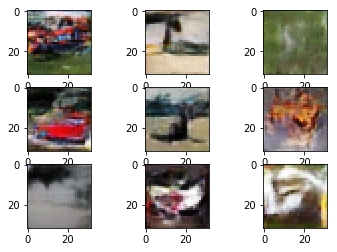

Epoch 2320/2320
64/64 [==============================] - 0s 619us/step - loss: -8.7286 - model_1_loss: -45.2372
Epoch 2320/2320
64/64 [==============================] - 0s 621us/step - loss: -20.5312 - model_1_loss: -73.7449
Epoch 2320/2320
64/64 [==============================] - 0s 649us/step - loss: -15.9392 - model_1_loss: -72.3969
Epoch 2320/2320
64/64 [==============================] - 0s 642us/step - loss: -20.0318 - model_1_loss: -90.3530
Epoch 2320/2320
64/64 [==============================] - 0s 655us/step - loss: -31.5143 - model_1_loss: -113.8580
Epoch 2320/2320
64/64 [==============================] - 0s 733us/step - loss: 108.5772


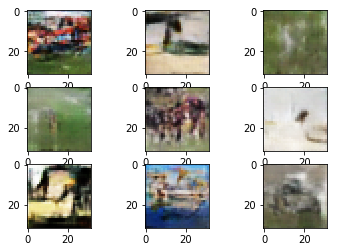

Epoch 2330/2330
64/64 [==============================] - 0s 608us/step - loss: 2.4884 - model_1_loss: -122.1205
Epoch 2330/2330
64/64 [==============================] - 0s 621us/step - loss: -7.1325 - model_1_loss: -99.4072
Epoch 2330/2330
64/64 [==============================] - 0s 638us/step - loss: -32.4976 - model_1_loss: -113.8264
Epoch 2330/2330
64/64 [==============================] - 0s 652us/step - loss: -23.7097 - model_1_loss: -107.6106
Epoch 2330/2330
64/64 [==============================] - 0s 637us/step - loss: -20.0688 - model_1_loss: -129.1642
Epoch 2330/2330
64/64 [==============================] - 0s 736us/step - loss: 114.8370


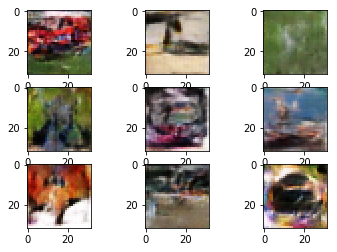

Epoch 2340/2340
64/64 [==============================] - 0s 626us/step - loss: -16.1577 - model_1_loss: -80.0411
Epoch 2340/2340
64/64 [==============================] - 0s 664us/step - loss: -23.9033 - model_1_loss: -76.2185
Epoch 2340/2340
64/64 [==============================] - 0s 659us/step - loss: -38.0603 - model_1_loss: -106.2271
Epoch 2340/2340
64/64 [==============================] - 0s 639us/step - loss: -16.3220 - model_1_loss: -100.6963
Epoch 2340/2340
64/64 [==============================] - 0s 652us/step - loss: -26.0360 - model_1_loss: -97.4723
Epoch 2340/2340
64/64 [==============================] - 0s 727us/step - loss: 79.4172


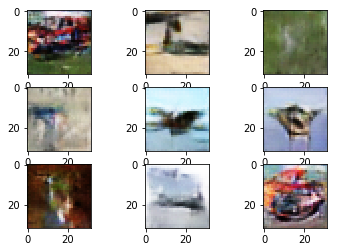

Epoch 2350/2350
64/64 [==============================] - 0s 624us/step - loss: -2.2175 - model_1_loss: -65.8569
Epoch 2350/2350
64/64 [==============================] - 0s 657us/step - loss: -15.5308 - model_1_loss: -65.9718
Epoch 2350/2350
64/64 [==============================] - 0s 656us/step - loss: -8.2898 - model_1_loss: -94.9965
Epoch 2350/2350
64/64 [==============================] - 0s 652us/step - loss: -37.1060 - model_1_loss: -145.0721
Epoch 2350/2350
64/64 [==============================] - 0s 649us/step - loss: -20.0582 - model_1_loss: -128.1914
Epoch 2350/2350
64/64 [==============================] - 0s 734us/step - loss: 99.9024


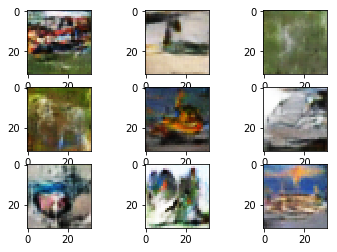

Epoch 2360/2360
64/64 [==============================] - 0s 630us/step - loss: -17.1827 - model_1_loss: -83.5840
Epoch 2360/2360
64/64 [==============================] - 0s 663us/step - loss: -26.7100 - model_1_loss: -91.0534
Epoch 2360/2360
64/64 [==============================] - 0s 650us/step - loss: -17.6534 - model_1_loss: -89.4174
Epoch 2360/2360
64/64 [==============================] - 0s 667us/step - loss: -32.8159 - model_1_loss: -122.7586
Epoch 2360/2360
64/64 [==============================] - 0s 646us/step - loss: -23.6360 - model_1_loss: -121.8840
Epoch 2360/2360
64/64 [==============================] - 0s 727us/step - loss: 75.4277


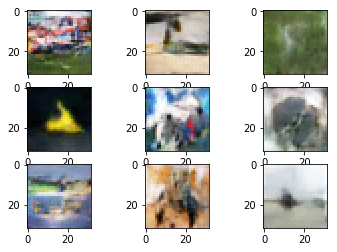

Epoch 2370/2370
64/64 [==============================] - 0s 632us/step - loss: -14.4435 - model_1_loss: -137.4148
Epoch 2370/2370
64/64 [==============================] - 0s 639us/step - loss: -9.4120 - model_1_loss: -106.1555
Epoch 2370/2370
64/64 [==============================] - 0s 665us/step - loss: -36.0276 - model_1_loss: -121.9392
Epoch 2370/2370
64/64 [==============================] - 0s 659us/step - loss: -23.5960 - model_1_loss: -82.4305
Epoch 2370/2370
64/64 [==============================] - 0s 645us/step - loss: -25.4526 - model_1_loss: -72.5158
Epoch 2370/2370
64/64 [==============================] - 0s 733us/step - loss: 70.8231


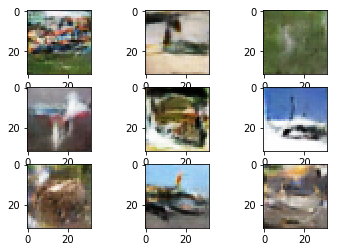

Epoch 2380/2380
64/64 [==============================] - 0s 629us/step - loss: -21.0445 - model_1_loss: -104.9131
Epoch 2380/2380
64/64 [==============================] - 0s 662us/step - loss: -19.6628 - model_1_loss: -107.5364
Epoch 2380/2380
64/64 [==============================] - 0s 664us/step - loss: -20.9741 - model_1_loss: -113.4899
Epoch 2380/2380
64/64 [==============================] - 0s 644us/step - loss: -29.9726 - model_1_loss: -94.5180
Epoch 2380/2380
64/64 [==============================] - 0s 652us/step - loss: -27.6349 - model_1_loss: -101.8353
Epoch 2380/2380
64/64 [==============================] - 0s 737us/step - loss: 96.5751


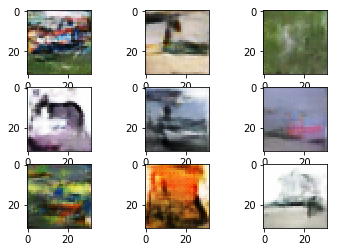

Epoch 2390/2390
64/64 [==============================] - 0s 626us/step - loss: -5.1724 - model_1_loss: -74.7229
Epoch 2390/2390
64/64 [==============================] - 0s 640us/step - loss: -26.4704 - model_1_loss: -105.2174
Epoch 2390/2390
64/64 [==============================] - 0s 644us/step - loss: -29.4441 - model_1_loss: -101.9924
Epoch 2390/2390
64/64 [==============================] - 0s 647us/step - loss: -15.6222 - model_1_loss: -86.0153
Epoch 2390/2390
64/64 [==============================] - 0s 665us/step - loss: -27.4321 - model_1_loss: -102.4458
Epoch 2390/2390
64/64 [==============================] - 0s 736us/step - loss: 87.6780


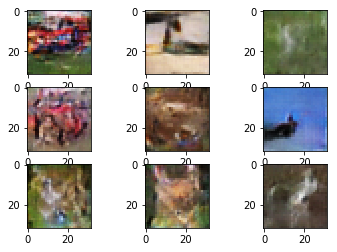

Epoch 2400/2400
64/64 [==============================] - 0s 627us/step - loss: -24.7434 - model_1_loss: -106.4797
Epoch 2400/2400
64/64 [==============================] - 0s 653us/step - loss: -13.1076 - model_1_loss: -101.6388
Epoch 2400/2400
64/64 [==============================] - 0s 653us/step - loss: -24.9448 - model_1_loss: -78.1803
Epoch 2400/2400
64/64 [==============================] - 0s 655us/step - loss: -27.1145 - model_1_loss: -83.4134
Epoch 2400/2400
64/64 [==============================] - 0s 647us/step - loss: -28.1481 - model_1_loss: -50.5829
Epoch 2400/2400
64/64 [==============================] - 0s 739us/step - loss: 57.3234


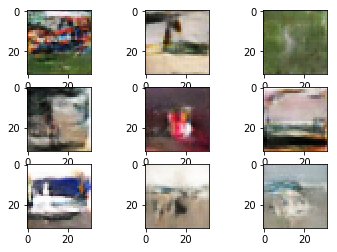

Epoch 2410/2410
64/64 [==============================] - 0s 631us/step - loss: -7.9018 - model_1_loss: -72.5113
Epoch 2410/2410
64/64 [==============================] - 0s 645us/step - loss: -24.3932 - model_1_loss: -105.1135
Epoch 2410/2410
64/64 [==============================] - 0s 646us/step - loss: -12.2605 - model_1_loss: -92.6323
Epoch 2410/2410
64/64 [==============================] - 0s 656us/step - loss: -42.4898 - model_1_loss: -90.0102
Epoch 2410/2410
64/64 [==============================] - 0s 664us/step - loss: -26.9575 - model_1_loss: -80.9086
Epoch 2410/2410
64/64 [==============================] - 0s 812us/step - loss: 57.2644


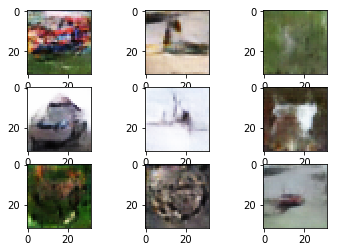

Epoch 2420/2420
64/64 [==============================] - 0s 634us/step - loss: -19.4498 - model_1_loss: -78.2103
Epoch 2420/2420
64/64 [==============================] - 0s 639us/step - loss: -22.0907 - model_1_loss: -98.0342
Epoch 2420/2420
64/64 [==============================] - 0s 644us/step - loss: -21.6664 - model_1_loss: -97.4654
Epoch 2420/2420
64/64 [==============================] - 0s 649us/step - loss: -26.5870 - model_1_loss: -68.7430
Epoch 2420/2420
64/64 [==============================] - 0s 647us/step - loss: -26.7839 - model_1_loss: -61.4747
Epoch 2420/2420
64/64 [==============================] - 0s 724us/step - loss: 47.1075


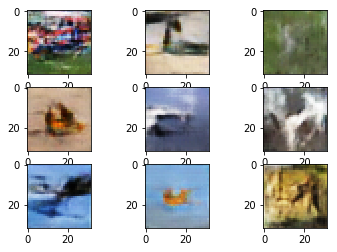

Epoch 2430/2430
64/64 [==============================] - 0s 632us/step - loss: -19.9817 - model_1_loss: -117.0934
Epoch 2430/2430
64/64 [==============================] - 0s 620us/step - loss: -15.5382 - model_1_loss: -126.7530
Epoch 2430/2430
64/64 [==============================] - 0s 640us/step - loss: -20.9467 - model_1_loss: -94.9927
Epoch 2430/2430
64/64 [==============================] - 0s 654us/step - loss: -8.8791 - model_1_loss: -116.6761
Epoch 2430/2430
64/64 [==============================] - 0s 656us/step - loss: -21.5649 - model_1_loss: -123.2201
Epoch 2430/2430
64/64 [==============================] - 0s 716us/step - loss: 54.7936


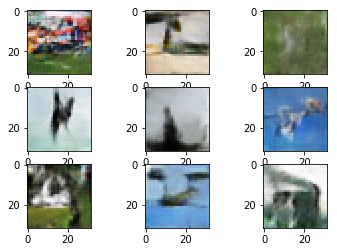

Epoch 2440/2440
64/64 [==============================] - 0s 624us/step - loss: -16.9550 - model_1_loss: -58.5826
Epoch 2440/2440
64/64 [==============================] - 0s 658us/step - loss: -26.6460 - model_1_loss: -77.6430
Epoch 2440/2440
64/64 [==============================] - 0s 641us/step - loss: -25.9876 - model_1_loss: -91.6764
Epoch 2440/2440
64/64 [==============================] - 0s 651us/step - loss: -27.7465 - model_1_loss: -93.1648
Epoch 2440/2440
64/64 [==============================] - 0s 660us/step - loss: -32.3455 - model_1_loss: -92.7284
Epoch 2440/2440
64/64 [==============================] - 0s 726us/step - loss: 92.2064


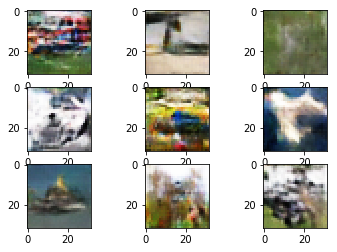

Epoch 2450/2450
64/64 [==============================] - 0s 620us/step - loss: -8.9368 - model_1_loss: -111.3029
Epoch 2450/2450
64/64 [==============================] - 0s 650us/step - loss: -11.0148 - model_1_loss: -120.1497
Epoch 2450/2450
64/64 [==============================] - 0s 651us/step - loss: -17.0154 - model_1_loss: -118.6625
Epoch 2450/2450
64/64 [==============================] - 0s 656us/step - loss: -26.6108 - model_1_loss: -104.9805
Epoch 2450/2450
64/64 [==============================] - 0s 650us/step - loss: -42.6414 - model_1_loss: -122.2822
Epoch 2450/2450
64/64 [==============================] - 0s 715us/step - loss: 111.6571


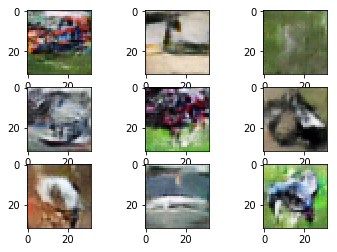

Epoch 2460/2460
64/64 [==============================] - 0s 638us/step - loss: -16.6571 - model_1_loss: -127.3028
Epoch 2460/2460
64/64 [==============================] - 0s 644us/step - loss: -13.9737 - model_1_loss: -120.3533
Epoch 2460/2460
64/64 [==============================] - 0s 659us/step - loss: -27.4389 - model_1_loss: -145.5023
Epoch 2460/2460
64/64 [==============================] - 0s 648us/step - loss: -19.1073 - model_1_loss: -110.4565
Epoch 2460/2460
64/64 [==============================] - 0s 680us/step - loss: -34.1778 - model_1_loss: -122.9337
Epoch 2460/2460
64/64 [==============================] - 0s 733us/step - loss: 103.0766


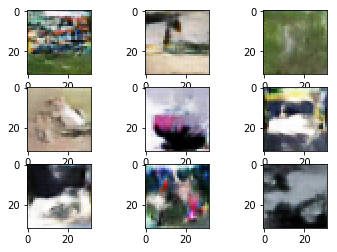

Epoch 2470/2470
64/64 [==============================] - 0s 625us/step - loss: -25.0136 - model_1_loss: -117.4656
Epoch 2470/2470
64/64 [==============================] - 0s 660us/step - loss: -15.6335 - model_1_loss: -92.9643
Epoch 2470/2470
64/64 [==============================] - 0s 653us/step - loss: -29.4950 - model_1_loss: -94.8630
Epoch 2470/2470
64/64 [==============================] - 0s 649us/step - loss: -22.0264 - model_1_loss: -76.2164
Epoch 2470/2470
64/64 [==============================] - 0s 659us/step - loss: -24.2275 - model_1_loss: -52.9335
Epoch 2470/2470
64/64 [==============================] - 0s 742us/step - loss: 48.9286


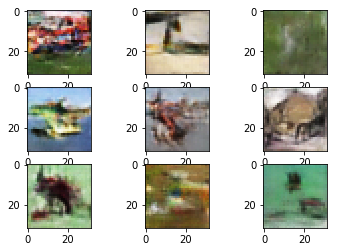

Epoch 2480/2480
64/64 [==============================] - 0s 633us/step - loss: -15.5668 - model_1_loss: -106.8082
Epoch 2480/2480
64/64 [==============================] - 0s 639us/step - loss: -33.7059 - model_1_loss: -105.9996
Epoch 2480/2480
64/64 [==============================] - 0s 648us/step - loss: -15.2803 - model_1_loss: -77.0689
Epoch 2480/2480
64/64 [==============================] - 0s 652us/step - loss: -32.6522 - model_1_loss: -98.8402
Epoch 2480/2480
64/64 [==============================] - 0s 649us/step - loss: -26.0355 - model_1_loss: -62.6071
Epoch 2480/2480
64/64 [==============================] - 0s 736us/step - loss: 55.0527


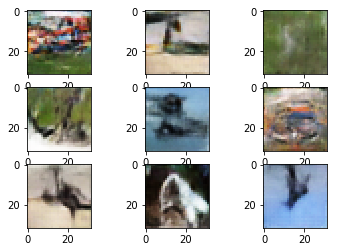

Epoch 2490/2490
64/64 [==============================] - 0s 628us/step - loss: -4.0470 - model_1_loss: -76.9369
Epoch 2490/2490
64/64 [==============================] - 0s 652us/step - loss: -20.1429 - model_1_loss: -88.3460
Epoch 2490/2490
64/64 [==============================] - 0s 658us/step - loss: -19.6088 - model_1_loss: -103.0709
Epoch 2490/2490
64/64 [==============================] - 0s 648us/step - loss: -21.2802 - model_1_loss: -82.2852
Epoch 2490/2490
64/64 [==============================] - 0s 646us/step - loss: -18.1045 - model_1_loss: -105.8550
Epoch 2490/2490
64/64 [==============================] - 0s 741us/step - loss: 118.3009


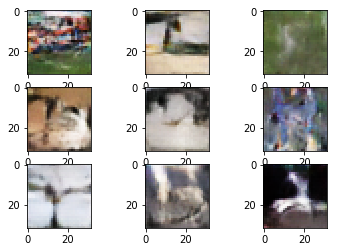

Epoch 2500/2500
64/64 [==============================] - 0s 631us/step - loss: -28.0758 - model_1_loss: -54.0865
Epoch 2500/2500
64/64 [==============================] - 0s 650us/step - loss: -23.8942 - model_1_loss: -62.1498
Epoch 2500/2500
64/64 [==============================] - 0s 655us/step - loss: -16.4069 - model_1_loss: -61.5759
Epoch 2500/2500
64/64 [==============================] - 0s 654us/step - loss: -19.6967 - model_1_loss: -46.9723
Epoch 2500/2500
64/64 [==============================] - 0s 642us/step - loss: -19.2728 - model_1_loss: -49.1217
Epoch 2500/2500
64/64 [==============================] - 0s 735us/step - loss: 43.0019


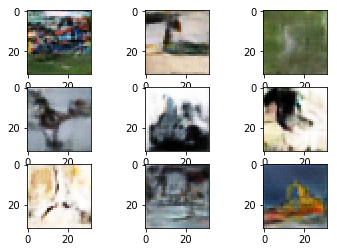

Epoch 2510/2510
64/64 [==============================] - 0s 628us/step - loss: -19.8668 - model_1_loss: -106.8298
Epoch 2510/2510
64/64 [==============================] - 0s 661us/step - loss: -20.8557 - model_1_loss: -128.5866
Epoch 2510/2510
64/64 [==============================] - 0s 642us/step - loss: -31.8850 - model_1_loss: -165.1342
Epoch 2510/2510
64/64 [==============================] - 0s 647us/step - loss: -19.9026 - model_1_loss: -151.9262
Epoch 2510/2510
64/64 [==============================] - 0s 636us/step - loss: -34.7070 - model_1_loss: -145.3226
Epoch 2510/2510
64/64 [==============================] - 0s 741us/step - loss: 148.9790


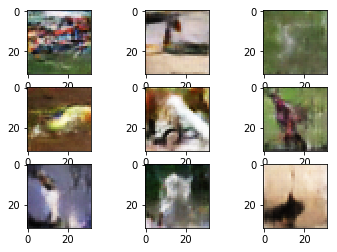

Epoch 2520/2520
64/64 [==============================] - 0s 630us/step - loss: -4.4299 - model_1_loss: -95.9783
Epoch 2520/2520
64/64 [==============================] - 0s 658us/step - loss: -38.1000 - model_1_loss: -99.6559
Epoch 2520/2520
64/64 [==============================] - 0s 650us/step - loss: -21.1920 - model_1_loss: -104.1854
Epoch 2520/2520
64/64 [==============================] - 0s 647us/step - loss: -28.7059 - model_1_loss: -111.2568
Epoch 2520/2520
64/64 [==============================] - 0s 639us/step - loss: -30.6615 - model_1_loss: -149.3743
Epoch 2520/2520
64/64 [==============================] - 0s 725us/step - loss: 109.1284


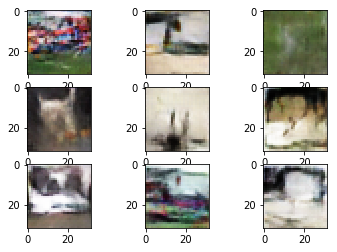

Epoch 2530/2530
64/64 [==============================] - 0s 640us/step - loss: -18.7843 - model_1_loss: -119.0720
Epoch 2530/2530
64/64 [==============================] - 0s 652us/step - loss: -21.0794 - model_1_loss: -115.9612
Epoch 2530/2530
64/64 [==============================] - 0s 647us/step - loss: -19.8832 - model_1_loss: -135.8259
Epoch 2530/2530
64/64 [==============================] - 0s 643us/step - loss: -27.6166 - model_1_loss: -121.0598
Epoch 2530/2530
64/64 [==============================] - 0s 642us/step - loss: -21.5452 - model_1_loss: -85.3505
Epoch 2530/2530
64/64 [==============================] - 0s 742us/step - loss: 101.8290


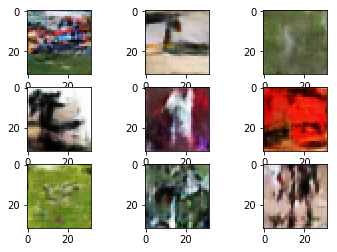

Epoch 2540/2540
64/64 [==============================] - 0s 631us/step - loss: -3.1927 - model_1_loss: -154.9798
Epoch 2540/2540
64/64 [==============================] - 0s 635us/step - loss: -28.6916 - model_1_loss: -179.4120
Epoch 2540/2540
64/64 [==============================] - 0s 651us/step - loss: -24.4720 - model_1_loss: -190.4710
Epoch 2540/2540
64/64 [==============================] - 0s 640us/step - loss: -24.7295 - model_1_loss: -180.4981
Epoch 2540/2540
64/64 [==============================] - 0s 659us/step - loss: -27.8978 - model_1_loss: -165.9128
Epoch 2540/2540
64/64 [==============================] - 0s 726us/step - loss: 155.8156


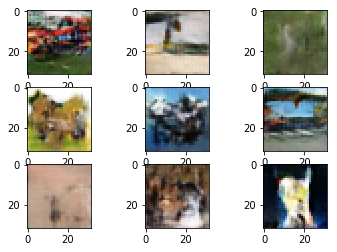

Epoch 2550/2550
64/64 [==============================] - 0s 619us/step - loss: -22.1431 - model_1_loss: -155.0928
Epoch 2550/2550
64/64 [==============================] - 0s 637us/step - loss: -16.1919 - model_1_loss: -134.3983
Epoch 2550/2550
64/64 [==============================] - 0s 642us/step - loss: -9.6830 - model_1_loss: -122.4810
Epoch 2550/2550
64/64 [==============================] - 0s 634us/step - loss: -36.4659 - model_1_loss: -118.5043
Epoch 2550/2550
64/64 [==============================] - 0s 632us/step - loss: -40.8923 - model_1_loss: -109.5924
Epoch 2550/2550
64/64 [==============================] - 0s 734us/step - loss: 116.3246


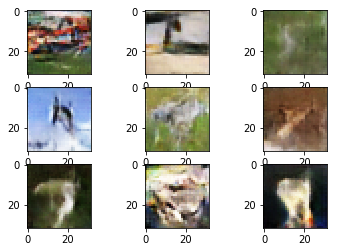

Epoch 2560/2560
64/64 [==============================] - 0s 668us/step - loss: -16.7841 - model_1_loss: -75.5647
Epoch 2560/2560
64/64 [==============================] - 0s 648us/step - loss: -32.9524 - model_1_loss: -91.1310
Epoch 2560/2560
64/64 [==============================] - 0s 640us/step - loss: -16.5540 - model_1_loss: -74.7508
Epoch 2560/2560
64/64 [==============================] - 0s 645us/step - loss: -35.2409 - model_1_loss: -86.5409
Epoch 2560/2560
64/64 [==============================] - 0s 656us/step - loss: -24.5286 - model_1_loss: -81.5739
Epoch 2560/2560
64/64 [==============================] - 0s 735us/step - loss: 96.3062


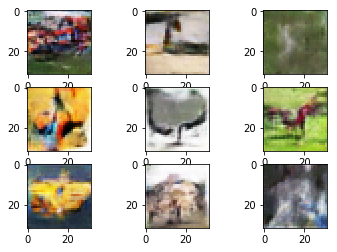

Epoch 2570/2570
64/64 [==============================] - 0s 629us/step - loss: -14.8697 - model_1_loss: -88.7066
Epoch 2570/2570
64/64 [==============================] - 0s 668us/step - loss: -10.5938 - model_1_loss: -101.0985
Epoch 2570/2570
64/64 [==============================] - 0s 647us/step - loss: -30.8415 - model_1_loss: -118.3600
Epoch 2570/2570
64/64 [==============================] - 0s 647us/step - loss: -32.2257 - model_1_loss: -86.1995
Epoch 2570/2570
64/64 [==============================] - 0s 641us/step - loss: -15.9650 - model_1_loss: -100.2847
Epoch 2570/2570
64/64 [==============================] - 0s 726us/step - loss: 86.4665


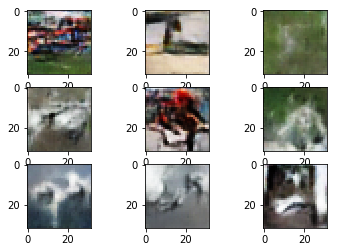

Epoch 2580/2580
64/64 [==============================] - 0s 630us/step - loss: -12.9225 - model_1_loss: -89.1318
Epoch 2580/2580
64/64 [==============================] - 0s 663us/step - loss: -16.2013 - model_1_loss: -86.6918
Epoch 2580/2580
64/64 [==============================] - 0s 649us/step - loss: -27.7180 - model_1_loss: -90.5243
Epoch 2580/2580
64/64 [==============================] - 0s 659us/step - loss: -29.5458 - model_1_loss: -89.6259
Epoch 2580/2580
64/64 [==============================] - 0s 660us/step - loss: -21.5482 - model_1_loss: -69.9081
Epoch 2580/2580
64/64 [==============================] - 0s 731us/step - loss: 55.6651


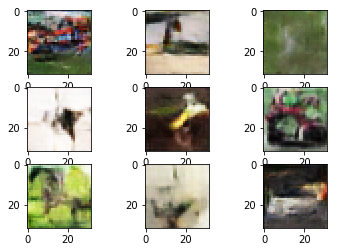

Epoch 2590/2590
64/64 [==============================] - 0s 625us/step - loss: -13.2030 - model_1_loss: -93.9138
Epoch 2590/2590
64/64 [==============================] - 0s 640us/step - loss: -23.2136 - model_1_loss: -82.7599
Epoch 2590/2590
64/64 [==============================] - 0s 648us/step - loss: -16.4344 - model_1_loss: -82.8220
Epoch 2590/2590
64/64 [==============================] - 0s 654us/step - loss: -40.9260 - model_1_loss: -98.4036
Epoch 2590/2590
64/64 [==============================] - 0s 659us/step - loss: -20.8169 - model_1_loss: -74.7071
Epoch 2590/2590
64/64 [==============================] - 0s 730us/step - loss: 94.1300


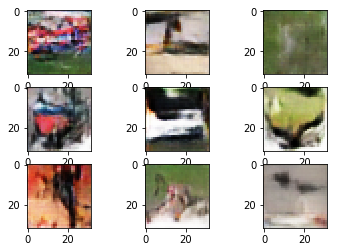

Epoch 2600/2600
64/64 [==============================] - 0s 620us/step - loss: -7.0961 - model_1_loss: -39.3736
Epoch 2600/2600
64/64 [==============================] - 0s 666us/step - loss: -36.0464 - model_1_loss: -42.1741
Epoch 2600/2600
64/64 [==============================] - 0s 662us/step - loss: -27.4322 - model_1_loss: -72.2349
Epoch 2600/2600
64/64 [==============================] - 0s 647us/step - loss: -33.0488 - model_1_loss: -62.4669
Epoch 2600/2600
64/64 [==============================] - 0s 651us/step - loss: -4.1560 - model_1_loss: -69.0535
Epoch 2600/2600
64/64 [==============================] - 0s 746us/step - loss: 93.4076


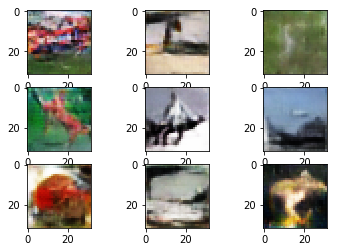

Epoch 2610/2610
64/64 [==============================] - 0s 620us/step - loss: -7.2719 - model_1_loss: -38.6092
Epoch 2610/2610
64/64 [==============================] - 0s 647us/step - loss: -36.4447 - model_1_loss: -30.6078
Epoch 2610/2610
64/64 [==============================] - 0s 657us/step - loss: -19.1031 - model_1_loss: -42.1551
Epoch 2610/2610
64/64 [==============================] - 0s 640us/step - loss: -34.5859 - model_1_loss: -42.6029
Epoch 2610/2610
64/64 [==============================] - 0s 650us/step - loss: -43.2473 - model_1_loss: -80.7390
Epoch 2610/2610
64/64 [==============================] - 0s 737us/step - loss: 38.1689


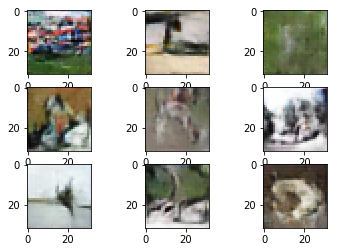

Epoch 2620/2620
64/64 [==============================] - 0s 625us/step - loss: -2.1917 - model_1_loss: -21.2458
Epoch 2620/2620
64/64 [==============================] - 0s 654us/step - loss: -10.2399 - model_1_loss: -69.6518
Epoch 2620/2620
64/64 [==============================] - 0s 657us/step - loss: -22.2981 - model_1_loss: -98.0824
Epoch 2620/2620
64/64 [==============================] - 0s 656us/step - loss: -15.5986 - model_1_loss: -81.9502
Epoch 2620/2620
64/64 [==============================] - 0s 656us/step - loss: -43.2335 - model_1_loss: -91.6919
Epoch 2620/2620
64/64 [==============================] - 0s 740us/step - loss: 60.3654


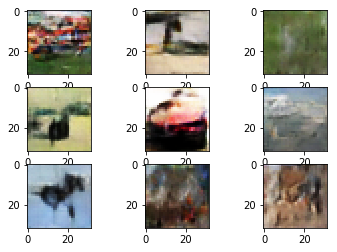

Epoch 2630/2630
64/64 [==============================] - 0s 622us/step - loss: -13.7324 - model_1_loss: -111.7848
Epoch 2630/2630
64/64 [==============================] - 0s 646us/step - loss: -21.1440 - model_1_loss: -118.6274
Epoch 2630/2630
64/64 [==============================] - 0s 669us/step - loss: -36.1169 - model_1_loss: -111.4951
Epoch 2630/2630
64/64 [==============================] - 0s 658us/step - loss: -25.7820 - model_1_loss: -80.3371
Epoch 2630/2630
64/64 [==============================] - 0s 654us/step - loss: -34.1209 - model_1_loss: -78.8739
Epoch 2630/2630
64/64 [==============================] - 0s 723us/step - loss: 46.4429


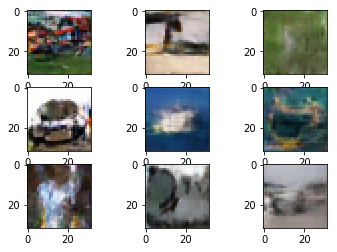

Epoch 2640/2640
64/64 [==============================] - 0s 632us/step - loss: -18.6406 - model_1_loss: -69.9763
Epoch 2640/2640
64/64 [==============================] - 0s 653us/step - loss: -13.4458 - model_1_loss: -39.6953
Epoch 2640/2640
64/64 [==============================] - 0s 651us/step - loss: -25.6274 - model_1_loss: -68.3052
Epoch 2640/2640
64/64 [==============================] - 0s 664us/step - loss: -34.0718 - model_1_loss: -62.7282
Epoch 2640/2640
64/64 [==============================] - 0s 650us/step - loss: -9.8881 - model_1_loss: -68.0360
Epoch 2640/2640
64/64 [==============================] - 0s 724us/step - loss: 81.9568


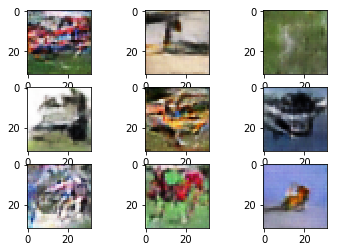

Epoch 2650/2650
64/64 [==============================] - 0s 621us/step - loss: -22.2254 - model_1_loss: -113.0055
Epoch 2650/2650
64/64 [==============================] - 0s 649us/step - loss: -22.7104 - model_1_loss: -96.9322
Epoch 2650/2650
64/64 [==============================] - 0s 641us/step - loss: -36.5742 - model_1_loss: -86.3752
Epoch 2650/2650
64/64 [==============================] - 0s 657us/step - loss: -28.1710 - model_1_loss: -79.1032
Epoch 2650/2650
64/64 [==============================] - 0s 646us/step - loss: -37.4348 - model_1_loss: -68.3796
Epoch 2650/2650
64/64 [==============================] - 0s 723us/step - loss: 47.5057


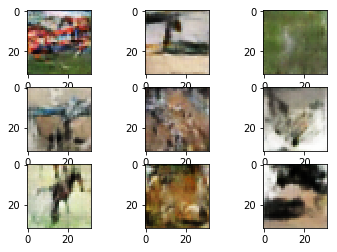

Epoch 2660/2660
64/64 [==============================] - 0s 616us/step - loss: -9.2745 - model_1_loss: -50.1734
Epoch 2660/2660
64/64 [==============================] - 0s 642us/step - loss: -25.2542 - model_1_loss: -53.8313
Epoch 2660/2660
64/64 [==============================] - 0s 643us/step - loss: -43.7609 - model_1_loss: -30.5961
Epoch 2660/2660
64/64 [==============================] - 0s 664us/step - loss: -32.5874 - model_1_loss: -28.0217
Epoch 2660/2660
64/64 [==============================] - 0s 643us/step - loss: -17.4598 - model_1_loss: -35.4504
Epoch 2660/2660
64/64 [==============================] - 0s 730us/step - loss: 47.4492


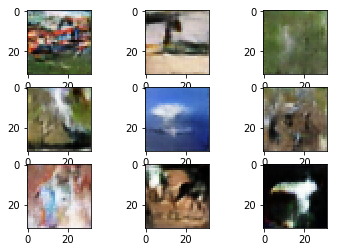

Epoch 2670/2670
64/64 [==============================] - 0s 618us/step - loss: -27.3334 - model_1_loss: -62.5484
Epoch 2670/2670
64/64 [==============================] - 0s 645us/step - loss: -20.0024 - model_1_loss: -82.0456
Epoch 2670/2670
64/64 [==============================] - 0s 643us/step - loss: -25.6560 - model_1_loss: -68.0005
Epoch 2670/2670
64/64 [==============================] - 0s 640us/step - loss: -32.6267 - model_1_loss: -92.6218
Epoch 2670/2670
64/64 [==============================] - 0s 650us/step - loss: -28.6735 - model_1_loss: -85.9589
Epoch 2670/2670
64/64 [==============================] - 0s 736us/step - loss: 64.8306


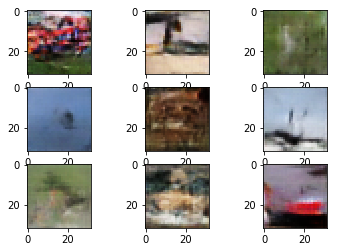

Epoch 2680/2680
64/64 [==============================] - 0s 620us/step - loss: -26.3777 - model_1_loss: -112.6123
Epoch 2680/2680
64/64 [==============================] - 0s 653us/step - loss: -13.7705 - model_1_loss: -87.8872
Epoch 2680/2680
64/64 [==============================] - 0s 673us/step - loss: -31.1164 - model_1_loss: -92.9339
Epoch 2680/2680
64/64 [==============================] - 0s 642us/step - loss: -38.1142 - model_1_loss: -74.9607
Epoch 2680/2680
64/64 [==============================] - 0s 638us/step - loss: -29.4664 - model_1_loss: -95.2353
Epoch 2680/2680
64/64 [==============================] - 0s 729us/step - loss: 83.9043


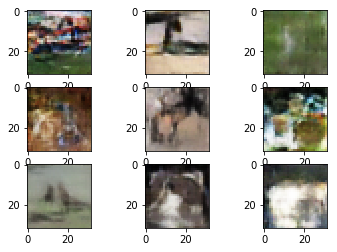

Epoch 2690/2690
64/64 [==============================] - 0s 620us/step - loss: -18.8828 - model_1_loss: -96.7581
Epoch 2690/2690
64/64 [==============================] - 0s 656us/step - loss: -22.8440 - model_1_loss: -88.8454
Epoch 2690/2690
64/64 [==============================] - 0s 650us/step - loss: -8.5389 - model_1_loss: -85.2993
Epoch 2690/2690
64/64 [==============================] - 0s 653us/step - loss: -28.1172 - model_1_loss: -90.8730
Epoch 2690/2690
64/64 [==============================] - 0s 659us/step - loss: -38.1220 - model_1_loss: -106.0280
Epoch 2690/2690
64/64 [==============================] - 0s 731us/step - loss: 90.9879


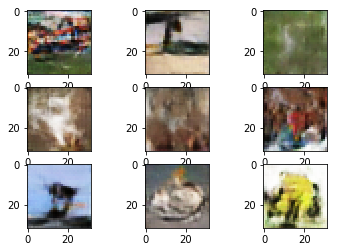

Epoch 2700/2700
64/64 [==============================] - 0s 633us/step - loss: -26.7778 - model_1_loss: -162.3693
Epoch 2700/2700
64/64 [==============================] - 0s 656us/step - loss: -10.4435 - model_1_loss: -156.6712
Epoch 2700/2700
64/64 [==============================] - 0s 654us/step - loss: -25.2608 - model_1_loss: -158.4341
Epoch 2700/2700
64/64 [==============================] - 0s 655us/step - loss: -31.1386 - model_1_loss: -138.6279
Epoch 2700/2700
64/64 [==============================] - 0s 652us/step - loss: -34.0881 - model_1_loss: -163.0977
Epoch 2700/2700
64/64 [==============================] - 0s 732us/step - loss: 137.3469


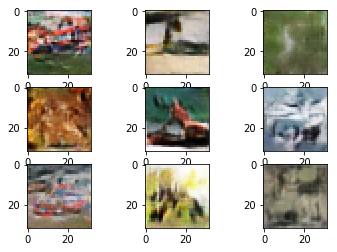

Epoch 2710/2710
64/64 [==============================] - 0s 625us/step - loss: -18.9089 - model_1_loss: -82.8897
Epoch 2710/2710
64/64 [==============================] - 0s 645us/step - loss: -11.0605 - model_1_loss: -111.9960
Epoch 2710/2710
64/64 [==============================] - 0s 654us/step - loss: -27.3865 - model_1_loss: -122.3566
Epoch 2710/2710
64/64 [==============================] - 0s 648us/step - loss: -25.1508 - model_1_loss: -89.0120
Epoch 2710/2710
64/64 [==============================] - 0s 648us/step - loss: -28.7668 - model_1_loss: -85.5962
Epoch 2710/2710
64/64 [==============================] - 0s 731us/step - loss: 76.0805


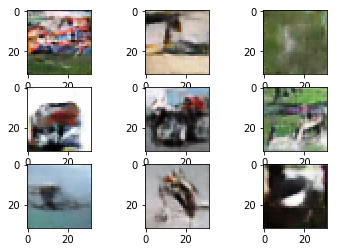

Epoch 2720/2720
64/64 [==============================] - 0s 623us/step - loss: -20.1053 - model_1_loss: -80.1271
Epoch 2720/2720
64/64 [==============================] - 0s 656us/step - loss: -17.1143 - model_1_loss: -80.4096
Epoch 2720/2720
64/64 [==============================] - 0s 649us/step - loss: -17.6370 - model_1_loss: -89.1169
Epoch 2720/2720
64/64 [==============================] - 0s 651us/step - loss: -19.3982 - model_1_loss: -99.9203
Epoch 2720/2720
64/64 [==============================] - 0s 639us/step - loss: -32.3594 - model_1_loss: -99.4158
Epoch 2720/2720
64/64 [==============================] - 0s 737us/step - loss: 92.2167


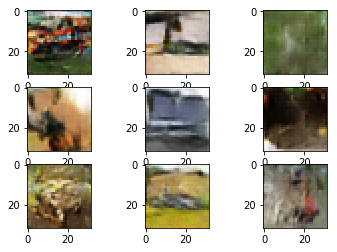

Epoch 2730/2730
64/64 [==============================] - 0s 641us/step - loss: -13.2757 - model_1_loss: -75.8917
Epoch 2730/2730
64/64 [==============================] - 0s 652us/step - loss: -24.3462 - model_1_loss: -85.4854
Epoch 2730/2730
64/64 [==============================] - 0s 659us/step - loss: -27.8959 - model_1_loss: -90.9218
Epoch 2730/2730
64/64 [==============================] - 0s 652us/step - loss: -25.8949 - model_1_loss: -92.2695
Epoch 2730/2730
64/64 [==============================] - 0s 650us/step - loss: -25.2543 - model_1_loss: -83.8235
Epoch 2730/2730
64/64 [==============================] - 0s 735us/step - loss: 72.1646


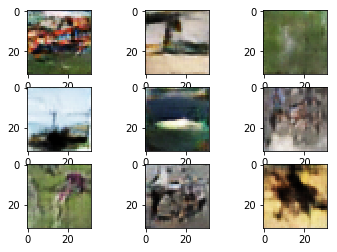

Epoch 2740/2740
64/64 [==============================] - 0s 627us/step - loss: -13.1280 - model_1_loss: -73.7383
Epoch 2740/2740
64/64 [==============================] - 0s 650us/step - loss: -33.2717 - model_1_loss: -88.3488
Epoch 2740/2740
64/64 [==============================] - 0s 654us/step - loss: -20.9244 - model_1_loss: -93.2381
Epoch 2740/2740
64/64 [==============================] - 0s 655us/step - loss: -31.7494 - model_1_loss: -81.2390
Epoch 2740/2740
64/64 [==============================] - 0s 650us/step - loss: -23.4991 - model_1_loss: -73.5662
Epoch 2740/2740
64/64 [==============================] - 0s 742us/step - loss: 55.1487


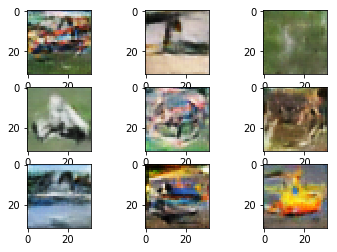

Epoch 2750/2750
64/64 [==============================] - 0s 633us/step - loss: -19.1832 - model_1_loss: -55.2283
Epoch 2750/2750
64/64 [==============================] - 0s 640us/step - loss: -8.8327 - model_1_loss: -97.0689
Epoch 2750/2750
64/64 [==============================] - 0s 636us/step - loss: -31.2771 - model_1_loss: -95.9707
Epoch 2750/2750
64/64 [==============================] - 0s 638us/step - loss: -32.6535 - model_1_loss: -128.6172
Epoch 2750/2750
64/64 [==============================] - 0s 644us/step - loss: -18.9510 - model_1_loss: -123.2345
Epoch 2750/2750
64/64 [==============================] - 0s 738us/step - loss: 131.3331


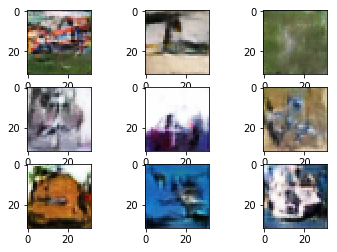

Epoch 2760/2760
64/64 [==============================] - 0s 622us/step - loss: -17.6066 - model_1_loss: -112.1420
Epoch 2760/2760
64/64 [==============================] - 0s 646us/step - loss: -32.9585 - model_1_loss: -96.1792
Epoch 2760/2760
64/64 [==============================] - 0s 657us/step - loss: -21.7975 - model_1_loss: -101.4016
Epoch 2760/2760
64/64 [==============================] - 0s 636us/step - loss: -15.1633 - model_1_loss: -113.8909
Epoch 2760/2760
64/64 [==============================] - 0s 640us/step - loss: -29.4973 - model_1_loss: -110.0202
Epoch 2760/2760
64/64 [==============================] - 0s 724us/step - loss: 114.8118


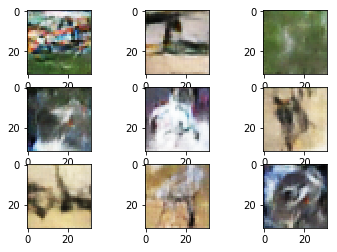

Epoch 2770/2770
64/64 [==============================] - 0s 616us/step - loss: -17.0510 - model_1_loss: -122.1774
Epoch 2770/2770
64/64 [==============================] - 0s 622us/step - loss: -34.1863 - model_1_loss: -139.7336
Epoch 2770/2770
64/64 [==============================] - 0s 633us/step - loss: -21.9756 - model_1_loss: -139.8000
Epoch 2770/2770
64/64 [==============================] - 0s 640us/step - loss: -33.7110 - model_1_loss: -124.9910
Epoch 2770/2770
64/64 [==============================] - 0s 640us/step - loss: -24.3192 - model_1_loss: -129.5469
Epoch 2770/2770
64/64 [==============================] - 0s 732us/step - loss: 90.6390


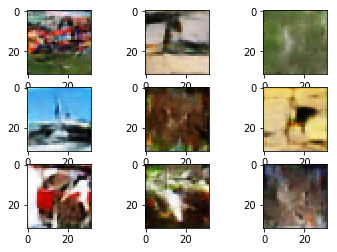

Epoch 2780/2780
64/64 [==============================] - 0s 640us/step - loss: -19.5975 - model_1_loss: -117.1038
Epoch 2780/2780
64/64 [==============================] - 0s 649us/step - loss: -8.9887 - model_1_loss: -106.8125
Epoch 2780/2780
64/64 [==============================] - 0s 653us/step - loss: -11.1669 - model_1_loss: -106.2967
Epoch 2780/2780
64/64 [==============================] - 0s 648us/step - loss: -32.6719 - model_1_loss: -123.9496
Epoch 2780/2780
64/64 [==============================] - 0s 643us/step - loss: -43.2581 - model_1_loss: -105.6581
Epoch 2780/2780
64/64 [==============================] - 0s 725us/step - loss: 107.2806


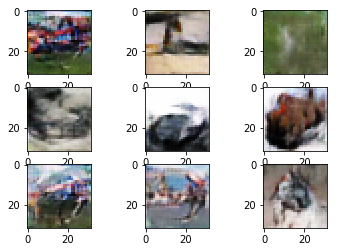

Epoch 2790/2790
64/64 [==============================] - 0s 638us/step - loss: -27.6681 - model_1_loss: -111.1398
Epoch 2790/2790
64/64 [==============================] - 0s 642us/step - loss: -14.1506 - model_1_loss: -98.2060
Epoch 2790/2790
64/64 [==============================] - 0s 661us/step - loss: -23.1592 - model_1_loss: -136.7200
Epoch 2790/2790
64/64 [==============================] - 0s 645us/step - loss: -16.8752 - model_1_loss: -119.3665
Epoch 2790/2790
64/64 [==============================] - 0s 639us/step - loss: -29.8115 - model_1_loss: -126.9916
Epoch 2790/2790
64/64 [==============================] - 0s 737us/step - loss: 120.6710


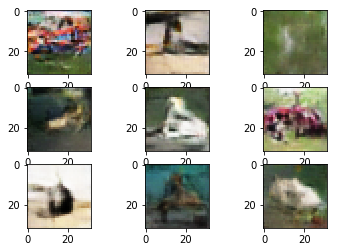

Epoch 2800/2800
64/64 [==============================] - 0s 627us/step - loss: -9.1137 - model_1_loss: -65.8939
Epoch 2800/2800
64/64 [==============================] - 0s 651us/step - loss: -20.2841 - model_1_loss: -99.7191
Epoch 2800/2800
64/64 [==============================] - 0s 641us/step - loss: -60.2778 - model_1_loss: -111.6412
Epoch 2800/2800
64/64 [==============================] - 0s 665us/step - loss: -31.9863 - model_1_loss: -106.9317
Epoch 2800/2800
64/64 [==============================] - 0s 653us/step - loss: -19.2043 - model_1_loss: -120.7563
Epoch 2800/2800
64/64 [==============================] - 0s 726us/step - loss: 115.2812


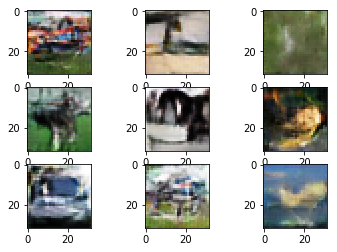

Epoch 2810/2810
64/64 [==============================] - 0s 634us/step - loss: -14.4037 - model_1_loss: -80.5952
Epoch 2810/2810
64/64 [==============================] - 0s 656us/step - loss: -13.7963 - model_1_loss: -92.2810
Epoch 2810/2810
64/64 [==============================] - 0s 656us/step - loss: -18.2816 - model_1_loss: -87.0446
Epoch 2810/2810
64/64 [==============================] - 0s 656us/step - loss: -22.3983 - model_1_loss: -89.1514
Epoch 2810/2810
64/64 [==============================] - 0s 653us/step - loss: -22.3697 - model_1_loss: -79.9802
Epoch 2810/2810
64/64 [==============================] - 0s 728us/step - loss: 105.1922


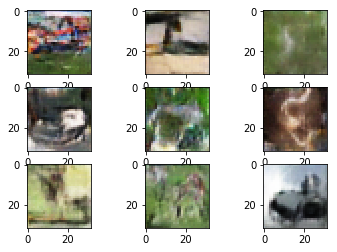

Epoch 2820/2820
64/64 [==============================] - 0s 620us/step - loss: -24.1086 - model_1_loss: -91.6970
Epoch 2820/2820
64/64 [==============================] - 0s 653us/step - loss: -22.6296 - model_1_loss: -74.4454
Epoch 2820/2820
64/64 [==============================] - 0s 658us/step - loss: -21.9802 - model_1_loss: -90.2808
Epoch 2820/2820
64/64 [==============================] - 0s 646us/step - loss: -30.7124 - model_1_loss: -103.0397
Epoch 2820/2820
64/64 [==============================] - 0s 651us/step - loss: -25.7915 - model_1_loss: -115.3091
Epoch 2820/2820
64/64 [==============================] - 0s 739us/step - loss: 98.8981


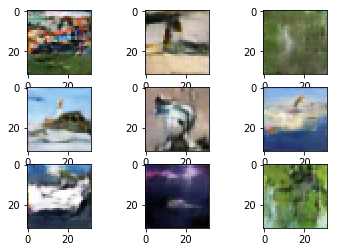

Epoch 2830/2830
64/64 [==============================] - 0s 632us/step - loss: -19.5483 - model_1_loss: -89.8474
Epoch 2830/2830
64/64 [==============================] - 0s 660us/step - loss: -12.6637 - model_1_loss: -96.6448
Epoch 2830/2830
64/64 [==============================] - 0s 657us/step - loss: -29.5481 - model_1_loss: -87.3507
Epoch 2830/2830
64/64 [==============================] - 0s 667us/step - loss: -36.2317 - model_1_loss: -76.0425
Epoch 2830/2830
64/64 [==============================] - 0s 657us/step - loss: -37.4392 - model_1_loss: -47.0373
Epoch 2830/2830
64/64 [==============================] - 0s 745us/step - loss: 62.8401


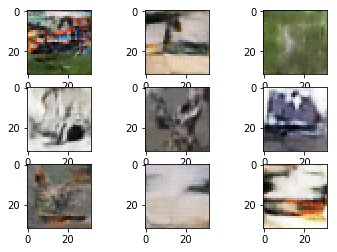

Epoch 2840/2840
64/64 [==============================] - 0s 638us/step - loss: -9.1305 - model_1_loss: -91.3053
Epoch 2840/2840
64/64 [==============================] - 0s 656us/step - loss: -26.8274 - model_1_loss: -87.1595
Epoch 2840/2840
64/64 [==============================] - 0s 651us/step - loss: -19.6651 - model_1_loss: -96.8618
Epoch 2840/2840
64/64 [==============================] - 0s 655us/step - loss: -15.4315 - model_1_loss: -106.1508
Epoch 2840/2840
64/64 [==============================] - 0s 642us/step - loss: -20.1070 - model_1_loss: -102.6169
Epoch 2840/2840
64/64 [==============================] - 0s 731us/step - loss: 101.3630


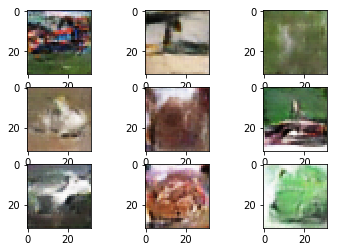

Epoch 2850/2850
64/64 [==============================] - 0s 631us/step - loss: -18.4090 - model_1_loss: -147.7211
Epoch 2850/2850
64/64 [==============================] - 0s 653us/step - loss: -21.2412 - model_1_loss: -116.1879
Epoch 2850/2850
64/64 [==============================] - 0s 661us/step - loss: -11.7309 - model_1_loss: -118.1838
Epoch 2850/2850
64/64 [==============================] - 0s 639us/step - loss: -19.4741 - model_1_loss: -125.1809
Epoch 2850/2850
64/64 [==============================] - 0s 644us/step - loss: -28.3514 - model_1_loss: -102.0582
Epoch 2850/2850
64/64 [==============================] - 0s 722us/step - loss: 107.2363


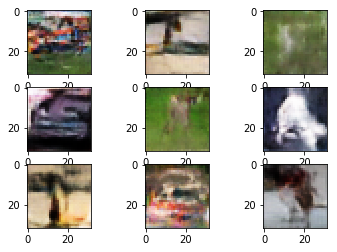

Epoch 2860/2860
64/64 [==============================] - 0s 629us/step - loss: -18.8759 - model_1_loss: -92.7445
Epoch 2860/2860
64/64 [==============================] - 0s 645us/step - loss: -23.1893 - model_1_loss: -102.5648
Epoch 2860/2860
64/64 [==============================] - 0s 636us/step - loss: -17.9392 - model_1_loss: -102.8548
Epoch 2860/2860
64/64 [==============================] - 0s 638us/step - loss: -18.7106 - model_1_loss: -115.7578
Epoch 2860/2860
64/64 [==============================] - 0s 635us/step - loss: -30.1476 - model_1_loss: -125.5136
Epoch 2860/2860
64/64 [==============================] - 0s 720us/step - loss: 125.4866


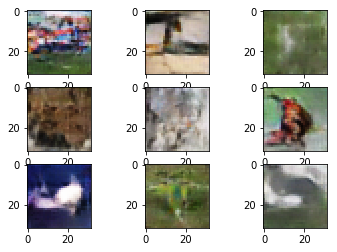

Epoch 2870/2870
64/64 [==============================] - 0s 639us/step - loss: -7.1747 - model_1_loss: -81.1627
Epoch 2870/2870
64/64 [==============================] - 0s 646us/step - loss: -12.2467 - model_1_loss: -98.5747
Epoch 2870/2870
64/64 [==============================] - 0s 647us/step - loss: -23.5441 - model_1_loss: -87.8001
Epoch 2870/2870
64/64 [==============================] - 0s 642us/step - loss: -22.9114 - model_1_loss: -78.7498
Epoch 2870/2870
64/64 [==============================] - 0s 650us/step - loss: -23.1765 - model_1_loss: -75.9974
Epoch 2870/2870
64/64 [==============================] - 0s 735us/step - loss: 63.6813


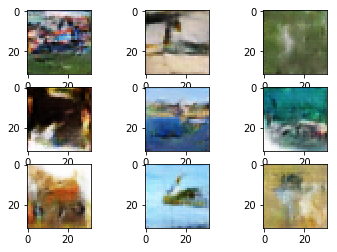

Epoch 2880/2880
64/64 [==============================] - 0s 626us/step - loss: -22.2541 - model_1_loss: -91.4489
Epoch 2880/2880
64/64 [==============================] - 0s 637us/step - loss: -12.4766 - model_1_loss: -31.9353
Epoch 2880/2880
64/64 [==============================] - 0s 647us/step - loss: -16.9997 - model_1_loss: -50.1871
Epoch 2880/2880
64/64 [==============================] - 0s 639us/step - loss: -28.9845 - model_1_loss: -93.6893
Epoch 2880/2880
64/64 [==============================] - 0s 640us/step - loss: -19.0176 - model_1_loss: -92.2437
Epoch 2880/2880
64/64 [==============================] - 0s 734us/step - loss: 108.5101


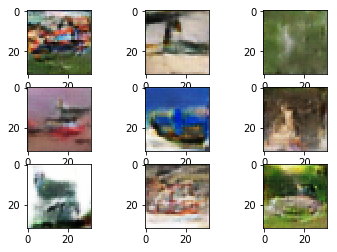

Epoch 2890/2890
64/64 [==============================] - 0s 616us/step - loss: -23.1406 - model_1_loss: -146.3450
Epoch 2890/2890
64/64 [==============================] - 0s 653us/step - loss: -20.3424 - model_1_loss: -120.8749
Epoch 2890/2890
64/64 [==============================] - 0s 647us/step - loss: -39.3027 - model_1_loss: -100.1683
Epoch 2890/2890
64/64 [==============================] - 0s 629us/step - loss: -24.7298 - model_1_loss: -78.3973
Epoch 2890/2890
64/64 [==============================] - 0s 638us/step - loss: -28.6130 - model_1_loss: -94.0720
Epoch 2890/2890
64/64 [==============================] - 0s 720us/step - loss: 104.1749


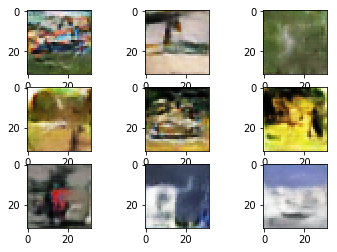

Epoch 2900/2900
64/64 [==============================] - 0s 635us/step - loss: -19.5358 - model_1_loss: -110.2845
Epoch 2900/2900
64/64 [==============================] - 0s 641us/step - loss: -9.3135 - model_1_loss: -122.5647
Epoch 2900/2900
64/64 [==============================] - 0s 641us/step - loss: -22.7066 - model_1_loss: -135.5465
Epoch 2900/2900
64/64 [==============================] - 0s 636us/step - loss: -27.5439 - model_1_loss: -138.8852
Epoch 2900/2900
64/64 [==============================] - 0s 650us/step - loss: -46.3113 - model_1_loss: -149.2783
Epoch 2900/2900
64/64 [==============================] - 0s 723us/step - loss: 146.4907


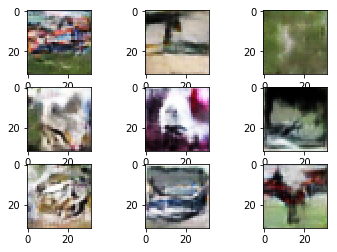

Epoch 2910/2910
64/64 [==============================] - 0s 641us/step - loss: -38.6354 - model_1_loss: -138.6835
Epoch 2910/2910
64/64 [==============================] - 0s 641us/step - loss: -16.6614 - model_1_loss: -120.1631
Epoch 2910/2910
64/64 [==============================] - 0s 645us/step - loss: -27.5674 - model_1_loss: -78.1259
Epoch 2910/2910
64/64 [==============================] - 0s 640us/step - loss: -27.0430 - model_1_loss: -86.4033
Epoch 2910/2910
64/64 [==============================] - 0s 645us/step - loss: -10.7746 - model_1_loss: -87.6869
Epoch 2910/2910
64/64 [==============================] - 0s 736us/step - loss: 82.4925


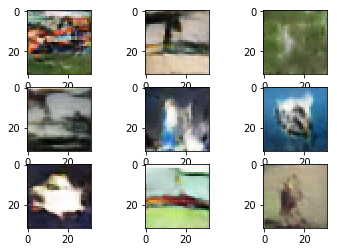

Epoch 2920/2920
64/64 [==============================] - 0s 644us/step - loss: -2.3275 - model_1_loss: -122.0079
Epoch 2920/2920
64/64 [==============================] - 0s 659us/step - loss: -20.1940 - model_1_loss: -88.8225
Epoch 2920/2920
64/64 [==============================] - 0s 658us/step - loss: -29.7831 - model_1_loss: -95.9208
Epoch 2920/2920
64/64 [==============================] - 0s 667us/step - loss: -36.5704 - model_1_loss: -91.0909
Epoch 2920/2920
64/64 [==============================] - 0s 652us/step - loss: -38.3731 - model_1_loss: -78.2734
Epoch 2920/2920
64/64 [==============================] - 0s 748us/step - loss: 82.8724


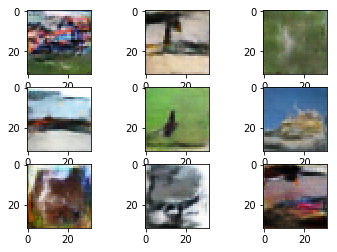

Epoch 2930/2930
64/64 [==============================] - 0s 634us/step - loss: -9.7836 - model_1_loss: -38.9234
Epoch 2930/2930
64/64 [==============================] - 0s 655us/step - loss: -22.0372 - model_1_loss: -67.0079
Epoch 2930/2930
64/64 [==============================] - 0s 645us/step - loss: -30.3286 - model_1_loss: -97.2352
Epoch 2930/2930
64/64 [==============================] - 0s 648us/step - loss: -27.0510 - model_1_loss: -92.7165
Epoch 2930/2930
64/64 [==============================] - 0s 639us/step - loss: -28.8034 - model_1_loss: -97.0638
Epoch 2930/2930
64/64 [==============================] - 0s 734us/step - loss: 72.9061


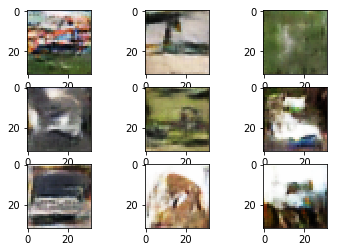

Epoch 2940/2940
64/64 [==============================] - 0s 626us/step - loss: -30.8223 - model_1_loss: -103.9159
Epoch 2940/2940
64/64 [==============================] - 0s 667us/step - loss: -25.2055 - model_1_loss: -61.0312
Epoch 2940/2940
64/64 [==============================] - 0s 658us/step - loss: -14.7533 - model_1_loss: -85.3668
Epoch 2940/2940
64/64 [==============================] - 0s 657us/step - loss: -38.1144 - model_1_loss: -79.3866
Epoch 2940/2940
64/64 [==============================] - 0s 658us/step - loss: -15.6326 - model_1_loss: -87.6094
Epoch 2940/2940
64/64 [==============================] - 0s 735us/step - loss: 102.3961


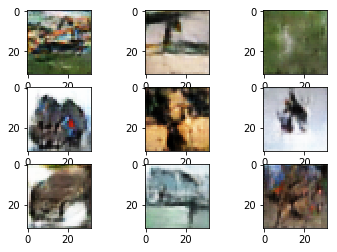

Epoch 2950/2950
64/64 [==============================] - 0s 631us/step - loss: -14.6553 - model_1_loss: -99.3055
Epoch 2950/2950
64/64 [==============================] - 0s 655us/step - loss: -17.2182 - model_1_loss: -108.0212
Epoch 2950/2950
64/64 [==============================] - 0s 648us/step - loss: -28.8394 - model_1_loss: -131.8898
Epoch 2950/2950
64/64 [==============================] - 0s 655us/step - loss: -9.1559 - model_1_loss: -123.7281
Epoch 2950/2950
64/64 [==============================] - 0s 636us/step - loss: -24.8732 - model_1_loss: -121.7189
Epoch 2950/2950
64/64 [==============================] - 0s 733us/step - loss: 118.3001


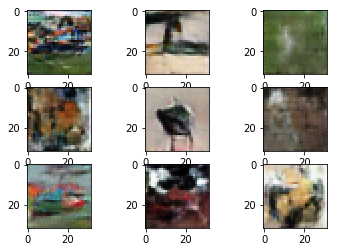

Epoch 2960/2960
64/64 [==============================] - 0s 636us/step - loss: -11.6117 - model_1_loss: -13.9332
Epoch 2960/2960
64/64 [==============================] - 0s 646us/step - loss: -45.6175 - model_1_loss: -39.7422
Epoch 2960/2960
64/64 [==============================] - 0s 661us/step - loss: -29.6573 - model_1_loss: -15.8850
Epoch 2960/2960
64/64 [==============================] - 0s 656us/step - loss: -28.5277 - model_1_loss: -22.8322
Epoch 2960/2960
64/64 [==============================] - 0s 650us/step - loss: -25.3057 - model_1_loss: -29.3931
Epoch 2960/2960
64/64 [==============================] - 0s 737us/step - loss: 15.6767


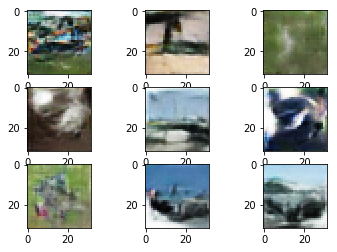

Epoch 2970/2970
64/64 [==============================] - 0s 634us/step - loss: -23.2909 - model_1_loss: -72.6101
Epoch 2970/2970
64/64 [==============================] - 0s 649us/step - loss: -16.0404 - model_1_loss: -61.9963
Epoch 2970/2970
64/64 [==============================] - 0s 752us/step - loss: -15.5933 - model_1_loss: -52.8324
Epoch 2970/2970
64/64 [==============================] - 0s 662us/step - loss: -22.7564 - model_1_loss: -35.0572
Epoch 2970/2970
64/64 [==============================] - 0s 643us/step - loss: -28.5015 - model_1_loss: -38.3770
Epoch 2970/2970
64/64 [==============================] - 0s 742us/step - loss: 59.5294


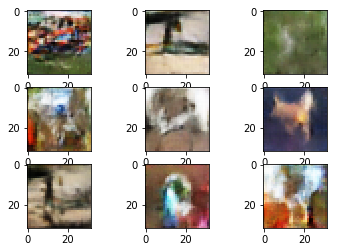

Epoch 2980/2980
64/64 [==============================] - 0s 632us/step - loss: -10.8627 - model_1_loss: -75.8938
Epoch 2980/2980
64/64 [==============================] - 0s 654us/step - loss: -20.0421 - model_1_loss: -97.0128
Epoch 2980/2980
64/64 [==============================] - 0s 657us/step - loss: -14.3117 - model_1_loss: -93.9306
Epoch 2980/2980
64/64 [==============================] - 0s 641us/step - loss: -33.1599 - model_1_loss: -82.7497
Epoch 2980/2980
64/64 [==============================] - 0s 654us/step - loss: -29.6912 - model_1_loss: -77.1940
Epoch 2980/2980
64/64 [==============================] - 0s 738us/step - loss: 66.2976


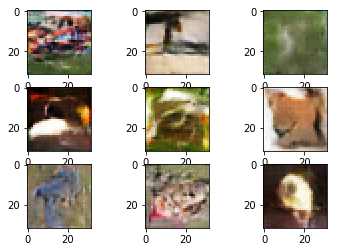

Epoch 2990/2990
64/64 [==============================] - 0s 623us/step - loss: -10.2251 - model_1_loss: -76.8858
Epoch 2990/2990
64/64 [==============================] - 0s 638us/step - loss: -13.4579 - model_1_loss: -95.4239
Epoch 2990/2990
64/64 [==============================] - 0s 647us/step - loss: -19.3819 - model_1_loss: -120.5902
Epoch 2990/2990
64/64 [==============================] - 0s 644us/step - loss: -25.1212 - model_1_loss: -94.7116
Epoch 2990/2990
64/64 [==============================] - 0s 644us/step - loss: -22.3703 - model_1_loss: -98.8887
Epoch 2990/2990
64/64 [==============================] - 0s 735us/step - loss: 84.0446


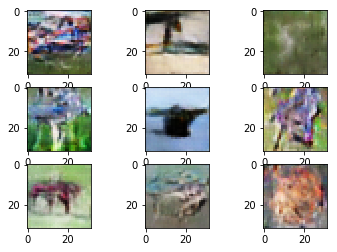

Epoch 3000/3000
64/64 [==============================] - 0s 616us/step - loss: -14.6235 - model_1_loss: -156.8399
Epoch 3000/3000
64/64 [==============================] - 0s 654us/step - loss: -28.5493 - model_1_loss: -166.2220
Epoch 3000/3000
64/64 [==============================] - 0s 649us/step - loss: -19.7128 - model_1_loss: -139.8118
Epoch 3000/3000
64/64 [==============================] - 0s 640us/step - loss: -30.6721 - model_1_loss: -140.7217
Epoch 3000/3000
64/64 [==============================] - 0s 647us/step - loss: -16.6973 - model_1_loss: -122.6887
Epoch 3000/3000
64/64 [==============================] - 0s 727us/step - loss: 124.1329


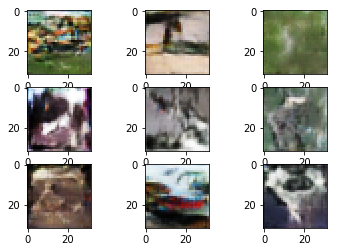

Epoch 3010/3010
64/64 [==============================] - 0s 600us/step - loss: -5.9046 - model_1_loss: -91.5590
Epoch 3010/3010
64/64 [==============================] - 0s 604us/step - loss: -18.5562 - model_1_loss: -70.8756
Epoch 3010/3010
64/64 [==============================] - 0s 607us/step - loss: -14.6476 - model_1_loss: -95.4429
Epoch 3010/3010
64/64 [==============================] - 0s 623us/step - loss: -22.6169 - model_1_loss: -98.8937
Epoch 3010/3010
64/64 [==============================] - 0s 613us/step - loss: -22.6836 - model_1_loss: -83.3429
Epoch 3010/3010
64/64 [==============================] - 0s 702us/step - loss: 101.0276


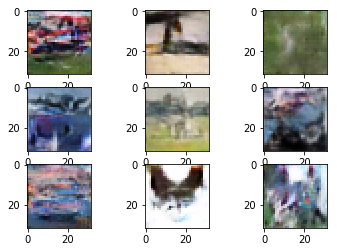

Epoch 3020/3020
64/64 [==============================] - 0s 593us/step - loss: -9.1521 - model_1_loss: -149.0965
Epoch 3020/3020
64/64 [==============================] - 0s 611us/step - loss: -24.5250 - model_1_loss: -127.6572
Epoch 3020/3020
64/64 [==============================] - 0s 617us/step - loss: -22.6466 - model_1_loss: -120.4014
Epoch 3020/3020
64/64 [==============================] - 0s 606us/step - loss: -20.8750 - model_1_loss: -118.1794
Epoch 3020/3020
64/64 [==============================] - 0s 619us/step - loss: -31.5692 - model_1_loss: -119.2692
Epoch 3020/3020
64/64 [==============================] - 0s 686us/step - loss: 108.3019


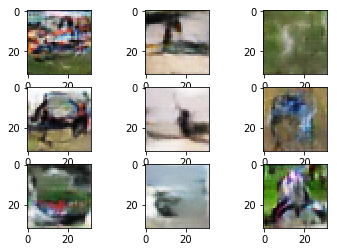

Epoch 3030/3030
64/64 [==============================] - 0s 606us/step - loss: -9.7621 - model_1_loss: -109.6725
Epoch 3030/3030
64/64 [==============================] - 0s 597us/step - loss: -24.6996 - model_1_loss: -109.6410
Epoch 3030/3030
64/64 [==============================] - 0s 606us/step - loss: -10.5355 - model_1_loss: -78.8476
Epoch 3030/3030
64/64 [==============================] - 0s 616us/step - loss: -32.7798 - model_1_loss: -72.8188
Epoch 3030/3030
64/64 [==============================] - 0s 628us/step - loss: -41.4489 - model_1_loss: -77.9494
Epoch 3030/3030
64/64 [==============================] - 0s 697us/step - loss: 89.0310


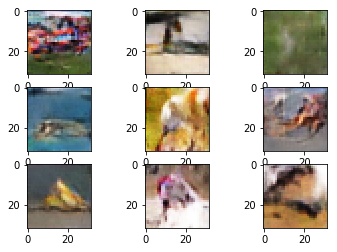

Epoch 3040/3040
64/64 [==============================] - 0s 590us/step - loss: -7.4307 - model_1_loss: -103.6415
Epoch 3040/3040
64/64 [==============================] - 0s 623us/step - loss: -5.3400 - model_1_loss: -83.7544
Epoch 3040/3040
64/64 [==============================] - 0s 613us/step - loss: -24.5855 - model_1_loss: -80.7116
Epoch 3040/3040
64/64 [==============================] - 0s 623us/step - loss: -41.9201 - model_1_loss: -118.6940
Epoch 3040/3040
64/64 [==============================] - 0s 624us/step - loss: -16.0679 - model_1_loss: -106.3567
Epoch 3040/3040
64/64 [==============================] - 0s 691us/step - loss: 113.7211


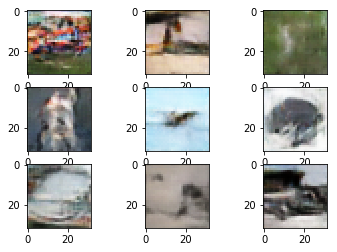

Epoch 3050/3050
64/64 [==============================] - 0s 601us/step - loss: -17.9221 - model_1_loss: -84.0393
Epoch 3050/3050
64/64 [==============================] - 0s 629us/step - loss: -22.7226 - model_1_loss: -83.9640
Epoch 3050/3050
64/64 [==============================] - 0s 609us/step - loss: -28.4342 - model_1_loss: -89.4528
Epoch 3050/3050
64/64 [==============================] - 0s 604us/step - loss: -32.6039 - model_1_loss: -79.4422
Epoch 3050/3050
64/64 [==============================] - 0s 633us/step - loss: -24.7738 - model_1_loss: -94.3415
Epoch 3050/3050
64/64 [==============================] - 0s 705us/step - loss: 110.4538


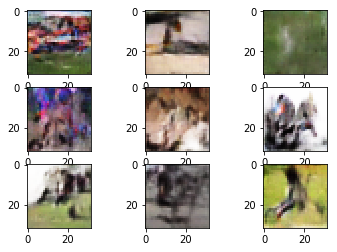

Epoch 3060/3060
64/64 [==============================] - 0s 598us/step - loss: -33.7596 - model_1_loss: -86.3101
Epoch 3060/3060
64/64 [==============================] - 0s 616us/step - loss: -35.0550 - model_1_loss: -85.8384
Epoch 3060/3060
64/64 [==============================] - 0s 615us/step - loss: -32.3320 - model_1_loss: -87.6027
Epoch 3060/3060
64/64 [==============================] - 0s 628us/step - loss: -17.8865 - model_1_loss: -85.3696
Epoch 3060/3060
64/64 [==============================] - 0s 637us/step - loss: -30.5455 - model_1_loss: -118.7824
Epoch 3060/3060
64/64 [==============================] - 0s 695us/step - loss: 116.0214


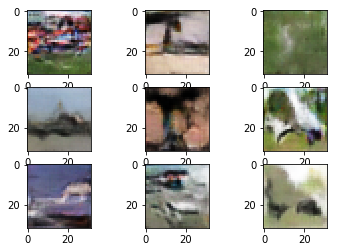

Epoch 3070/3070
64/64 [==============================] - 0s 598us/step - loss: -19.4870 - model_1_loss: -61.2246
Epoch 3070/3070
64/64 [==============================] - 0s 619us/step - loss: -11.5256 - model_1_loss: -54.4863
Epoch 3070/3070
64/64 [==============================] - 0s 631us/step - loss: -30.3814 - model_1_loss: -87.1129
Epoch 3070/3070
64/64 [==============================] - 0s 633us/step - loss: -39.0744 - model_1_loss: -99.6428
Epoch 3070/3070
64/64 [==============================] - 0s 633us/step - loss: -29.4783 - model_1_loss: -104.9764
Epoch 3070/3070
64/64 [==============================] - 0s 705us/step - loss: 97.3296


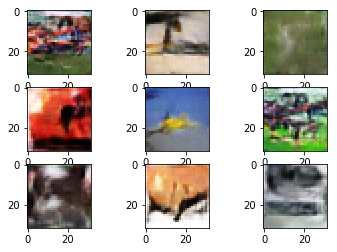

Epoch 3080/3080
64/64 [==============================] - 0s 601us/step - loss: -17.3063 - model_1_loss: -55.8943
Epoch 3080/3080
64/64 [==============================] - 0s 638us/step - loss: -15.1573 - model_1_loss: -61.7017
Epoch 3080/3080
64/64 [==============================] - 0s 655us/step - loss: -33.1028 - model_1_loss: -49.4144
Epoch 3080/3080
64/64 [==============================] - 0s 621us/step - loss: -20.5321 - model_1_loss: -69.8245
Epoch 3080/3080
64/64 [==============================] - 0s 631us/step - loss: -27.0432 - model_1_loss: -85.4166
Epoch 3080/3080
64/64 [==============================] - 0s 723us/step - loss: 66.4151


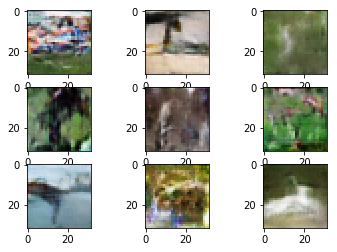

Epoch 3090/3090
64/64 [==============================] - 0s 620us/step - loss: -22.7263 - model_1_loss: -75.3961
Epoch 3090/3090
64/64 [==============================] - 0s 638us/step - loss: -10.9778 - model_1_loss: -48.9422
Epoch 3090/3090
64/64 [==============================] - 0s 636us/step - loss: -17.1131 - model_1_loss: -72.1028
Epoch 3090/3090
64/64 [==============================] - 0s 629us/step - loss: -16.9308 - model_1_loss: -60.3832
Epoch 3090/3090
64/64 [==============================] - 0s 628us/step - loss: -34.2461 - model_1_loss: -70.2997
Epoch 3090/3090
64/64 [==============================] - 0s 720us/step - loss: 55.2719


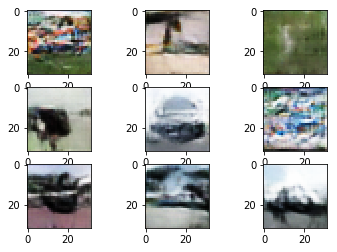

Epoch 3100/3100
64/64 [==============================] - 0s 617us/step - loss: -8.6322 - model_1_loss: -103.2441
Epoch 3100/3100
64/64 [==============================] - 0s 627us/step - loss: -13.4960 - model_1_loss: -101.4742
Epoch 3100/3100
64/64 [==============================] - 0s 637us/step - loss: -30.8094 - model_1_loss: -93.8919
Epoch 3100/3100
64/64 [==============================] - 0s 635us/step - loss: -23.8202 - model_1_loss: -61.9480
Epoch 3100/3100
64/64 [==============================] - 0s 638us/step - loss: -23.5794 - model_1_loss: -69.1324
Epoch 3100/3100
64/64 [==============================] - 0s 710us/step - loss: 85.6581


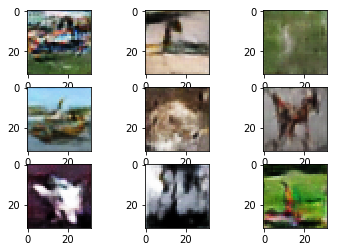

Epoch 3110/3110
64/64 [==============================] - 0s 623us/step - loss: -14.5672 - model_1_loss: -79.4307
Epoch 3110/3110
64/64 [==============================] - 0s 608us/step - loss: -23.0273 - model_1_loss: -89.4489
Epoch 3110/3110
64/64 [==============================] - 0s 634us/step - loss: -24.7484 - model_1_loss: -109.2299
Epoch 3110/3110
64/64 [==============================] - 0s 635us/step - loss: -20.3687 - model_1_loss: -96.7700
Epoch 3110/3110
64/64 [==============================] - 0s 648us/step - loss: -23.3824 - model_1_loss: -98.7481
Epoch 3110/3110
64/64 [==============================] - 0s 719us/step - loss: 94.6571


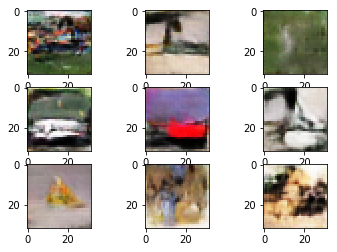

Epoch 3120/3120
64/64 [==============================] - 0s 634us/step - loss: -24.5948 - model_1_loss: -37.9805
Epoch 3120/3120
64/64 [==============================] - 0s 641us/step - loss: -5.9613 - model_1_loss: -60.5983
Epoch 3120/3120
64/64 [==============================] - 0s 637us/step - loss: -31.3890 - model_1_loss: -88.0989
Epoch 3120/3120
64/64 [==============================] - 0s 626us/step - loss: -27.8595 - model_1_loss: -85.6085
Epoch 3120/3120
64/64 [==============================] - 0s 629us/step - loss: -18.8598 - model_1_loss: -64.2935
Epoch 3120/3120
64/64 [==============================] - 0s 726us/step - loss: 87.3720


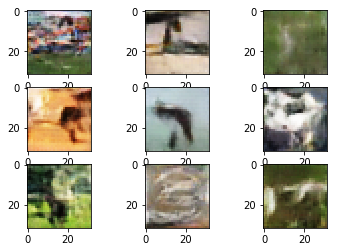

Epoch 3130/3130
64/64 [==============================] - 0s 625us/step - loss: -0.6503 - model_1_loss: -50.2633
Epoch 3130/3130
64/64 [==============================] - 0s 640us/step - loss: -37.6794 - model_1_loss: -123.5073
Epoch 3130/3130
64/64 [==============================] - 0s 641us/step - loss: -15.1833 - model_1_loss: -122.4268
Epoch 3130/3130
64/64 [==============================] - 0s 651us/step - loss: -22.0127 - model_1_loss: -120.4243
Epoch 3130/3130
64/64 [==============================] - 0s 658us/step - loss: -23.1233 - model_1_loss: -143.6945
Epoch 3130/3130
64/64 [==============================] - 0s 729us/step - loss: 127.1969


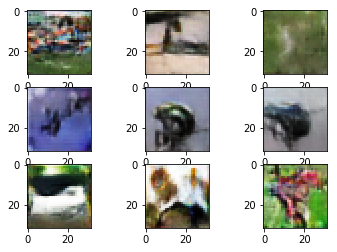

Epoch 3140/3140
64/64 [==============================] - 0s 630us/step - loss: -1.9911 - model_1_loss: -113.7350
Epoch 3140/3140
64/64 [==============================] - 0s 648us/step - loss: -23.9263 - model_1_loss: -131.4943
Epoch 3140/3140
64/64 [==============================] - 0s 657us/step - loss: -12.5952 - model_1_loss: -131.3215
Epoch 3140/3140
64/64 [==============================] - 0s 647us/step - loss: -16.0483 - model_1_loss: -125.0552
Epoch 3140/3140
64/64 [==============================] - 0s 637us/step - loss: -27.5879 - model_1_loss: -120.5761
Epoch 3140/3140
64/64 [==============================] - 0s 731us/step - loss: 111.4343


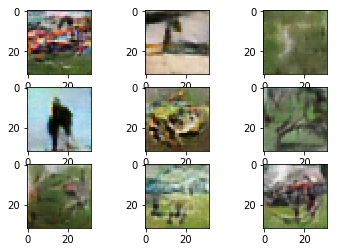

Epoch 3150/3150
64/64 [==============================] - 0s 631us/step - loss: -34.2901 - model_1_loss: -122.2694
Epoch 3150/3150
64/64 [==============================] - 0s 643us/step - loss: -1.3749 - model_1_loss: -123.0865
Epoch 3150/3150
64/64 [==============================] - 0s 650us/step - loss: -13.5865 - model_1_loss: -118.0893
Epoch 3150/3150
64/64 [==============================] - 0s 660us/step - loss: -28.6154 - model_1_loss: -118.1671
Epoch 3150/3150
64/64 [==============================] - 0s 660us/step - loss: -10.0441 - model_1_loss: -107.4775
Epoch 3150/3150
64/64 [==============================] - 0s 725us/step - loss: 116.7978


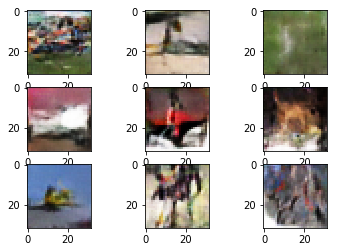

Epoch 3160/3160
64/64 [==============================] - 0s 629us/step - loss: -24.6002 - model_1_loss: -54.4761
Epoch 3160/3160
64/64 [==============================] - 0s 639us/step - loss: -3.4757 - model_1_loss: -62.3056
Epoch 3160/3160
64/64 [==============================] - 0s 656us/step - loss: -29.8234 - model_1_loss: -68.9580
Epoch 3160/3160
64/64 [==============================] - 0s 663us/step - loss: -26.2241 - model_1_loss: -74.7537
Epoch 3160/3160
64/64 [==============================] - 0s 656us/step - loss: -19.7792 - model_1_loss: -61.7609
Epoch 3160/3160
64/64 [==============================] - 0s 731us/step - loss: 67.2110


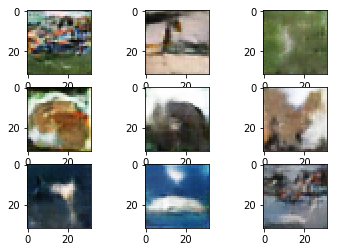

Epoch 3170/3170
64/64 [==============================] - 0s 629us/step - loss: -5.9826 - model_1_loss: -84.2024
Epoch 3170/3170
64/64 [==============================] - 0s 655us/step - loss: -31.8597 - model_1_loss: -119.9801
Epoch 3170/3170
64/64 [==============================] - 0s 650us/step - loss: -26.0455 - model_1_loss: -130.4124
Epoch 3170/3170
64/64 [==============================] - 0s 646us/step - loss: 0.1543 - model_1_loss: -118.0642
Epoch 3170/3170
64/64 [==============================] - 0s 657us/step - loss: -27.4554 - model_1_loss: -117.0436
Epoch 3170/3170
64/64 [==============================] - 0s 730us/step - loss: 88.6343


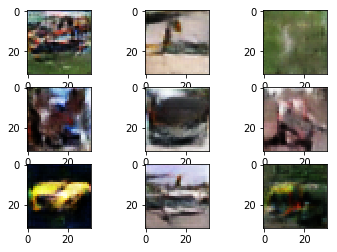

Epoch 3180/3180
64/64 [==============================] - 0s 628us/step - loss: -22.2242 - model_1_loss: -74.6853
Epoch 3180/3180
64/64 [==============================] - 0s 655us/step - loss: -0.6131 - model_1_loss: -81.9137
Epoch 3180/3180
64/64 [==============================] - 0s 647us/step - loss: -22.4828 - model_1_loss: -106.7893
Epoch 3180/3180
64/64 [==============================] - 0s 653us/step - loss: -14.4887 - model_1_loss: -65.2120
Epoch 3180/3180
64/64 [==============================] - 0s 660us/step - loss: -29.4951 - model_1_loss: -87.8167
Epoch 3180/3180
64/64 [==============================] - 0s 723us/step - loss: 71.3895


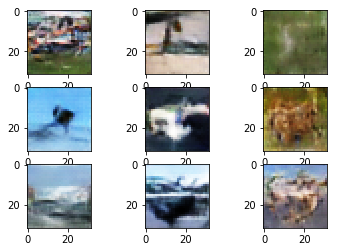

Epoch 3190/3190
64/64 [==============================] - 0s 625us/step - loss: -14.0217 - model_1_loss: -103.7214
Epoch 3190/3190
64/64 [==============================] - 0s 646us/step - loss: -13.8209 - model_1_loss: -85.2405
Epoch 3190/3190
64/64 [==============================] - 0s 646us/step - loss: -25.1359 - model_1_loss: -90.3247
Epoch 3190/3190
64/64 [==============================] - 0s 657us/step - loss: -34.2000 - model_1_loss: -100.0145
Epoch 3190/3190
64/64 [==============================] - 0s 660us/step - loss: -29.4358 - model_1_loss: -135.9743
Epoch 3190/3190
64/64 [==============================] - 0s 737us/step - loss: 125.1524


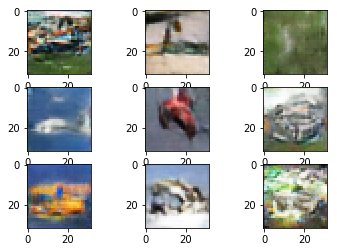

Epoch 3200/3200
64/64 [==============================] - 0s 659us/step - loss: -4.8615 - model_1_loss: -96.8213
Epoch 3200/3200
64/64 [==============================] - 0s 648us/step - loss: -7.4062 - model_1_loss: -100.7187
Epoch 3200/3200
64/64 [==============================] - 0s 645us/step - loss: -22.8352 - model_1_loss: -139.9740
Epoch 3200/3200
64/64 [==============================] - 0s 642us/step - loss: -21.8881 - model_1_loss: -134.8772
Epoch 3200/3200
64/64 [==============================] - 0s 650us/step - loss: -44.8998 - model_1_loss: -134.7088
Epoch 3200/3200
64/64 [==============================] - 0s 721us/step - loss: 126.1081


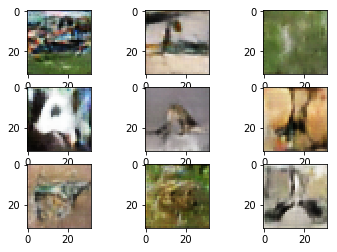

Epoch 3210/3210
64/64 [==============================] - 0s 639us/step - loss: -7.9429 - model_1_loss: -61.2695
Epoch 3210/3210
64/64 [==============================] - 0s 637us/step - loss: -18.0336 - model_1_loss: -116.9637
Epoch 3210/3210
64/64 [==============================] - 0s 653us/step - loss: -30.5215 - model_1_loss: -124.3517
Epoch 3210/3210
64/64 [==============================] - 0s 644us/step - loss: -17.6618 - model_1_loss: -142.6006
Epoch 3210/3210
64/64 [==============================] - 0s 647us/step - loss: -30.5149 - model_1_loss: -142.6051
Epoch 3210/3210
64/64 [==============================] - 0s 733us/step - loss: 124.8508


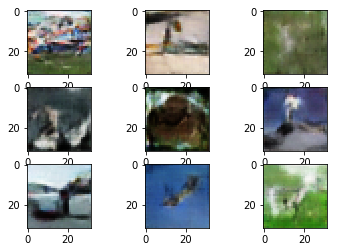

Epoch 3220/3220
64/64 [==============================] - 0s 626us/step - loss: -13.8593 - model_1_loss: -126.7687
Epoch 3220/3220
64/64 [==============================] - 0s 630us/step - loss: -17.6618 - model_1_loss: -132.7482
Epoch 3220/3220
64/64 [==============================] - 0s 637us/step - loss: -22.2746 - model_1_loss: -140.9851
Epoch 3220/3220
64/64 [==============================] - 0s 641us/step - loss: -35.0954 - model_1_loss: -139.9379
Epoch 3220/3220
64/64 [==============================] - 0s 636us/step - loss: -20.7641 - model_1_loss: -151.4460
Epoch 3220/3220
64/64 [==============================] - 0s 729us/step - loss: 142.5321


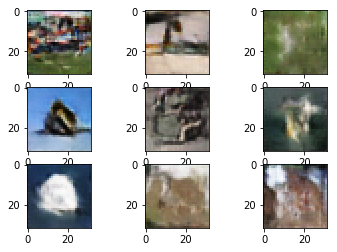

Epoch 3230/3230
64/64 [==============================] - 0s 623us/step - loss: -22.7769 - model_1_loss: -88.4271
Epoch 3230/3230
64/64 [==============================] - 0s 657us/step - loss: -14.6123 - model_1_loss: -91.9907
Epoch 3230/3230
64/64 [==============================] - 0s 655us/step - loss: -29.6026 - model_1_loss: -95.7369
Epoch 3230/3230
64/64 [==============================] - 0s 652us/step - loss: -29.6251 - model_1_loss: -94.0647
Epoch 3230/3230
64/64 [==============================] - 0s 643us/step - loss: -24.2839 - model_1_loss: -80.2251
Epoch 3230/3230
64/64 [==============================] - 0s 728us/step - loss: 104.0154


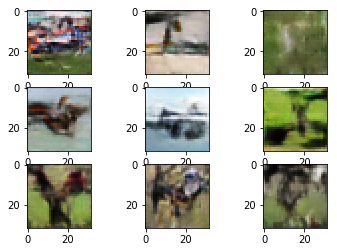

Epoch 3240/3240
64/64 [==============================] - 0s 635us/step - loss: -20.9879 - model_1_loss: -112.8260
Epoch 3240/3240
64/64 [==============================] - 0s 641us/step - loss: -24.1506 - model_1_loss: -95.0779
Epoch 3240/3240
64/64 [==============================] - 0s 646us/step - loss: -23.2821 - model_1_loss: -85.2097
Epoch 3240/3240
64/64 [==============================] - 0s 645us/step - loss: -24.9151 - model_1_loss: -71.7424
Epoch 3240/3240
64/64 [==============================] - 0s 649us/step - loss: -14.0219 - model_1_loss: -74.9357
Epoch 3240/3240
64/64 [==============================] - 0s 739us/step - loss: 110.3962


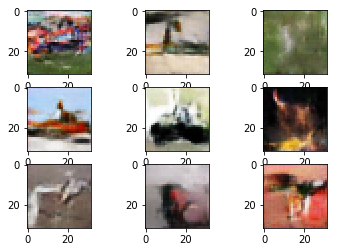

Epoch 3250/3250
64/64 [==============================] - 0s 637us/step - loss: -13.7680 - model_1_loss: -86.9700
Epoch 3250/3250
64/64 [==============================] - 0s 648us/step - loss: -17.5053 - model_1_loss: -89.0030
Epoch 3250/3250
64/64 [==============================] - 0s 642us/step - loss: -13.2655 - model_1_loss: -80.2359
Epoch 3250/3250
64/64 [==============================] - 0s 635us/step - loss: -14.1269 - model_1_loss: -91.7327
Epoch 3250/3250
64/64 [==============================] - 0s 649us/step - loss: -23.5907 - model_1_loss: -83.0509
Epoch 3250/3250
64/64 [==============================] - 0s 727us/step - loss: 72.4755


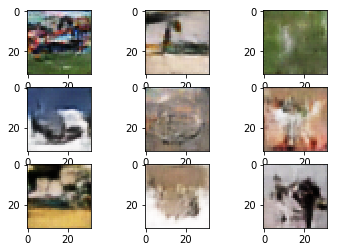

Epoch 3260/3260
64/64 [==============================] - 0s 626us/step - loss: -9.0031 - model_1_loss: -79.1871
Epoch 3260/3260
64/64 [==============================] - 0s 659us/step - loss: -17.8496 - model_1_loss: -77.3527
Epoch 3260/3260
64/64 [==============================] - 0s 660us/step - loss: -27.5250 - model_1_loss: -56.3914
Epoch 3260/3260
64/64 [==============================] - 0s 660us/step - loss: -34.4616 - model_1_loss: -85.3041
Epoch 3260/3260
64/64 [==============================] - 0s 643us/step - loss: -29.7038 - model_1_loss: -35.2324
Epoch 3260/3260
64/64 [==============================] - 0s 738us/step - loss: 53.4688


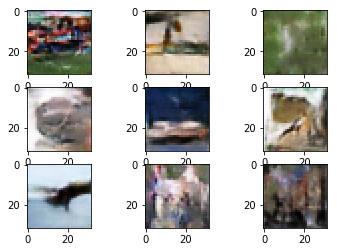

Epoch 3270/3270
64/64 [==============================] - 0s 626us/step - loss: -4.2873 - model_1_loss: -63.9650
Epoch 3270/3270
64/64 [==============================] - 0s 650us/step - loss: -23.6562 - model_1_loss: -73.1028
Epoch 3270/3270
64/64 [==============================] - 0s 652us/step - loss: -17.7060 - model_1_loss: -49.8847
Epoch 3270/3270
64/64 [==============================] - 0s 649us/step - loss: -45.1842 - model_1_loss: -95.9572
Epoch 3270/3270
64/64 [==============================] - 0s 656us/step - loss: -29.4780 - model_1_loss: -80.3144
Epoch 3270/3270
64/64 [==============================] - 0s 754us/step - loss: 74.9476


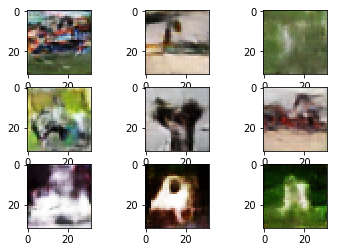

Epoch 3280/3280
64/64 [==============================] - 0s 623us/step - loss: -11.7125 - model_1_loss: -95.3671
Epoch 3280/3280
64/64 [==============================] - 0s 640us/step - loss: -10.4418 - model_1_loss: -78.1371
Epoch 3280/3280
64/64 [==============================] - 0s 646us/step - loss: -17.1461 - model_1_loss: -92.8534
Epoch 3280/3280
64/64 [==============================] - 0s 662us/step - loss: -17.5970 - model_1_loss: -89.3815
Epoch 3280/3280
64/64 [==============================] - 0s 640us/step - loss: -13.4052 - model_1_loss: -82.8006
Epoch 3280/3280
64/64 [==============================] - 0s 737us/step - loss: 60.9277


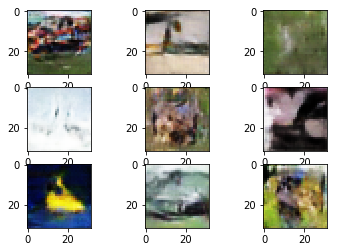

Epoch 3290/3290
64/64 [==============================] - 0s 650us/step - loss: -4.3108 - model_1_loss: -16.1348
Epoch 3290/3290
64/64 [==============================] - 0s 657us/step - loss: -25.3611 - model_1_loss: -38.7923
Epoch 3290/3290
64/64 [==============================] - 0s 646us/step - loss: -16.3760 - model_1_loss: -16.5876
Epoch 3290/3290
64/64 [==============================] - 0s 653us/step - loss: -22.2688 - model_1_loss: -69.9220
Epoch 3290/3290
64/64 [==============================] - 0s 650us/step - loss: -23.4903 - model_1_loss: -95.8210
Epoch 3290/3290
64/64 [==============================] - 0s 734us/step - loss: 92.7903


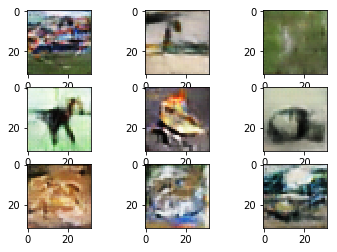

Epoch 3300/3300
64/64 [==============================] - 0s 622us/step - loss: -9.0709 - model_1_loss: -120.8578
Epoch 3300/3300
64/64 [==============================] - 0s 641us/step - loss: -30.0828 - model_1_loss: -134.5488
Epoch 3300/3300
64/64 [==============================] - 0s 644us/step - loss: -14.8401 - model_1_loss: -122.4807
Epoch 3300/3300
64/64 [==============================] - 0s 640us/step - loss: -30.5119 - model_1_loss: -140.2301
Epoch 3300/3300
64/64 [==============================] - 0s 651us/step - loss: -26.3507 - model_1_loss: -109.3760
Epoch 3300/3300
64/64 [==============================] - 0s 741us/step - loss: 128.2667


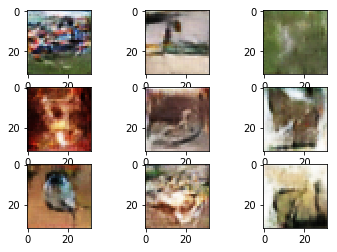

Epoch 3310/3310
64/64 [==============================] - 0s 626us/step - loss: -28.0280 - model_1_loss: -64.1863
Epoch 3310/3310
64/64 [==============================] - 0s 698us/step - loss: -3.1310 - model_1_loss: -48.7306
Epoch 3310/3310
64/64 [==============================] - 0s 685us/step - loss: -14.8541 - model_1_loss: -79.5850
Epoch 3310/3310
64/64 [==============================] - 0s 645us/step - loss: -20.4974 - model_1_loss: -98.2994
Epoch 3310/3310
64/64 [==============================] - 0s 651us/step - loss: -33.9187 - model_1_loss: -97.7271
Epoch 3310/3310
64/64 [==============================] - 0s 717us/step - loss: 109.2659


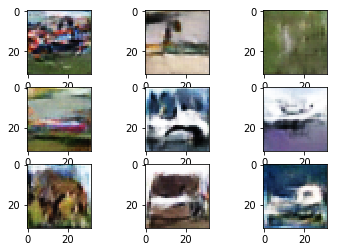

Epoch 3320/3320
64/64 [==============================] - 0s 640us/step - loss: -18.6072 - model_1_loss: -100.3835
Epoch 3320/3320
64/64 [==============================] - 0s 654us/step - loss: -23.9290 - model_1_loss: -103.8342
Epoch 3320/3320
64/64 [==============================] - 0s 644us/step - loss: -17.4482 - model_1_loss: -121.5683
Epoch 3320/3320
64/64 [==============================] - 0s 643us/step - loss: -28.7246 - model_1_loss: -119.6811
Epoch 3320/3320
64/64 [==============================] - 0s 638us/step - loss: -34.7603 - model_1_loss: -122.4226
Epoch 3320/3320
64/64 [==============================] - 0s 741us/step - loss: 102.4475


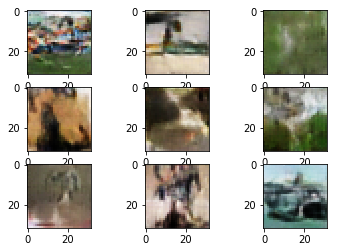

Epoch 3330/3330
64/64 [==============================] - 0s 638us/step - loss: -16.0637 - model_1_loss: -77.8853
Epoch 3330/3330
64/64 [==============================] - 0s 640us/step - loss: -33.9811 - model_1_loss: -98.0207
Epoch 3330/3330
64/64 [==============================] - 0s 648us/step - loss: -12.5352 - model_1_loss: -90.5618
Epoch 3330/3330
64/64 [==============================] - 0s 638us/step - loss: -25.0300 - model_1_loss: -111.7742
Epoch 3330/3330
64/64 [==============================] - 0s 636us/step - loss: -26.9883 - model_1_loss: -107.9415
Epoch 3330/3330
64/64 [==============================] - 0s 729us/step - loss: 90.8567


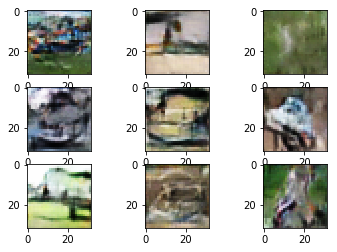

Epoch 3340/3340
64/64 [==============================] - 0s 645us/step - loss: -12.3490 - model_1_loss: -49.2694
Epoch 3340/3340
64/64 [==============================] - 0s 649us/step - loss: -13.1211 - model_1_loss: -63.9241
Epoch 3340/3340
64/64 [==============================] - 0s 661us/step - loss: -26.1652 - model_1_loss: -110.1514
Epoch 3340/3340
64/64 [==============================] - 0s 668us/step - loss: -30.5276 - model_1_loss: -107.8399
Epoch 3340/3340
64/64 [==============================] - 0s 662us/step - loss: -28.0367 - model_1_loss: -121.9167
Epoch 3340/3340
64/64 [==============================] - 0s 732us/step - loss: 146.6185


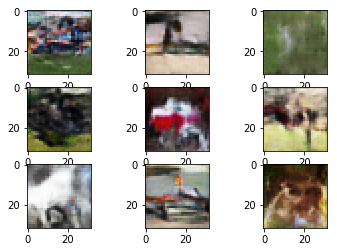

Epoch 3350/3350
64/64 [==============================] - 0s 628us/step - loss: -24.8366 - model_1_loss: -109.2424
Epoch 3350/3350
64/64 [==============================] - 0s 646us/step - loss: -24.9362 - model_1_loss: -110.7601
Epoch 3350/3350
64/64 [==============================] - 0s 646us/step - loss: -17.5982 - model_1_loss: -118.5032
Epoch 3350/3350
64/64 [==============================] - 0s 647us/step - loss: -31.1439 - model_1_loss: -125.8681
Epoch 3350/3350
64/64 [==============================] - 0s 644us/step - loss: -24.5053 - model_1_loss: -97.7639
Epoch 3350/3350
64/64 [==============================] - 0s 742us/step - loss: 94.7623


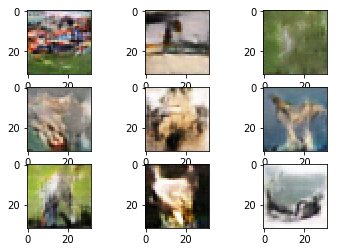

Epoch 3360/3360
64/64 [==============================] - 0s 634us/step - loss: -15.4361 - model_1_loss: -58.5622
Epoch 3360/3360
64/64 [==============================] - 0s 652us/step - loss: -25.0725 - model_1_loss: -78.9450
Epoch 3360/3360
64/64 [==============================] - 0s 665us/step - loss: -28.4850 - model_1_loss: -69.5119
Epoch 3360/3360
64/64 [==============================] - 0s 654us/step - loss: -21.8800 - model_1_loss: -90.2081
Epoch 3360/3360
64/64 [==============================] - 0s 646us/step - loss: -22.5719 - model_1_loss: -83.8518
Epoch 3360/3360
64/64 [==============================] - 0s 729us/step - loss: 88.8542


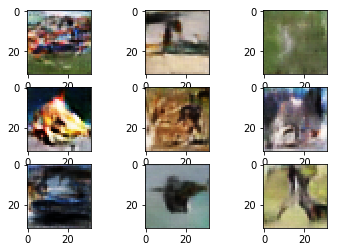

Epoch 3370/3370
64/64 [==============================] - 0s 643us/step - loss: -13.0787 - model_1_loss: -60.1087
Epoch 3370/3370
64/64 [==============================] - 0s 657us/step - loss: -28.4720 - model_1_loss: -83.6945
Epoch 3370/3370
64/64 [==============================] - 0s 655us/step - loss: -14.9939 - model_1_loss: -60.1664
Epoch 3370/3370
64/64 [==============================] - 0s 655us/step - loss: -35.0052 - model_1_loss: -75.9275
Epoch 3370/3370
64/64 [==============================] - 0s 655us/step - loss: -25.7378 - model_1_loss: -54.1226
Epoch 3370/3370
64/64 [==============================] - 0s 741us/step - loss: 67.1513


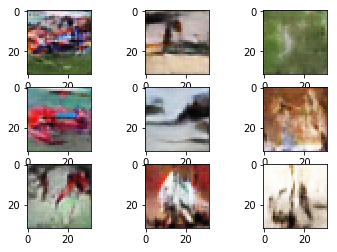

Epoch 3380/3380
64/64 [==============================] - 0s 655us/step - loss: -23.3671 - model_1_loss: -57.5457
Epoch 3380/3380
64/64 [==============================] - 0s 664us/step - loss: -21.7962 - model_1_loss: -55.4223
Epoch 3380/3380
64/64 [==============================] - 0s 659us/step - loss: -21.5457 - model_1_loss: -42.4728
Epoch 3380/3380
64/64 [==============================] - 0s 647us/step - loss: -29.4788 - model_1_loss: -66.8834
Epoch 3380/3380
64/64 [==============================] - 0s 653us/step - loss: -40.1237 - model_1_loss: -41.7320
Epoch 3380/3380
64/64 [==============================] - 0s 736us/step - loss: -7.4308


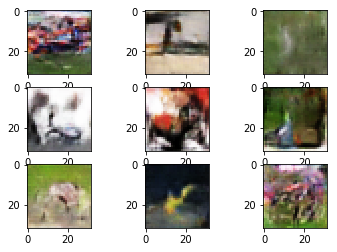

Epoch 3390/3390
64/64 [==============================] - 0s 641us/step - loss: -18.5898 - model_1_loss: -102.8490
Epoch 3390/3390
64/64 [==============================] - 0s 659us/step - loss: -21.8518 - model_1_loss: -92.1132
Epoch 3390/3390
64/64 [==============================] - 0s 660us/step - loss: -31.7782 - model_1_loss: -107.6810
Epoch 3390/3390
64/64 [==============================] - 0s 659us/step - loss: -11.0220 - model_1_loss: -108.9796
Epoch 3390/3390
64/64 [==============================] - 0s 649us/step - loss: -32.4738 - model_1_loss: -114.6395
Epoch 3390/3390
64/64 [==============================] - 0s 742us/step - loss: 85.6709


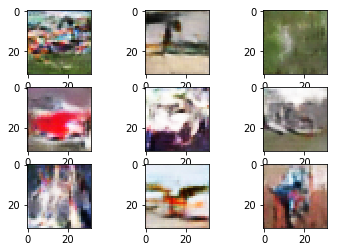

Epoch 3400/3400
64/64 [==============================] - 0s 630us/step - loss: -2.7117 - model_1_loss: -107.3611
Epoch 3400/3400
64/64 [==============================] - 0s 653us/step - loss: -21.6317 - model_1_loss: -103.2421
Epoch 3400/3400
64/64 [==============================] - 0s 640us/step - loss: -24.0042 - model_1_loss: -126.3011
Epoch 3400/3400
64/64 [==============================] - 0s 640us/step - loss: -12.9500 - model_1_loss: -104.1883
Epoch 3400/3400
64/64 [==============================] - 0s 646us/step - loss: -23.1113 - model_1_loss: -93.7847
Epoch 3400/3400
64/64 [==============================] - 0s 739us/step - loss: 101.8001


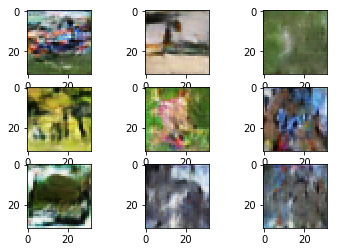

Epoch 3410/3410
64/64 [==============================] - 0s 638us/step - loss: -15.1132 - model_1_loss: -104.6479
Epoch 3410/3410
64/64 [==============================] - 0s 658us/step - loss: -33.2395 - model_1_loss: -132.8563
Epoch 3410/3410
64/64 [==============================] - 0s 648us/step - loss: -24.8531 - model_1_loss: -129.5061
Epoch 3410/3410
64/64 [==============================] - 0s 643us/step - loss: -26.6268 - model_1_loss: -132.7428
Epoch 3410/3410
64/64 [==============================] - 0s 649us/step - loss: -56.6556 - model_1_loss: -144.1578
Epoch 3410/3410
64/64 [==============================] - 0s 734us/step - loss: 133.8937


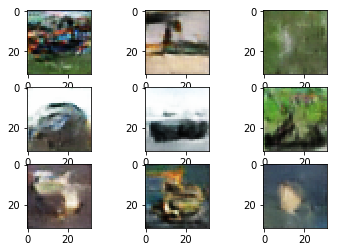

Epoch 3420/3420
64/64 [==============================] - 0s 632us/step - loss: -18.1352 - model_1_loss: -97.8867
Epoch 3420/3420
64/64 [==============================] - 0s 659us/step - loss: -27.8887 - model_1_loss: -66.4944
Epoch 3420/3420
64/64 [==============================] - 0s 656us/step - loss: -3.2574 - model_1_loss: -47.1621
Epoch 3420/3420
64/64 [==============================] - 0s 648us/step - loss: -22.5318 - model_1_loss: -71.2354
Epoch 3420/3420
64/64 [==============================] - 0s 662us/step - loss: -13.7617 - model_1_loss: -75.9614
Epoch 3420/3420
64/64 [==============================] - 0s 740us/step - loss: 72.8494


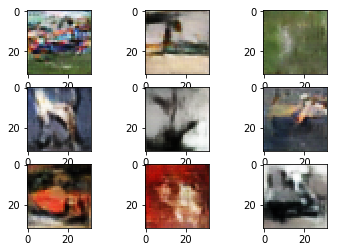

Epoch 3430/3430
64/64 [==============================] - 0s 634us/step - loss: -26.9932 - model_1_loss: -60.4567
Epoch 3430/3430
64/64 [==============================] - 0s 651us/step - loss: -24.6519 - model_1_loss: -40.5134
Epoch 3430/3430
64/64 [==============================] - 0s 648us/step - loss: -29.9090 - model_1_loss: -49.3862
Epoch 3430/3430
64/64 [==============================] - 0s 644us/step - loss: -28.2165 - model_1_loss: -63.4821
Epoch 3430/3430
64/64 [==============================] - 0s 645us/step - loss: -40.5655 - model_1_loss: -93.7412
Epoch 3430/3430
64/64 [==============================] - 0s 733us/step - loss: 105.0420


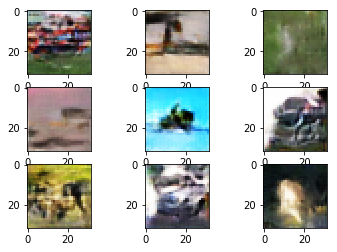

Epoch 3440/3440
64/64 [==============================] - 0s 629us/step - loss: -27.4031 - model_1_loss: -111.4781
Epoch 3440/3440
64/64 [==============================] - 0s 623us/step - loss: -23.2813 - model_1_loss: -100.7974
Epoch 3440/3440
64/64 [==============================] - 0s 650us/step - loss: -20.6606 - model_1_loss: -104.3623
Epoch 3440/3440
64/64 [==============================] - 0s 642us/step - loss: -27.3188 - model_1_loss: -101.4301
Epoch 3440/3440
64/64 [==============================] - 0s 656us/step - loss: -25.3204 - model_1_loss: -104.0538
Epoch 3440/3440
64/64 [==============================] - 0s 756us/step - loss: 116.6697


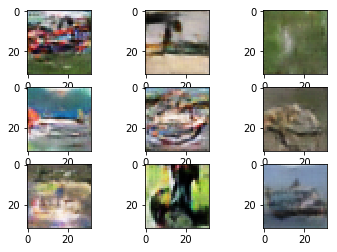

Epoch 3450/3450
64/64 [==============================] - 0s 634us/step - loss: -6.5710 - model_1_loss: -83.4717
Epoch 3450/3450
64/64 [==============================] - 0s 650us/step - loss: -21.9549 - model_1_loss: -73.7303
Epoch 3450/3450
64/64 [==============================] - 0s 645us/step - loss: -20.4697 - model_1_loss: -38.5136
Epoch 3450/3450
64/64 [==============================] - 0s 653us/step - loss: -28.7386 - model_1_loss: -70.2805
Epoch 3450/3450
64/64 [==============================] - 0s 653us/step - loss: -34.9439 - model_1_loss: -87.3817
Epoch 3450/3450
64/64 [==============================] - 0s 752us/step - loss: 54.1780


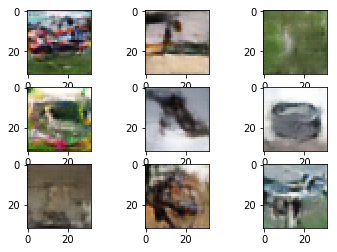

Epoch 3460/3460
64/64 [==============================] - 0s 634us/step - loss: -25.4539 - model_1_loss: -107.3967
Epoch 3460/3460
64/64 [==============================] - 0s 647us/step - loss: -28.9634 - model_1_loss: -116.5800
Epoch 3460/3460
64/64 [==============================] - 0s 636us/step - loss: -21.6672 - model_1_loss: -119.2028
Epoch 3460/3460
64/64 [==============================] - 0s 649us/step - loss: -16.2549 - model_1_loss: -114.2576
Epoch 3460/3460
64/64 [==============================] - 0s 660us/step - loss: -26.3159 - model_1_loss: -100.3822
Epoch 3460/3460
64/64 [==============================] - 0s 740us/step - loss: 99.8729


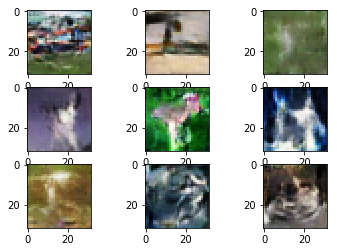

Epoch 3470/3470
64/64 [==============================] - 0s 626us/step - loss: 13.3905 - model_1_loss: -74.3996
Epoch 3470/3470
64/64 [==============================] - 0s 644us/step - loss: -17.7360 - model_1_loss: -87.9003
Epoch 3470/3470
64/64 [==============================] - 0s 653us/step - loss: -19.7334 - model_1_loss: -85.9347
Epoch 3470/3470
64/64 [==============================] - 0s 648us/step - loss: -23.1404 - model_1_loss: -108.4766
Epoch 3470/3470
64/64 [==============================] - 0s 661us/step - loss: -15.2453 - model_1_loss: -121.7607
Epoch 3470/3470
64/64 [==============================] - 0s 736us/step - loss: 140.4166


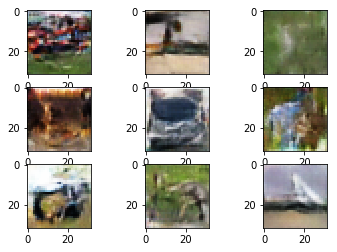

Epoch 3480/3480
64/64 [==============================] - 0s 635us/step - loss: -23.3479 - model_1_loss: -72.8246
Epoch 3480/3480
64/64 [==============================] - 0s 653us/step - loss: -8.7799 - model_1_loss: -89.1472
Epoch 3480/3480
64/64 [==============================] - 0s 650us/step - loss: -22.3454 - model_1_loss: -117.0479
Epoch 3480/3480
64/64 [==============================] - 0s 651us/step - loss: -22.9345 - model_1_loss: -94.6942
Epoch 3480/3480
64/64 [==============================] - 0s 649us/step - loss: -23.6038 - model_1_loss: -107.4970
Epoch 3480/3480
64/64 [==============================] - 0s 747us/step - loss: 85.6078


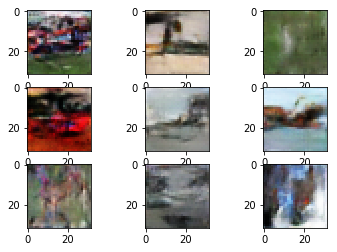

Epoch 3490/3490
64/64 [==============================] - 0s 630us/step - loss: 0.2306 - model_1_loss: -2.0798
Epoch 3490/3490
64/64 [==============================] - 0s 659us/step - loss: -9.7903 - model_1_loss: -26.4726
Epoch 3490/3490
64/64 [==============================] - 0s 660us/step - loss: -22.6186 - model_1_loss: -30.9154
Epoch 3490/3490
64/64 [==============================] - 0s 667us/step - loss: -26.5624 - model_1_loss: -56.6857
Epoch 3490/3490
64/64 [==============================] - 0s 646us/step - loss: -12.4474 - model_1_loss: -59.0624
Epoch 3490/3490
64/64 [==============================] - 0s 754us/step - loss: 62.9833


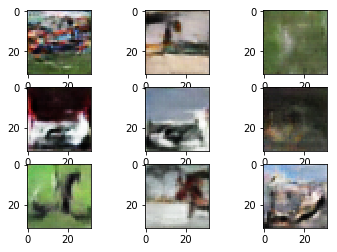

Epoch 3500/3500
64/64 [==============================] - 0s 627us/step - loss: -19.0105 - model_1_loss: -59.6478
Epoch 3500/3500
64/64 [==============================] - 0s 645us/step - loss: -15.6642 - model_1_loss: -91.2786
Epoch 3500/3500
64/64 [==============================] - 0s 653us/step - loss: -24.3027 - model_1_loss: -105.4524
Epoch 3500/3500
64/64 [==============================] - 0s 656us/step - loss: -10.6768 - model_1_loss: -87.8592
Epoch 3500/3500
64/64 [==============================] - 0s 652us/step - loss: -13.7435 - model_1_loss: -94.7721
Epoch 3500/3500
64/64 [==============================] - 0s 736us/step - loss: 103.3406


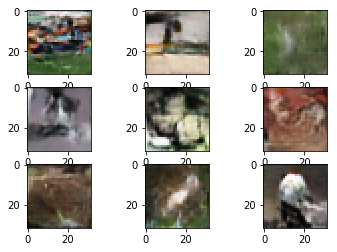

Epoch 3510/3510
64/64 [==============================] - 0s 636us/step - loss: -22.7713 - model_1_loss: -92.7218
Epoch 3510/3510
64/64 [==============================] - 0s 658us/step - loss: -23.6568 - model_1_loss: -104.0276
Epoch 3510/3510
64/64 [==============================] - 0s 642us/step - loss: -22.0346 - model_1_loss: -104.0673
Epoch 3510/3510
64/64 [==============================] - 0s 659us/step - loss: -13.3885 - model_1_loss: -95.5996
Epoch 3510/3510
64/64 [==============================] - 0s 657us/step - loss: -24.4037 - model_1_loss: -85.8060
Epoch 3510/3510
64/64 [==============================] - 0s 738us/step - loss: 94.2167


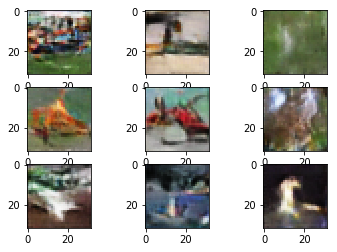

Epoch 3520/3520
64/64 [==============================] - 0s 620us/step - loss: -32.9897 - model_1_loss: -134.4859
Epoch 3520/3520
64/64 [==============================] - 0s 654us/step - loss: -32.8642 - model_1_loss: -130.1724
Epoch 3520/3520
64/64 [==============================] - 0s 647us/step - loss: -17.8109 - model_1_loss: -141.4835
Epoch 3520/3520
64/64 [==============================] - 0s 651us/step - loss: -41.3371 - model_1_loss: -148.1052
Epoch 3520/3520
64/64 [==============================] - 0s 645us/step - loss: -27.5561 - model_1_loss: -142.1255
Epoch 3520/3520
64/64 [==============================] - 0s 741us/step - loss: 152.0792


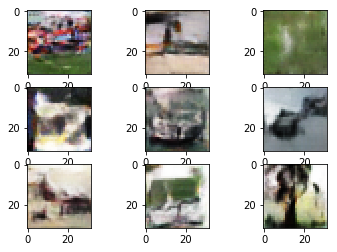

Epoch 3530/3530
64/64 [==============================] - 0s 626us/step - loss: -18.1758 - model_1_loss: -85.5433
Epoch 3530/3530
64/64 [==============================] - 0s 651us/step - loss: -29.1417 - model_1_loss: -100.2108
Epoch 3530/3530
64/64 [==============================] - 0s 654us/step - loss: -20.9309 - model_1_loss: -86.4667
Epoch 3530/3530
64/64 [==============================] - 0s 666us/step - loss: -24.8868 - model_1_loss: -90.3995
Epoch 3530/3530
64/64 [==============================] - 0s 654us/step - loss: -35.0510 - model_1_loss: -91.1890
Epoch 3530/3530
64/64 [==============================] - 0s 751us/step - loss: 85.9264


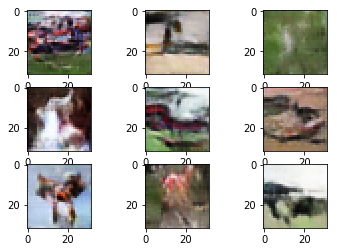

Epoch 3540/3540
64/64 [==============================] - 0s 635us/step - loss: -19.3037 - model_1_loss: -115.6504
Epoch 3540/3540
64/64 [==============================] - 0s 701us/step - loss: -23.2997 - model_1_loss: -124.1306
Epoch 3540/3540
64/64 [==============================] - 0s 659us/step - loss: -27.2258 - model_1_loss: -138.7887
Epoch 3540/3540
64/64 [==============================] - 0s 637us/step - loss: -3.4978 - model_1_loss: -102.5927
Epoch 3540/3540
64/64 [==============================] - 0s 653us/step - loss: -21.3821 - model_1_loss: -97.7452
Epoch 3540/3540
64/64 [==============================] - 0s 738us/step - loss: 124.9967


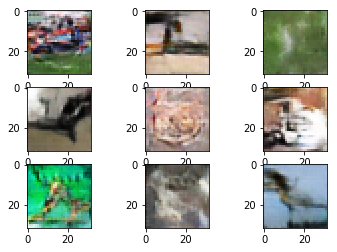

Epoch 3550/3550
64/64 [==============================] - 0s 644us/step - loss: -18.5934 - model_1_loss: -121.1308
Epoch 3550/3550
64/64 [==============================] - 0s 637us/step - loss: -8.3729 - model_1_loss: -104.3072
Epoch 3550/3550
64/64 [==============================] - 0s 647us/step - loss: -11.9197 - model_1_loss: -87.8018
Epoch 3550/3550
64/64 [==============================] - 0s 646us/step - loss: -33.6671 - model_1_loss: -40.0998
Epoch 3550/3550
64/64 [==============================] - 0s 647us/step - loss: -6.7388 - model_1_loss: -42.4283
Epoch 3550/3550
64/64 [==============================] - 0s 740us/step - loss: 58.7959


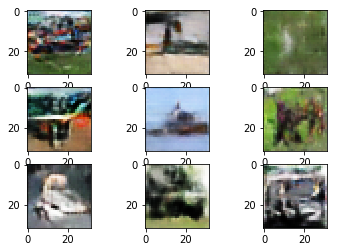

Epoch 3560/3560
64/64 [==============================] - 0s 641us/step - loss: -17.1136 - model_1_loss: -131.1779
Epoch 3560/3560
64/64 [==============================] - 0s 660us/step - loss: -14.0536 - model_1_loss: -161.8330
Epoch 3560/3560
64/64 [==============================] - 0s 637us/step - loss: -20.1647 - model_1_loss: -158.1724
Epoch 3560/3560
64/64 [==============================] - 0s 649us/step - loss: -41.6555 - model_1_loss: -171.4629
Epoch 3560/3560
64/64 [==============================] - 0s 641us/step - loss: -33.2526 - model_1_loss: -140.1722
Epoch 3560/3560
64/64 [==============================] - 0s 737us/step - loss: 101.0100


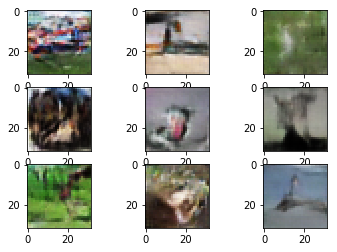

Epoch 3570/3570
64/64 [==============================] - 0s 641us/step - loss: -29.7967 - model_1_loss: -97.9461
Epoch 3570/3570
64/64 [==============================] - 0s 649us/step - loss: -11.2212 - model_1_loss: -124.6735
Epoch 3570/3570
64/64 [==============================] - 0s 638us/step - loss: -23.3487 - model_1_loss: -127.4843
Epoch 3570/3570
64/64 [==============================] - 0s 636us/step - loss: -15.2745 - model_1_loss: -124.8094
Epoch 3570/3570
64/64 [==============================] - 0s 639us/step - loss: -21.6645 - model_1_loss: -128.1134
Epoch 3570/3570
64/64 [==============================] - 0s 733us/step - loss: 108.0371


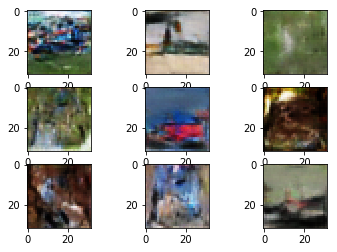

Epoch 3580/3580
64/64 [==============================] - 0s 655us/step - loss: -16.9149 - model_1_loss: -120.5284
Epoch 3580/3580
64/64 [==============================] - 0s 650us/step - loss: -12.7336 - model_1_loss: -129.7619
Epoch 3580/3580
64/64 [==============================] - 0s 652us/step - loss: -24.6376 - model_1_loss: -72.5675
Epoch 3580/3580
64/64 [==============================] - 0s 658us/step - loss: -19.0380 - model_1_loss: -72.2489
Epoch 3580/3580
64/64 [==============================] - 0s 649us/step - loss: -42.1752 - model_1_loss: -108.4138
Epoch 3580/3580
64/64 [==============================] - 0s 742us/step - loss: 88.8509


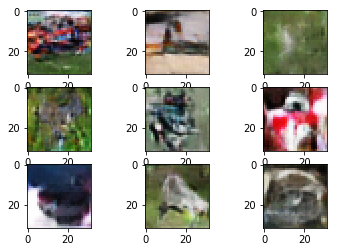

Epoch 3590/3590
64/64 [==============================] - 0s 638us/step - loss: -7.4324 - model_1_loss: -48.1103
Epoch 3590/3590
64/64 [==============================] - 0s 644us/step - loss: -20.9372 - model_1_loss: -65.8209
Epoch 3590/3590
64/64 [==============================] - 0s 657us/step - loss: -33.3786 - model_1_loss: -76.9225
Epoch 3590/3590
64/64 [==============================] - 0s 661us/step - loss: -31.8396 - model_1_loss: -93.3969
Epoch 3590/3590
64/64 [==============================] - 0s 663us/step - loss: -31.3446 - model_1_loss: -75.0016
Epoch 3590/3590
64/64 [==============================] - 0s 752us/step - loss: 71.7645


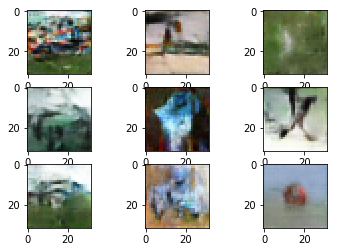

Epoch 3600/3600
64/64 [==============================] - 0s 640us/step - loss: -5.2035 - model_1_loss: -88.3972
Epoch 3600/3600
64/64 [==============================] - 0s 660us/step - loss: -17.6982 - model_1_loss: -115.9352
Epoch 3600/3600
64/64 [==============================] - 0s 660us/step - loss: -18.9478 - model_1_loss: -108.3308
Epoch 3600/3600
64/64 [==============================] - 0s 650us/step - loss: -27.7993 - model_1_loss: -115.8697
Epoch 3600/3600
64/64 [==============================] - 0s 657us/step - loss: -30.4355 - model_1_loss: -148.8754
Epoch 3600/3600
64/64 [==============================] - 0s 737us/step - loss: 163.9699


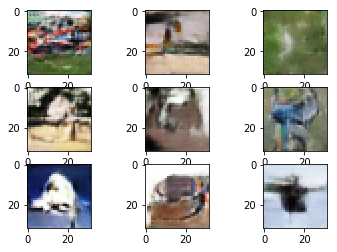

Epoch 3610/3610
64/64 [==============================] - 0s 649us/step - loss: -15.7402 - model_1_loss: -89.9927
Epoch 3610/3610
64/64 [==============================] - 0s 663us/step - loss: -10.5898 - model_1_loss: -57.6091
Epoch 3610/3610
64/64 [==============================] - 0s 661us/step - loss: -25.0517 - model_1_loss: -91.4145
Epoch 3610/3610
64/64 [==============================] - 0s 661us/step - loss: -26.2642 - model_1_loss: -62.8879
Epoch 3610/3610
64/64 [==============================] - 0s 663us/step - loss: -38.7017 - model_1_loss: -85.3054
Epoch 3610/3610
64/64 [==============================] - 0s 754us/step - loss: 85.2333


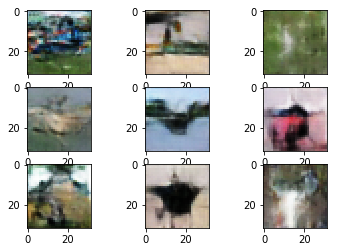

Epoch 3620/3620
64/64 [==============================] - 0s 639us/step - loss: 2.6153 - model_1_loss: 11.4262
Epoch 3620/3620
64/64 [==============================] - 0s 645us/step - loss: -28.3521 - model_1_loss: -40.5180
Epoch 3620/3620
64/64 [==============================] - 0s 664us/step - loss: -13.6045 - model_1_loss: -53.4461
Epoch 3620/3620
64/64 [==============================] - 0s 651us/step - loss: -21.8393 - model_1_loss: -56.1534
Epoch 3620/3620
64/64 [==============================] - 0s 653us/step - loss: -15.9637 - model_1_loss: -62.7721
Epoch 3620/3620
64/64 [==============================] - 0s 742us/step - loss: 80.3738


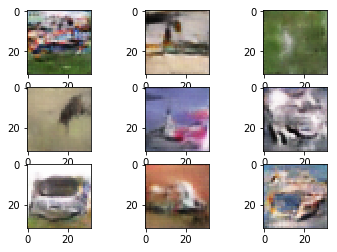

Epoch 3630/3630
64/64 [==============================] - 0s 655us/step - loss: -10.4000 - model_1_loss: -116.9581
Epoch 3630/3630
64/64 [==============================] - 0s 670us/step - loss: -24.2924 - model_1_loss: -141.7373
Epoch 3630/3630
64/64 [==============================] - 0s 659us/step - loss: -9.5690 - model_1_loss: -138.8803
Epoch 3630/3630
64/64 [==============================] - 0s 646us/step - loss: -12.0871 - model_1_loss: -120.0356
Epoch 3630/3630
64/64 [==============================] - 0s 649us/step - loss: -31.2161 - model_1_loss: -143.2259
Epoch 3630/3630
64/64 [==============================] - 0s 733us/step - loss: 123.6730


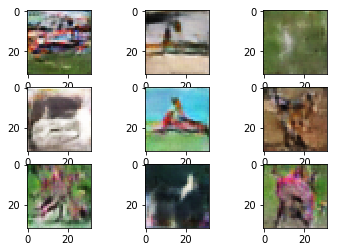

Epoch 3640/3640
64/64 [==============================] - 0s 636us/step - loss: -13.9027 - model_1_loss: -77.2856
Epoch 3640/3640
64/64 [==============================] - 0s 661us/step - loss: -29.7877 - model_1_loss: -86.9078
Epoch 3640/3640
64/64 [==============================] - 0s 658us/step - loss: -31.2839 - model_1_loss: -67.4689
Epoch 3640/3640
64/64 [==============================] - 0s 657us/step - loss: -23.8746 - model_1_loss: -60.5714
Epoch 3640/3640
64/64 [==============================] - 0s 660us/step - loss: -33.8762 - model_1_loss: -49.2445
Epoch 3640/3640
64/64 [==============================] - 0s 741us/step - loss: 57.9668


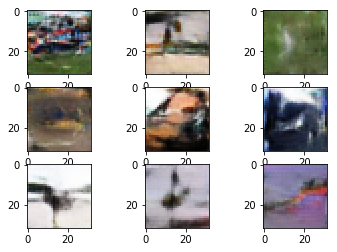

Epoch 3650/3650
64/64 [==============================] - 0s 625us/step - loss: -17.7782 - model_1_loss: -116.8910
Epoch 3650/3650
64/64 [==============================] - 0s 649us/step - loss: -28.0547 - model_1_loss: -133.6070
Epoch 3650/3650
64/64 [==============================] - 0s 642us/step - loss: -24.8053 - model_1_loss: -112.5597
Epoch 3650/3650
64/64 [==============================] - 0s 650us/step - loss: -56.5090 - model_1_loss: -106.2315
Epoch 3650/3650
64/64 [==============================] - 0s 650us/step - loss: -25.2602 - model_1_loss: -125.2036
Epoch 3650/3650
64/64 [==============================] - 0s 734us/step - loss: 86.7391


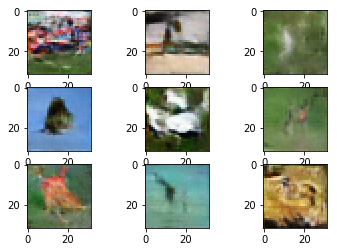

Epoch 3660/3660
64/64 [==============================] - 0s 626us/step - loss: -16.2704 - model_1_loss: -120.4192
Epoch 3660/3660
64/64 [==============================] - 0s 648us/step - loss: -18.3979 - model_1_loss: -127.2496
Epoch 3660/3660
64/64 [==============================] - 0s 650us/step - loss: -27.6801 - model_1_loss: -122.4234
Epoch 3660/3660
64/64 [==============================] - 0s 670us/step - loss: -23.5466 - model_1_loss: -145.1173
Epoch 3660/3660
64/64 [==============================] - 0s 639us/step - loss: -23.6694 - model_1_loss: -128.4973
Epoch 3660/3660
64/64 [==============================] - 0s 731us/step - loss: 114.9134


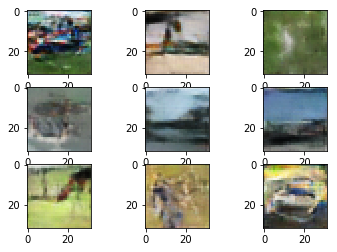

Epoch 3670/3670
64/64 [==============================] - 0s 623us/step - loss: -21.4369 - model_1_loss: -83.4430
Epoch 3670/3670
64/64 [==============================] - 0s 639us/step - loss: -29.7289 - model_1_loss: -97.0939
Epoch 3670/3670
64/64 [==============================] - 0s 650us/step - loss: -29.3621 - model_1_loss: -120.1951
Epoch 3670/3670
64/64 [==============================] - 0s 649us/step - loss: -17.4532 - model_1_loss: -93.2099
Epoch 3670/3670
64/64 [==============================] - 0s 657us/step - loss: -38.5643 - model_1_loss: -100.6204
Epoch 3670/3670
64/64 [==============================] - 0s 744us/step - loss: 89.0954


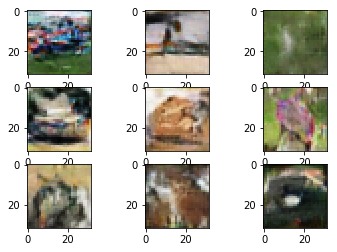

Epoch 3680/3680
64/64 [==============================] - 0s 636us/step - loss: -29.3931 - model_1_loss: -114.2545
Epoch 3680/3680
64/64 [==============================] - 0s 639us/step - loss: -17.8644 - model_1_loss: -96.8551
Epoch 3680/3680
64/64 [==============================] - 0s 650us/step - loss: -16.2262 - model_1_loss: -133.2098
Epoch 3680/3680
64/64 [==============================] - 0s 666us/step - loss: -31.6566 - model_1_loss: -115.0548
Epoch 3680/3680
64/64 [==============================] - 0s 649us/step - loss: -54.6546 - model_1_loss: -121.6114
Epoch 3680/3680
64/64 [==============================] - 0s 723us/step - loss: 75.9497


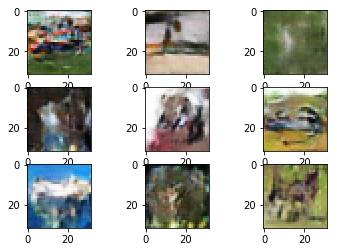

Epoch 3690/3690
64/64 [==============================] - 0s 623us/step - loss: -13.4069 - model_1_loss: -95.5815
Epoch 3690/3690
64/64 [==============================] - 0s 649us/step - loss: -26.1357 - model_1_loss: -93.4859
Epoch 3690/3690
64/64 [==============================] - 0s 646us/step - loss: -16.2052 - model_1_loss: -94.9864
Epoch 3690/3690
64/64 [==============================] - 0s 643us/step - loss: -19.5011 - model_1_loss: -123.6712
Epoch 3690/3690
64/64 [==============================] - 0s 647us/step - loss: -23.2189 - model_1_loss: -123.6216
Epoch 3690/3690
64/64 [==============================] - 0s 742us/step - loss: 134.4987


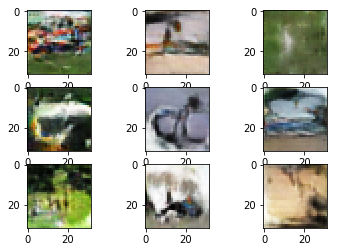

Epoch 3700/3700
64/64 [==============================] - 0s 650us/step - loss: -29.5545 - model_1_loss: -99.6535
Epoch 3700/3700
64/64 [==============================] - 0s 675us/step - loss: -11.2916 - model_1_loss: -114.2633
Epoch 3700/3700
64/64 [==============================] - 0s 663us/step - loss: -27.9364 - model_1_loss: -105.7902
Epoch 3700/3700
64/64 [==============================] - 0s 671us/step - loss: -23.3265 - model_1_loss: -134.1025
Epoch 3700/3700
64/64 [==============================] - 0s 665us/step - loss: -36.2461 - model_1_loss: -150.7141
Epoch 3700/3700
64/64 [==============================] - 0s 737us/step - loss: 136.1354


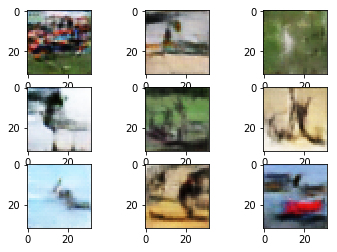

Epoch 3710/3710
64/64 [==============================] - 0s 626us/step - loss: -15.4893 - model_1_loss: -101.6669
Epoch 3710/3710
64/64 [==============================] - 0s 659us/step - loss: -24.0844 - model_1_loss: -81.9153
Epoch 3710/3710
64/64 [==============================] - 0s 647us/step - loss: -16.2438 - model_1_loss: -68.7232
Epoch 3710/3710
64/64 [==============================] - 0s 665us/step - loss: -33.1078 - model_1_loss: -55.5185
Epoch 3710/3710
64/64 [==============================] - 0s 671us/step - loss: -35.3464 - model_1_loss: -63.8280
Epoch 3710/3710
64/64 [==============================] - 0s 745us/step - loss: 42.8303


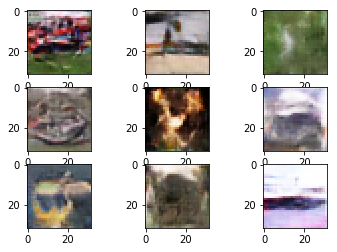

Epoch 3720/3720
64/64 [==============================] - 0s 641us/step - loss: -19.8207 - model_1_loss: -69.5326
Epoch 3720/3720
64/64 [==============================] - 0s 649us/step - loss: -13.5385 - model_1_loss: -58.6006
Epoch 3720/3720
64/64 [==============================] - 0s 672us/step - loss: -32.4369 - model_1_loss: -102.3081
Epoch 3720/3720
64/64 [==============================] - 0s 661us/step - loss: -25.1274 - model_1_loss: -94.0962
Epoch 3720/3720
64/64 [==============================] - 0s 659us/step - loss: -21.3986 - model_1_loss: -85.0629
Epoch 3720/3720
64/64 [==============================] - 0s 749us/step - loss: 81.5349


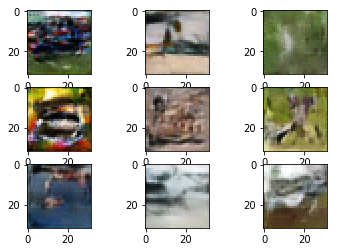

Epoch 3730/3730
64/64 [==============================] - 0s 640us/step - loss: -12.9043 - model_1_loss: -78.9994
Epoch 3730/3730
64/64 [==============================] - 0s 658us/step - loss: -17.0942 - model_1_loss: -109.5235
Epoch 3730/3730
64/64 [==============================] - 0s 641us/step - loss: -20.9915 - model_1_loss: -108.1315
Epoch 3730/3730
64/64 [==============================] - 0s 648us/step - loss: -14.9303 - model_1_loss: -108.9263
Epoch 3730/3730
64/64 [==============================] - 0s 653us/step - loss: -35.9031 - model_1_loss: -115.7950
Epoch 3730/3730
64/64 [==============================] - 0s 730us/step - loss: 102.7219


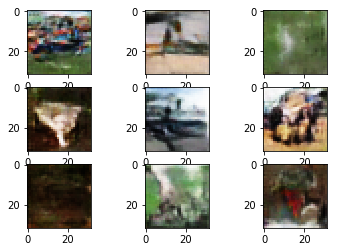

Epoch 3740/3740
64/64 [==============================] - 0s 648us/step - loss: -14.3292 - model_1_loss: -48.0159
Epoch 3740/3740
64/64 [==============================] - 0s 653us/step - loss: -23.2637 - model_1_loss: -66.7887
Epoch 3740/3740
64/64 [==============================] - 0s 657us/step - loss: -38.1002 - model_1_loss: -78.4243
Epoch 3740/3740
64/64 [==============================] - 0s 664us/step - loss: -49.5841 - model_1_loss: -81.4913
Epoch 3740/3740
64/64 [==============================] - 0s 656us/step - loss: -18.9268 - model_1_loss: -74.5245
Epoch 3740/3740
64/64 [==============================] - 0s 754us/step - loss: 102.2239


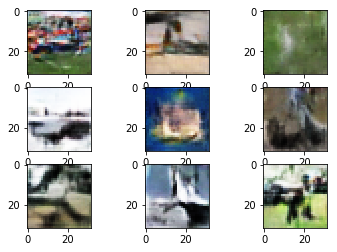

Epoch 3750/3750
64/64 [==============================] - 0s 636us/step - loss: -14.9784 - model_1_loss: -114.7572
Epoch 3750/3750
64/64 [==============================] - 0s 651us/step - loss: -28.0338 - model_1_loss: -99.9148
Epoch 3750/3750
64/64 [==============================] - 0s 657us/step - loss: -16.1662 - model_1_loss: -105.5573
Epoch 3750/3750
64/64 [==============================] - 0s 649us/step - loss: -23.0933 - model_1_loss: -119.0277
Epoch 3750/3750
64/64 [==============================] - 0s 654us/step - loss: -25.2440 - model_1_loss: -90.2214
Epoch 3750/3750
64/64 [==============================] - 0s 739us/step - loss: 100.1235


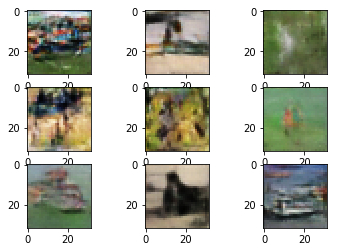

Epoch 3760/3760
64/64 [==============================] - 0s 646us/step - loss: -24.3811 - model_1_loss: -132.0106
Epoch 3760/3760
64/64 [==============================] - 0s 662us/step - loss: -38.1282 - model_1_loss: -168.6430
Epoch 3760/3760
64/64 [==============================] - 0s 651us/step - loss: -19.9429 - model_1_loss: -143.9967
Epoch 3760/3760
64/64 [==============================] - 0s 648us/step - loss: -47.2216 - model_1_loss: -120.3761
Epoch 3760/3760
64/64 [==============================] - 0s 638us/step - loss: -38.4542 - model_1_loss: -152.3624
Epoch 3760/3760
64/64 [==============================] - 0s 722us/step - loss: 131.9627


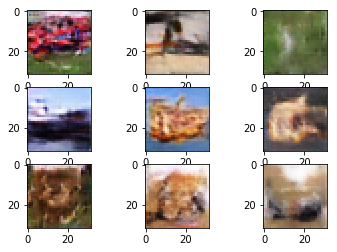

Epoch 3770/3770
64/64 [==============================] - 0s 619us/step - loss: -22.6444 - model_1_loss: -76.7143
Epoch 3770/3770
64/64 [==============================] - 0s 645us/step - loss: -21.0648 - model_1_loss: -79.2529
Epoch 3770/3770
64/64 [==============================] - 0s 635us/step - loss: -20.4935 - model_1_loss: -86.2018
Epoch 3770/3770
64/64 [==============================] - 0s 647us/step - loss: -29.5496 - model_1_loss: -74.3883
Epoch 3770/3770
64/64 [==============================] - 0s 644us/step - loss: -33.3028 - model_1_loss: -131.6925
Epoch 3770/3770
64/64 [==============================] - 0s 722us/step - loss: 114.4633


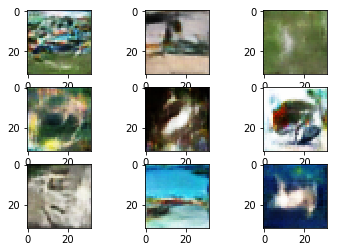

Epoch 3780/3780
64/64 [==============================] - 0s 630us/step - loss: -18.5435 - model_1_loss: -42.2423
Epoch 3780/3780
64/64 [==============================] - 0s 635us/step - loss: -19.6800 - model_1_loss: -50.4332
Epoch 3780/3780
64/64 [==============================] - 0s 638us/step - loss: -7.3204 - model_1_loss: -73.7332
Epoch 3780/3780
64/64 [==============================] - 0s 646us/step - loss: -19.6333 - model_1_loss: -92.9158
Epoch 3780/3780
64/64 [==============================] - 0s 653us/step - loss: -36.0295 - model_1_loss: -92.2976
Epoch 3780/3780
64/64 [==============================] - 0s 743us/step - loss: 96.4015


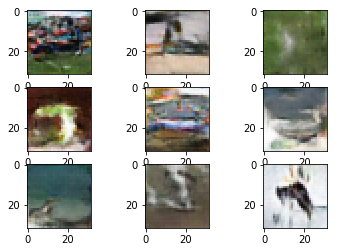

Epoch 3790/3790
64/64 [==============================] - 0s 636us/step - loss: -10.9186 - model_1_loss: -86.7877
Epoch 3790/3790
64/64 [==============================] - 0s 668us/step - loss: -15.5280 - model_1_loss: -123.5441
Epoch 3790/3790
64/64 [==============================] - 0s 657us/step - loss: -31.9517 - model_1_loss: -132.3160
Epoch 3790/3790
64/64 [==============================] - 0s 651us/step - loss: -32.0470 - model_1_loss: -143.2119
Epoch 3790/3790
64/64 [==============================] - 0s 648us/step - loss: -26.4888 - model_1_loss: -147.3529
Epoch 3790/3790
64/64 [==============================] - 0s 735us/step - loss: 104.5046


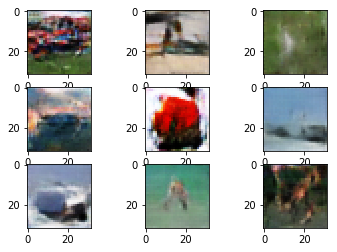

Epoch 3800/3800
64/64 [==============================] - 0s 638us/step - loss: -18.2195 - model_1_loss: -123.1199
Epoch 3800/3800
64/64 [==============================] - 0s 642us/step - loss: -31.9186 - model_1_loss: -128.5981
Epoch 3800/3800
64/64 [==============================] - 0s 660us/step - loss: -19.3002 - model_1_loss: -92.3641
Epoch 3800/3800
64/64 [==============================] - 0s 654us/step - loss: -29.9430 - model_1_loss: -70.6118
Epoch 3800/3800
64/64 [==============================] - 0s 655us/step - loss: -22.6788 - model_1_loss: -66.3467
Epoch 3800/3800
64/64 [==============================] - 0s 747us/step - loss: 32.7585


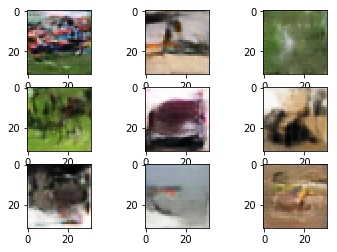

Epoch 3810/3810
64/64 [==============================] - 0s 639us/step - loss: -14.1612 - model_1_loss: -105.9112
Epoch 3810/3810
64/64 [==============================] - 0s 653us/step - loss: -20.0961 - model_1_loss: -121.4644
Epoch 3810/3810
64/64 [==============================] - 0s 657us/step - loss: -20.5869 - model_1_loss: -119.1860
Epoch 3810/3810
64/64 [==============================] - 0s 653us/step - loss: -24.6897 - model_1_loss: -116.7191
Epoch 3810/3810
64/64 [==============================] - 0s 662us/step - loss: -37.5954 - model_1_loss: -97.4087
Epoch 3810/3810
64/64 [==============================] - 0s 730us/step - loss: 94.8067


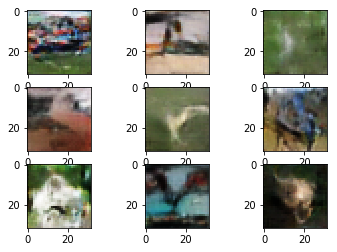

Epoch 3820/3820
64/64 [==============================] - 0s 635us/step - loss: -17.4377 - model_1_loss: -135.2670
Epoch 3820/3820
64/64 [==============================] - 0s 655us/step - loss: -28.7841 - model_1_loss: -142.2467
Epoch 3820/3820
64/64 [==============================] - 0s 664us/step - loss: -21.5408 - model_1_loss: -124.0731
Epoch 3820/3820
64/64 [==============================] - 0s 659us/step - loss: -30.6931 - model_1_loss: -132.5308
Epoch 3820/3820
64/64 [==============================] - 0s 652us/step - loss: -22.9865 - model_1_loss: -122.9653
Epoch 3820/3820
64/64 [==============================] - 0s 752us/step - loss: 124.6444


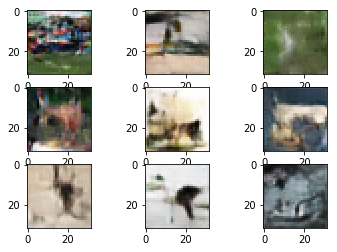

Epoch 3830/3830
64/64 [==============================] - 0s 627us/step - loss: -12.2109 - model_1_loss: -55.3939
Epoch 3830/3830
64/64 [==============================] - 0s 650us/step - loss: -28.6155 - model_1_loss: -81.3458
Epoch 3830/3830
64/64 [==============================] - 0s 646us/step - loss: -44.5163 - model_1_loss: -83.7697
Epoch 3830/3830
64/64 [==============================] - 0s 645us/step - loss: -42.0297 - model_1_loss: -41.5575
Epoch 3830/3830
64/64 [==============================] - 0s 669us/step - loss: -33.1386 - model_1_loss: -34.2590
Epoch 3830/3830
64/64 [==============================] - 0s 746us/step - loss: 9.6244


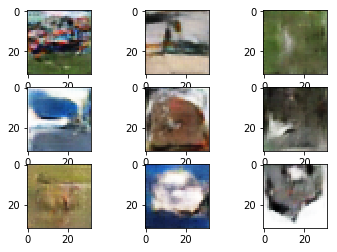

Epoch 3840/3840
64/64 [==============================] - 0s 624us/step - loss: -24.1855 - model_1_loss: -80.3629
Epoch 3840/3840
64/64 [==============================] - 0s 657us/step - loss: -6.2725 - model_1_loss: -105.4530
Epoch 3840/3840
64/64 [==============================] - 0s 659us/step - loss: -15.9049 - model_1_loss: -125.4702
Epoch 3840/3840
64/64 [==============================] - 0s 669us/step - loss: -14.0003 - model_1_loss: -101.7862
Epoch 3840/3840
64/64 [==============================] - 0s 646us/step - loss: -22.0930 - model_1_loss: -135.8286
Epoch 3840/3840
64/64 [==============================] - 0s 733us/step - loss: 108.9082


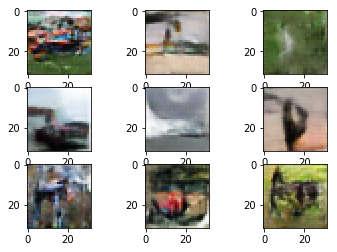

Epoch 3850/3850
64/64 [==============================] - 0s 643us/step - loss: -15.8126 - model_1_loss: -73.3172
Epoch 3850/3850
64/64 [==============================] - 0s 649us/step - loss: -23.6831 - model_1_loss: -121.4187
Epoch 3850/3850
64/64 [==============================] - 0s 654us/step - loss: -29.6896 - model_1_loss: -120.2670
Epoch 3850/3850
64/64 [==============================] - 0s 655us/step - loss: -25.2930 - model_1_loss: -145.3286
Epoch 3850/3850
64/64 [==============================] - 0s 652us/step - loss: -10.0200 - model_1_loss: -118.5217
Epoch 3850/3850
64/64 [==============================] - 0s 747us/step - loss: 137.9607


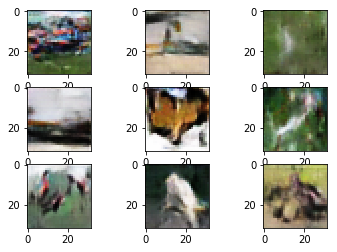

Epoch 3860/3860
64/64 [==============================] - 0s 627us/step - loss: -9.1364 - model_1_loss: -80.9631
Epoch 3860/3860
64/64 [==============================] - 0s 650us/step - loss: -39.7072 - model_1_loss: -107.3548
Epoch 3860/3860
64/64 [==============================] - 0s 655us/step - loss: -15.6006 - model_1_loss: -107.8765
Epoch 3860/3860
64/64 [==============================] - 0s 664us/step - loss: -19.0287 - model_1_loss: -105.4123
Epoch 3860/3860
64/64 [==============================] - 0s 656us/step - loss: -37.4791 - model_1_loss: -109.8491
Epoch 3860/3860
64/64 [==============================] - 0s 739us/step - loss: 79.0365


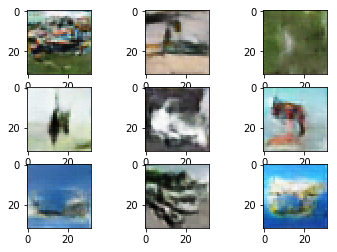

Epoch 3870/3870
64/64 [==============================] - 0s 623us/step - loss: -51.3762 - model_1_loss: -99.0919
Epoch 3870/3870
64/64 [==============================] - 0s 653us/step - loss: -38.2450 - model_1_loss: -98.4288
Epoch 3870/3870
64/64 [==============================] - 0s 650us/step - loss: -33.1039 - model_1_loss: -100.3072
Epoch 3870/3870
64/64 [==============================] - 0s 647us/step - loss: -11.7972 - model_1_loss: -113.5859
Epoch 3870/3870
64/64 [==============================] - 0s 638us/step - loss: -11.6806 - model_1_loss: -100.4970
Epoch 3870/3870
64/64 [==============================] - 0s 796us/step - loss: 71.9210


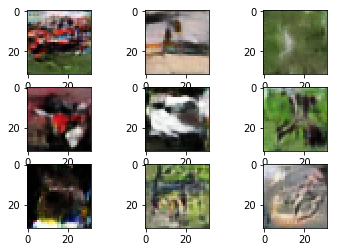

Epoch 3880/3880
64/64 [==============================] - 0s 633us/step - loss: -27.6058 - model_1_loss: -54.9906
Epoch 3880/3880
64/64 [==============================] - 0s 640us/step - loss: -18.7882 - model_1_loss: -90.9439
Epoch 3880/3880
64/64 [==============================] - 0s 642us/step - loss: -20.3496 - model_1_loss: -82.8389
Epoch 3880/3880
64/64 [==============================] - 0s 653us/step - loss: -17.2809 - model_1_loss: -63.9977
Epoch 3880/3880
64/64 [==============================] - 0s 680us/step - loss: -27.2905 - model_1_loss: -115.4545
Epoch 3880/3880
64/64 [==============================] - 0s 739us/step - loss: 111.8824


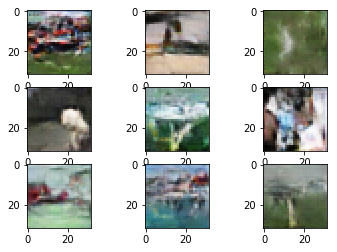

Epoch 3890/3890
64/64 [==============================] - 0s 627us/step - loss: -21.0644 - model_1_loss: -133.3438
Epoch 3890/3890
64/64 [==============================] - 0s 636us/step - loss: -51.2396 - model_1_loss: -136.2897
Epoch 3890/3890
64/64 [==============================] - 0s 657us/step - loss: -9.2027 - model_1_loss: -127.5567
Epoch 3890/3890
64/64 [==============================] - 0s 644us/step - loss: -17.5398 - model_1_loss: -75.2724
Epoch 3890/3890
64/64 [==============================] - 0s 648us/step - loss: -28.4051 - model_1_loss: -89.9793
Epoch 3890/3890
64/64 [==============================] - 0s 741us/step - loss: 108.6240


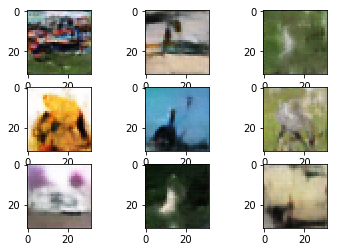

Epoch 3900/3900
64/64 [==============================] - 0s 633us/step - loss: -16.6749 - model_1_loss: -21.5580
Epoch 3900/3900
64/64 [==============================] - 0s 661us/step - loss: -20.9442 - model_1_loss: -17.8257
Epoch 3900/3900
64/64 [==============================] - 0s 648us/step - loss: -18.6630 - model_1_loss: -33.9029
Epoch 3900/3900
64/64 [==============================] - 0s 657us/step - loss: -26.2686 - model_1_loss: -61.1305
Epoch 3900/3900
64/64 [==============================] - 0s 650us/step - loss: -19.8469 - model_1_loss: -50.3321
Epoch 3900/3900
64/64 [==============================] - 0s 737us/step - loss: 72.9112


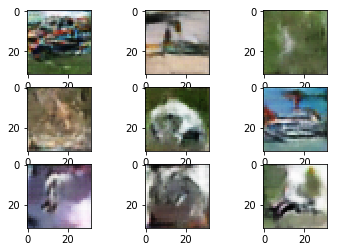

Epoch 3910/3910
64/64 [==============================] - 0s 640us/step - loss: -5.5926 - model_1_loss: -78.4123
Epoch 3910/3910
64/64 [==============================] - 0s 641us/step - loss: -6.4270 - model_1_loss: -106.3611
Epoch 3910/3910
64/64 [==============================] - 0s 648us/step - loss: -16.3905 - model_1_loss: -104.4410
Epoch 3910/3910
64/64 [==============================] - 0s 637us/step - loss: -29.5376 - model_1_loss: -124.1096
Epoch 3910/3910
64/64 [==============================] - 0s 645us/step - loss: -14.8863 - model_1_loss: -103.6413
Epoch 3910/3910
64/64 [==============================] - 0s 745us/step - loss: 102.6348


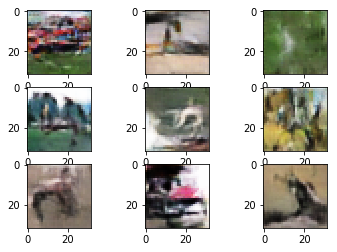

Epoch 3920/3920
64/64 [==============================] - 0s 636us/step - loss: -17.9176 - model_1_loss: -73.3453
Epoch 3920/3920
64/64 [==============================] - 0s 658us/step - loss: -31.4672 - model_1_loss: -79.0141
Epoch 3920/3920
64/64 [==============================] - 0s 654us/step - loss: -14.0202 - model_1_loss: -79.9271
Epoch 3920/3920
64/64 [==============================] - 0s 669us/step - loss: -37.7838 - model_1_loss: -93.2672
Epoch 3920/3920
64/64 [==============================] - 0s 667us/step - loss: -30.8137 - model_1_loss: -97.6043
Epoch 3920/3920
64/64 [==============================] - 0s 750us/step - loss: 89.9989


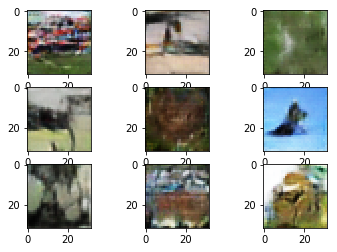

Epoch 3930/3930
64/64 [==============================] - 0s 639us/step - loss: -7.7305 - model_1_loss: -124.3990
Epoch 3930/3930
64/64 [==============================] - 0s 646us/step - loss: -13.6868 - model_1_loss: -129.3699
Epoch 3930/3930
64/64 [==============================] - 0s 649us/step - loss: -30.2323 - model_1_loss: -136.1529
Epoch 3930/3930
64/64 [==============================] - 0s 647us/step - loss: -29.9171 - model_1_loss: -115.2459
Epoch 3930/3930
64/64 [==============================] - 0s 643us/step - loss: -33.1611 - model_1_loss: -87.1598
Epoch 3930/3930
64/64 [==============================] - 0s 744us/step - loss: 72.1340


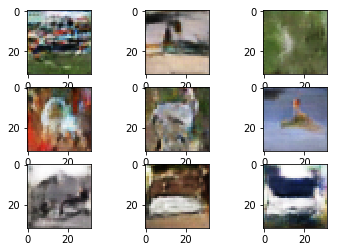

Epoch 3940/3940
64/64 [==============================] - 0s 623us/step - loss: -17.2355 - model_1_loss: -94.4507
Epoch 3940/3940
64/64 [==============================] - 0s 656us/step - loss: -13.8206 - model_1_loss: -113.6279
Epoch 3940/3940
64/64 [==============================] - 0s 653us/step - loss: -12.0920 - model_1_loss: -131.1504
Epoch 3940/3940
64/64 [==============================] - 0s 651us/step - loss: -27.8887 - model_1_loss: -142.2347
Epoch 3940/3940
64/64 [==============================] - 0s 656us/step - loss: -30.4744 - model_1_loss: -167.3703
Epoch 3940/3940
64/64 [==============================] - 0s 783us/step - loss: 152.3180


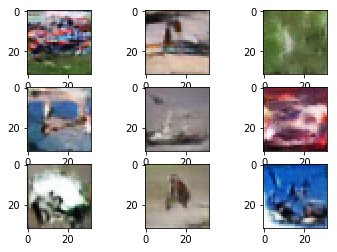

Epoch 3950/3950
64/64 [==============================] - 0s 627us/step - loss: -19.7750 - model_1_loss: -137.8708
Epoch 3950/3950
64/64 [==============================] - 0s 669us/step - loss: -22.6081 - model_1_loss: -129.0177
Epoch 3950/3950
64/64 [==============================] - 0s 670us/step - loss: -23.4008 - model_1_loss: -110.5431
Epoch 3950/3950
64/64 [==============================] - 0s 671us/step - loss: -16.7935 - model_1_loss: -95.4017
Epoch 3950/3950
64/64 [==============================] - 0s 663us/step - loss: -22.1279 - model_1_loss: -101.8712
Epoch 3950/3950
64/64 [==============================] - 0s 750us/step - loss: 94.7242


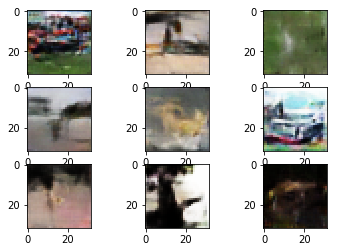

Epoch 3960/3960
64/64 [==============================] - 0s 634us/step - loss: -16.5925 - model_1_loss: -112.8606
Epoch 3960/3960
64/64 [==============================] - 0s 651us/step - loss: -14.3596 - model_1_loss: -100.5601
Epoch 3960/3960
64/64 [==============================] - 0s 662us/step - loss: -24.8929 - model_1_loss: -111.8302
Epoch 3960/3960
64/64 [==============================] - 0s 653us/step - loss: -37.0003 - model_1_loss: -121.7930
Epoch 3960/3960
64/64 [==============================] - 0s 654us/step - loss: -34.5520 - model_1_loss: -110.8508
Epoch 3960/3960
64/64 [==============================] - 0s 741us/step - loss: 106.4532


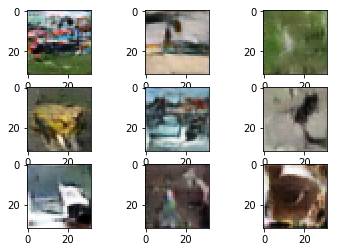

Epoch 3970/3970
64/64 [==============================] - 0s 637us/step - loss: -19.6554 - model_1_loss: -105.5039
Epoch 3970/3970
64/64 [==============================] - 0s 661us/step - loss: -16.2320 - model_1_loss: -92.9510
Epoch 3970/3970
64/64 [==============================] - 0s 659us/step - loss: -29.6460 - model_1_loss: -76.0765
Epoch 3970/3970
64/64 [==============================] - 0s 664us/step - loss: -26.6350 - model_1_loss: -95.3280
Epoch 3970/3970
64/64 [==============================] - 0s 644us/step - loss: -21.6740 - model_1_loss: -63.0780
Epoch 3970/3970
64/64 [==============================] - 0s 755us/step - loss: 90.5913


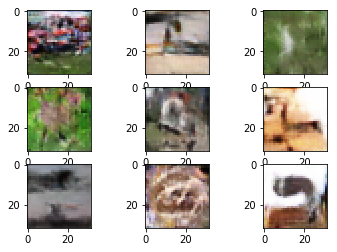

Epoch 3980/3980
64/64 [==============================] - 0s 669us/step - loss: -24.5116 - model_1_loss: -70.9071
Epoch 3980/3980
64/64 [==============================] - 0s 660us/step - loss: -9.4876 - model_1_loss: -67.3023
Epoch 3980/3980
64/64 [==============================] - 0s 659us/step - loss: -9.9786 - model_1_loss: -71.6699
Epoch 3980/3980
64/64 [==============================] - 0s 647us/step - loss: -24.3173 - model_1_loss: -73.3463
Epoch 3980/3980
64/64 [==============================] - 0s 651us/step - loss: -31.5857 - model_1_loss: -86.2429
Epoch 3980/3980
64/64 [==============================] - 0s 738us/step - loss: 110.6226


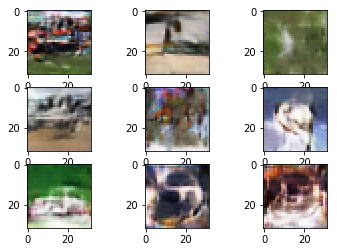

Epoch 3990/3990
64/64 [==============================] - 0s 642us/step - loss: -19.7143 - model_1_loss: -75.4904
Epoch 3990/3990
64/64 [==============================] - 0s 649us/step - loss: -8.8852 - model_1_loss: -85.8489
Epoch 3990/3990
64/64 [==============================] - 0s 655us/step - loss: -20.5292 - model_1_loss: -93.5832
Epoch 3990/3990
64/64 [==============================] - 0s 666us/step - loss: -23.5451 - model_1_loss: -102.3515
Epoch 3990/3990
64/64 [==============================] - 0s 649us/step - loss: -20.0877 - model_1_loss: -101.4920
Epoch 3990/3990
64/64 [==============================] - 0s 750us/step - loss: 114.8779


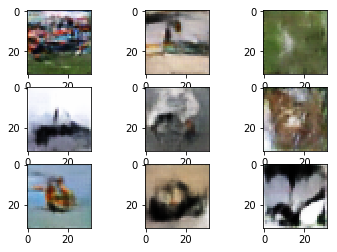

Epoch 4000/4000
64/64 [==============================] - 0s 627us/step - loss: -26.1668 - model_1_loss: -94.6203
Epoch 4000/4000
64/64 [==============================] - 0s 639us/step - loss: -16.7310 - model_1_loss: -86.7985
Epoch 4000/4000
64/64 [==============================] - 0s 671us/step - loss: -18.6980 - model_1_loss: -94.7580
Epoch 4000/4000
64/64 [==============================] - 0s 644us/step - loss: -39.6283 - model_1_loss: -90.9813
Epoch 4000/4000
64/64 [==============================] - 0s 646us/step - loss: -30.1616 - model_1_loss: -52.2585
Epoch 4000/4000
64/64 [==============================] - 0s 732us/step - loss: 49.1933


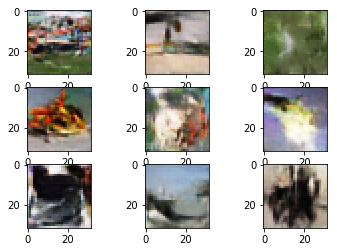

Epoch 4010/4010
64/64 [==============================] - 0s 600us/step - loss: -25.8623 - model_1_loss: -65.9190
Epoch 4010/4010
64/64 [==============================] - 0s 614us/step - loss: -30.4333 - model_1_loss: -64.1643
Epoch 4010/4010
64/64 [==============================] - 0s 606us/step - loss: -25.9980 - model_1_loss: -70.3721
Epoch 4010/4010
64/64 [==============================] - 0s 607us/step - loss: -20.4729 - model_1_loss: -90.7723
Epoch 4010/4010
64/64 [==============================] - 0s 595us/step - loss: -22.0770 - model_1_loss: -90.0184
Epoch 4010/4010
64/64 [==============================] - 0s 697us/step - loss: 93.8654


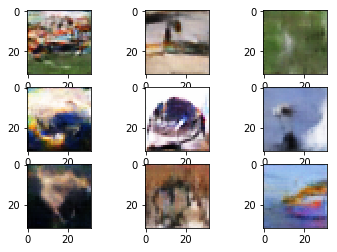

Epoch 4020/4020
64/64 [==============================] - 0s 590us/step - loss: -18.0125 - model_1_loss: -150.2140
Epoch 4020/4020
64/64 [==============================] - 0s 609us/step - loss: -20.5745 - model_1_loss: -154.5473
Epoch 4020/4020
64/64 [==============================] - 0s 604us/step - loss: -38.8551 - model_1_loss: -158.1596
Epoch 4020/4020
64/64 [==============================] - 0s 622us/step - loss: -16.5803 - model_1_loss: -134.8939
Epoch 4020/4020
64/64 [==============================] - 0s 617us/step - loss: -28.6096 - model_1_loss: -161.8592
Epoch 4020/4020
64/64 [==============================] - 0s 699us/step - loss: 159.0592


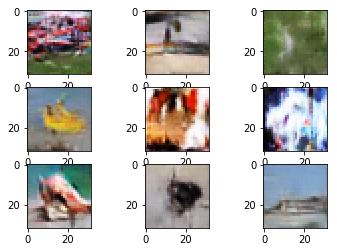

Epoch 4030/4030
64/64 [==============================] - 0s 606us/step - loss: -21.7955 - model_1_loss: -66.2464
Epoch 4030/4030
64/64 [==============================] - 0s 615us/step - loss: -23.5708 - model_1_loss: -79.7523
Epoch 4030/4030
64/64 [==============================] - 0s 623us/step - loss: -33.3948 - model_1_loss: -75.7657
Epoch 4030/4030
64/64 [==============================] - 0s 608us/step - loss: -17.8356 - model_1_loss: -62.0395
Epoch 4030/4030
64/64 [==============================] - 0s 614us/step - loss: -31.8488 - model_1_loss: -92.0450
Epoch 4030/4030
64/64 [==============================] - 0s 684us/step - loss: 112.4628


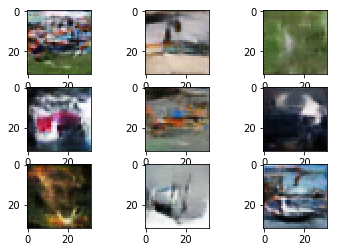

Epoch 4040/4040
64/64 [==============================] - 0s 595us/step - loss: 10.5305 - model_1_loss: -109.1211
Epoch 4040/4040
64/64 [==============================] - 0s 616us/step - loss: -18.3092 - model_1_loss: -100.8928
Epoch 4040/4040
64/64 [==============================] - 0s 623us/step - loss: -26.8737 - model_1_loss: -96.3730
Epoch 4040/4040
64/64 [==============================] - 0s 618us/step - loss: -38.2424 - model_1_loss: -111.0772
Epoch 4040/4040
64/64 [==============================] - 0s 603us/step - loss: -36.9862 - model_1_loss: -81.3237
Epoch 4040/4040
64/64 [==============================] - 0s 696us/step - loss: 98.9596


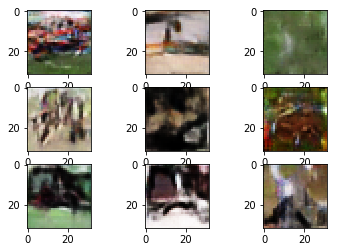

Epoch 4050/4050
64/64 [==============================] - 0s 591us/step - loss: -15.3253 - model_1_loss: -74.8719
Epoch 4050/4050
64/64 [==============================] - 0s 606us/step - loss: -19.3007 - model_1_loss: -96.4533
Epoch 4050/4050
64/64 [==============================] - 0s 615us/step - loss: -26.1868 - model_1_loss: -102.6880
Epoch 4050/4050
64/64 [==============================] - 0s 608us/step - loss: -19.9508 - model_1_loss: -80.7184
Epoch 4050/4050
64/64 [==============================] - 0s 604us/step - loss: -31.1325 - model_1_loss: -115.9828
Epoch 4050/4050
64/64 [==============================] - 0s 719us/step - loss: 101.4198


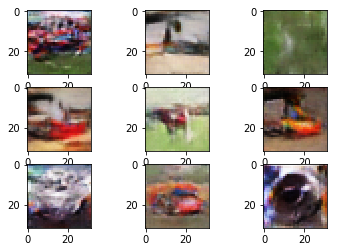

Epoch 4060/4060
64/64 [==============================] - 0s 599us/step - loss: -28.0662 - model_1_loss: -65.4741
Epoch 4060/4060
64/64 [==============================] - 0s 620us/step - loss: -24.5841 - model_1_loss: -83.7003
Epoch 4060/4060
64/64 [==============================] - 0s 629us/step - loss: -25.5187 - model_1_loss: -94.0380
Epoch 4060/4060
64/64 [==============================] - 0s 633us/step - loss: -29.2690 - model_1_loss: -99.2715
Epoch 4060/4060
64/64 [==============================] - 0s 617us/step - loss: -24.2255 - model_1_loss: -84.1924
Epoch 4060/4060
64/64 [==============================] - 0s 718us/step - loss: 75.9866


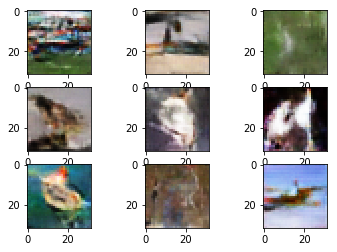

Epoch 4070/4070
64/64 [==============================] - 0s 593us/step - loss: 2.8188 - model_1_loss: -40.7300
Epoch 4070/4070
64/64 [==============================] - 0s 621us/step - loss: -15.1004 - model_1_loss: -70.5573
Epoch 4070/4070
64/64 [==============================] - 0s 628us/step - loss: -22.1056 - model_1_loss: -64.4754
Epoch 4070/4070
64/64 [==============================] - 0s 624us/step - loss: -22.0577 - model_1_loss: -82.6835
Epoch 4070/4070
64/64 [==============================] - 0s 628us/step - loss: -31.8395 - model_1_loss: -92.2548
Epoch 4070/4070
64/64 [==============================] - 0s 713us/step - loss: 107.3964


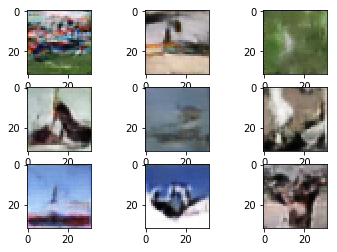

Epoch 4080/4080
64/64 [==============================] - 0s 609us/step - loss: -12.3371 - model_1_loss: -98.0463
Epoch 4080/4080
64/64 [==============================] - 0s 636us/step - loss: -18.2204 - model_1_loss: -97.6381
Epoch 4080/4080
64/64 [==============================] - 0s 625us/step - loss: -31.2865 - model_1_loss: -91.9017
Epoch 4080/4080
64/64 [==============================] - 0s 634us/step - loss: -29.8073 - model_1_loss: -67.5002
Epoch 4080/4080
64/64 [==============================] - 0s 635us/step - loss: -29.0605 - model_1_loss: -71.0461
Epoch 4080/4080
64/64 [==============================] - 0s 719us/step - loss: 79.8089


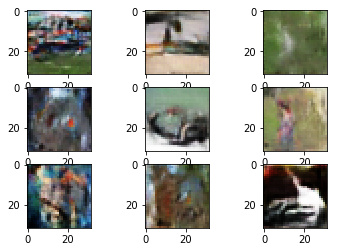

Epoch 4090/4090
64/64 [==============================] - 0s 617us/step - loss: -10.3162 - model_1_loss: -121.3733
Epoch 4090/4090
64/64 [==============================] - 0s 645us/step - loss: -28.0168 - model_1_loss: -113.2323
Epoch 4090/4090
64/64 [==============================] - 0s 633us/step - loss: -10.1467 - model_1_loss: -105.4118
Epoch 4090/4090
64/64 [==============================] - 0s 635us/step - loss: -23.3842 - model_1_loss: -136.1063
Epoch 4090/4090
64/64 [==============================] - 0s 651us/step - loss: -17.5302 - model_1_loss: -136.3043
Epoch 4090/4090
64/64 [==============================] - 0s 728us/step - loss: 119.0821


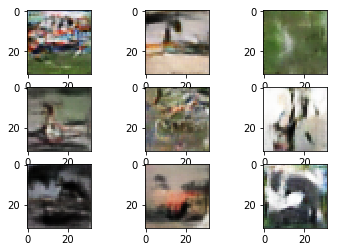

Epoch 4100/4100
64/64 [==============================] - 0s 623us/step - loss: -21.6763 - model_1_loss: -83.6659
Epoch 4100/4100
64/64 [==============================] - 0s 635us/step - loss: -15.9044 - model_1_loss: -89.4776
Epoch 4100/4100
64/64 [==============================] - 0s 619us/step - loss: -32.8600 - model_1_loss: -110.9909
Epoch 4100/4100
64/64 [==============================] - 0s 649us/step - loss: -15.8983 - model_1_loss: -101.2181
Epoch 4100/4100
64/64 [==============================] - 0s 628us/step - loss: -19.3716 - model_1_loss: -115.4678
Epoch 4100/4100
64/64 [==============================] - 0s 716us/step - loss: 129.9060


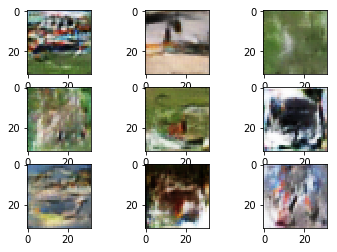

Epoch 4110/4110
64/64 [==============================] - 0s 616us/step - loss: -8.7088 - model_1_loss: -91.5628
Epoch 4110/4110
64/64 [==============================] - 0s 630us/step - loss: -23.5525 - model_1_loss: -106.7869
Epoch 4110/4110
64/64 [==============================] - 0s 634us/step - loss: -19.5624 - model_1_loss: -105.3206
Epoch 4110/4110
64/64 [==============================] - 0s 642us/step - loss: -10.0832 - model_1_loss: -106.0953
Epoch 4110/4110
64/64 [==============================] - 0s 623us/step - loss: -14.1572 - model_1_loss: -90.4151
Epoch 4110/4110
64/64 [==============================] - 0s 723us/step - loss: 113.6814


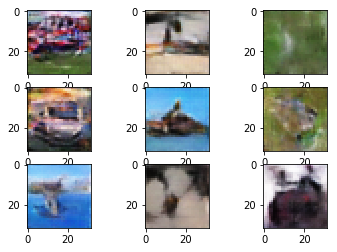

Epoch 4120/4120
64/64 [==============================] - 0s 628us/step - loss: -8.9664 - model_1_loss: -69.4711
Epoch 4120/4120
64/64 [==============================] - 0s 644us/step - loss: -17.3048 - model_1_loss: -62.7179
Epoch 4120/4120
64/64 [==============================] - 0s 642us/step - loss: -30.0229 - model_1_loss: -74.6459
Epoch 4120/4120
64/64 [==============================] - 0s 646us/step - loss: -28.1279 - model_1_loss: -57.0474
Epoch 4120/4120
64/64 [==============================] - 0s 654us/step - loss: -34.5312 - model_1_loss: -79.3817
Epoch 4120/4120
64/64 [==============================] - 0s 725us/step - loss: 90.0008


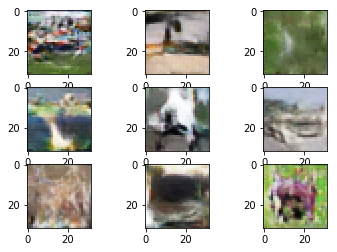

Epoch 4130/4130
64/64 [==============================] - 0s 639us/step - loss: -13.9656 - model_1_loss: -125.3939
Epoch 4130/4130
64/64 [==============================] - 0s 639us/step - loss: -23.1977 - model_1_loss: -76.1342
Epoch 4130/4130
64/64 [==============================] - 0s 644us/step - loss: -32.0626 - model_1_loss: -101.0143
Epoch 4130/4130
64/64 [==============================] - 0s 622us/step - loss: -18.6968 - model_1_loss: -70.1731
Epoch 4130/4130
64/64 [==============================] - 0s 636us/step - loss: -30.8199 - model_1_loss: -52.7994
Epoch 4130/4130
64/64 [==============================] - 0s 726us/step - loss: 43.7668


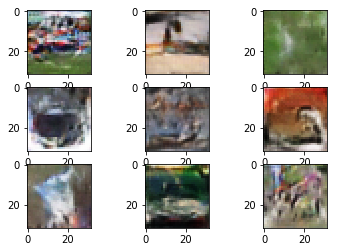

Epoch 4140/4140
64/64 [==============================] - 0s 622us/step - loss: -2.2873 - model_1_loss: -96.6499
Epoch 4140/4140
64/64 [==============================] - 0s 635us/step - loss: -10.6028 - model_1_loss: -114.9934
Epoch 4140/4140
64/64 [==============================] - 0s 641us/step - loss: -24.0331 - model_1_loss: -108.7453
Epoch 4140/4140
64/64 [==============================] - 0s 637us/step - loss: -19.0437 - model_1_loss: -95.1655
Epoch 4140/4140
64/64 [==============================] - 0s 643us/step - loss: -31.4803 - model_1_loss: -101.9903
Epoch 4140/4140
64/64 [==============================] - 0s 741us/step - loss: 132.4023


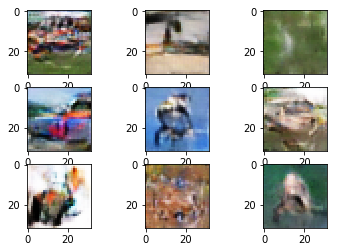

Epoch 4150/4150
64/64 [==============================] - 0s 641us/step - loss: -18.7440 - model_1_loss: -117.2666
Epoch 4150/4150
64/64 [==============================] - 0s 647us/step - loss: -30.3659 - model_1_loss: -106.6711
Epoch 4150/4150
64/64 [==============================] - 0s 631us/step - loss: -8.8991 - model_1_loss: -108.0952
Epoch 4150/4150
64/64 [==============================] - 0s 644us/step - loss: -17.2547 - model_1_loss: -114.6815
Epoch 4150/4150
64/64 [==============================] - 0s 638us/step - loss: -23.5935 - model_1_loss: -108.0403
Epoch 4150/4150
64/64 [==============================] - 0s 723us/step - loss: 90.2933


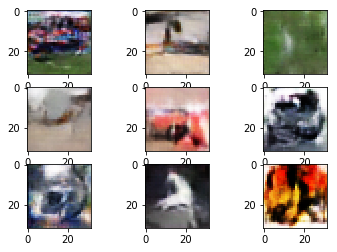

Epoch 4160/4160
64/64 [==============================] - 0s 637us/step - loss: -8.6115 - model_1_loss: -61.2913
Epoch 4160/4160
64/64 [==============================] - 0s 643us/step - loss: -11.5213 - model_1_loss: -58.2517
Epoch 4160/4160
64/64 [==============================] - 0s 648us/step - loss: -19.6809 - model_1_loss: -63.8675
Epoch 4160/4160
64/64 [==============================] - 0s 643us/step - loss: -41.4474 - model_1_loss: -54.1253
Epoch 4160/4160
64/64 [==============================] - 0s 644us/step - loss: -31.0697 - model_1_loss: -42.6850
Epoch 4160/4160
64/64 [==============================] - 0s 743us/step - loss: 35.9165


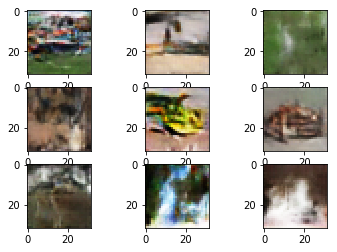

Epoch 4170/4170
64/64 [==============================] - 0s 636us/step - loss: -10.3765 - model_1_loss: -99.0735
Epoch 4170/4170
64/64 [==============================] - 0s 638us/step - loss: -26.7527 - model_1_loss: -107.6151
Epoch 4170/4170
64/64 [==============================] - 0s 644us/step - loss: -30.8692 - model_1_loss: -110.5683
Epoch 4170/4170
64/64 [==============================] - 0s 653us/step - loss: -5.3526 - model_1_loss: -122.6740
Epoch 4170/4170
64/64 [==============================] - 0s 654us/step - loss: -24.5413 - model_1_loss: -144.4880
Epoch 4170/4170
64/64 [==============================] - 0s 734us/step - loss: 141.7497


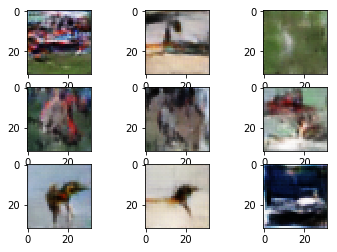

Epoch 4180/4180
64/64 [==============================] - 0s 626us/step - loss: -6.7327 - model_1_loss: -85.7794
Epoch 4180/4180
64/64 [==============================] - 0s 658us/step - loss: -23.2304 - model_1_loss: -102.5940
Epoch 4180/4180
64/64 [==============================] - 0s 635us/step - loss: -26.0826 - model_1_loss: -78.8084
Epoch 4180/4180
64/64 [==============================] - 0s 648us/step - loss: -34.6261 - model_1_loss: -80.6353
Epoch 4180/4180
64/64 [==============================] - 0s 642us/step - loss: -40.5494 - model_1_loss: -71.5835
Epoch 4180/4180
64/64 [==============================] - 0s 734us/step - loss: 52.6329


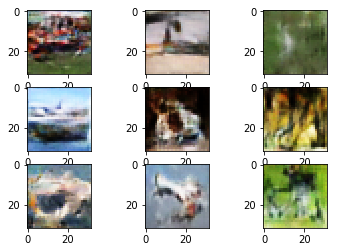

Epoch 4190/4190
64/64 [==============================] - 0s 634us/step - loss: -13.6749 - model_1_loss: -52.5149
Epoch 4190/4190
64/64 [==============================] - 0s 646us/step - loss: -11.9309 - model_1_loss: -77.6916
Epoch 4190/4190
64/64 [==============================] - 0s 645us/step - loss: -24.2959 - model_1_loss: -102.6889
Epoch 4190/4190
64/64 [==============================] - 0s 648us/step - loss: -25.1829 - model_1_loss: -76.3431
Epoch 4190/4190
64/64 [==============================] - 0s 647us/step - loss: -30.9834 - model_1_loss: -100.3323
Epoch 4190/4190
64/64 [==============================] - 0s 742us/step - loss: 82.2053


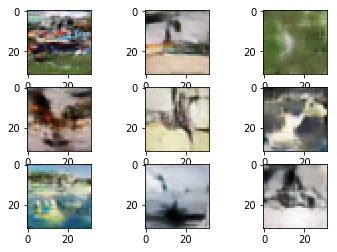

Epoch 4200/4200
64/64 [==============================] - 0s 634us/step - loss: -2.4455 - model_1_loss: -113.5470
Epoch 4200/4200
64/64 [==============================] - 0s 652us/step - loss: -45.9605 - model_1_loss: -132.2207
Epoch 4200/4200
64/64 [==============================] - 0s 651us/step - loss: -29.7953 - model_1_loss: -121.5105
Epoch 4200/4200
64/64 [==============================] - 0s 641us/step - loss: 4.7822 - model_1_loss: -102.0661
Epoch 4200/4200
64/64 [==============================] - 0s 650us/step - loss: -5.9812 - model_1_loss: -87.3743
Epoch 4200/4200
64/64 [==============================] - 0s 723us/step - loss: 86.0823


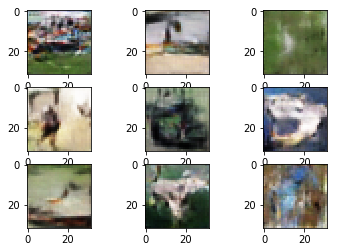

Epoch 4210/4210
64/64 [==============================] - 0s 632us/step - loss: -19.6436 - model_1_loss: -166.9811
Epoch 4210/4210
64/64 [==============================] - 0s 631us/step - loss: -13.5065 - model_1_loss: -177.9106
Epoch 4210/4210
64/64 [==============================] - 0s 711us/step - loss: -9.7212 - model_1_loss: -159.6455
Epoch 4210/4210
64/64 [==============================] - 0s 642us/step - loss: -27.9775 - model_1_loss: -165.1216
Epoch 4210/4210
64/64 [==============================] - 0s 632us/step - loss: -17.5414 - model_1_loss: -155.8605
Epoch 4210/4210
64/64 [==============================] - 0s 733us/step - loss: 164.2748


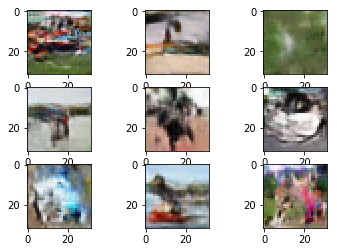

Epoch 4220/4220
64/64 [==============================] - 0s 626us/step - loss: -15.0951 - model_1_loss: -74.1173
Epoch 4220/4220
64/64 [==============================] - 0s 648us/step - loss: -11.0535 - model_1_loss: -104.4803
Epoch 4220/4220
64/64 [==============================] - 0s 650us/step - loss: -12.7093 - model_1_loss: -121.0823
Epoch 4220/4220
64/64 [==============================] - 0s 644us/step - loss: -21.5575 - model_1_loss: -128.2005
Epoch 4220/4220
64/64 [==============================] - 0s 652us/step - loss: -27.0334 - model_1_loss: -130.4342
Epoch 4220/4220
64/64 [==============================] - 0s 734us/step - loss: 108.0277


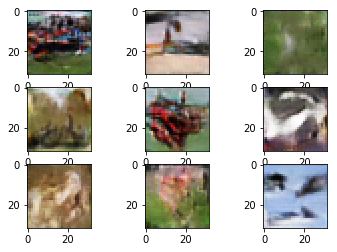

Epoch 4230/4230
64/64 [==============================] - 0s 627us/step - loss: -14.1540 - model_1_loss: -97.3516
Epoch 4230/4230
64/64 [==============================] - 0s 640us/step - loss: -28.5764 - model_1_loss: -125.3934
Epoch 4230/4230
64/64 [==============================] - 0s 643us/step - loss: -26.1084 - model_1_loss: -108.5346
Epoch 4230/4230
64/64 [==============================] - 0s 637us/step - loss: -4.7863 - model_1_loss: -140.3147
Epoch 4230/4230
64/64 [==============================] - 0s 642us/step - loss: -19.2313 - model_1_loss: -128.8499
Epoch 4230/4230
64/64 [==============================] - 0s 725us/step - loss: 133.5556


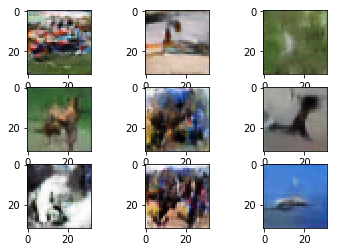

Epoch 4240/4240
64/64 [==============================] - 0s 640us/step - loss: -20.1250 - model_1_loss: -139.7246
Epoch 4240/4240
64/64 [==============================] - 0s 640us/step - loss: -26.0402 - model_1_loss: -160.5574
Epoch 4240/4240
64/64 [==============================] - 0s 640us/step - loss: -17.5116 - model_1_loss: -141.6220
Epoch 4240/4240
64/64 [==============================] - 0s 643us/step - loss: -16.6640 - model_1_loss: -127.9269
Epoch 4240/4240
64/64 [==============================] - 0s 635us/step - loss: -22.0720 - model_1_loss: -117.2540
Epoch 4240/4240
64/64 [==============================] - 0s 727us/step - loss: 136.5302


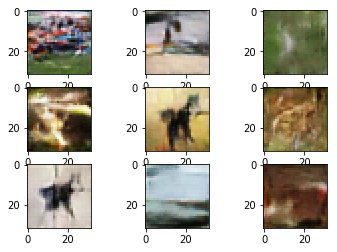

Epoch 4250/4250
64/64 [==============================] - 0s 623us/step - loss: -12.6524 - model_1_loss: -28.5181
Epoch 4250/4250
64/64 [==============================] - 0s 642us/step - loss: -12.4883 - model_1_loss: -45.0787
Epoch 4250/4250
64/64 [==============================] - 0s 647us/step - loss: -28.2615 - model_1_loss: -54.1555
Epoch 4250/4250
64/64 [==============================] - 0s 644us/step - loss: -30.8850 - model_1_loss: -63.8300
Epoch 4250/4250
64/64 [==============================] - 0s 654us/step - loss: -30.4425 - model_1_loss: -95.3734
Epoch 4250/4250
64/64 [==============================] - 0s 736us/step - loss: 73.3521


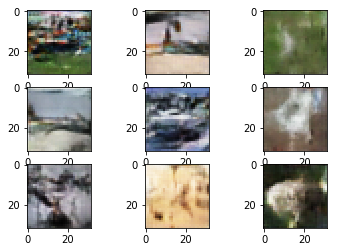

Epoch 4260/4260
64/64 [==============================] - 0s 622us/step - loss: -11.6450 - model_1_loss: -140.0009
Epoch 4260/4260
64/64 [==============================] - 0s 647us/step - loss: -17.2247 - model_1_loss: -137.7693
Epoch 4260/4260
64/64 [==============================] - 0s 642us/step - loss: -29.2973 - model_1_loss: -128.2958
Epoch 4260/4260
64/64 [==============================] - 0s 644us/step - loss: -24.2599 - model_1_loss: -129.3012
Epoch 4260/4260
64/64 [==============================] - 0s 662us/step - loss: -31.3626 - model_1_loss: -136.8099
Epoch 4260/4260
64/64 [==============================] - 0s 737us/step - loss: 125.0645


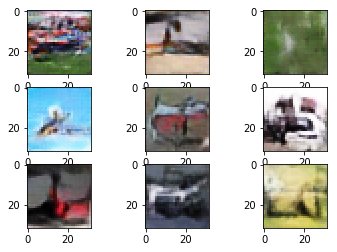

Epoch 4270/4270
64/64 [==============================] - 0s 636us/step - loss: -14.9104 - model_1_loss: -99.9101
Epoch 4270/4270
64/64 [==============================] - 0s 661us/step - loss: -10.0339 - model_1_loss: -115.2822
Epoch 4270/4270
64/64 [==============================] - 0s 648us/step - loss: -25.5788 - model_1_loss: -129.2481
Epoch 4270/4270
64/64 [==============================] - 0s 648us/step - loss: -32.1724 - model_1_loss: -120.1994
Epoch 4270/4270
64/64 [==============================] - 0s 644us/step - loss: -23.8091 - model_1_loss: -125.5204
Epoch 4270/4270
64/64 [==============================] - 0s 739us/step - loss: 103.9565


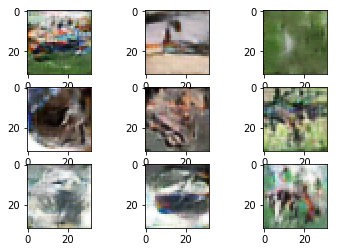

Epoch 4280/4280
64/64 [==============================] - 0s 631us/step - loss: -9.2335 - model_1_loss: -113.8590
Epoch 4280/4280
64/64 [==============================] - 0s 651us/step - loss: -16.6073 - model_1_loss: -128.4114
Epoch 4280/4280
64/64 [==============================] - 0s 649us/step - loss: -15.4996 - model_1_loss: -108.7662
Epoch 4280/4280
64/64 [==============================] - 0s 644us/step - loss: -21.9149 - model_1_loss: -132.9041
Epoch 4280/4280
64/64 [==============================] - 0s 644us/step - loss: -18.1186 - model_1_loss: -102.0289
Epoch 4280/4280
64/64 [==============================] - 0s 725us/step - loss: 113.4258


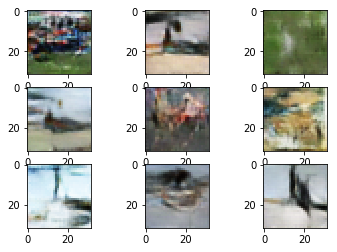

Epoch 4290/4290
64/64 [==============================] - 0s 623us/step - loss: -23.9208 - model_1_loss: -121.2960
Epoch 4290/4290
64/64 [==============================] - 0s 639us/step - loss: -36.5285 - model_1_loss: -113.6918
Epoch 4290/4290
64/64 [==============================] - 0s 649us/step - loss: -14.4576 - model_1_loss: -107.1602
Epoch 4290/4290
64/64 [==============================] - 0s 654us/step - loss: -28.7462 - model_1_loss: -91.6234
Epoch 4290/4290
64/64 [==============================] - 0s 650us/step - loss: -12.2941 - model_1_loss: -84.3946
Epoch 4290/4290
64/64 [==============================] - 0s 731us/step - loss: 115.6265


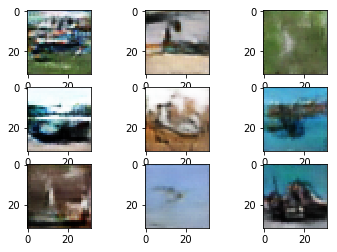

Epoch 4300/4300
64/64 [==============================] - 0s 635us/step - loss: -2.7469 - model_1_loss: -112.0703
Epoch 4300/4300
64/64 [==============================] - 0s 656us/step - loss: -20.0351 - model_1_loss: -105.8898
Epoch 4300/4300
64/64 [==============================] - 0s 653us/step - loss: -22.1040 - model_1_loss: -103.4680
Epoch 4300/4300
64/64 [==============================] - 0s 645us/step - loss: -18.5197 - model_1_loss: -119.0654
Epoch 4300/4300
64/64 [==============================] - 0s 650us/step - loss: -18.5754 - model_1_loss: -101.8649
Epoch 4300/4300
64/64 [==============================] - 0s 732us/step - loss: 90.9367


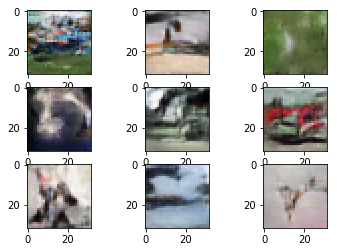

Epoch 4310/4310
64/64 [==============================] - 0s 637us/step - loss: -17.6473 - model_1_loss: -82.8391
Epoch 4310/4310
64/64 [==============================] - 0s 662us/step - loss: -25.1062 - model_1_loss: -75.3122
Epoch 4310/4310
64/64 [==============================] - 0s 653us/step - loss: -21.3243 - model_1_loss: -80.0682
Epoch 4310/4310
64/64 [==============================] - 0s 653us/step - loss: -23.1309 - model_1_loss: -78.0865
Epoch 4310/4310
64/64 [==============================] - 0s 659us/step - loss: -20.9324 - model_1_loss: -75.3613
Epoch 4310/4310
64/64 [==============================] - 0s 747us/step - loss: 82.1445


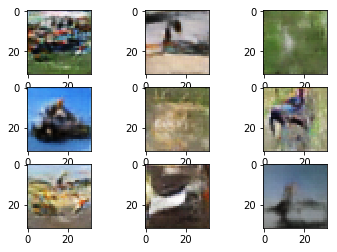

Epoch 4320/4320
64/64 [==============================] - 0s 641us/step - loss: -14.1693 - model_1_loss: -55.8519
Epoch 4320/4320
64/64 [==============================] - 0s 653us/step - loss: -28.9751 - model_1_loss: -75.8378
Epoch 4320/4320
64/64 [==============================] - 0s 658us/step - loss: -20.4431 - model_1_loss: -69.2634
Epoch 4320/4320
64/64 [==============================] - 0s 650us/step - loss: -40.2148 - model_1_loss: -86.0877
Epoch 4320/4320
64/64 [==============================] - 0s 644us/step - loss: -24.7053 - model_1_loss: -89.2071
Epoch 4320/4320
64/64 [==============================] - 0s 741us/step - loss: 104.6369


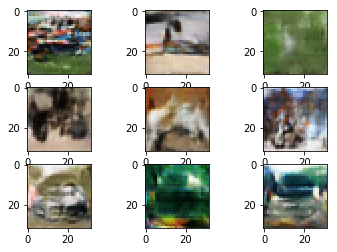

Epoch 4330/4330
64/64 [==============================] - 0s 625us/step - loss: -26.4251 - model_1_loss: -100.5800
Epoch 4330/4330
64/64 [==============================] - 0s 634us/step - loss: -17.5126 - model_1_loss: -97.3112
Epoch 4330/4330
64/64 [==============================] - 0s 632us/step - loss: -30.8158 - model_1_loss: -125.5542
Epoch 4330/4330
64/64 [==============================] - 0s 640us/step - loss: -21.0499 - model_1_loss: -113.2729
Epoch 4330/4330
64/64 [==============================] - 0s 647us/step - loss: -28.6436 - model_1_loss: -84.6523
Epoch 4330/4330
64/64 [==============================] - 0s 725us/step - loss: 93.5841


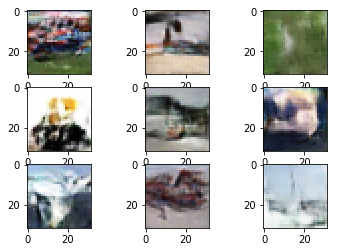

Epoch 4340/4340
64/64 [==============================] - 0s 639us/step - loss: -16.1235 - model_1_loss: -58.5139
Epoch 4340/4340
64/64 [==============================] - 0s 657us/step - loss: -20.6620 - model_1_loss: -55.1853
Epoch 4340/4340
64/64 [==============================] - 0s 646us/step - loss: -23.8262 - model_1_loss: -49.5132
Epoch 4340/4340
64/64 [==============================] - 0s 652us/step - loss: -30.9901 - model_1_loss: -63.6192
Epoch 4340/4340
64/64 [==============================] - 0s 650us/step - loss: -25.3648 - model_1_loss: -54.4692
Epoch 4340/4340
64/64 [==============================] - 0s 736us/step - loss: 61.7463


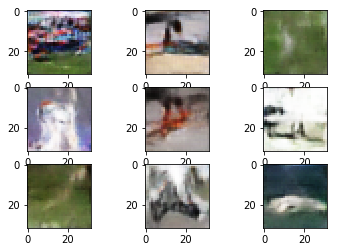

Epoch 4350/4350
64/64 [==============================] - 0s 616us/step - loss: -18.3051 - model_1_loss: -122.1115
Epoch 4350/4350
64/64 [==============================] - 0s 608us/step - loss: -16.3622 - model_1_loss: -111.5625
Epoch 4350/4350
64/64 [==============================] - 0s 634us/step - loss: -31.1522 - model_1_loss: -125.1851
Epoch 4350/4350
64/64 [==============================] - 0s 649us/step - loss: -28.9134 - model_1_loss: -122.7544
Epoch 4350/4350
64/64 [==============================] - 0s 653us/step - loss: -20.6010 - model_1_loss: -122.6726
Epoch 4350/4350
64/64 [==============================] - 0s 746us/step - loss: 129.8999


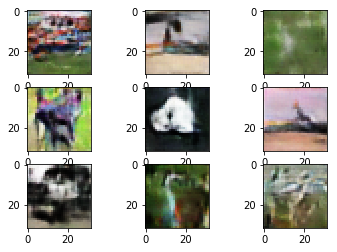

Epoch 4360/4360
64/64 [==============================] - 0s 639us/step - loss: -25.4449 - model_1_loss: -94.6562
Epoch 4360/4360
64/64 [==============================] - 0s 664us/step - loss: -14.6933 - model_1_loss: -61.6561
Epoch 4360/4360
64/64 [==============================] - 0s 666us/step - loss: -21.2023 - model_1_loss: -84.0111
Epoch 4360/4360
64/64 [==============================] - 0s 651us/step - loss: -23.4413 - model_1_loss: -89.7027
Epoch 4360/4360
64/64 [==============================] - 0s 666us/step - loss: -27.9314 - model_1_loss: -91.9774
Epoch 4360/4360
64/64 [==============================] - 0s 741us/step - loss: 55.0602


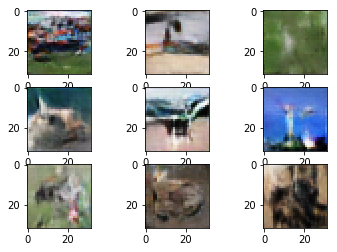

Epoch 4370/4370
64/64 [==============================] - 0s 634us/step - loss: -3.4319 - model_1_loss: -38.4031
Epoch 4370/4370
64/64 [==============================] - 0s 649us/step - loss: -26.8958 - model_1_loss: -87.4189
Epoch 4370/4370
64/64 [==============================] - 0s 655us/step - loss: -20.1915 - model_1_loss: -108.2651
Epoch 4370/4370
64/64 [==============================] - 0s 639us/step - loss: -11.2108 - model_1_loss: -111.9376
Epoch 4370/4370
64/64 [==============================] - 0s 646us/step - loss: -24.3503 - model_1_loss: -157.4881
Epoch 4370/4370
64/64 [==============================] - 0s 733us/step - loss: 129.1184


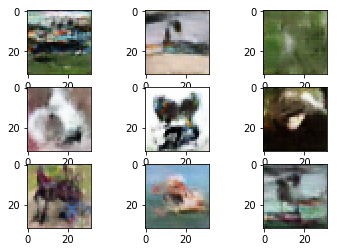

Epoch 4380/4380
64/64 [==============================] - 0s 650us/step - loss: -2.4123 - model_1_loss: -45.7146
Epoch 4380/4380
64/64 [==============================] - 0s 647us/step - loss: -11.1982 - model_1_loss: -44.9737
Epoch 4380/4380
64/64 [==============================] - 0s 655us/step - loss: -22.3076 - model_1_loss: -64.2268
Epoch 4380/4380
64/64 [==============================] - 0s 660us/step - loss: -22.3197 - model_1_loss: -70.1729
Epoch 4380/4380
64/64 [==============================] - 0s 656us/step - loss: -37.0217 - model_1_loss: -110.4365
Epoch 4380/4380
64/64 [==============================] - 0s 735us/step - loss: 98.9579


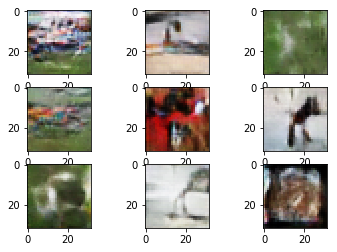

Epoch 4390/4390
64/64 [==============================] - 0s 645us/step - loss: -0.1201 - model_1_loss: -89.7470
Epoch 4390/4390
64/64 [==============================] - 0s 656us/step - loss: -3.6310 - model_1_loss: -103.4290
Epoch 4390/4390
64/64 [==============================] - 0s 651us/step - loss: -16.5256 - model_1_loss: -102.3487
Epoch 4390/4390
64/64 [==============================] - 0s 640us/step - loss: -27.3072 - model_1_loss: -126.3590
Epoch 4390/4390
64/64 [==============================] - 0s 657us/step - loss: -28.0377 - model_1_loss: -112.6684
Epoch 4390/4390
64/64 [==============================] - 0s 736us/step - loss: 114.7565


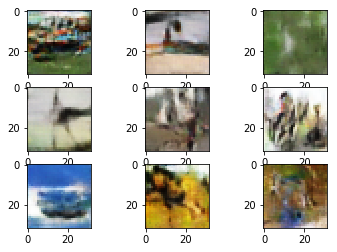

Epoch 4400/4400
64/64 [==============================] - 0s 633us/step - loss: -11.4863 - model_1_loss: -57.1883
Epoch 4400/4400
64/64 [==============================] - 0s 655us/step - loss: -11.7169 - model_1_loss: -84.5092
Epoch 4400/4400
64/64 [==============================] - 0s 647us/step - loss: -14.2732 - model_1_loss: -93.3817
Epoch 4400/4400
64/64 [==============================] - 0s 642us/step - loss: -21.0290 - model_1_loss: -77.6336
Epoch 4400/4400
64/64 [==============================] - 0s 649us/step - loss: -33.9794 - model_1_loss: -101.7028
Epoch 4400/4400
64/64 [==============================] - 0s 721us/step - loss: 99.3773


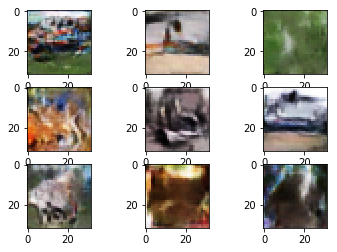

Epoch 4410/4410
64/64 [==============================] - 0s 641us/step - loss: -19.7632 - model_1_loss: -107.9570
Epoch 4410/4410
64/64 [==============================] - 0s 655us/step - loss: -17.1716 - model_1_loss: -124.3511
Epoch 4410/4410
64/64 [==============================] - 0s 645us/step - loss: -30.8648 - model_1_loss: -126.2608
Epoch 4410/4410
64/64 [==============================] - 0s 648us/step - loss: -34.5264 - model_1_loss: -123.7221
Epoch 4410/4410
64/64 [==============================] - 0s 665us/step - loss: -36.7740 - model_1_loss: -144.4668
Epoch 4410/4410
64/64 [==============================] - 0s 732us/step - loss: 104.6440


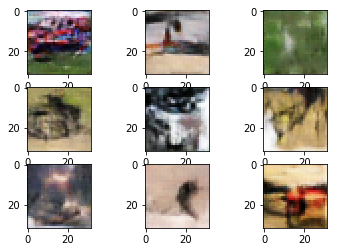

Epoch 4420/4420
64/64 [==============================] - 0s 631us/step - loss: -21.8964 - model_1_loss: -110.4331
Epoch 4420/4420
64/64 [==============================] - 0s 648us/step - loss: -13.6429 - model_1_loss: -99.0348
Epoch 4420/4420
64/64 [==============================] - 0s 665us/step - loss: -25.0912 - model_1_loss: -96.6427
Epoch 4420/4420
64/64 [==============================] - 0s 645us/step - loss: -13.3033 - model_1_loss: -90.4769
Epoch 4420/4420
64/64 [==============================] - 0s 646us/step - loss: -39.4575 - model_1_loss: -125.1779
Epoch 4420/4420
64/64 [==============================] - 0s 733us/step - loss: 120.5857


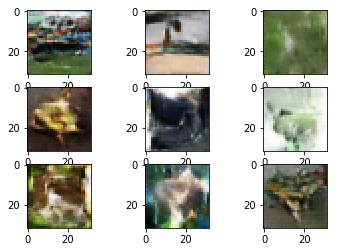

Epoch 4430/4430
64/64 [==============================] - 0s 633us/step - loss: -20.2969 - model_1_loss: -61.2967
Epoch 4430/4430
64/64 [==============================] - 0s 646us/step - loss: -30.9637 - model_1_loss: -80.2425
Epoch 4430/4430
64/64 [==============================] - 0s 653us/step - loss: -29.1910 - model_1_loss: -102.3112
Epoch 4430/4430
64/64 [==============================] - 0s 646us/step - loss: -20.6334 - model_1_loss: -109.6210
Epoch 4430/4430
64/64 [==============================] - 0s 641us/step - loss: -5.7511 - model_1_loss: -111.2832
Epoch 4430/4430
64/64 [==============================] - 0s 749us/step - loss: 105.1591


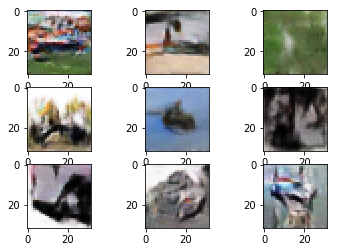

Epoch 4440/4440
64/64 [==============================] - 0s 620us/step - loss: -20.9099 - model_1_loss: -99.8617
Epoch 4440/4440
64/64 [==============================] - 0s 659us/step - loss: -18.5544 - model_1_loss: -117.5864
Epoch 4440/4440
64/64 [==============================] - 0s 640us/step - loss: -24.8914 - model_1_loss: -135.5870
Epoch 4440/4440
64/64 [==============================] - 0s 659us/step - loss: -34.9248 - model_1_loss: -138.5936
Epoch 4440/4440
64/64 [==============================] - 0s 659us/step - loss: -25.6081 - model_1_loss: -136.0442
Epoch 4440/4440
64/64 [==============================] - 0s 726us/step - loss: 133.0069


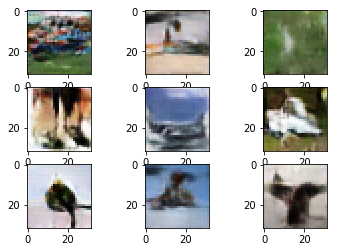

Epoch 4450/4450
64/64 [==============================] - 0s 641us/step - loss: -12.5091 - model_1_loss: -13.8337
Epoch 4450/4450
64/64 [==============================] - 0s 638us/step - loss: -23.1185 - model_1_loss: -24.1499
Epoch 4450/4450
64/64 [==============================] - 0s 668us/step - loss: -12.0255 - model_1_loss: -47.9063
Epoch 4450/4450
64/64 [==============================] - 0s 655us/step - loss: -18.6789 - model_1_loss: -72.0952
Epoch 4450/4450
64/64 [==============================] - 0s 652us/step - loss: -21.4651 - model_1_loss: -80.9057
Epoch 4450/4450
64/64 [==============================] - 0s 742us/step - loss: 82.4425


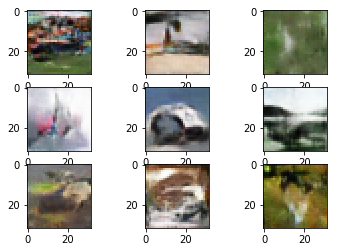

Epoch 4460/4460
64/64 [==============================] - 0s 628us/step - loss: -7.6590 - model_1_loss: -49.9262
Epoch 4460/4460
64/64 [==============================] - 0s 656us/step - loss: -4.9349 - model_1_loss: -58.9937
Epoch 4460/4460
64/64 [==============================] - 0s 644us/step - loss: -25.5100 - model_1_loss: -81.0301
Epoch 4460/4460
64/64 [==============================] - 0s 648us/step - loss: -24.3457 - model_1_loss: -77.2044
Epoch 4460/4460
64/64 [==============================] - 0s 646us/step - loss: -23.3268 - model_1_loss: -77.0106
Epoch 4460/4460
64/64 [==============================] - 0s 732us/step - loss: 80.6284


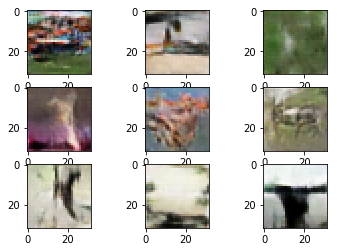

Epoch 4470/4470
64/64 [==============================] - 0s 628us/step - loss: -18.8066 - model_1_loss: -98.8947
Epoch 4470/4470
64/64 [==============================] - 0s 647us/step - loss: -29.0997 - model_1_loss: -75.9918
Epoch 4470/4470
64/64 [==============================] - 0s 648us/step - loss: -20.6769 - model_1_loss: -88.0715
Epoch 4470/4470
64/64 [==============================] - 0s 659us/step - loss: -29.6677 - model_1_loss: -117.1851
Epoch 4470/4470
64/64 [==============================] - 0s 634us/step - loss: -32.1257 - model_1_loss: -82.5413
Epoch 4470/4470
64/64 [==============================] - 0s 729us/step - loss: 108.7502


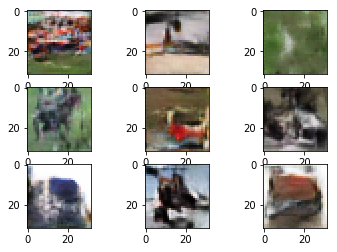

Epoch 4480/4480
64/64 [==============================] - 0s 632us/step - loss: -30.2375 - model_1_loss: -129.7002
Epoch 4480/4480
64/64 [==============================] - 0s 645us/step - loss: -26.2638 - model_1_loss: -118.1489
Epoch 4480/4480
64/64 [==============================] - 0s 643us/step - loss: -19.8315 - model_1_loss: -120.4990
Epoch 4480/4480
64/64 [==============================] - 0s 632us/step - loss: -26.8909 - model_1_loss: -93.4206
Epoch 4480/4480
64/64 [==============================] - 0s 644us/step - loss: -32.7735 - model_1_loss: -105.1256
Epoch 4480/4480
64/64 [==============================] - 0s 733us/step - loss: 94.2712


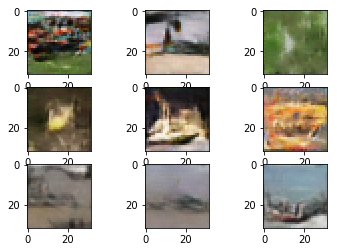

Epoch 4490/4490
64/64 [==============================] - 0s 637us/step - loss: -14.5032 - model_1_loss: -125.7225
Epoch 4490/4490
64/64 [==============================] - 0s 655us/step - loss: -19.4508 - model_1_loss: -139.7206
Epoch 4490/4490
64/64 [==============================] - 0s 657us/step - loss: -23.8625 - model_1_loss: -150.7603
Epoch 4490/4490
64/64 [==============================] - 0s 651us/step - loss: -23.1725 - model_1_loss: -116.3629
Epoch 4490/4490
64/64 [==============================] - 0s 648us/step - loss: -36.0962 - model_1_loss: -129.7881
Epoch 4490/4490
64/64 [==============================] - 0s 755us/step - loss: 121.3856


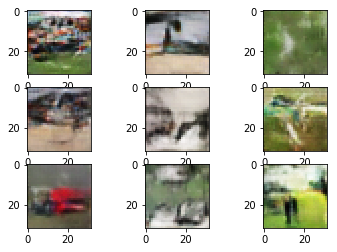

Epoch 4500/4500
64/64 [==============================] - 0s 623us/step - loss: -31.7203 - model_1_loss: -74.3230
Epoch 4500/4500
64/64 [==============================] - 0s 641us/step - loss: -11.7561 - model_1_loss: -63.7280
Epoch 4500/4500
64/64 [==============================] - 0s 656us/step - loss: -26.1850 - model_1_loss: -106.0778
Epoch 4500/4500
64/64 [==============================] - 0s 651us/step - loss: -19.5720 - model_1_loss: -95.5893
Epoch 4500/4500
64/64 [==============================] - 0s 651us/step - loss: -32.6586 - model_1_loss: -99.1954
Epoch 4500/4500
64/64 [==============================] - 0s 718us/step - loss: 83.1212


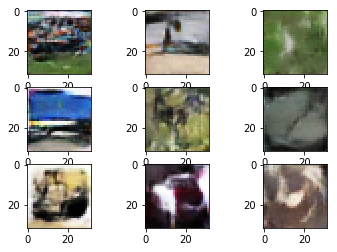

Epoch 4510/4510
64/64 [==============================] - 0s 648us/step - loss: -24.4157 - model_1_loss: -105.4989
Epoch 4510/4510
64/64 [==============================] - 0s 646us/step - loss: -5.6609 - model_1_loss: -93.9039
Epoch 4510/4510
64/64 [==============================] - 0s 672us/step - loss: -21.1248 - model_1_loss: -112.1389
Epoch 4510/4510
64/64 [==============================] - 0s 651us/step - loss: -19.5423 - model_1_loss: -134.5639
Epoch 4510/4510
64/64 [==============================] - 0s 657us/step - loss: -29.9003 - model_1_loss: -143.9650
Epoch 4510/4510
64/64 [==============================] - 0s 733us/step - loss: 140.9551


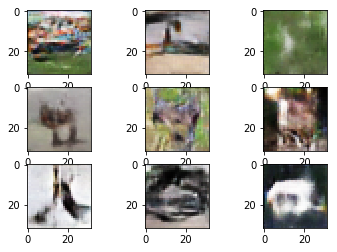

Epoch 4520/4520
64/64 [==============================] - 0s 637us/step - loss: -15.1696 - model_1_loss: -41.5487
Epoch 4520/4520
64/64 [==============================] - 0s 659us/step - loss: -17.5502 - model_1_loss: -80.5189
Epoch 4520/4520
64/64 [==============================] - 0s 657us/step - loss: -10.6946 - model_1_loss: -92.1294
Epoch 4520/4520
64/64 [==============================] - 0s 673us/step - loss: -11.1937 - model_1_loss: -121.9289
Epoch 4520/4520
64/64 [==============================] - 0s 653us/step - loss: -32.4592 - model_1_loss: -127.4204
Epoch 4520/4520
64/64 [==============================] - 0s 738us/step - loss: 114.5257


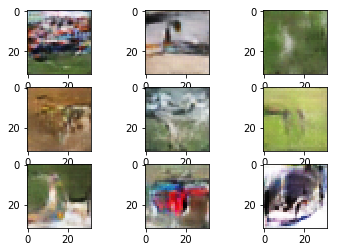

Epoch 4530/4530
64/64 [==============================] - 0s 637us/step - loss: -15.3144 - model_1_loss: -73.1488
Epoch 4530/4530
64/64 [==============================] - 0s 662us/step - loss: -28.0770 - model_1_loss: -91.3179
Epoch 4530/4530
64/64 [==============================] - 0s 656us/step - loss: -29.9537 - model_1_loss: -94.7007
Epoch 4530/4530
64/64 [==============================] - 0s 680us/step - loss: -38.1446 - model_1_loss: -106.3899
Epoch 4530/4530
64/64 [==============================] - 0s 658us/step - loss: -25.2567 - model_1_loss: -117.2360
Epoch 4530/4530
64/64 [==============================] - 0s 762us/step - loss: 120.4110


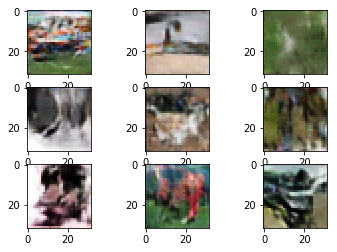

Epoch 4540/4540
64/64 [==============================] - 0s 623us/step - loss: -15.5269 - model_1_loss: -36.4764
Epoch 4540/4540
64/64 [==============================] - 0s 653us/step - loss: -15.7981 - model_1_loss: -60.3954
Epoch 4540/4540
64/64 [==============================] - 0s 656us/step - loss: -35.6608 - model_1_loss: -92.4423
Epoch 4540/4540
64/64 [==============================] - 0s 669us/step - loss: -35.8786 - model_1_loss: -95.1050
Epoch 4540/4540
64/64 [==============================] - 0s 746us/step - loss: -11.1682 - model_1_loss: -106.3624
Epoch 4540/4540
64/64 [==============================] - 0s 744us/step - loss: 122.5887


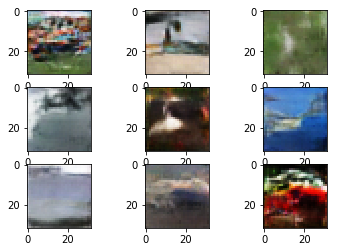

Epoch 4550/4550
64/64 [==============================] - 0s 639us/step - loss: -21.2760 - model_1_loss: -79.5291
Epoch 4550/4550
64/64 [==============================] - 0s 652us/step - loss: -19.1872 - model_1_loss: -89.5249
Epoch 4550/4550
64/64 [==============================] - 0s 649us/step - loss: -26.4572 - model_1_loss: -82.8694
Epoch 4550/4550
64/64 [==============================] - 0s 653us/step - loss: -34.2713 - model_1_loss: -75.8342
Epoch 4550/4550
64/64 [==============================] - 0s 635us/step - loss: -26.8039 - model_1_loss: -98.8861
Epoch 4550/4550
64/64 [==============================] - 0s 729us/step - loss: 125.5633


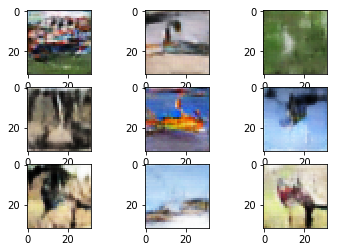

Epoch 4560/4560
64/64 [==============================] - 0s 661us/step - loss: -8.3941 - model_1_loss: -91.7098
Epoch 4560/4560
64/64 [==============================] - 0s 640us/step - loss: -11.9259 - model_1_loss: -112.6986
Epoch 4560/4560
64/64 [==============================] - 0s 656us/step - loss: -18.2913 - model_1_loss: -118.6488
Epoch 4560/4560
64/64 [==============================] - 0s 652us/step - loss: -36.5039 - model_1_loss: -122.0539
Epoch 4560/4560
64/64 [==============================] - 0s 676us/step - loss: -26.6724 - model_1_loss: -135.8068
Epoch 4560/4560
64/64 [==============================] - 0s 728us/step - loss: 137.9257


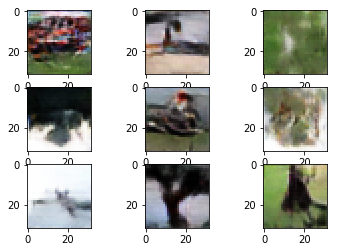

Epoch 4570/4570
64/64 [==============================] - 0s 648us/step - loss: -20.5422 - model_1_loss: -89.2522
Epoch 4570/4570
64/64 [==============================] - 0s 645us/step - loss: -34.6082 - model_1_loss: -106.4001
Epoch 4570/4570
64/64 [==============================] - 0s 647us/step - loss: -10.8873 - model_1_loss: -110.5871
Epoch 4570/4570
64/64 [==============================] - 0s 654us/step - loss: -27.4391 - model_1_loss: -106.4505
Epoch 4570/4570
64/64 [==============================] - 0s 656us/step - loss: -28.8475 - model_1_loss: -105.8693
Epoch 4570/4570
64/64 [==============================] - 0s 730us/step - loss: 113.3951


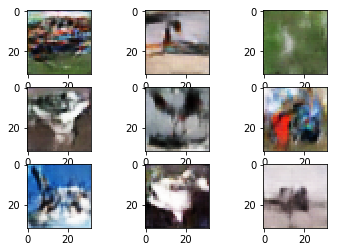

Epoch 4580/4580
64/64 [==============================] - 0s 629us/step - loss: -14.9868 - model_1_loss: -72.5471
Epoch 4580/4580
64/64 [==============================] - 0s 648us/step - loss: -13.3480 - model_1_loss: -75.9129
Epoch 4580/4580
64/64 [==============================] - 0s 661us/step - loss: -24.2038 - model_1_loss: -114.7012
Epoch 4580/4580
64/64 [==============================] - 0s 643us/step - loss: -20.3334 - model_1_loss: -114.0323
Epoch 4580/4580
64/64 [==============================] - 0s 633us/step - loss: -27.3637 - model_1_loss: -110.7448
Epoch 4580/4580
64/64 [==============================] - 0s 724us/step - loss: 119.2788


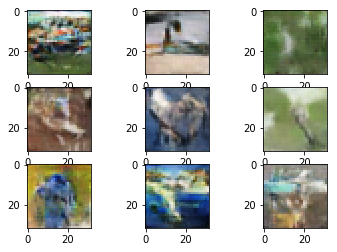

Epoch 4590/4590
64/64 [==============================] - 0s 622us/step - loss: -14.3471 - model_1_loss: -160.4475
Epoch 4590/4590
64/64 [==============================] - 0s 654us/step - loss: -28.8254 - model_1_loss: -157.7705
Epoch 4590/4590
64/64 [==============================] - 0s 666us/step - loss: -33.3623 - model_1_loss: -142.8755
Epoch 4590/4590
64/64 [==============================] - 0s 648us/step - loss: -10.7021 - model_1_loss: -109.1379
Epoch 4590/4590
64/64 [==============================] - 0s 652us/step - loss: -18.8903 - model_1_loss: -135.0951
Epoch 4590/4590
64/64 [==============================] - 0s 737us/step - loss: 157.2426


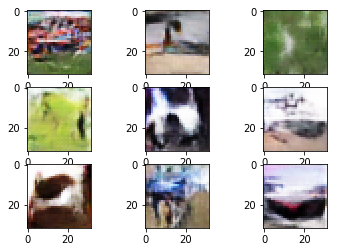

Epoch 4600/4600
64/64 [==============================] - 0s 641us/step - loss: -22.3101 - model_1_loss: -129.5320
Epoch 4600/4600
64/64 [==============================] - 0s 644us/step - loss: -21.6037 - model_1_loss: -118.4366
Epoch 4600/4600
64/64 [==============================] - 0s 648us/step - loss: -32.4463 - model_1_loss: -116.2275
Epoch 4600/4600
64/64 [==============================] - 0s 648us/step - loss: -19.7070 - model_1_loss: -113.2533
Epoch 4600/4600
64/64 [==============================] - 0s 652us/step - loss: -27.0996 - model_1_loss: -130.9429
Epoch 4600/4600
64/64 [==============================] - 0s 740us/step - loss: 136.1770


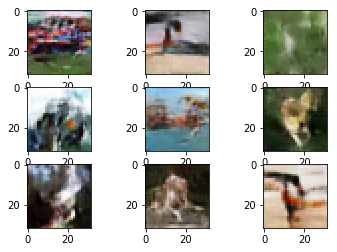

Epoch 4610/4610
64/64 [==============================] - 0s 636us/step - loss: -23.5642 - model_1_loss: -96.2796
Epoch 4610/4610
64/64 [==============================] - 0s 656us/step - loss: -17.7160 - model_1_loss: -92.9521
Epoch 4610/4610
64/64 [==============================] - 0s 654us/step - loss: -19.2006 - model_1_loss: -103.3415
Epoch 4610/4610
64/64 [==============================] - 0s 661us/step - loss: -23.1757 - model_1_loss: -107.8154
Epoch 4610/4610
64/64 [==============================] - 0s 655us/step - loss: -39.1528 - model_1_loss: -90.9074
Epoch 4610/4610
64/64 [==============================] - 0s 735us/step - loss: 89.4056


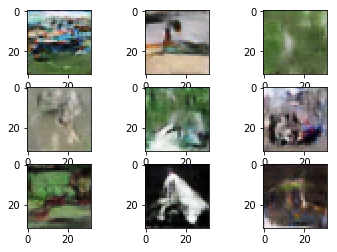

Epoch 4620/4620
64/64 [==============================] - 0s 635us/step - loss: -14.4531 - model_1_loss: -139.4797
Epoch 4620/4620
64/64 [==============================] - 0s 664us/step - loss: -16.1038 - model_1_loss: -121.1350
Epoch 4620/4620
64/64 [==============================] - 0s 658us/step - loss: -9.4836 - model_1_loss: -133.9206
Epoch 4620/4620
64/64 [==============================] - 0s 659us/step - loss: -21.3230 - model_1_loss: -152.9917
Epoch 4620/4620
64/64 [==============================] - 0s 656us/step - loss: -22.8951 - model_1_loss: -157.8773
Epoch 4620/4620
64/64 [==============================] - 0s 742us/step - loss: 151.6401


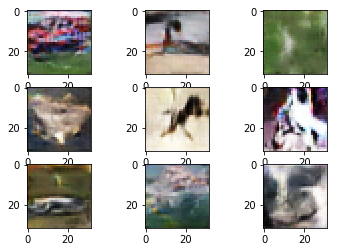

Epoch 4630/4630
64/64 [==============================] - 0s 628us/step - loss: -10.2000 - model_1_loss: -137.9504
Epoch 4630/4630
64/64 [==============================] - 0s 649us/step - loss: -11.2775 - model_1_loss: -133.6076
Epoch 4630/4630
64/64 [==============================] - 0s 665us/step - loss: -31.3799 - model_1_loss: -147.5122
Epoch 4630/4630
64/64 [==============================] - 0s 657us/step - loss: -23.7293 - model_1_loss: -147.0280
Epoch 4630/4630
64/64 [==============================] - 0s 653us/step - loss: -20.2966 - model_1_loss: -154.7912
Epoch 4630/4630
64/64 [==============================] - 0s 731us/step - loss: 159.3309


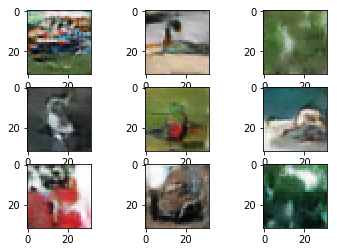

Epoch 4640/4640
64/64 [==============================] - 0s 632us/step - loss: -11.6578 - model_1_loss: -5.8144
Epoch 4640/4640
64/64 [==============================] - 0s 644us/step - loss: -23.5673 - model_1_loss: -38.4752
Epoch 4640/4640
64/64 [==============================] - 0s 654us/step - loss: -11.4612 - model_1_loss: -42.8095
Epoch 4640/4640
64/64 [==============================] - 0s 660us/step - loss: -30.5358 - model_1_loss: -62.1000
Epoch 4640/4640
64/64 [==============================] - 0s 653us/step - loss: -42.9420 - model_1_loss: -69.7105
Epoch 4640/4640
64/64 [==============================] - 0s 737us/step - loss: 47.3896


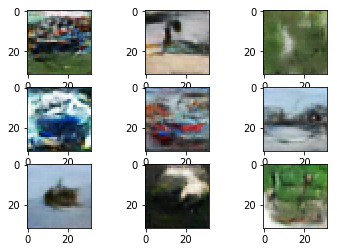

Epoch 4650/4650
64/64 [==============================] - 0s 639us/step - loss: -31.6531 - model_1_loss: -60.5428
Epoch 4650/4650
64/64 [==============================] - 0s 658us/step - loss: -15.8115 - model_1_loss: -33.0726
Epoch 4650/4650
64/64 [==============================] - 0s 656us/step - loss: -26.6802 - model_1_loss: -72.3412
Epoch 4650/4650
64/64 [==============================] - 0s 652us/step - loss: -33.2240 - model_1_loss: -87.2956
Epoch 4650/4650
64/64 [==============================] - 0s 652us/step - loss: -19.8487 - model_1_loss: -103.0308
Epoch 4650/4650
64/64 [==============================] - 0s 737us/step - loss: 87.1151


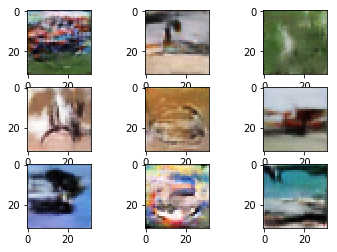

Epoch 4660/4660
64/64 [==============================] - 0s 643us/step - loss: -22.0265 - model_1_loss: -76.4408
Epoch 4660/4660
64/64 [==============================] - 0s 664us/step - loss: -11.9213 - model_1_loss: -99.2186
Epoch 4660/4660
64/64 [==============================] - 0s 657us/step - loss: -16.7137 - model_1_loss: -115.7045
Epoch 4660/4660
64/64 [==============================] - 0s 649us/step - loss: -25.6601 - model_1_loss: -115.3631
Epoch 4660/4660
64/64 [==============================] - 0s 643us/step - loss: -26.0379 - model_1_loss: -98.9312
Epoch 4660/4660
64/64 [==============================] - 0s 740us/step - loss: 78.8660


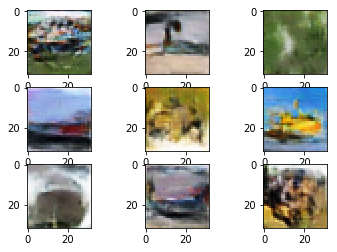

Epoch 4670/4670
64/64 [==============================] - 0s 620us/step - loss: -18.3927 - model_1_loss: -122.3849
Epoch 4670/4670
64/64 [==============================] - 0s 644us/step - loss: -27.7682 - model_1_loss: -138.5359
Epoch 4670/4670
64/64 [==============================] - 0s 635us/step - loss: -18.9674 - model_1_loss: -123.4236
Epoch 4670/4670
64/64 [==============================] - 0s 637us/step - loss: -24.9366 - model_1_loss: -106.4108
Epoch 4670/4670
64/64 [==============================] - 0s 646us/step - loss: -25.7154 - model_1_loss: -94.9476
Epoch 4670/4670
64/64 [==============================] - 0s 738us/step - loss: 85.9090


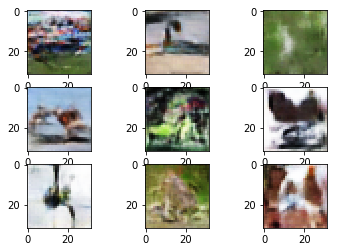

Epoch 4680/4680
64/64 [==============================] - 0s 646us/step - loss: -16.1719 - model_1_loss: -96.9924
Epoch 4680/4680
64/64 [==============================] - 0s 638us/step - loss: -3.1964 - model_1_loss: -104.0102
Epoch 4680/4680
64/64 [==============================] - 0s 659us/step - loss: -21.2823 - model_1_loss: -114.7369
Epoch 4680/4680
64/64 [==============================] - 0s 645us/step - loss: -17.7554 - model_1_loss: -99.5805
Epoch 4680/4680
64/64 [==============================] - 0s 650us/step - loss: -21.8041 - model_1_loss: -97.0813
Epoch 4680/4680
64/64 [==============================] - 0s 735us/step - loss: 105.2640


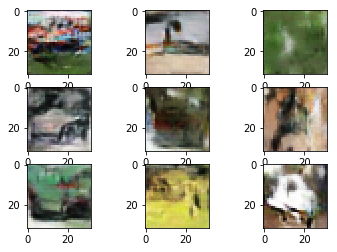

Epoch 4690/4690
64/64 [==============================] - 0s 634us/step - loss: -22.9625 - model_1_loss: -88.8027
Epoch 4690/4690
64/64 [==============================] - 0s 657us/step - loss: -28.7613 - model_1_loss: -93.8621
Epoch 4690/4690
64/64 [==============================] - 0s 646us/step - loss: -28.4425 - model_1_loss: -78.2310
Epoch 4690/4690
64/64 [==============================] - 0s 643us/step - loss: -25.3036 - model_1_loss: -116.9851
Epoch 4690/4690
64/64 [==============================] - 0s 646us/step - loss: -32.0539 - model_1_loss: -112.5464
Epoch 4690/4690
64/64 [==============================] - 0s 727us/step - loss: 107.1551


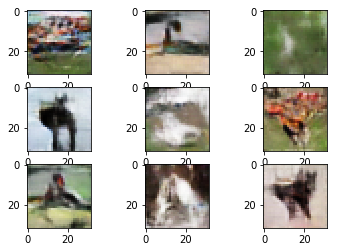

Epoch 4700/4700
64/64 [==============================] - 0s 627us/step - loss: -17.1203 - model_1_loss: -82.4386
Epoch 4700/4700
64/64 [==============================] - 0s 654us/step - loss: -30.8643 - model_1_loss: -118.9727
Epoch 4700/4700
64/64 [==============================] - 0s 644us/step - loss: -11.4418 - model_1_loss: -79.0711
Epoch 4700/4700
64/64 [==============================] - 0s 645us/step - loss: -43.2660 - model_1_loss: -77.7649
Epoch 4700/4700
64/64 [==============================] - 0s 653us/step - loss: -25.3962 - model_1_loss: -90.6608
Epoch 4700/4700
64/64 [==============================] - 0s 733us/step - loss: 83.0148


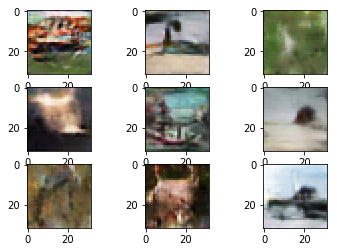

Epoch 4710/4710
64/64 [==============================] - 0s 628us/step - loss: -13.7259 - model_1_loss: -49.9946
Epoch 4710/4710
64/64 [==============================] - 0s 646us/step - loss: -12.3148 - model_1_loss: -97.7272
Epoch 4710/4710
64/64 [==============================] - 0s 660us/step - loss: -27.5798 - model_1_loss: -99.5364
Epoch 4710/4710
64/64 [==============================] - 0s 664us/step - loss: -20.5220 - model_1_loss: -96.2607
Epoch 4710/4710
64/64 [==============================] - 0s 640us/step - loss: -9.9405 - model_1_loss: -101.1442
Epoch 4710/4710
64/64 [==============================] - 0s 731us/step - loss: 97.5674


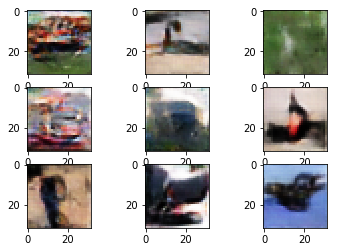

Epoch 4720/4720
64/64 [==============================] - 0s 647us/step - loss: -17.7567 - model_1_loss: -51.0824
Epoch 4720/4720
64/64 [==============================] - 0s 659us/step - loss: -15.3609 - model_1_loss: -56.1090
Epoch 4720/4720
64/64 [==============================] - 0s 661us/step - loss: -19.2090 - model_1_loss: -91.9328
Epoch 4720/4720
64/64 [==============================] - 0s 659us/step - loss: -26.3038 - model_1_loss: -94.1458
Epoch 4720/4720
64/64 [==============================] - 0s 657us/step - loss: -31.4229 - model_1_loss: -104.1492
Epoch 4720/4720
64/64 [==============================] - 0s 741us/step - loss: 65.9180


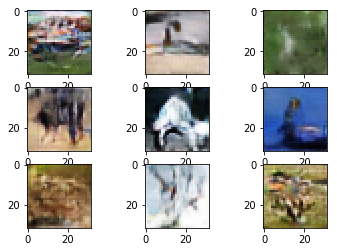

Epoch 4730/4730
64/64 [==============================] - 0s 637us/step - loss: -5.6189 - model_1_loss: -77.2169
Epoch 4730/4730
64/64 [==============================] - 0s 649us/step - loss: -25.0606 - model_1_loss: -102.2080
Epoch 4730/4730
64/64 [==============================] - 0s 641us/step - loss: -24.0656 - model_1_loss: -100.6989
Epoch 4730/4730
64/64 [==============================] - 0s 650us/step - loss: -19.7844 - model_1_loss: -93.1619
Epoch 4730/4730
64/64 [==============================] - 0s 645us/step - loss: -25.7621 - model_1_loss: -89.4401
Epoch 4730/4730
64/64 [==============================] - 0s 736us/step - loss: 53.4027


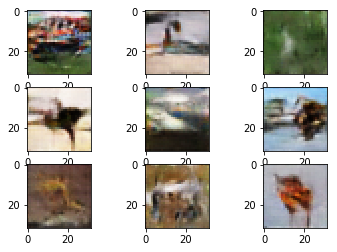

Epoch 4740/4740
64/64 [==============================] - 0s 626us/step - loss: -25.8837 - model_1_loss: 7.0840
Epoch 4740/4740
64/64 [==============================] - 0s 652us/step - loss: -15.3049 - model_1_loss: -14.6421
Epoch 4740/4740
64/64 [==============================] - 0s 661us/step - loss: -37.1398 - model_1_loss: -44.2428
Epoch 4740/4740
64/64 [==============================] - 0s 640us/step - loss: -15.4384 - model_1_loss: -51.7107
Epoch 4740/4740
64/64 [==============================] - 0s 661us/step - loss: -23.9274 - model_1_loss: -63.5189
Epoch 4740/4740
64/64 [==============================] - 0s 731us/step - loss: 49.7046


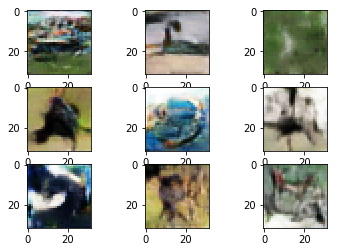

Epoch 4750/4750
64/64 [==============================] - 0s 633us/step - loss: -22.4312 - model_1_loss: -73.7409
Epoch 4750/4750
64/64 [==============================] - 0s 645us/step - loss: -16.9477 - model_1_loss: -50.0826
Epoch 4750/4750
64/64 [==============================] - 0s 666us/step - loss: -19.5181 - model_1_loss: -72.6489
Epoch 4750/4750
64/64 [==============================] - 0s 648us/step - loss: -19.6173 - model_1_loss: -43.5202
Epoch 4750/4750
64/64 [==============================] - 0s 649us/step - loss: -27.3079 - model_1_loss: -65.6855
Epoch 4750/4750
64/64 [==============================] - 0s 731us/step - loss: 52.6366


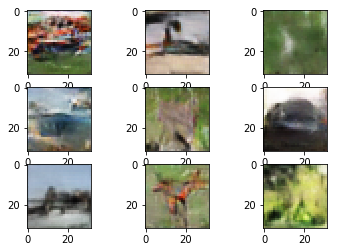

Epoch 4760/4760
64/64 [==============================] - 0s 641us/step - loss: -21.6977 - model_1_loss: -101.6408
Epoch 4760/4760
64/64 [==============================] - 0s 651us/step - loss: -12.0040 - model_1_loss: -99.8650
Epoch 4760/4760
64/64 [==============================] - 0s 647us/step - loss: -19.9763 - model_1_loss: -98.1308
Epoch 4760/4760
64/64 [==============================] - 0s 652us/step - loss: -8.0704 - model_1_loss: -124.4694
Epoch 4760/4760
64/64 [==============================] - 0s 651us/step - loss: -28.3368 - model_1_loss: -136.3291
Epoch 4760/4760
64/64 [==============================] - 0s 732us/step - loss: 128.2647


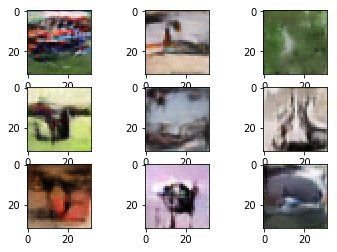

Epoch 4770/4770
64/64 [==============================] - 0s 633us/step - loss: -11.8034 - model_1_loss: -92.6460
Epoch 4770/4770
64/64 [==============================] - 0s 646us/step - loss: -22.9172 - model_1_loss: -120.6660
Epoch 4770/4770
64/64 [==============================] - 0s 640us/step - loss: -25.4248 - model_1_loss: -92.3529
Epoch 4770/4770
64/64 [==============================] - 0s 640us/step - loss: -21.2969 - model_1_loss: -84.5898
Epoch 4770/4770
64/64 [==============================] - 0s 641us/step - loss: -27.3332 - model_1_loss: -95.0381
Epoch 4770/4770
64/64 [==============================] - 0s 732us/step - loss: 107.0663


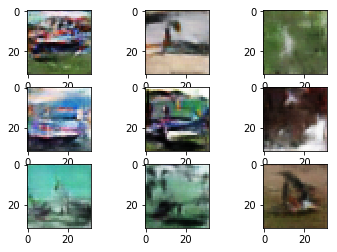

Epoch 4780/4780
64/64 [==============================] - 0s 618us/step - loss: -10.4253 - model_1_loss: -100.8248
Epoch 4780/4780
64/64 [==============================] - 0s 625us/step - loss: -23.5544 - model_1_loss: -103.5072
Epoch 4780/4780
64/64 [==============================] - 0s 635us/step - loss: -32.9601 - model_1_loss: -106.9741
Epoch 4780/4780
64/64 [==============================] - 0s 638us/step - loss: -13.5487 - model_1_loss: -119.6278
Epoch 4780/4780
64/64 [==============================] - 0s 647us/step - loss: -28.4343 - model_1_loss: -83.3469
Epoch 4780/4780
64/64 [==============================] - 0s 729us/step - loss: 72.5214


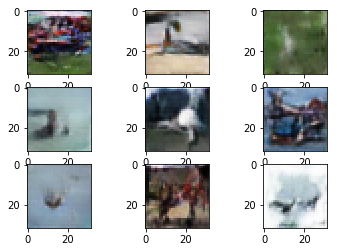

Epoch 4790/4790
64/64 [==============================] - 0s 622us/step - loss: -23.4415 - model_1_loss: -30.5431
Epoch 4790/4790
64/64 [==============================] - 0s 650us/step - loss: 4.7047 - model_1_loss: -41.0079
Epoch 4790/4790
64/64 [==============================] - 0s 643us/step - loss: -21.7759 - model_1_loss: -69.9563
Epoch 4790/4790
64/64 [==============================] - 0s 647us/step - loss: -25.9958 - model_1_loss: -99.3845
Epoch 4790/4790
64/64 [==============================] - 0s 656us/step - loss: -24.2781 - model_1_loss: -103.3075
Epoch 4790/4790
64/64 [==============================] - 0s 735us/step - loss: 129.1825


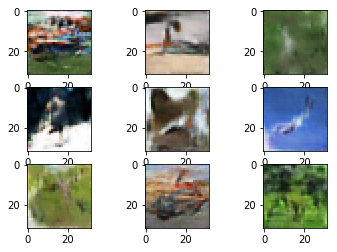

Epoch 4800/4800
64/64 [==============================] - 0s 652us/step - loss: -9.0948 - model_1_loss: -103.5309
Epoch 4800/4800
64/64 [==============================] - 0s 656us/step - loss: -21.7496 - model_1_loss: -107.7257
Epoch 4800/4800
64/64 [==============================] - 0s 650us/step - loss: -14.3739 - model_1_loss: -117.1713
Epoch 4800/4800
64/64 [==============================] - 0s 644us/step - loss: -19.7994 - model_1_loss: -123.5201
Epoch 4800/4800
64/64 [==============================] - 0s 639us/step - loss: -22.0488 - model_1_loss: -123.5512
Epoch 4800/4800
64/64 [==============================] - 0s 734us/step - loss: 93.8437


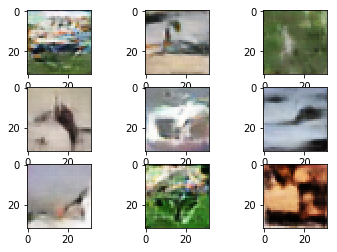

Epoch 4810/4810
64/64 [==============================] - 0s 645us/step - loss: -26.4372 - model_1_loss: -121.8892
Epoch 4810/4810
64/64 [==============================] - 0s 647us/step - loss: -23.2432 - model_1_loss: -108.4248
Epoch 4810/4810
64/64 [==============================] - 0s 658us/step - loss: -14.9367 - model_1_loss: -123.4668
Epoch 4810/4810
64/64 [==============================] - 0s 648us/step - loss: -13.7356 - model_1_loss: -123.0986
Epoch 4810/4810
64/64 [==============================] - 0s 675us/step - loss: -33.9814 - model_1_loss: -139.8060
Epoch 4810/4810
64/64 [==============================] - 0s 751us/step - loss: 104.1760


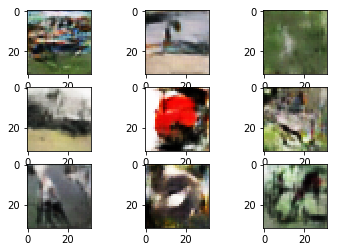

Epoch 4820/4820
64/64 [==============================] - 0s 672us/step - loss: -32.1768 - model_1_loss: -92.0312
Epoch 4820/4820
64/64 [==============================] - 0s 643us/step - loss: -31.1625 - model_1_loss: -44.9949
Epoch 4820/4820
64/64 [==============================] - 0s 659us/step - loss: -32.5324 - model_1_loss: -95.0177
Epoch 4820/4820
64/64 [==============================] - 0s 660us/step - loss: -23.5154 - model_1_loss: -97.0087
Epoch 4820/4820
64/64 [==============================] - 0s 655us/step - loss: -29.9757 - model_1_loss: -76.3906
Epoch 4820/4820
64/64 [==============================] - 0s 737us/step - loss: 92.8834


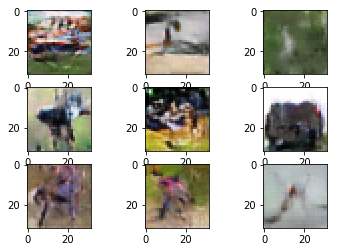

Epoch 4830/4830
64/64 [==============================] - 0s 638us/step - loss: -25.7117 - model_1_loss: -62.7210
Epoch 4830/4830
64/64 [==============================] - 0s 655us/step - loss: -11.8169 - model_1_loss: -72.1635
Epoch 4830/4830
64/64 [==============================] - 0s 651us/step - loss: -24.9523 - model_1_loss: -99.1162
Epoch 4830/4830
64/64 [==============================] - 0s 674us/step - loss: -20.9907 - model_1_loss: -116.9314
Epoch 4830/4830
64/64 [==============================] - 0s 643us/step - loss: -35.0116 - model_1_loss: -131.0746
Epoch 4830/4830
64/64 [==============================] - 0s 725us/step - loss: 113.7689


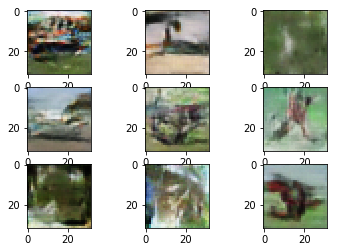

Epoch 4840/4840
64/64 [==============================] - 0s 646us/step - loss: -19.5532 - model_1_loss: -98.0714
Epoch 4840/4840
64/64 [==============================] - 0s 658us/step - loss: -17.7398 - model_1_loss: -134.3107
Epoch 4840/4840
64/64 [==============================] - 0s 665us/step - loss: -21.1823 - model_1_loss: -159.3361
Epoch 4840/4840
64/64 [==============================] - 0s 652us/step - loss: -20.4916 - model_1_loss: -165.5010
Epoch 4840/4840
64/64 [==============================] - 0s 647us/step - loss: -34.8439 - model_1_loss: -163.7578
Epoch 4840/4840
64/64 [==============================] - 0s 752us/step - loss: 176.5855


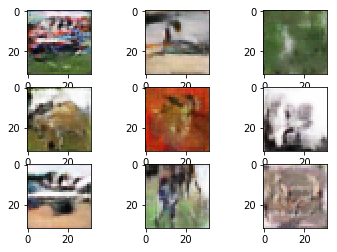

Epoch 4850/4850
64/64 [==============================] - 0s 618us/step - loss: -21.8212 - model_1_loss: -121.9986
Epoch 4850/4850
64/64 [==============================] - 0s 654us/step - loss: -27.4003 - model_1_loss: -100.3995
Epoch 4850/4850
64/64 [==============================] - 0s 648us/step - loss: -43.8560 - model_1_loss: -131.3229
Epoch 4850/4850
64/64 [==============================] - 0s 648us/step - loss: -41.7059 - model_1_loss: -143.5133
Epoch 4850/4850
64/64 [==============================] - 0s 634us/step - loss: -19.3894 - model_1_loss: -146.0040
Epoch 4850/4850
64/64 [==============================] - 0s 743us/step - loss: 159.4512


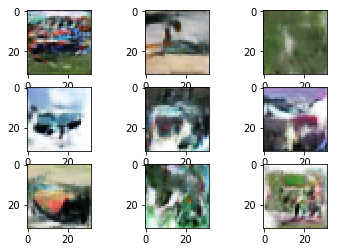

Epoch 4860/4860
64/64 [==============================] - 0s 638us/step - loss: -14.5287 - model_1_loss: -121.8854
Epoch 4860/4860
64/64 [==============================] - 0s 661us/step - loss: 6.2404 - model_1_loss: -106.6452
Epoch 4860/4860
64/64 [==============================] - 0s 654us/step - loss: -7.4104 - model_1_loss: -137.9808
Epoch 4860/4860
64/64 [==============================] - 0s 661us/step - loss: -29.8515 - model_1_loss: -104.4609
Epoch 4860/4860
64/64 [==============================] - 0s 654us/step - loss: -13.9154 - model_1_loss: -96.9764
Epoch 4860/4860
64/64 [==============================] - 0s 731us/step - loss: 111.5675


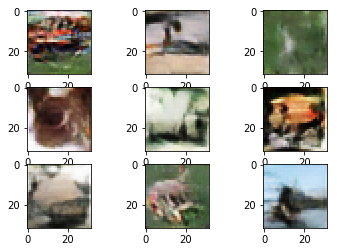

Epoch 4870/4870
64/64 [==============================] - 0s 630us/step - loss: -13.3198 - model_1_loss: -66.0462
Epoch 4870/4870
64/64 [==============================] - 0s 667us/step - loss: -21.2257 - model_1_loss: -55.2139
Epoch 4870/4870
64/64 [==============================] - 0s 647us/step - loss: -11.1733 - model_1_loss: -75.2092
Epoch 4870/4870
64/64 [==============================] - 0s 652us/step - loss: -25.3309 - model_1_loss: -120.7566
Epoch 4870/4870
64/64 [==============================] - 0s 646us/step - loss: -27.3821 - model_1_loss: -118.6189
Epoch 4870/4870
64/64 [==============================] - 0s 730us/step - loss: 93.9710


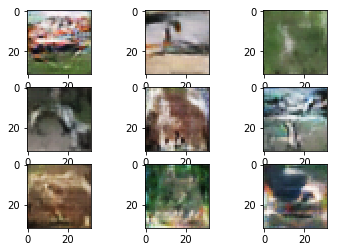

Epoch 4880/4880
64/64 [==============================] - 0s 618us/step - loss: -7.8620 - model_1_loss: -69.8214
Epoch 4880/4880
64/64 [==============================] - 0s 650us/step - loss: -11.4024 - model_1_loss: -108.2570
Epoch 4880/4880
64/64 [==============================] - 0s 663us/step - loss: -40.3471 - model_1_loss: -102.3361
Epoch 4880/4880
64/64 [==============================] - 0s 644us/step - loss: -21.9082 - model_1_loss: -89.4422
Epoch 4880/4880
64/64 [==============================] - 0s 650us/step - loss: -52.8680 - model_1_loss: -116.3674
Epoch 4880/4880
64/64 [==============================] - 0s 737us/step - loss: 90.7437


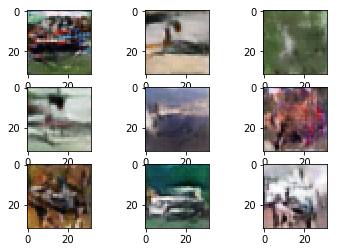

Epoch 4890/4890
64/64 [==============================] - 0s 628us/step - loss: -28.1442 - model_1_loss: -116.9289
Epoch 4890/4890
64/64 [==============================] - 0s 656us/step - loss: -4.6153 - model_1_loss: -108.7884
Epoch 4890/4890
64/64 [==============================] - 0s 648us/step - loss: -29.2097 - model_1_loss: -144.2939
Epoch 4890/4890
64/64 [==============================] - 0s 648us/step - loss: -40.4961 - model_1_loss: -128.1552
Epoch 4890/4890
64/64 [==============================] - 0s 649us/step - loss: -17.8678 - model_1_loss: -121.6041
Epoch 4890/4890
64/64 [==============================] - 0s 709us/step - loss: 102.5770


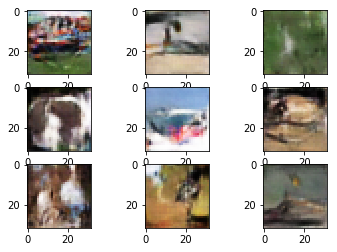

Epoch 4900/4900
64/64 [==============================] - 0s 638us/step - loss: -0.6874 - model_1_loss: -89.9806
Epoch 4900/4900
64/64 [==============================] - 0s 645us/step - loss: -22.2913 - model_1_loss: -111.6821
Epoch 4900/4900
64/64 [==============================] - 0s 646us/step - loss: -22.6281 - model_1_loss: -107.2297
Epoch 4900/4900
64/64 [==============================] - 0s 635us/step - loss: -30.0775 - model_1_loss: -96.1829
Epoch 4900/4900
64/64 [==============================] - 0s 651us/step - loss: -16.5400 - model_1_loss: -67.0492
Epoch 4900/4900
64/64 [==============================] - 0s 732us/step - loss: 59.9407


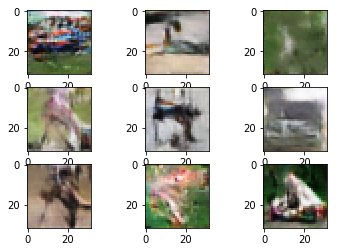

Epoch 4910/4910
64/64 [==============================] - 0s 639us/step - loss: -16.9259 - model_1_loss: -69.3272
Epoch 4910/4910
64/64 [==============================] - 0s 645us/step - loss: -20.7271 - model_1_loss: -124.5261
Epoch 4910/4910
64/64 [==============================] - 0s 628us/step - loss: -21.9739 - model_1_loss: -107.8736
Epoch 4910/4910
64/64 [==============================] - 0s 637us/step - loss: -19.8723 - model_1_loss: -125.3753
Epoch 4910/4910
64/64 [==============================] - 0s 638us/step - loss: -19.0676 - model_1_loss: -101.1671
Epoch 4910/4910
64/64 [==============================] - 0s 724us/step - loss: 108.8806


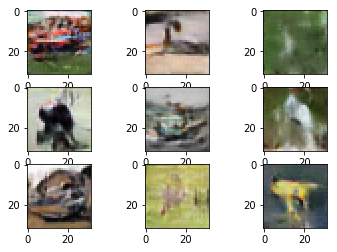

Epoch 4920/4920
64/64 [==============================] - 0s 629us/step - loss: -2.1422 - model_1_loss: -86.4447
Epoch 4920/4920
64/64 [==============================] - 0s 651us/step - loss: -14.3936 - model_1_loss: -86.6626
Epoch 4920/4920
64/64 [==============================] - 0s 643us/step - loss: -7.3135 - model_1_loss: -108.6988
Epoch 4920/4920
64/64 [==============================] - 0s 637us/step - loss: -16.7982 - model_1_loss: -117.0409
Epoch 4920/4920
64/64 [==============================] - 0s 643us/step - loss: -23.7422 - model_1_loss: -121.0184
Epoch 4920/4920
64/64 [==============================] - 0s 744us/step - loss: 122.0438


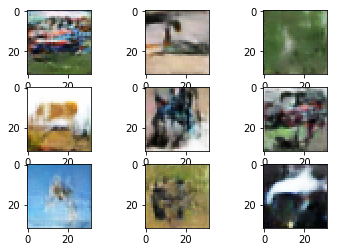

Epoch 4930/4930
64/64 [==============================] - 0s 638us/step - loss: -26.8727 - model_1_loss: -111.9944
Epoch 4930/4930
64/64 [==============================] - 0s 650us/step - loss: -18.8056 - model_1_loss: -99.6800
Epoch 4930/4930
64/64 [==============================] - 0s 659us/step - loss: -22.2631 - model_1_loss: -114.1415
Epoch 4930/4930
64/64 [==============================] - 0s 654us/step - loss: -22.4259 - model_1_loss: -102.2128
Epoch 4930/4930
64/64 [==============================] - 0s 641us/step - loss: -33.0119 - model_1_loss: -105.2954
Epoch 4930/4930
64/64 [==============================] - 0s 737us/step - loss: 89.8836


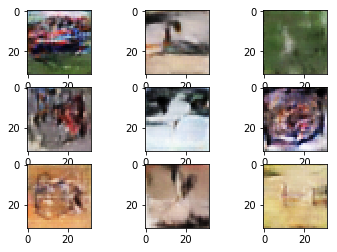

Epoch 4940/4940
64/64 [==============================] - 0s 629us/step - loss: -29.4793 - model_1_loss: -85.2495
Epoch 4940/4940
64/64 [==============================] - 0s 646us/step - loss: -3.9979 - model_1_loss: -109.2899
Epoch 4940/4940
64/64 [==============================] - 0s 657us/step - loss: -14.1522 - model_1_loss: -104.4675
Epoch 4940/4940
64/64 [==============================] - 0s 650us/step - loss: -24.0939 - model_1_loss: -123.1431
Epoch 4940/4940
64/64 [==============================] - 0s 641us/step - loss: -20.7687 - model_1_loss: -107.2064
Epoch 4940/4940
64/64 [==============================] - 0s 733us/step - loss: 108.6339


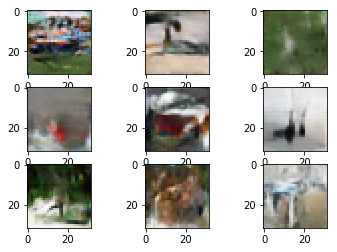

Epoch 4950/4950
64/64 [==============================] - 0s 642us/step - loss: -18.4742 - model_1_loss: -121.7840
Epoch 4950/4950
64/64 [==============================] - 0s 654us/step - loss: -22.0568 - model_1_loss: -122.2561
Epoch 4950/4950
64/64 [==============================] - 0s 643us/step - loss: -30.5432 - model_1_loss: -139.8759
Epoch 4950/4950
64/64 [==============================] - 0s 658us/step - loss: -21.0480 - model_1_loss: -92.8344
Epoch 4950/4950
64/64 [==============================] - 0s 664us/step - loss: -21.3344 - model_1_loss: -98.0206
Epoch 4950/4950
64/64 [==============================] - 0s 741us/step - loss: 97.6546


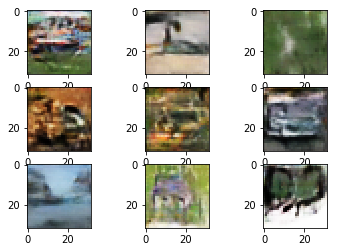

Epoch 4960/4960
64/64 [==============================] - 0s 637us/step - loss: -21.6254 - model_1_loss: -108.4161
Epoch 4960/4960
64/64 [==============================] - 0s 649us/step - loss: -26.0639 - model_1_loss: -121.1213
Epoch 4960/4960
64/64 [==============================] - 0s 655us/step - loss: -31.0481 - model_1_loss: -113.6186
Epoch 4960/4960
64/64 [==============================] - 0s 653us/step - loss: -40.5663 - model_1_loss: -94.2424
Epoch 4960/4960
64/64 [==============================] - 0s 658us/step - loss: -54.7506 - model_1_loss: -103.5040
Epoch 4960/4960
64/64 [==============================] - 0s 747us/step - loss: 103.1291


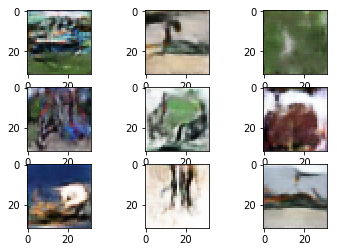

Epoch 4970/4970
64/64 [==============================] - 0s 639us/step - loss: -17.1440 - model_1_loss: -78.8232
Epoch 4970/4970
64/64 [==============================] - 0s 658us/step - loss: -32.9814 - model_1_loss: -96.1542
Epoch 4970/4970
64/64 [==============================] - 0s 657us/step - loss: -30.2443 - model_1_loss: -94.8238
Epoch 4970/4970
64/64 [==============================] - 0s 650us/step - loss: -10.7270 - model_1_loss: -80.8502
Epoch 4970/4970
64/64 [==============================] - 0s 659us/step - loss: -26.2335 - model_1_loss: -113.8218
Epoch 4970/4970
64/64 [==============================] - 0s 746us/step - loss: 122.2713


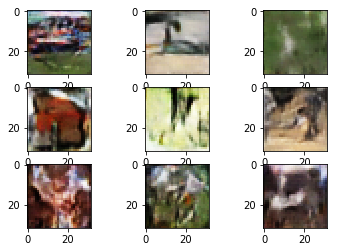

Epoch 4980/4980
64/64 [==============================] - 0s 625us/step - loss: -17.0765 - model_1_loss: -99.4755
Epoch 4980/4980
64/64 [==============================] - 0s 652us/step - loss: -18.5258 - model_1_loss: -68.6450
Epoch 4980/4980
64/64 [==============================] - 0s 658us/step - loss: -22.1700 - model_1_loss: -87.5002
Epoch 4980/4980
64/64 [==============================] - 0s 662us/step - loss: -44.6893 - model_1_loss: -116.1481
Epoch 4980/4980
64/64 [==============================] - 0s 654us/step - loss: -25.9702 - model_1_loss: -117.5097
Epoch 4980/4980
64/64 [==============================] - 0s 739us/step - loss: 97.0386


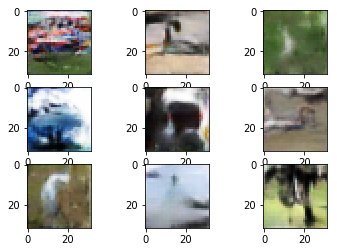

Epoch 4990/4990
64/64 [==============================] - 0s 630us/step - loss: -8.8463 - model_1_loss: -34.6320
Epoch 4990/4990
64/64 [==============================] - 0s 645us/step - loss: -19.1693 - model_1_loss: -66.2650
Epoch 4990/4990
64/64 [==============================] - 0s 644us/step - loss: -20.2462 - model_1_loss: -57.6863
Epoch 4990/4990
64/64 [==============================] - 0s 647us/step - loss: -35.2656 - model_1_loss: -91.6928
Epoch 4990/4990
64/64 [==============================] - 0s 643us/step - loss: -39.2846 - model_1_loss: -109.9345
Epoch 4990/4990
64/64 [==============================] - 0s 729us/step - loss: 106.4246


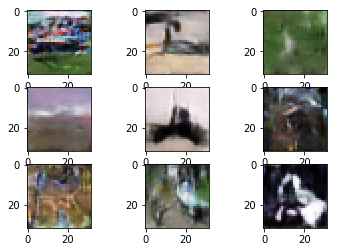

Epoch 5000/5000
64/64 [==============================] - 0s 649us/step - loss: -13.5792 - model_1_loss: -112.7426
Epoch 5000/5000
64/64 [==============================] - 0s 650us/step - loss: -17.7849 - model_1_loss: -126.8233
Epoch 5000/5000
64/64 [==============================] - 0s 649us/step - loss: -34.7424 - model_1_loss: -127.9726
Epoch 5000/5000
64/64 [==============================] - 0s 646us/step - loss: -21.8675 - model_1_loss: -122.3424
Epoch 5000/5000
64/64 [==============================] - 0s 641us/step - loss: -18.4297 - model_1_loss: -131.9725
Epoch 5000/5000
64/64 [==============================] - 0s 731us/step - loss: 119.5787


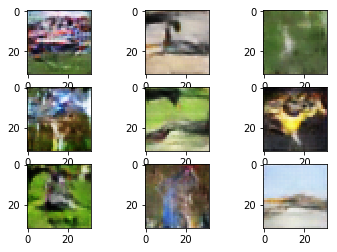

CPU times: user 21min 39s, sys: 5min 35s, total: 27min 14s
Wall time: 24min 42s


In [68]:
%%time
fixed_reference = np.random.randn(3,100)
for epoch in range(5000):
    
    verbose = (epoch+1) % 10 == 0
    
    for _ in range(5):
        real_sample = x_train_2[np.random.randint(0, x_train_2.shape[0], size=64),:,:,:]
        fake_code = np.random.randn(real_sample.shape[0],100)
        real_label = np.ones((real_sample.shape[0],1))
        fake_label = np.zeros((real_sample.shape[0],1))
        M_dis_train.fit([real_sample, fake_code], [real_label, fake_label], epochs=epoch+1, initial_epoch=epoch, verbose=verbose)
    fake_code = np.random.randn(real_sample.shape[0],100)
    M_gen_train.fit([fake_code], [real_label], epochs=epoch+1, initial_epoch=epoch, verbose=verbose)
    
    if verbose:
        generated = np.squeeze(M_gen.predict(np.vstack([fixed_reference, np.random.randn(6,100)])))
        for i in range(9):
            plt.subplot(3, 3, i+1)
            plt.imshow(generated[i])
        plt.show()
    
    if (epoch+1) % 1000 == 0:
        time.sleep(30)

In [ ]:
keras.models.save_model(M_dis, 'gan_models/M_dis.h5')
keras.models.save_model(M_gen, 'gan_models/M_gen.h5')
keras.models.save_model(M_dis_train, 'gan_models/M_dis_train.h5')
keras.models.save_model(M_gen_train, 'gan_models/M_gen_train.h5')

In [66]:
read_idx = list(range(x_train_2.shape[0]))
random.shuffle(read_idx)
real = x_train_2[read_idx[:50]]
generated = np.squeeze(M_gen.predict(np.random.randn(50,100)))
read_and_generated = np.vstack([real, generated])
read_and_generated_idx = list(range(read_and_generated.shape[0]))
random.shuffle(read_and_generated_idx)
read_and_generated = read_and_generated[read_and_generated_idx]

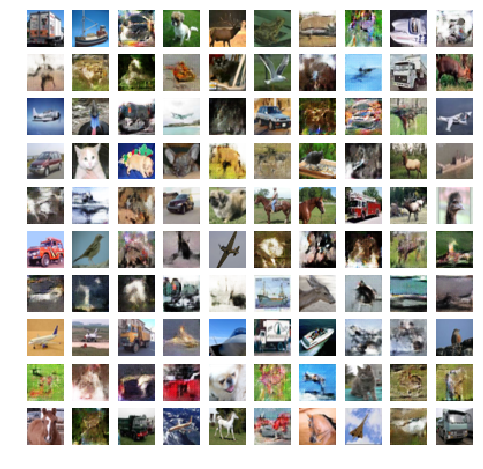

In [69]:
plt.figure(figsize=(8,8))
for i in range(100):
    plt.subplot(10, 10, i+1)
    plt.axis('off')
    #plt.title('real' if read_and_generated_idx[i] < 50 else 'gen')
    plt.imshow(read_and_generated[i])
plt.show()